<a href="https://colab.research.google.com/github/juanpablosalas/SalasJuanPablo_RECV_Entrega6/blob/main/SalasJuanPablo_RECV_Entrega6.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from glob import glob
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import torch
from torch.autograd import Variable
from sklearn.metrics import f1_score
from sklearn.metrics import confusion_matrix
from torch.utils.data import DataLoader
from torch.utils.data import TensorDataset
from tqdm.notebook import tqdm

#**Carga de datos**

In [ ]:
#-- Descomprimimos el dataset
#!rm -r mnist
#!unzip "/content/drive/MyDrive/Colab Notebooks/mnist.zip"

In [ ]:
# Se importan los datos de MNIST
train_files = glob('./mnist/train/*/*.png')
valid_files = glob('./mnist/valid/*/*.png')
test_files = glob('./mnist/test/*/*.png')

train_files[0]

'./mnist/train/1/6783.png'

In [ ]:
#Se aleatorizan los datos 
np.random.shuffle(train_files)
np.random.shuffle(valid_files)
np.random.shuffle(test_files)

len(train_files), len(valid_files), len(test_files)

(6000, 2000, 992)

In [ ]:
#Datos de entrenamiento
N_train = len(train_files)
X_train = []
Y_train = []

for i, train_file in enumerate(train_files):
  Y_train.append( int(train_file.split('/')[3]) )
  X_train.append(np.array(Image.open(train_file)))

In [ ]:
#Datos de validación
N_valid = len(valid_files)
X_valid = []
Y_valid = []

for i, valid_file in enumerate(valid_files):
  Y_valid.append( int(valid_file.split('/')[3]) )
  X_valid.append( np.array(Image.open(valid_file)) )

In [ ]:
#Datos de testeo
N_test = len(test_files)
X_test = []
Y_test = []

for i, test_file in enumerate(test_files):
  Y_test.append( int(test_file.split('/')[3]) )
  X_test.append( np.array(Image.open(test_file)) )

In [ ]:
#Transformación de arreglos a tensores
X_train = Variable(torch.from_numpy(np.array(X_train))).float()
Y_train = Variable(torch.from_numpy(np.array(Y_train))).long()

X_valid = Variable(torch.from_numpy(np.array(X_valid))).float()
Y_valid = Variable(torch.from_numpy(np.array(Y_valid))).long()

X_test = Variable(torch.from_numpy(np.array(X_test))).float()
Y_test = Variable(torch.from_numpy(np.array(Y_test))).long()

X_train.data.size()

torch.Size([6000, 28, 28])

In [ ]:
def CM(Y_true, Y_pred, classes):
  fig = plt.figure(figsize=(10, 10))
  cm = confusion_matrix(Y_true, Y_pred)
  lclasses = np.arange(0,classes)
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
  cmap=plt.cm.Blues
  ax = fig.add_subplot(1,1,1)
  im = ax.imshow(cm, interpolation='nearest', cmap=cmap)
  ax.figure.colorbar(im, ax=ax, pad=0.01, shrink=0.86)
  ax.set(xticks=np.arange(cm.shape[1]), yticks=np.arange(cm.shape[0]),xticklabels=lclasses, yticklabels=lclasses)
  ax.set_xlabel("Predicted",size=20)
  ax.set_ylabel("True",size=20)
  ax.set_ylim(classes-0.5, -0.5)

  plt.setp(ax.get_xticklabels(), size=12)
  plt.setp(ax.get_yticklabels(), size=12)

  fmt = '.2f'
  thresh = cm.max()/2.
  for i in range(cm.shape[0]):
      for j in range(cm.shape[1]):
          ax.text(j, i, format(cm[i, j], fmt),ha="center", va="center",size=15 , color="white" if cm[i, j] > thresh else "black")

  plt.show()

In [ ]:
def train_valid(model, n_epoch, optimizer, criterion):
  loss_train = []
  f1_train = []
  acc_train = []

  loss_valid = []
  f1_valid = []
  acc_valid = []

  for epoch in range(n_epoch):
    model.train()

    Xtr = X_train.view(X_train.size(0), -1)
    Y_pred = model(Xtr)

    loss = criterion(Y_pred,Y_train)
    loss_train.append(loss.item())

    Y_pred = torch.argmax(Y_pred, 1)
    f1_train.append( f1_score(Y_train,Y_pred, average='macro') )
    
    acc = sum(Y_train == Y_pred)/len(Y_pred)
    acc_train.append(acc)

    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

    model.eval()
    Xvl = X_valid.view(X_valid.size(0), -1)
    Y_pred = model(Xvl)  
    loss = criterion(Y_pred,Y_valid)
    loss_valid.append(loss.item())

    Y_pred = torch.argmax(Y_pred, 1)
    f1_valid.append( f1_score(Y_valid, Y_pred, average='macro') )

    acc = sum(Y_valid == Y_pred)/len(Y_pred)
    acc_valid.append(acc)

  print( 'Valid Evaluation loss: {}. f1:{} acc: {} '.format(loss_valid[-1], f1_valid[-1], acc_valid[-1]) )
  CM(Y_valid, Y_pred, 10)

  0%|          | 0/243 [00:00<?, ?it/s]

ne: 50, hd:50, wd:0.001, lr: 0.001, bs:256 
Valid Evaluation loss: 0.7653058767318726. f1:0.8236787635924856 acc: 0.8234999775886536 


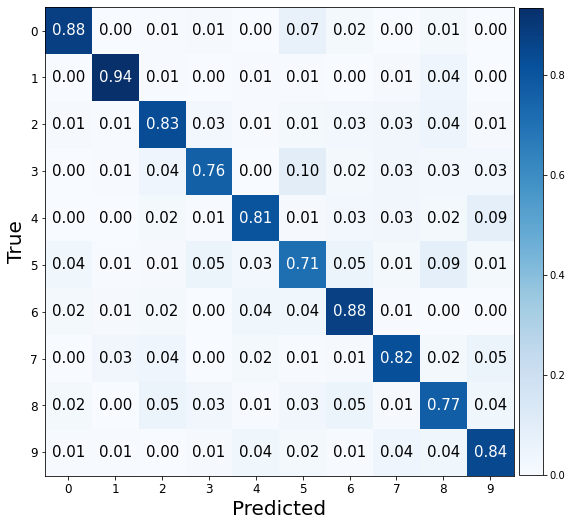

Valid Evaluation loss: 0.6041074991226196. f1:0.8503844838335542 acc: 0.8510000109672546 


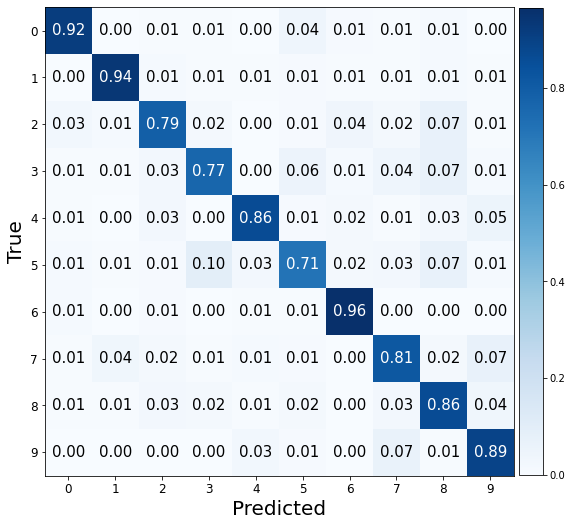

###################

ne: 50, hd:80, wd:0.001, lr: 0.001, bs:256 
Valid Evaluation loss: 0.8934316039085388. f1:0.8664020986503594 acc: 0.8659999966621399 


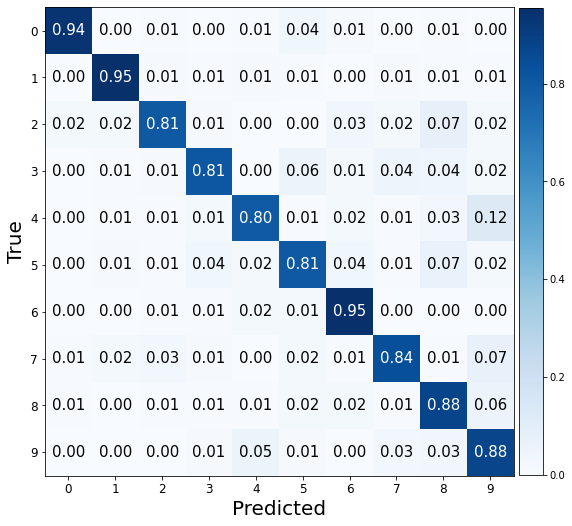

Valid Evaluation loss: 0.4095568060874939. f1:0.889336652086915 acc: 0.8895000219345093 


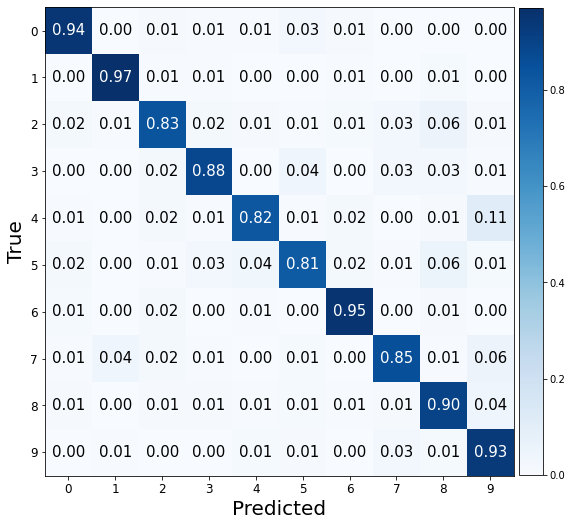

###################

ne: 50, hd:100, wd:0.001, lr: 0.001, bs:256 
Valid Evaluation loss: 0.8183394074440002. f1:0.8721953802813939 acc: 0.871999979019165 


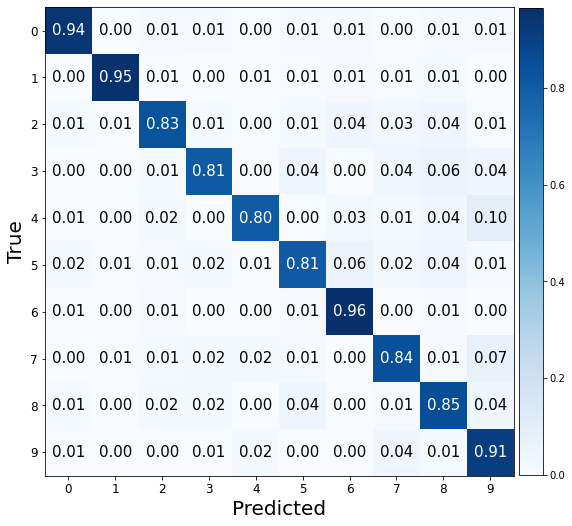

Valid Evaluation loss: 0.448377400636673. f1:0.8726459484995444 acc: 0.8725000023841858 


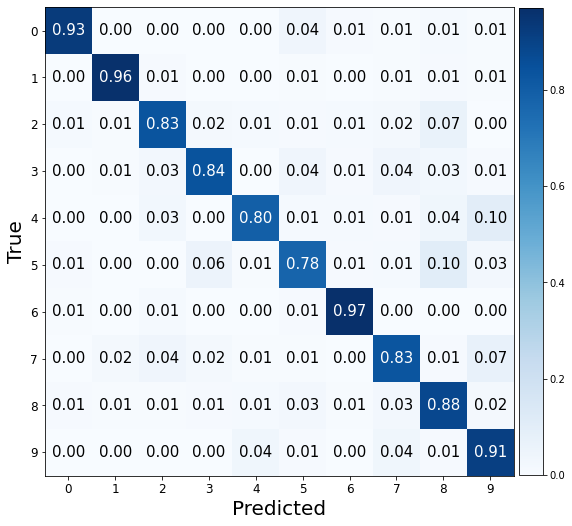

###################

ne: 50, hd:50, wd:0.01, lr: 0.001, bs:256 
Valid Evaluation loss: 0.9688910245895386. f1:0.7999911464897413 acc: 0.8004999756813049 


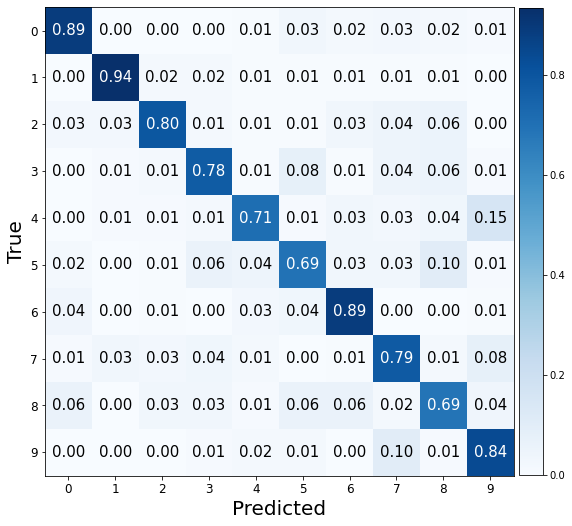

Valid Evaluation loss: 0.46899789571762085. f1:0.8644854235893475 acc: 0.8644999861717224 


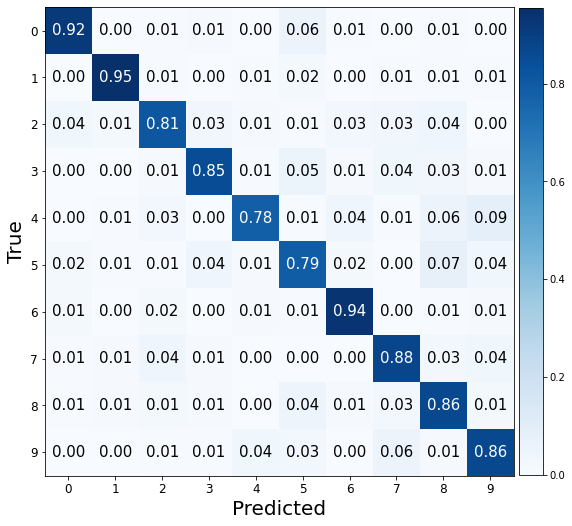

###################

ne: 50, hd:80, wd:0.01, lr: 0.001, bs:256 
Valid Evaluation loss: 0.949215292930603. f1:0.8290178288082117 acc: 0.8295000195503235 


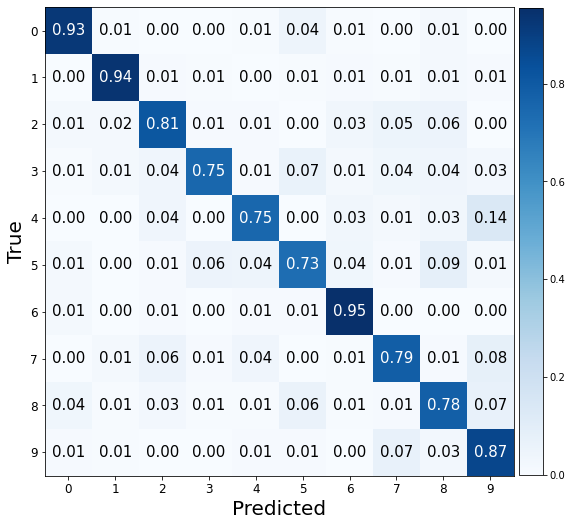

Valid Evaluation loss: 0.36801671981811523. f1:0.8963169152756333 acc: 0.8964999914169312 


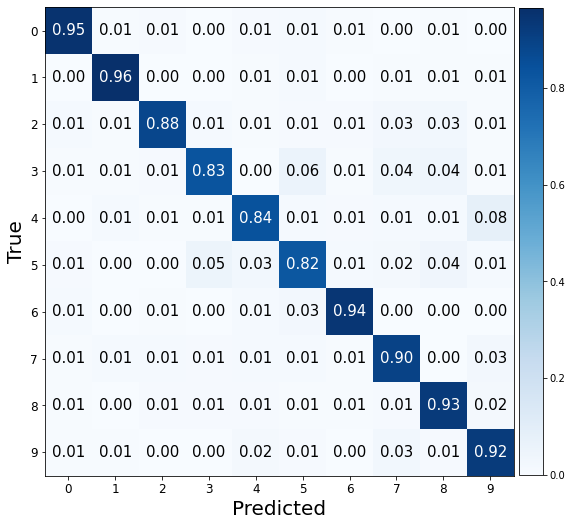

###################

ne: 50, hd:100, wd:0.01, lr: 0.001, bs:256 
Valid Evaluation loss: 0.7609748244285583. f1:0.8793791895515742 acc: 0.8794999718666077 


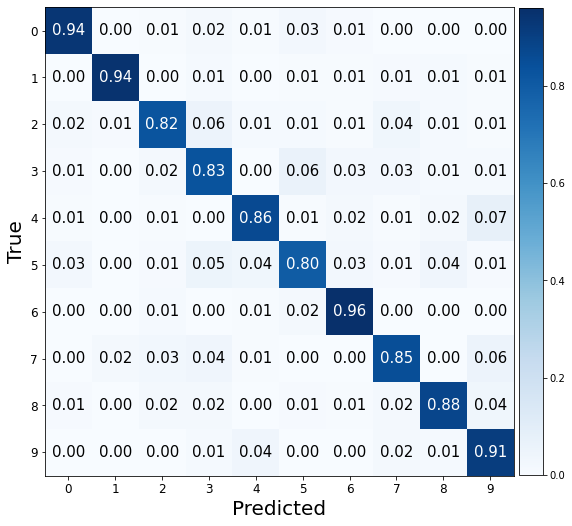

Valid Evaluation loss: 0.3755217492580414. f1:0.8955704167459897 acc: 0.8955000042915344 


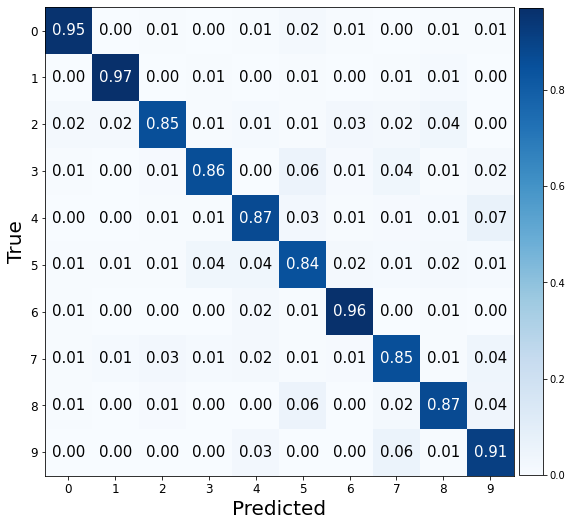

###################

ne: 50, hd:50, wd:0.1, lr: 0.001, bs:256 
Valid Evaluation loss: 0.7236184477806091. f1:0.8358233382449811 acc: 0.8360000252723694 


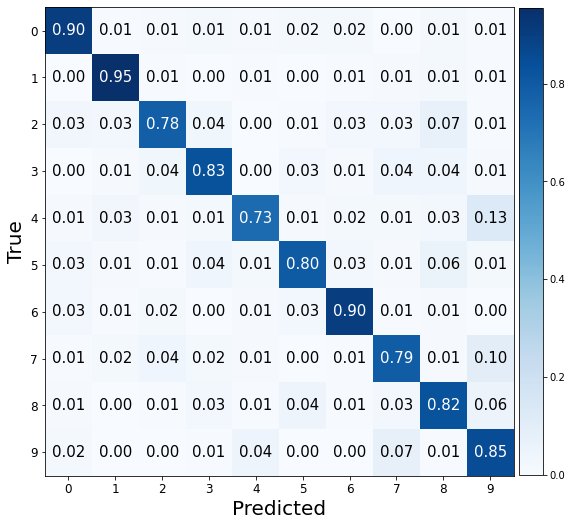

Valid Evaluation loss: 0.49108538031578064. f1:0.8551855937459429 acc: 0.8554999828338623 


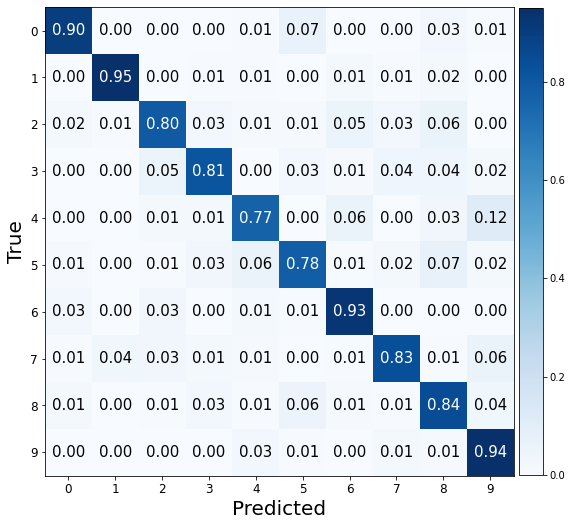

###################

ne: 50, hd:80, wd:0.1, lr: 0.001, bs:256 
Valid Evaluation loss: 0.8269608020782471. f1:0.841910022510197 acc: 0.8414999842643738 


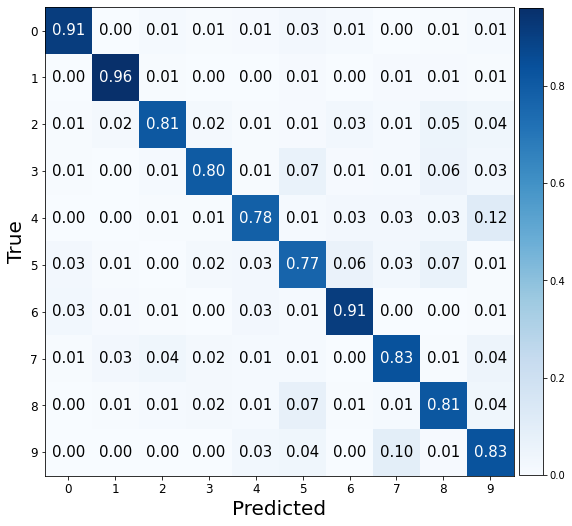

Valid Evaluation loss: 0.3956183195114136. f1:0.8828894646757632 acc: 0.8830000162124634 


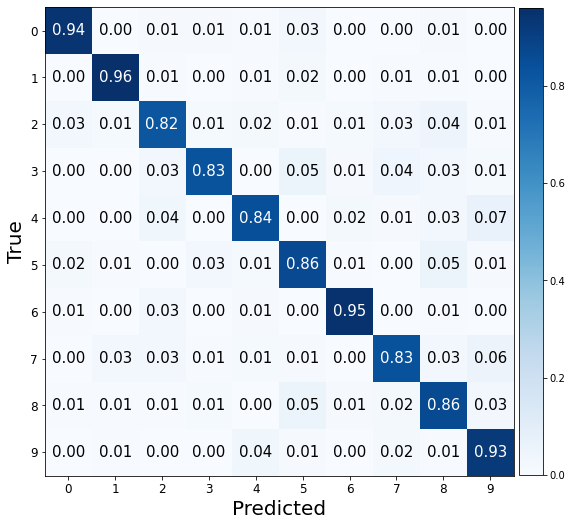

###################

ne: 50, hd:100, wd:0.1, lr: 0.001, bs:256 
Valid Evaluation loss: 1.0538946390151978. f1:0.8566304460164389 acc: 0.8565000295639038 


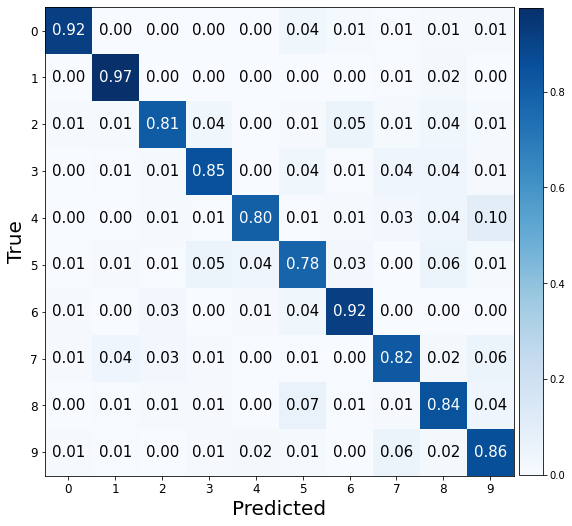

Valid Evaluation loss: 0.40751299262046814. f1:0.8842830785232125 acc: 0.8840000033378601 


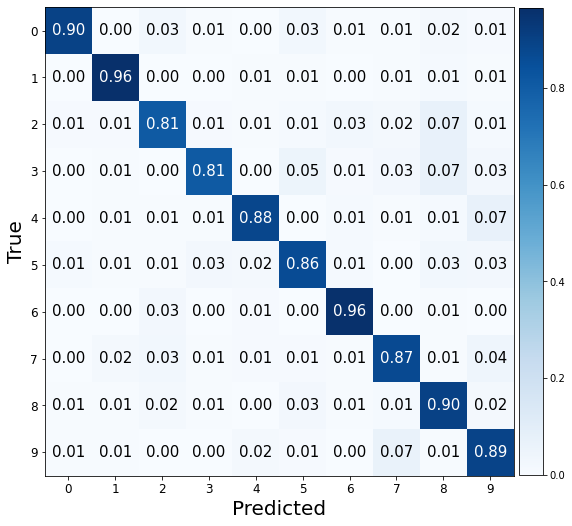

###################

ne: 50, hd:50, wd:0.001, lr: 0.01, bs:256 
Valid Evaluation loss: 1.595041275024414. f1:0.4349231356159636 acc: 0.4625000059604645 


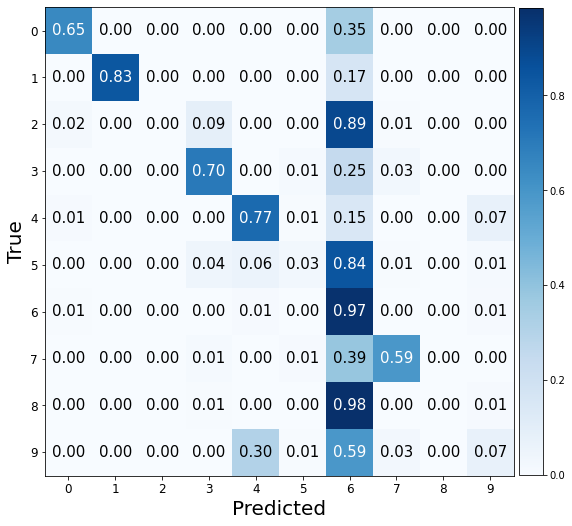

Valid Evaluation loss: 1.127943515777588. f1:0.6402754297454544 acc: 0.6570000052452087 


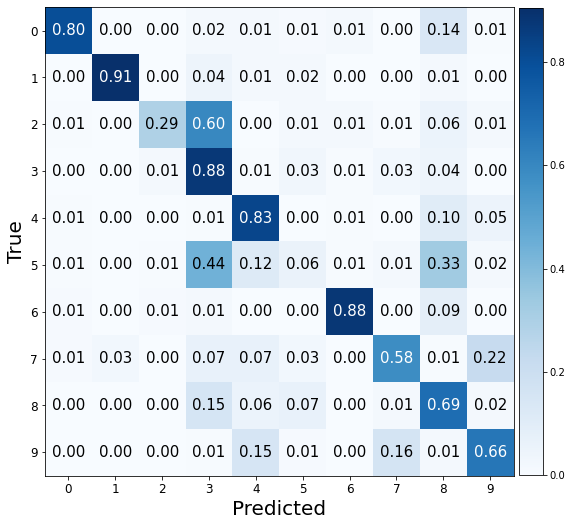

###################

ne: 50, hd:80, wd:0.001, lr: 0.01, bs:256 
Valid Evaluation loss: 1.6966814994812012. f1:0.32690287377774074 acc: 0.36550000309944153 


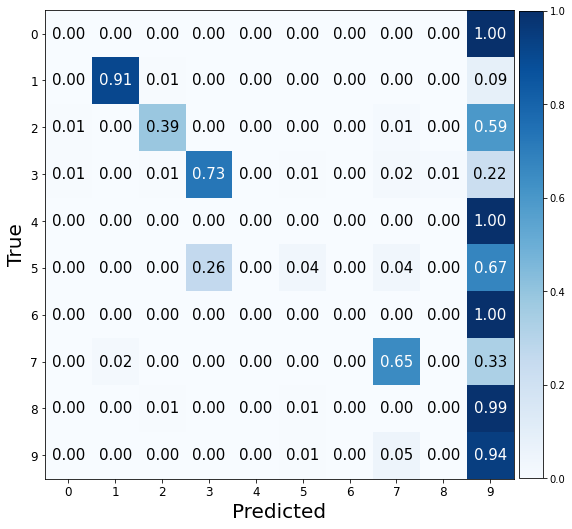

Valid Evaluation loss: 0.9172586798667908. f1:0.7448778628300182 acc: 0.7419999837875366 


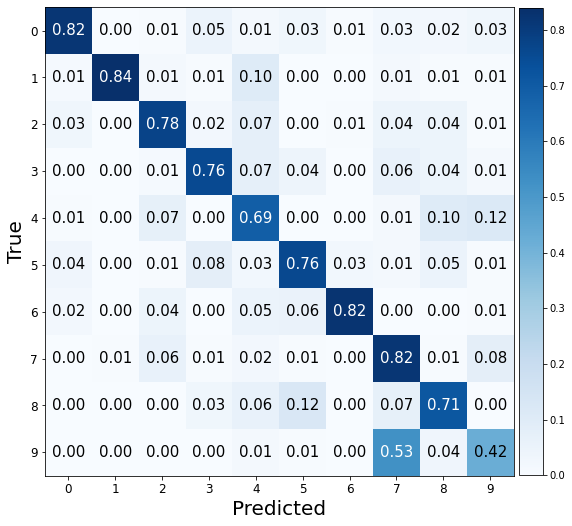

###################

ne: 50, hd:100, wd:0.001, lr: 0.01, bs:256 
Valid Evaluation loss: 0.9875038862228394. f1:0.7364744343708675 acc: 0.7124999761581421 


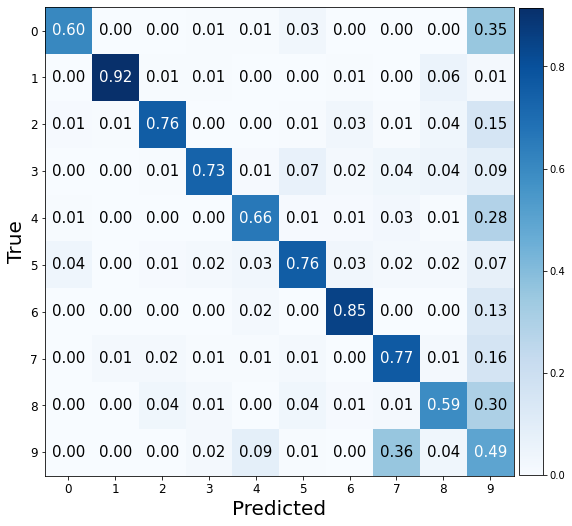

Valid Evaluation loss: 1.2823518514633179. f1:0.6407977162148727 acc: 0.6524999737739563 


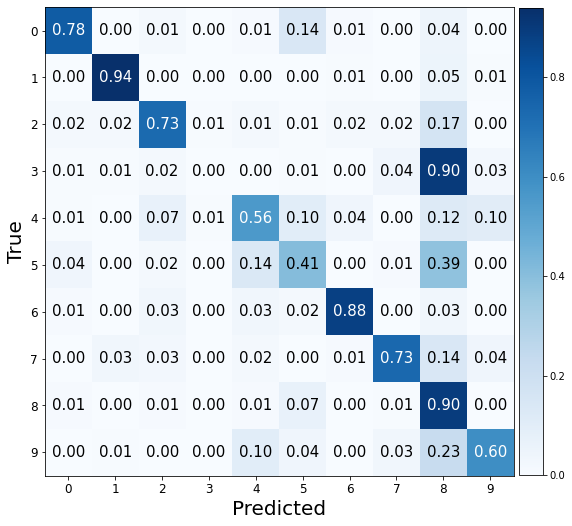

###################

ne: 50, hd:50, wd:0.01, lr: 0.01, bs:256 
Valid Evaluation loss: 1.900251865386963. f1:0.279447346275583 acc: 0.3165000081062317 


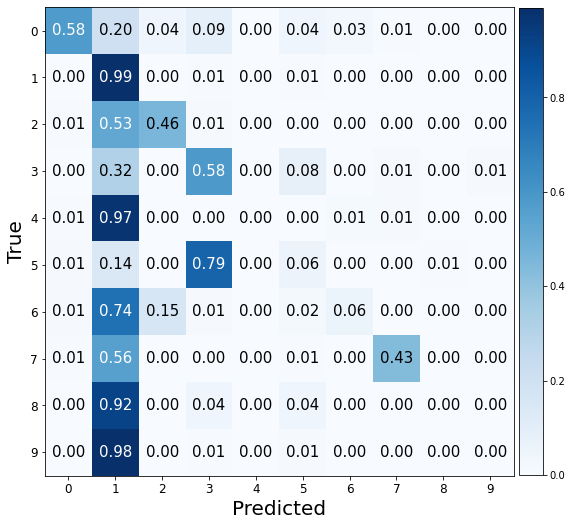

Valid Evaluation loss: 1.165279746055603. f1:0.5632602626272152 acc: 0.6104999780654907 


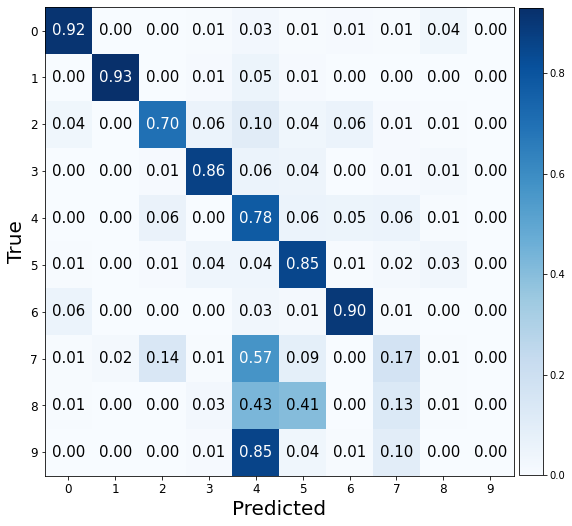

###################

ne: 50, hd:80, wd:0.01, lr: 0.01, bs:256 
Valid Evaluation loss: 2.0184969902038574. f1:0.28470820025305194 acc: 0.3190000057220459 


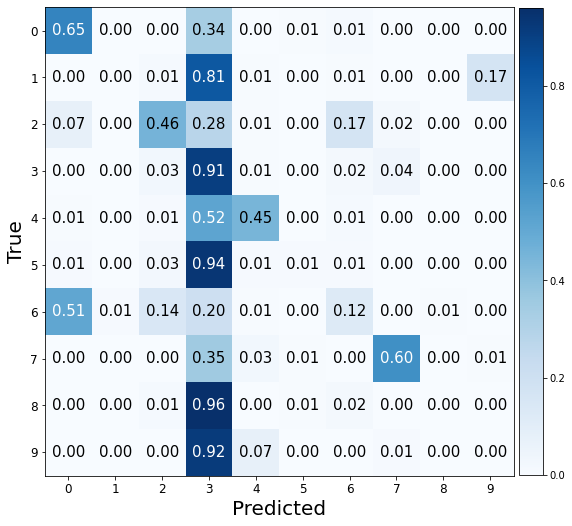

Valid Evaluation loss: 0.6929532289505005. f1:0.8100838607697144 acc: 0.8105000257492065 


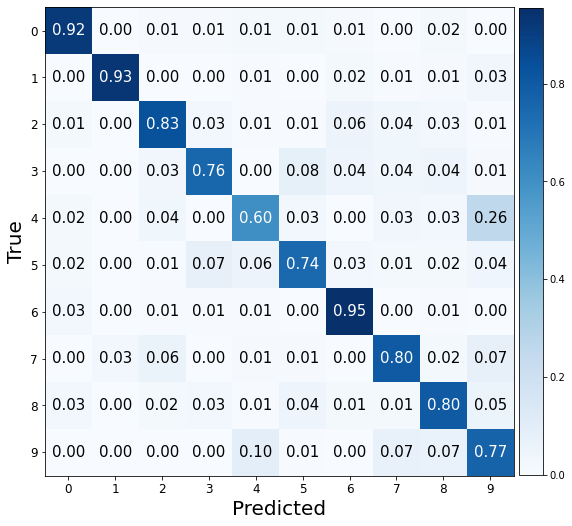

###################

ne: 50, hd:100, wd:0.01, lr: 0.01, bs:256 
Valid Evaluation loss: 1.629600167274475. f1:0.5311409912307854 acc: 0.5504999756813049 


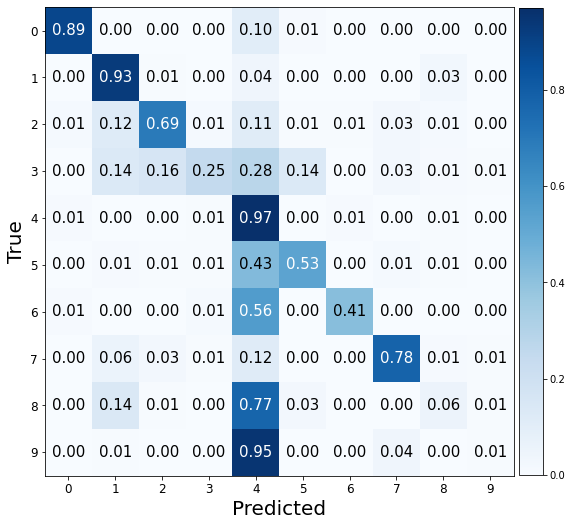

Valid Evaluation loss: 0.8616001009941101. f1:0.753049022942234 acc: 0.7570000290870667 


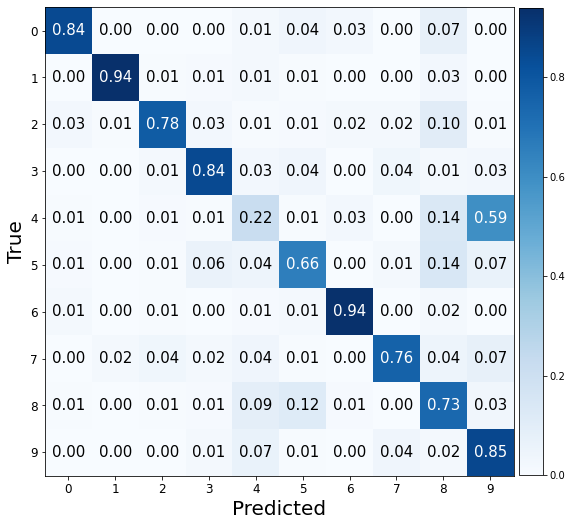

###################

ne: 50, hd:50, wd:0.1, lr: 0.01, bs:256 
Valid Evaluation loss: 1.5335650444030762. f1:0.5236864688426484 acc: 0.49300000071525574 


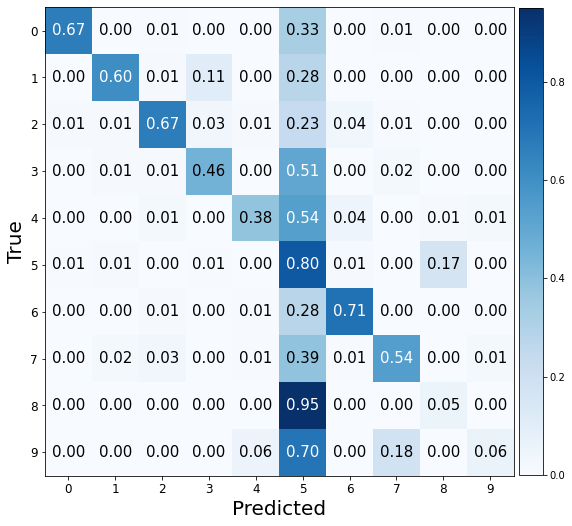

Valid Evaluation loss: 1.4664746522903442. f1:0.3402219259926681 acc: 0.39500001072883606 


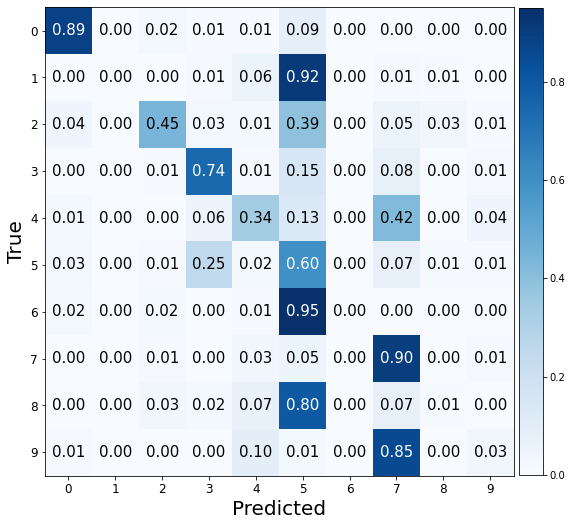

###################

ne: 50, hd:80, wd:0.1, lr: 0.01, bs:256 
Valid Evaluation loss: 1.667862892150879. f1:0.5288384964669526 acc: 0.5149999856948853 


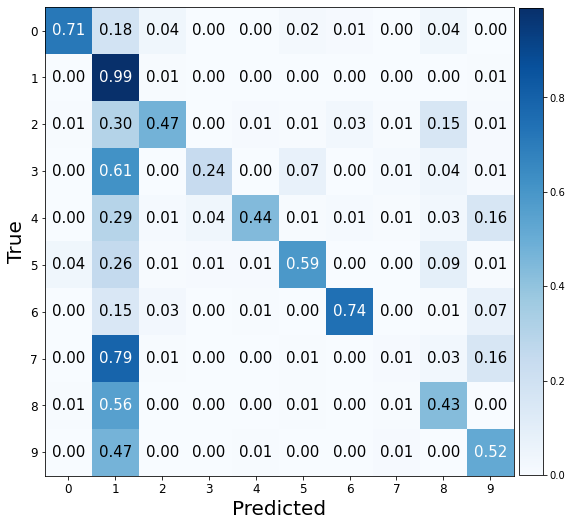

Valid Evaluation loss: 0.609333336353302. f1:0.8158481203780603 acc: 0.8125 


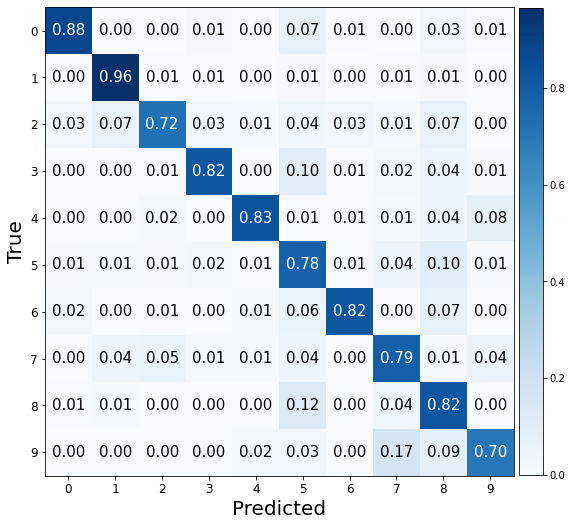

###################

ne: 50, hd:100, wd:0.1, lr: 0.01, bs:256 
Valid Evaluation loss: 1.1877124309539795. f1:0.6511477327591377 acc: 0.6690000295639038 


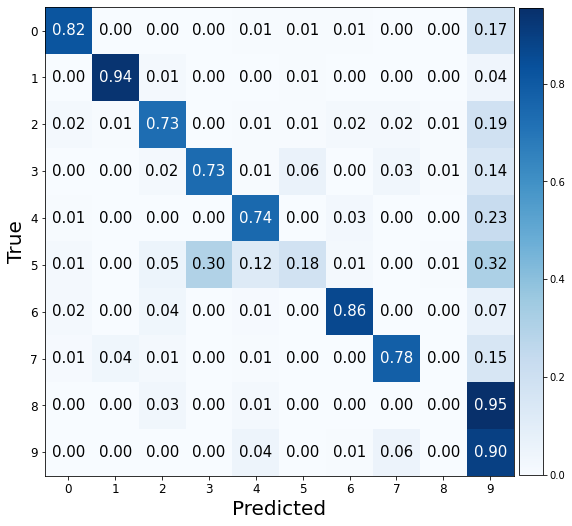

Valid Evaluation loss: 1.2397499084472656. f1:0.5208877388100912 acc: 0.5730000138282776 


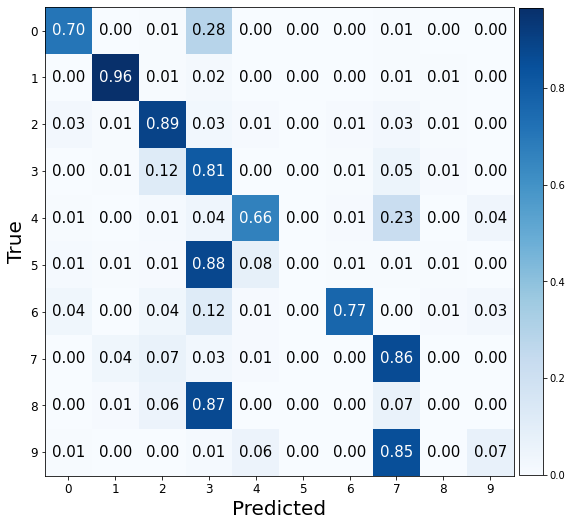

###################

ne: 50, hd:50, wd:0.001, lr: 0.1, bs:256 
Valid Evaluation loss: 2.293581962585449. f1:0.026006485082258234 acc: 0.10400000214576721 


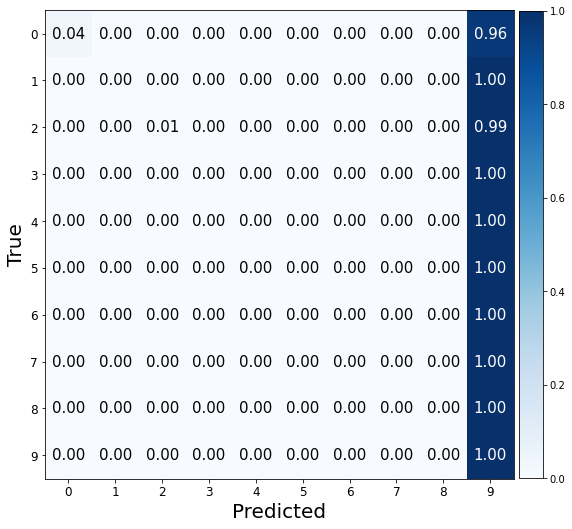

Valid Evaluation loss: 2.3028688430786133. f1:0.01818181818181818 acc: 0.10000000149011612 


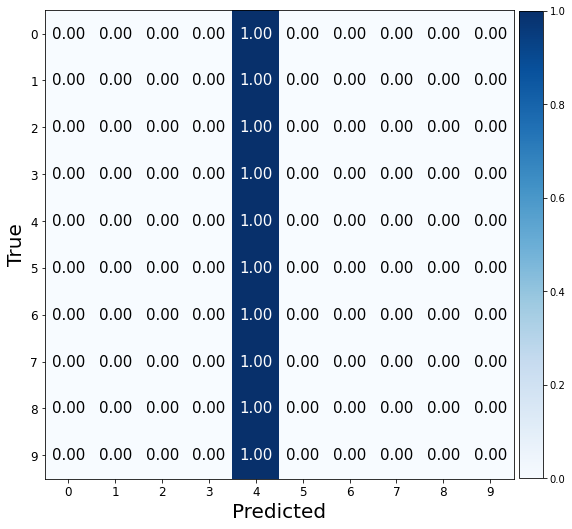

###################

ne: 50, hd:80, wd:0.001, lr: 0.1, bs:256 
Valid Evaluation loss: 2.1917436122894287. f1:0.08063718794312402 acc: 0.14499999582767487 


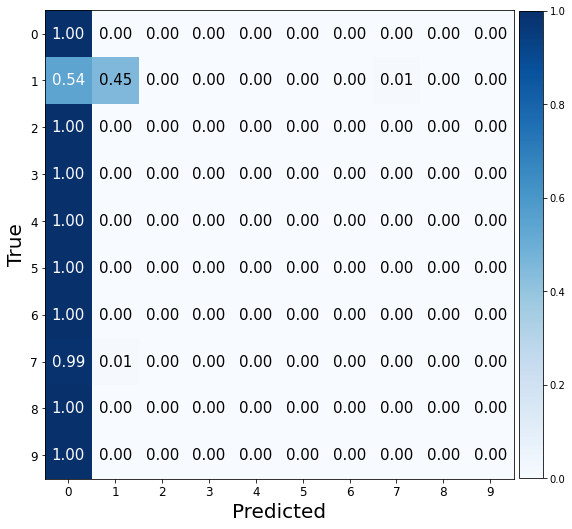

Valid Evaluation loss: 2.301527976989746. f1:0.019185111278532306 acc: 0.10050000250339508 


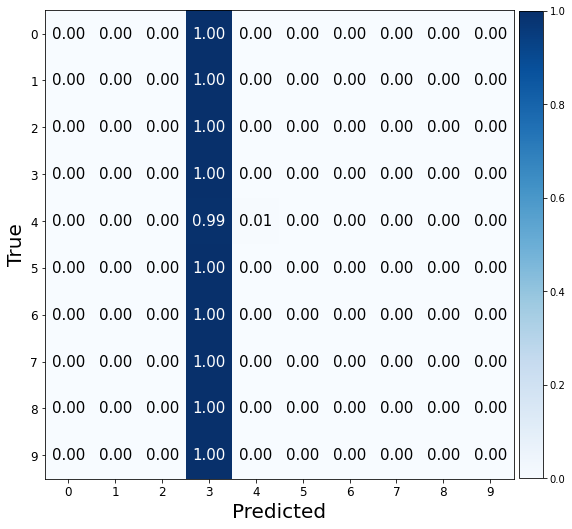

###################

ne: 50, hd:100, wd:0.001, lr: 0.1, bs:256 
Valid Evaluation loss: 3.19877028465271. f1:0.07677803364099571 acc: 0.1354999989271164 


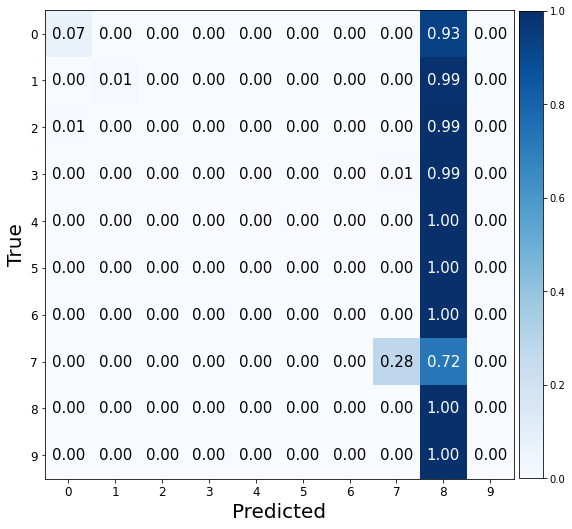

Valid Evaluation loss: 2.2728776931762695. f1:0.04113211266415775 acc: 0.11299999803304672 


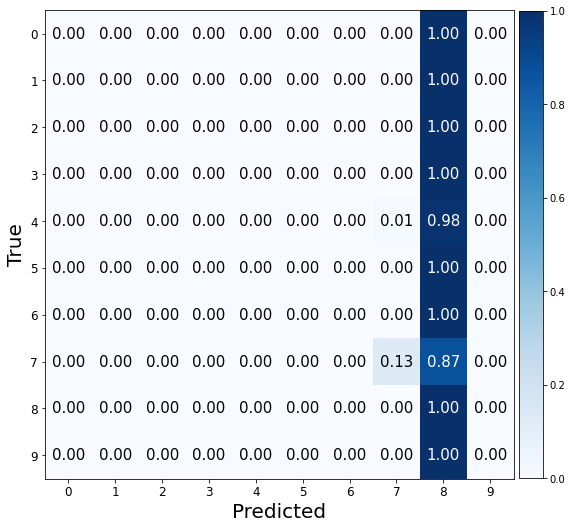

###################

ne: 50, hd:50, wd:0.01, lr: 0.1, bs:256 
Valid Evaluation loss: 2.3017773628234863. f1:0.019185111278532306 acc: 0.10050000250339508 


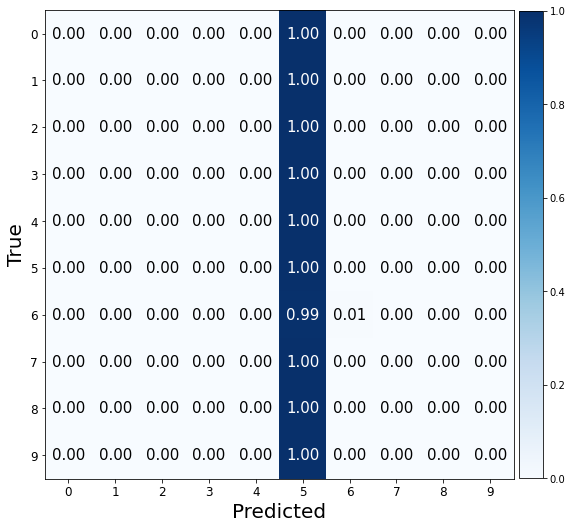

Valid Evaluation loss: 2.262869119644165. f1:0.04752704974311623 acc: 0.11699999868869781 


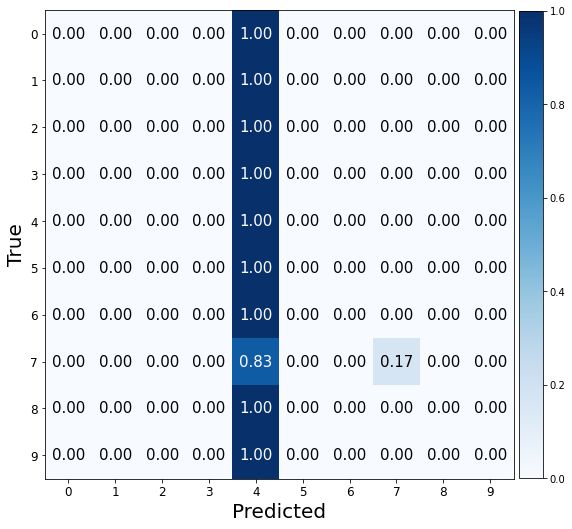

###################

ne: 50, hd:80, wd:0.01, lr: 0.1, bs:256 
Valid Evaluation loss: 2.863903760910034. f1:0.11275389074306741 acc: 0.16200000047683716 


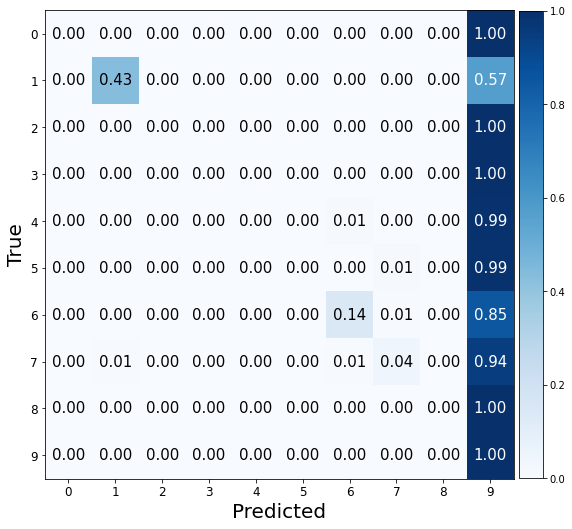

Valid Evaluation loss: 2.3085997104644775. f1:0.020185379597476828 acc: 0.10100000351667404 


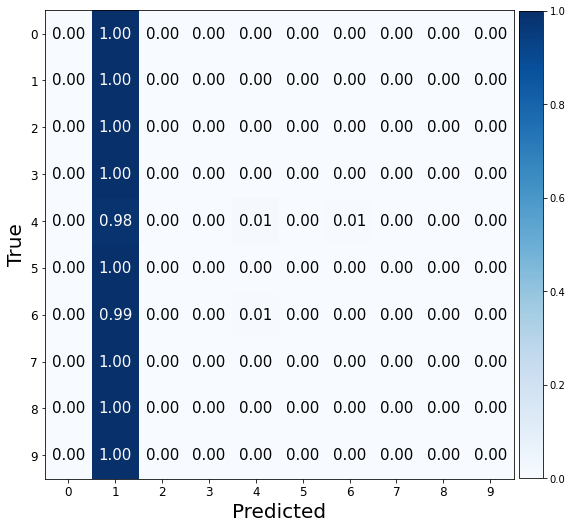

###################

ne: 50, hd:100, wd:0.01, lr: 0.1, bs:256 
Valid Evaluation loss: 2.2737743854522705. f1:0.04298738372258304 acc: 0.11299999803304672 


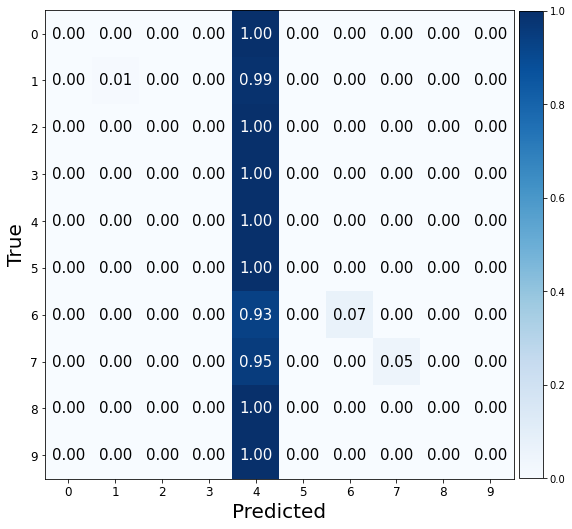

Valid Evaluation loss: 2.3027164936065674. f1:0.01818181818181818 acc: 0.10000000149011612 


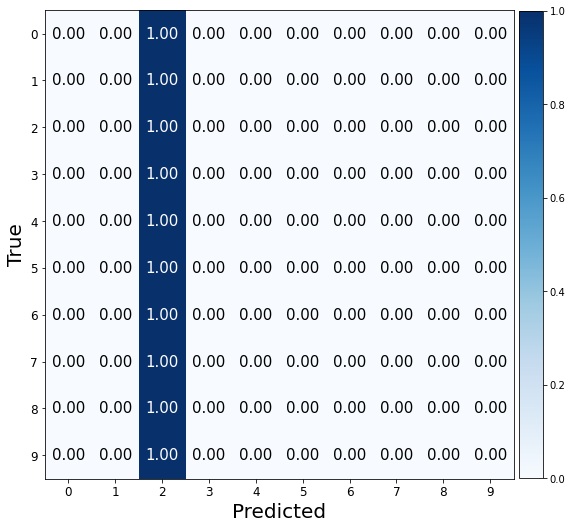

###################

ne: 50, hd:50, wd:0.1, lr: 0.1, bs:256 
Valid Evaluation loss: 2.3015236854553223. f1:0.12660906596788224 acc: 0.17550000548362732 


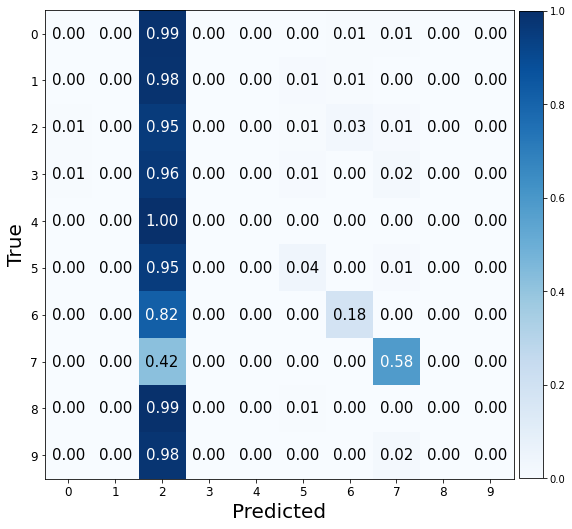

Valid Evaluation loss: 2.3346474170684814. f1:0.024570068609780626 acc: 0.10350000113248825 


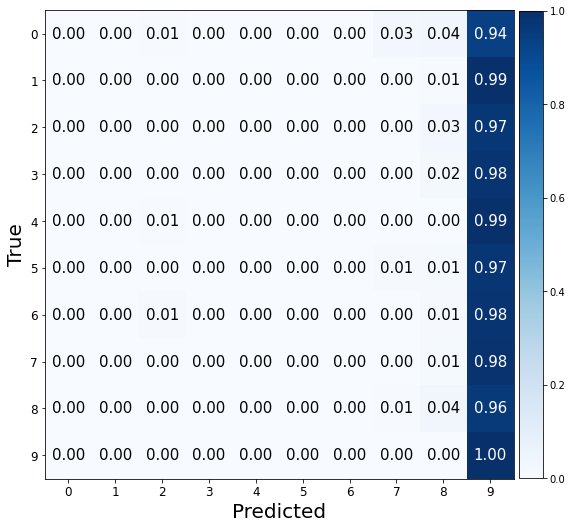

###################

ne: 50, hd:80, wd:0.1, lr: 0.1, bs:256 
Valid Evaluation loss: 2.273967981338501. f1:0.18223790107224783 acc: 0.23399999737739563 


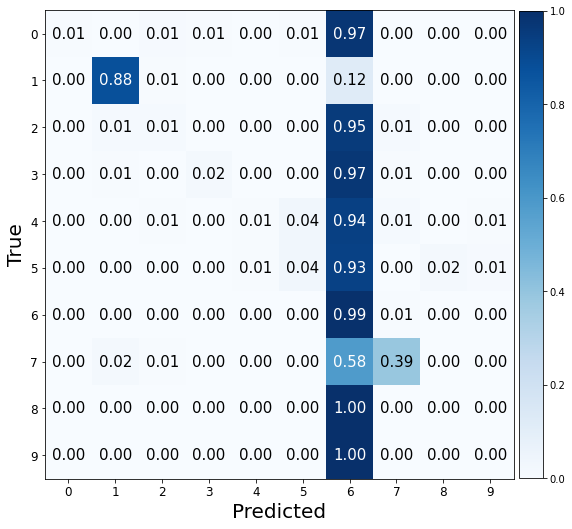

Valid Evaluation loss: 2.3194210529327393. f1:0.11433265203260415 acc: 0.16349999606609344 


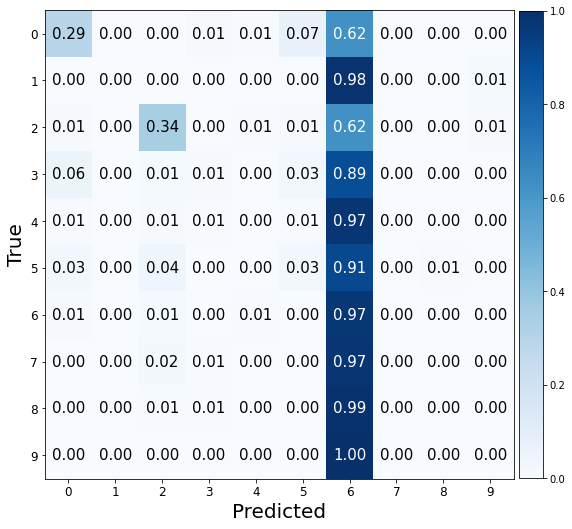

###################

ne: 50, hd:100, wd:0.1, lr: 0.1, bs:256 
Valid Evaluation loss: 2.1880483627319336. f1:0.11857030114584866 acc: 0.1784999966621399 


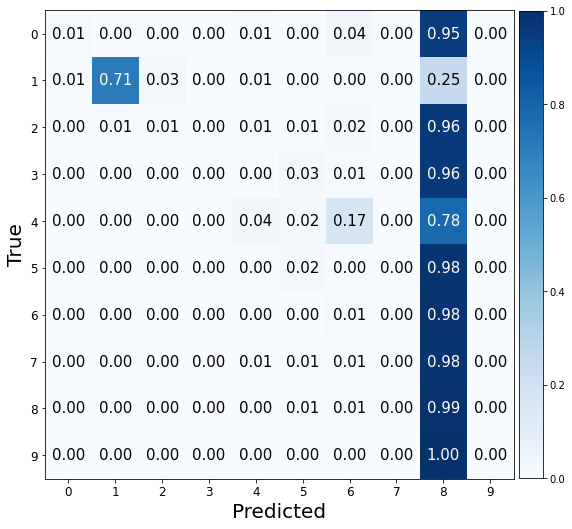

Valid Evaluation loss: 2.3626692295074463. f1:0.12794865647725234 acc: 0.19300000369548798 


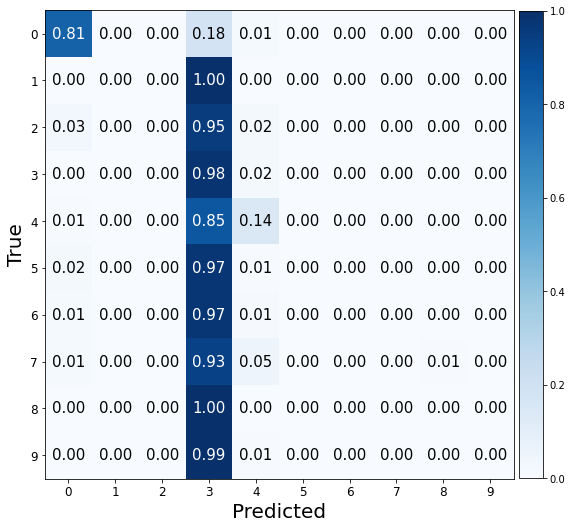

###################

ne: 50, hd:50, wd:0.001, lr: 0.001, bs:512 
Valid Evaluation loss: 0.7629684209823608. f1:0.8201887337963463 acc: 0.8195000290870667 


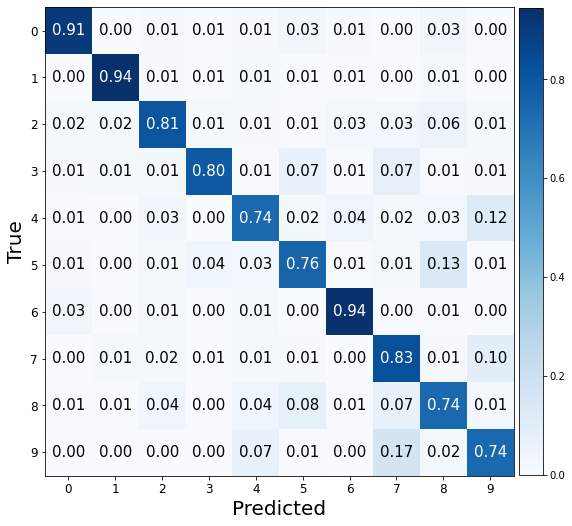

Valid Evaluation loss: 0.5502015352249146. f1:0.8473944035756789 acc: 0.847000002861023 


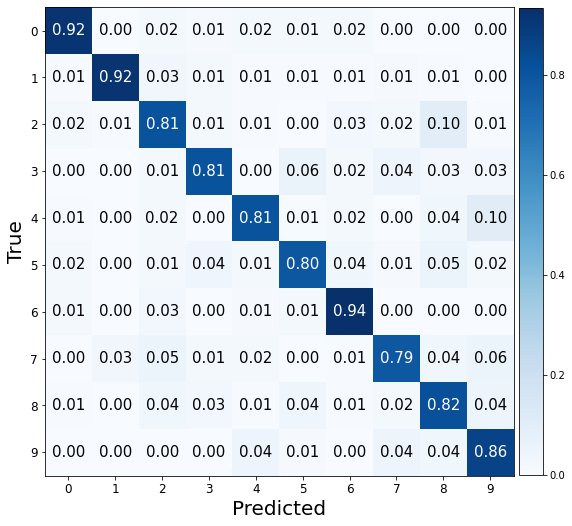

###################

ne: 50, hd:80, wd:0.001, lr: 0.001, bs:512 
Valid Evaluation loss: 0.9868746995925903. f1:0.8670184014846484 acc: 0.8669999837875366 


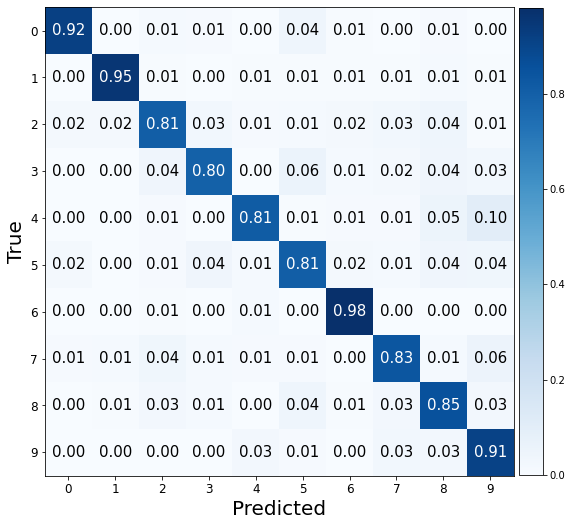

Valid Evaluation loss: 0.3854306638240814. f1:0.893519336781566 acc: 0.8934999704360962 


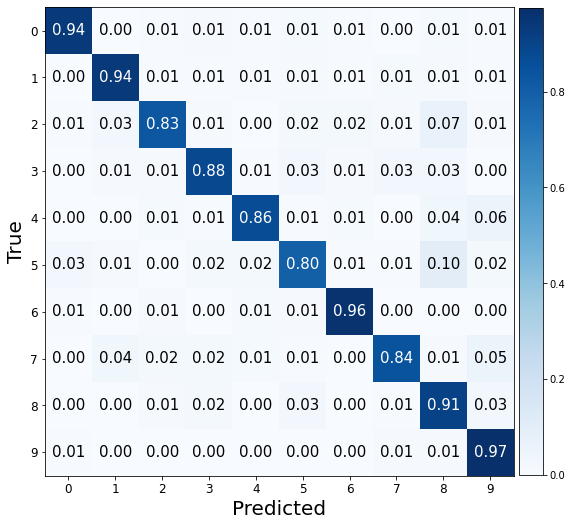

###################

ne: 50, hd:100, wd:0.001, lr: 0.001, bs:512 
Valid Evaluation loss: 0.8622193932533264. f1:0.8682014588307251 acc: 0.8679999709129333 


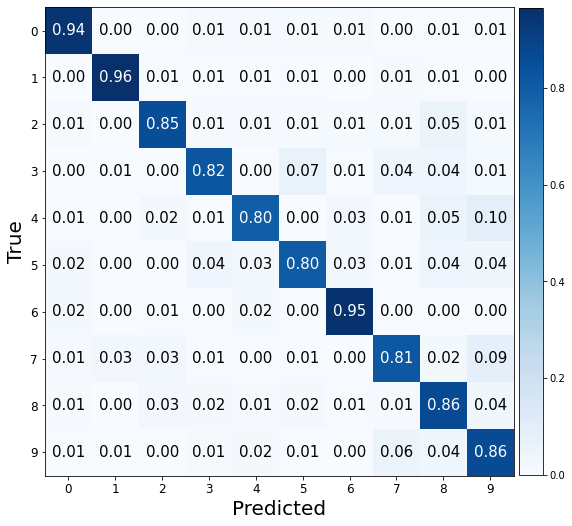

Valid Evaluation loss: 0.40056565403938293. f1:0.8829681824141646 acc: 0.8830000162124634 


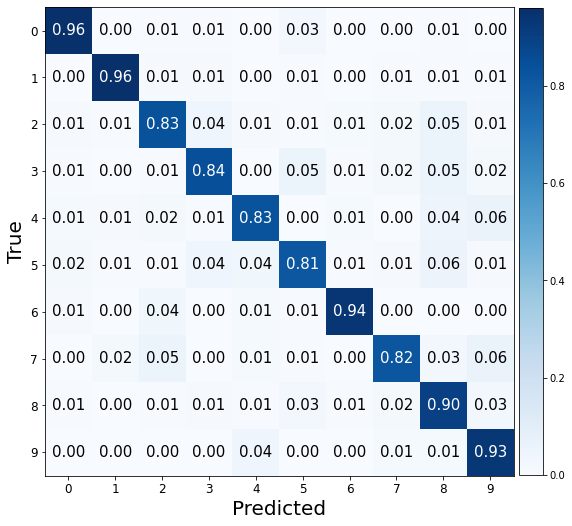

###################

ne: 50, hd:50, wd:0.01, lr: 0.001, bs:512 
Valid Evaluation loss: 1.0403105020523071. f1:0.8474958346099966 acc: 0.8475000262260437 


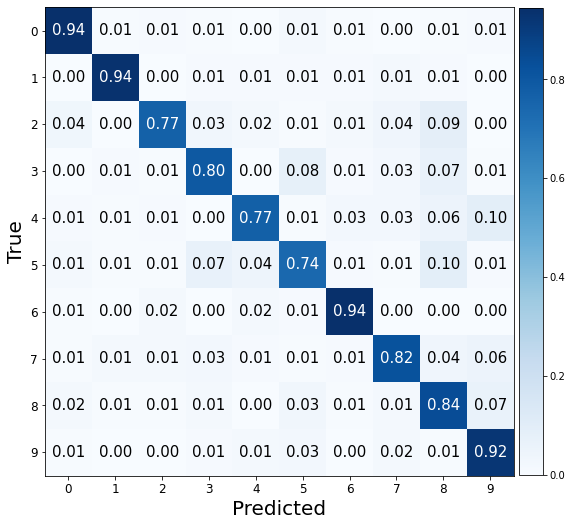

Valid Evaluation loss: 0.5952252745628357. f1:0.8374008605337151 acc: 0.8374999761581421 


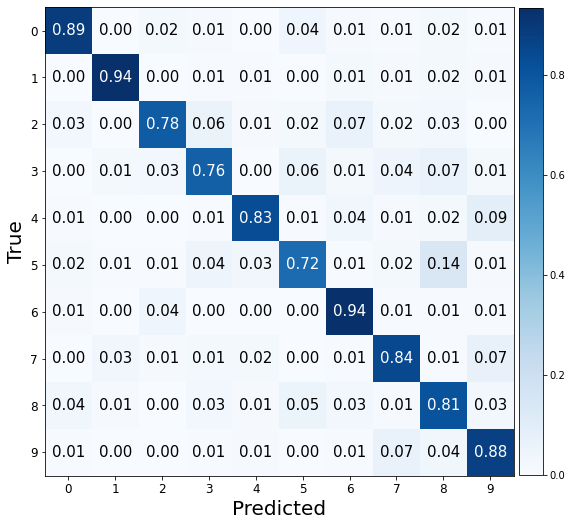

###################

ne: 50, hd:80, wd:0.01, lr: 0.001, bs:512 
Valid Evaluation loss: 0.9484764933586121. f1:0.8291586761054426 acc: 0.8295000195503235 


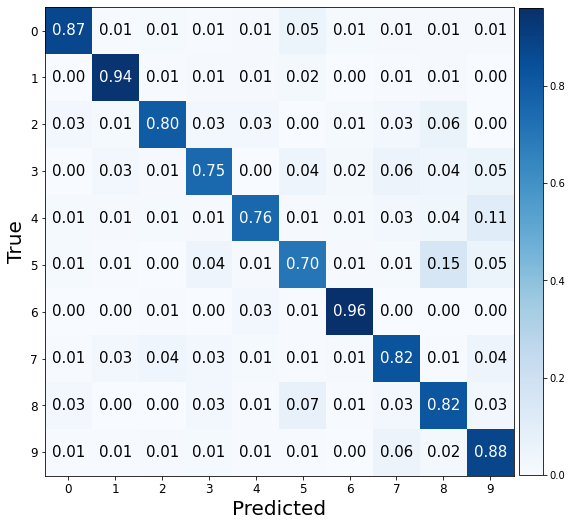

Valid Evaluation loss: 0.40148574113845825. f1:0.8882115284596285 acc: 0.8884999752044678 


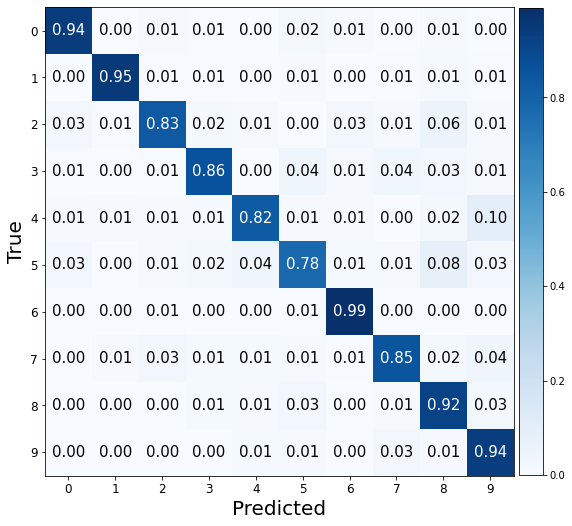

###################

ne: 50, hd:100, wd:0.01, lr: 0.001, bs:512 
Valid Evaluation loss: 0.6818991899490356. f1:0.8706214772109838 acc: 0.8705000281333923 


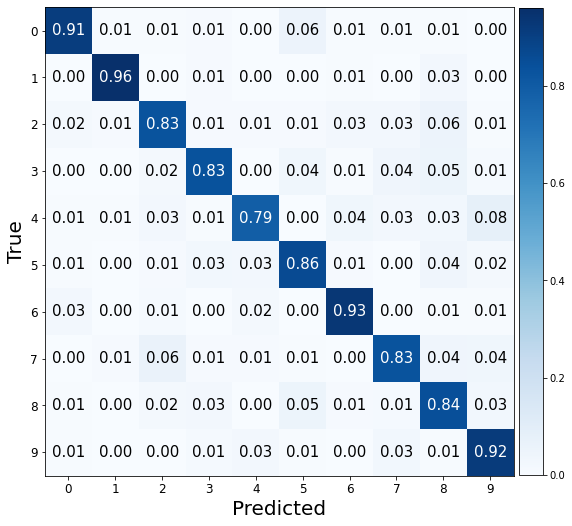

Valid Evaluation loss: 0.3759538531303406. f1:0.8959968796511179 acc: 0.8960000276565552 


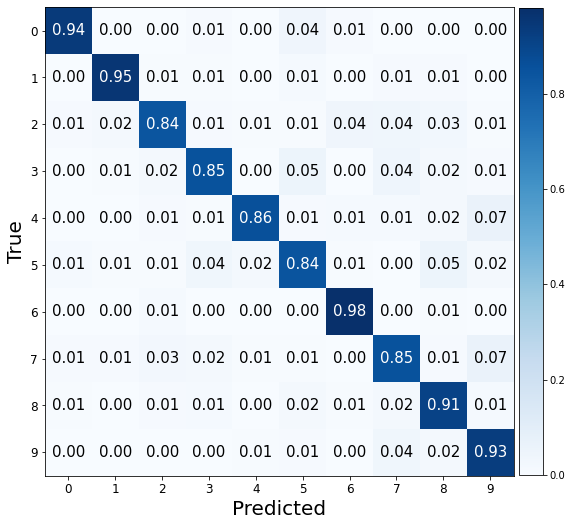

###################

ne: 50, hd:50, wd:0.1, lr: 0.001, bs:512 
Valid Evaluation loss: 0.8955478668212891. f1:0.8388803602886779 acc: 0.8385000228881836 


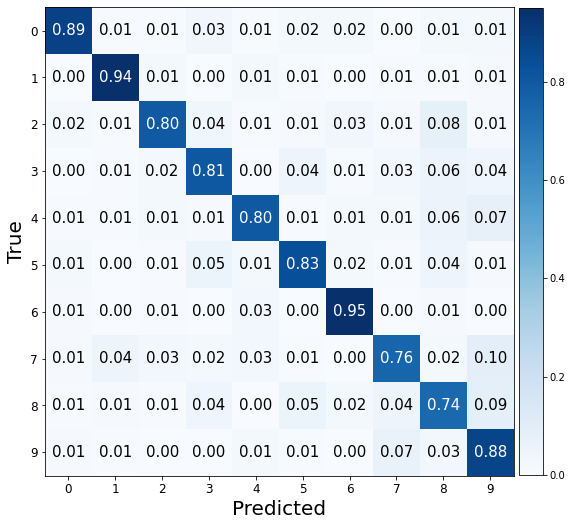

Valid Evaluation loss: 0.437649667263031. f1:0.8699650517777096 acc: 0.8700000047683716 


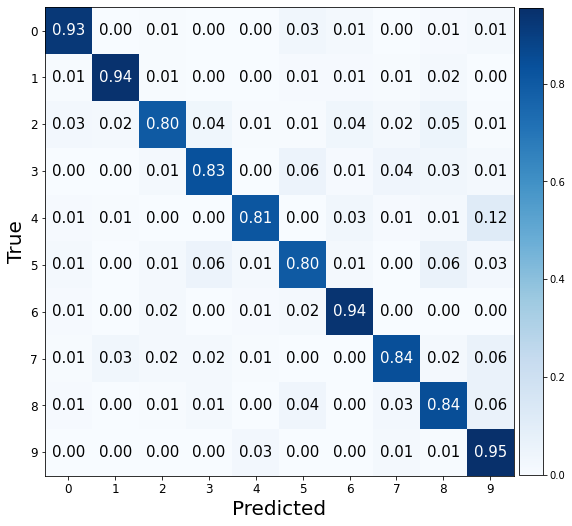

###################

ne: 50, hd:80, wd:0.1, lr: 0.001, bs:512 
Valid Evaluation loss: 0.7712109088897705. f1:0.846699787516731 acc: 0.847000002861023 


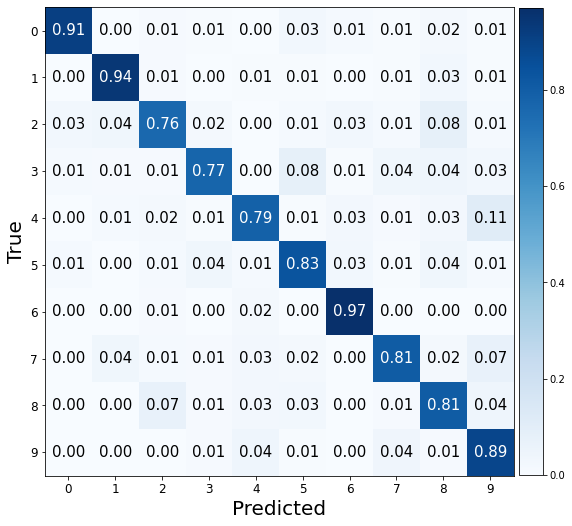

Valid Evaluation loss: 0.4229871928691864. f1:0.8702799597374465 acc: 0.8700000047683716 


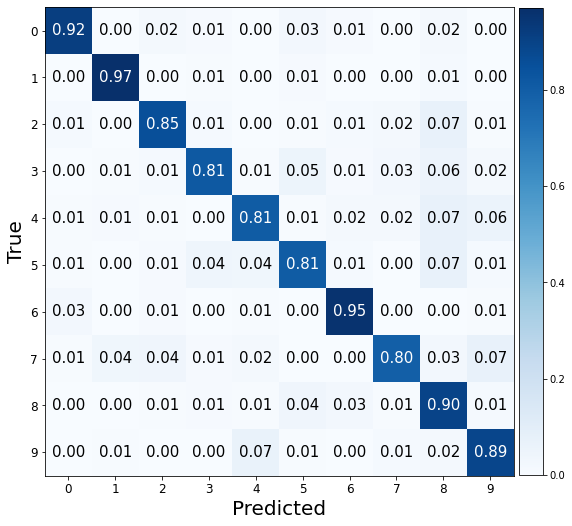

###################

ne: 50, hd:100, wd:0.1, lr: 0.001, bs:512 
Valid Evaluation loss: 0.6896128058433533. f1:0.8525552336759883 acc: 0.8535000085830688 


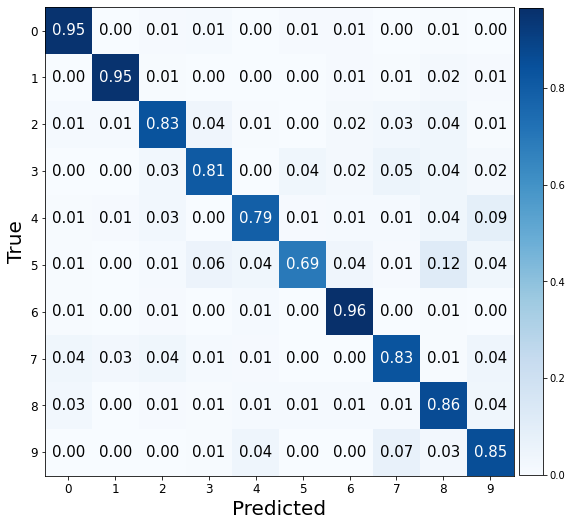

Valid Evaluation loss: 0.32276904582977295. f1:0.8963983301213668 acc: 0.8964999914169312 


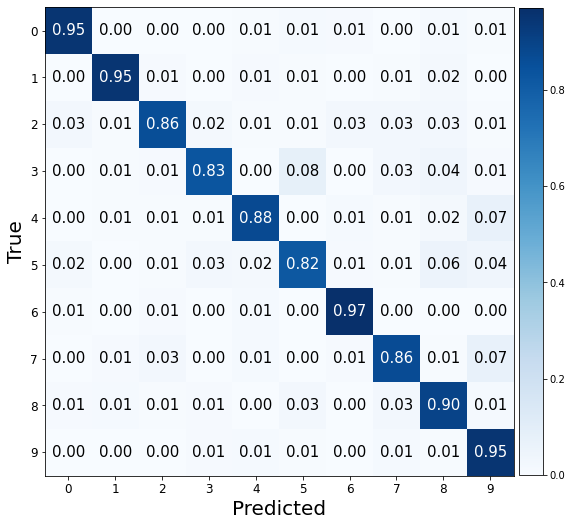

###################

ne: 50, hd:50, wd:0.001, lr: 0.01, bs:512 
Valid Evaluation loss: 1.6232452392578125. f1:0.38655045472413485 acc: 0.4065000116825104 


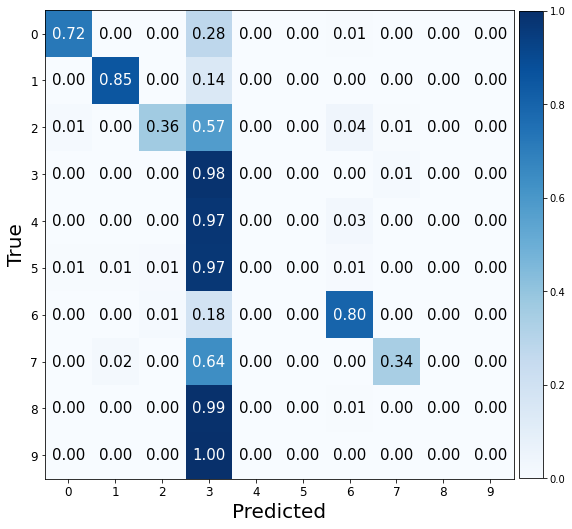

Valid Evaluation loss: 1.0236059427261353. f1:0.7261766494882224 acc: 0.7204999923706055 


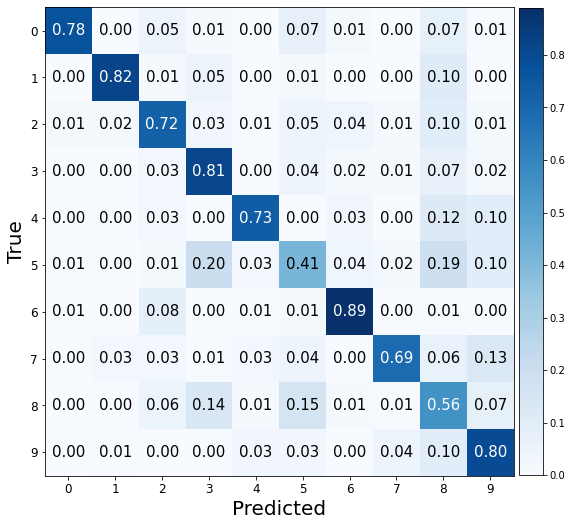

###################

ne: 50, hd:80, wd:0.001, lr: 0.01, bs:512 
Valid Evaluation loss: 1.502797245979309. f1:0.5119796594397001 acc: 0.5239999890327454 


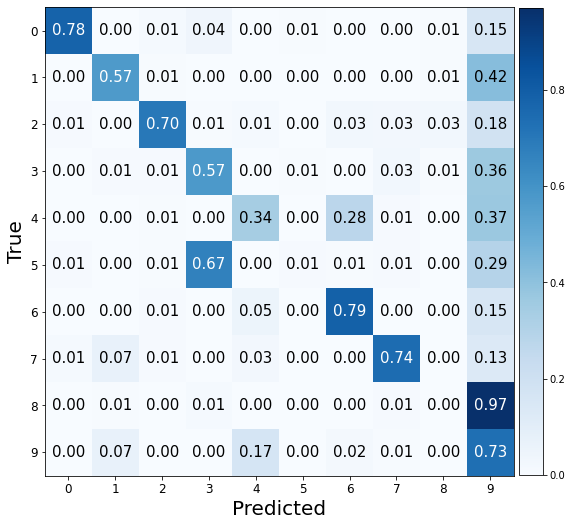

Valid Evaluation loss: 1.025359869003296. f1:0.6904862808400674 acc: 0.7059999704360962 


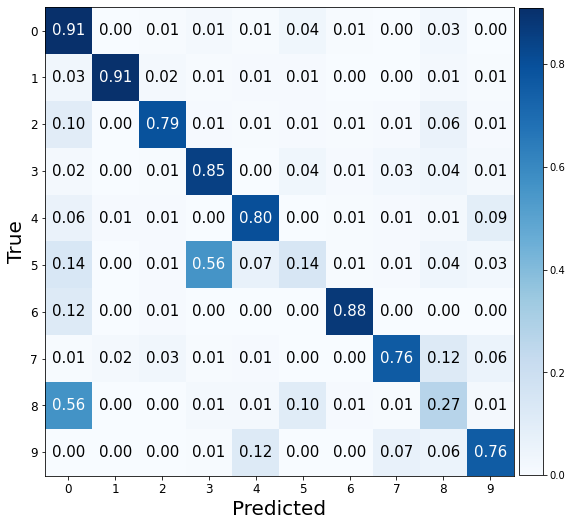

###################

ne: 50, hd:100, wd:0.001, lr: 0.01, bs:512 
Valid Evaluation loss: 1.4959534406661987. f1:0.47403776289939314 acc: 0.4964999854564667 


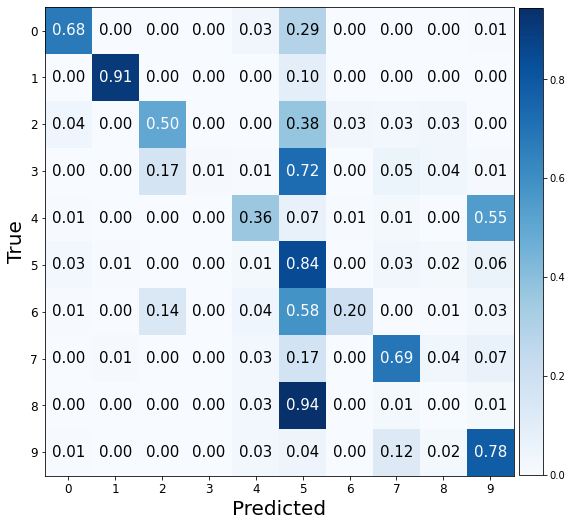

Valid Evaluation loss: 1.336862325668335. f1:0.521370295123426 acc: 0.5584999918937683 


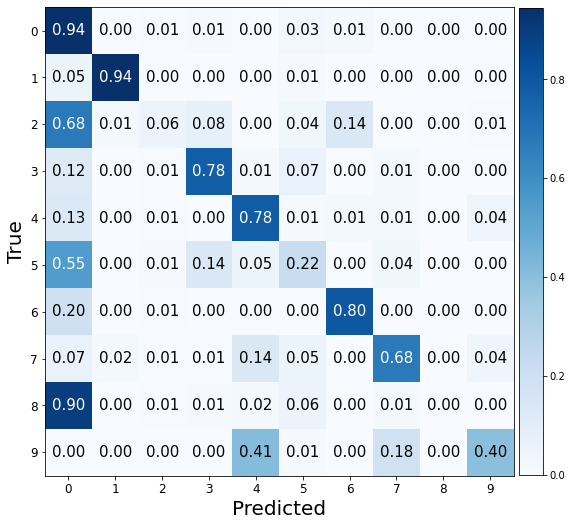

###################

ne: 50, hd:50, wd:0.01, lr: 0.01, bs:512 
Valid Evaluation loss: 1.6089133024215698. f1:0.44992080741417934 acc: 0.47099998593330383 


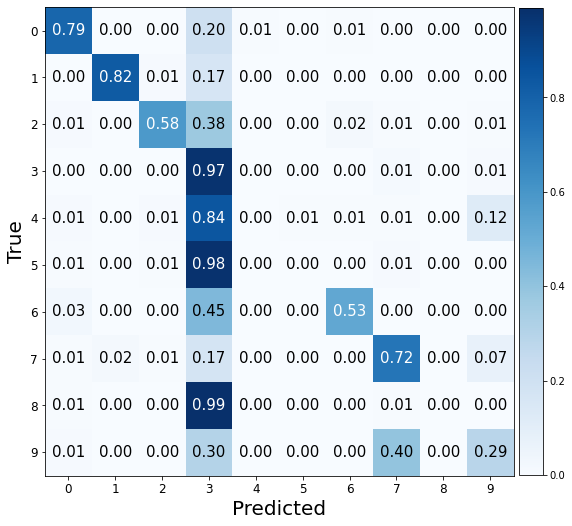

Valid Evaluation loss: 0.9084676504135132. f1:0.7665604941882032 acc: 0.7670000195503235 


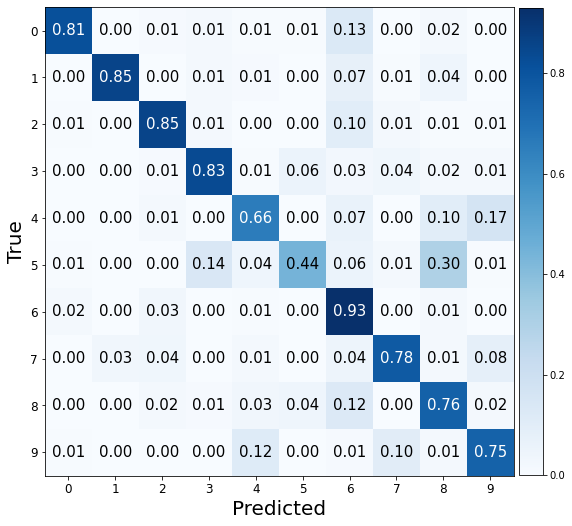

###################

ne: 50, hd:80, wd:0.01, lr: 0.01, bs:512 
Valid Evaluation loss: 2.010524034500122. f1:0.2920989556475217 acc: 0.3165000081062317 


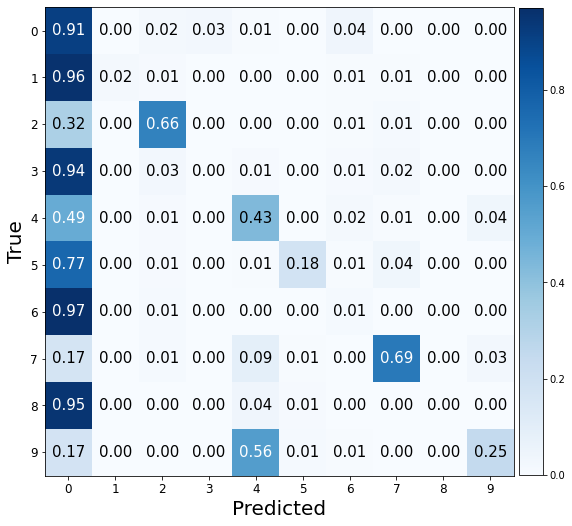

Valid Evaluation loss: 0.6411640048027039. f1:0.813520440034044 acc: 0.8130000233650208 


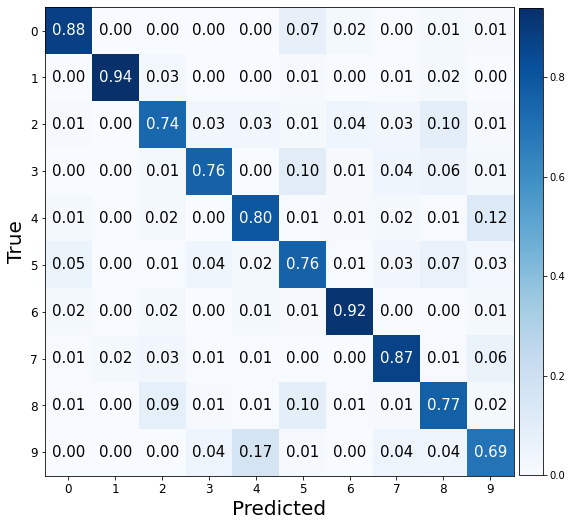

###################

ne: 50, hd:100, wd:0.01, lr: 0.01, bs:512 
Valid Evaluation loss: 1.4223301410675049. f1:0.5625546536332624 acc: 0.5774999856948853 


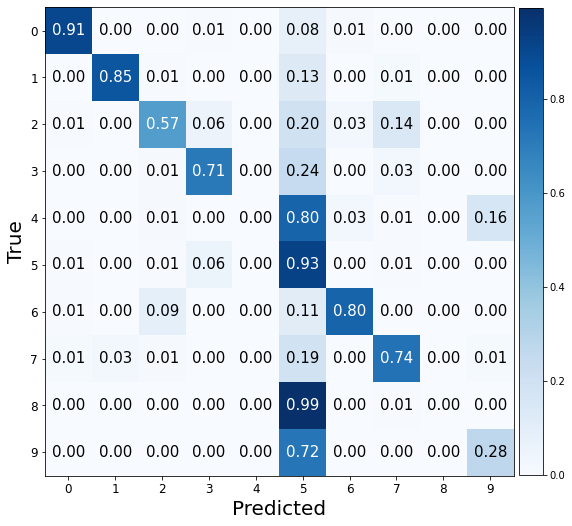

Valid Evaluation loss: 1.7236182689666748. f1:0.29031430777203227 acc: 0.34549999237060547 


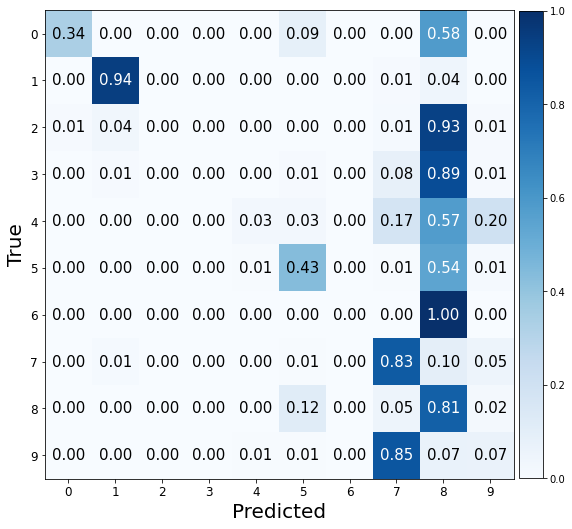

###################

ne: 50, hd:50, wd:0.1, lr: 0.01, bs:512 
Valid Evaluation loss: 1.6743868589401245. f1:0.4626326695696152 acc: 0.47749999165534973 


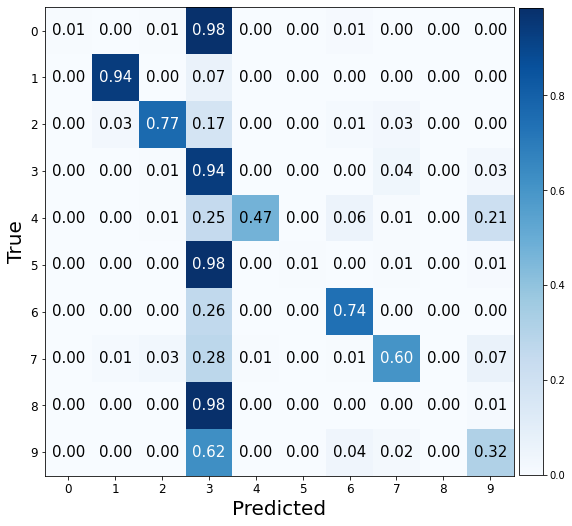

Valid Evaluation loss: 1.1947262287139893. f1:0.5364077415871709 acc: 0.5674999952316284 


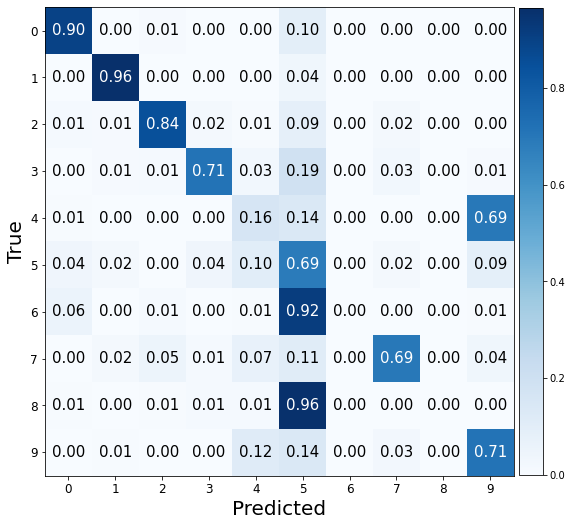

###################

ne: 50, hd:80, wd:0.1, lr: 0.01, bs:512 
Valid Evaluation loss: 1.481292724609375. f1:0.4372102607033851 acc: 0.4945000112056732 


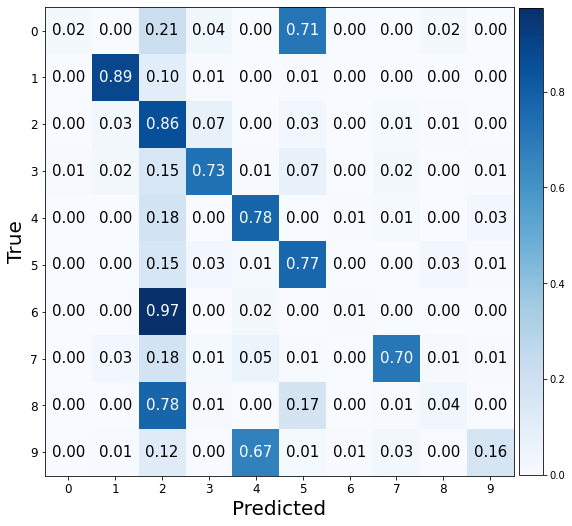

Valid Evaluation loss: 0.6427085995674133. f1:0.8064870760418714 acc: 0.8105000257492065 


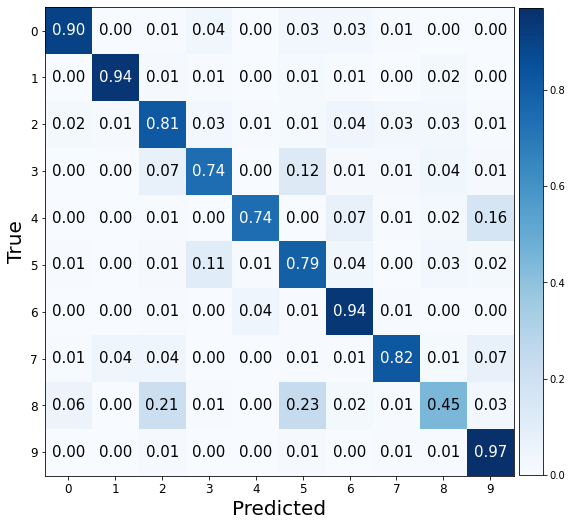

###################

ne: 50, hd:100, wd:0.1, lr: 0.01, bs:512 
Valid Evaluation loss: 1.2271478176116943. f1:0.5960959695133589 acc: 0.6119999885559082 


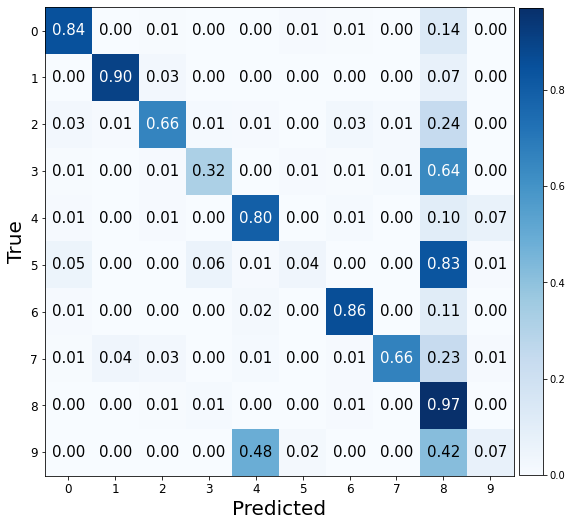

Valid Evaluation loss: 0.5539147853851318. f1:0.8387372145581748 acc: 0.8385000228881836 


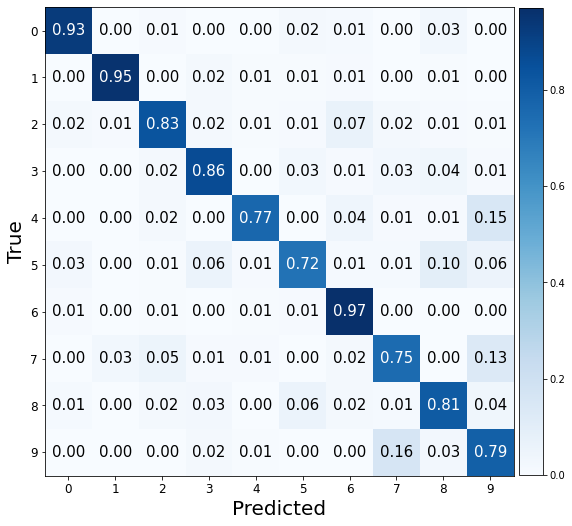

###################

ne: 50, hd:50, wd:0.001, lr: 0.1, bs:512 
Valid Evaluation loss: 2.2795252799987793. f1:0.03653044203502919 acc: 0.10999999940395355 


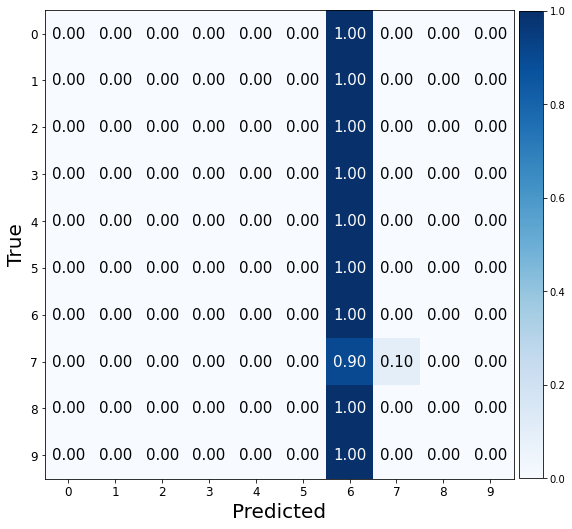

Valid Evaluation loss: 2.30424427986145. f1:0.01818181818181818 acc: 0.10000000149011612 


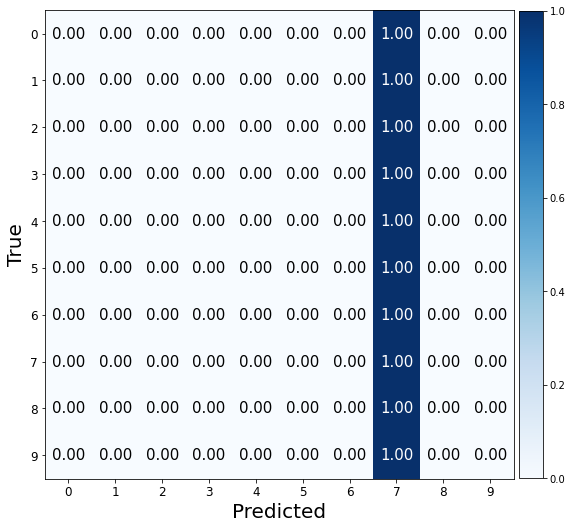

###################

ne: 50, hd:80, wd:0.001, lr: 0.1, bs:512 
Valid Evaluation loss: 2.376774311065674. f1:0.061625466417910446 acc: 0.1274999976158142 


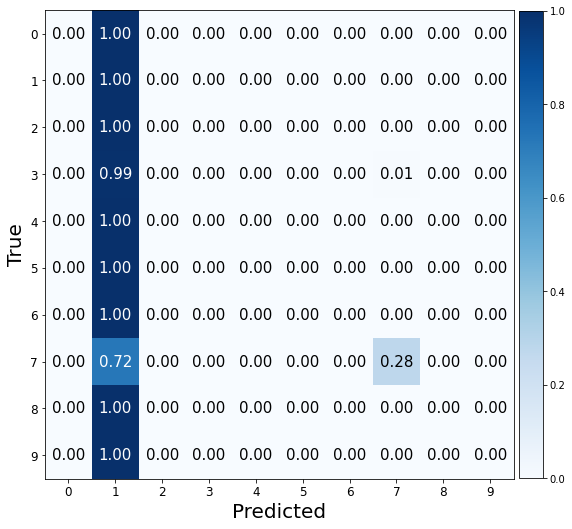

Valid Evaluation loss: 2.302955389022827. f1:0.01818181818181818 acc: 0.10000000149011612 


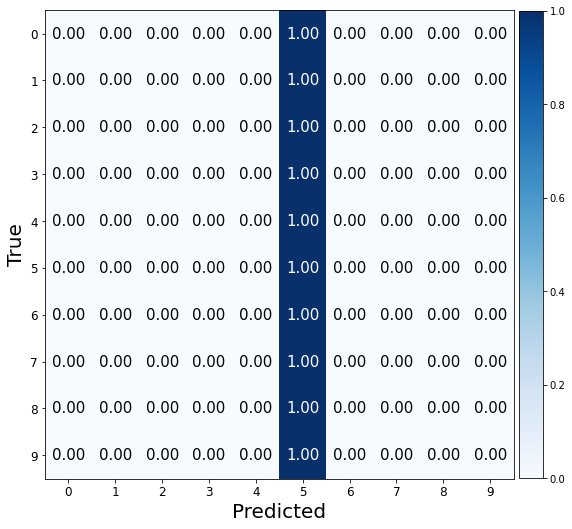

###################

ne: 50, hd:100, wd:0.001, lr: 0.1, bs:512 
Valid Evaluation loss: 2.29617977142334. f1:0.024104614221287457 acc: 0.10300000011920929 


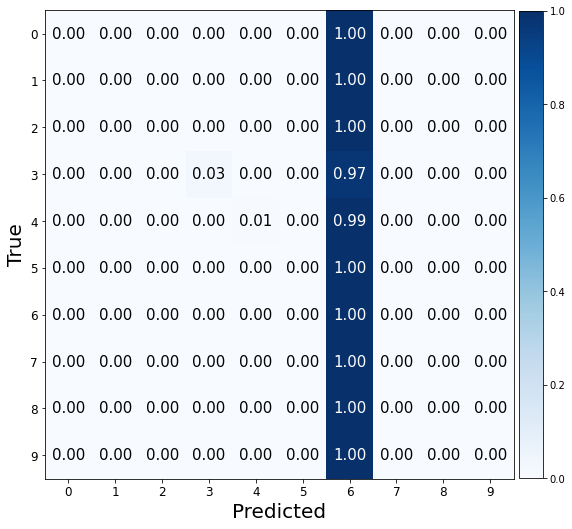

Valid Evaluation loss: 2.3028101921081543. f1:0.01818181818181818 acc: 0.10000000149011612 


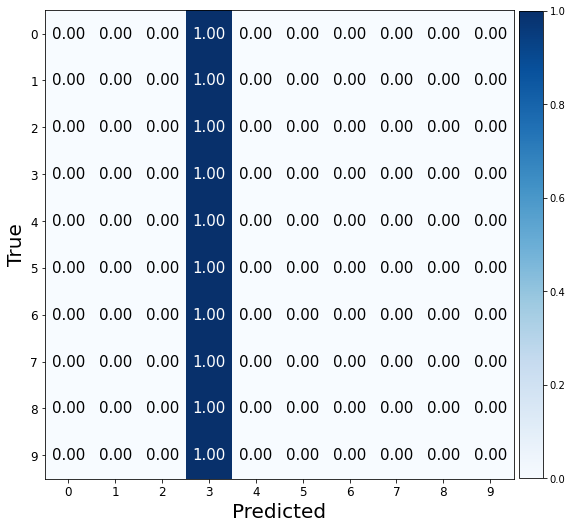

###################

ne: 50, hd:50, wd:0.01, lr: 0.1, bs:512 
Valid Evaluation loss: 2.195462226867676. f1:0.0790613360149784 acc: 0.14300000667572021 


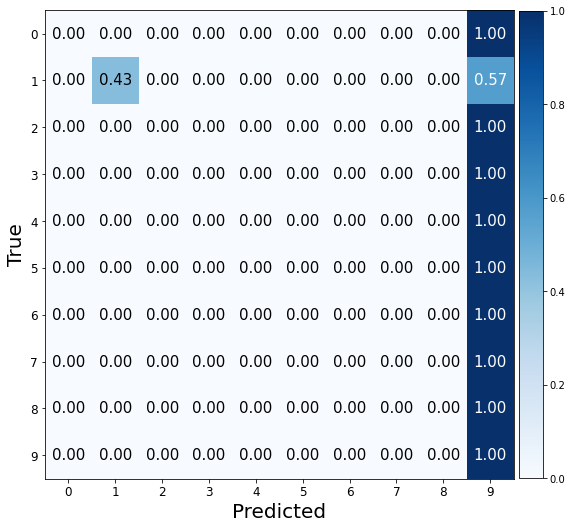

Valid Evaluation loss: 2.3030405044555664. f1:0.018190086402910415 acc: 0.10000000149011612 


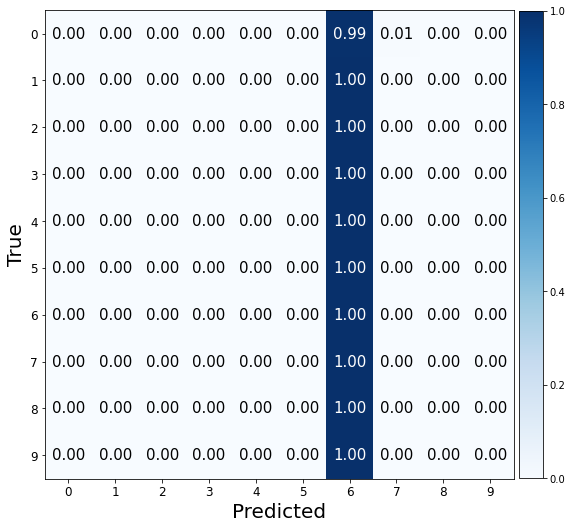

###################

ne: 50, hd:80, wd:0.01, lr: 0.1, bs:512 
Valid Evaluation loss: 2.7886157035827637. f1:0.11451308267678426 acc: 0.16300000250339508 


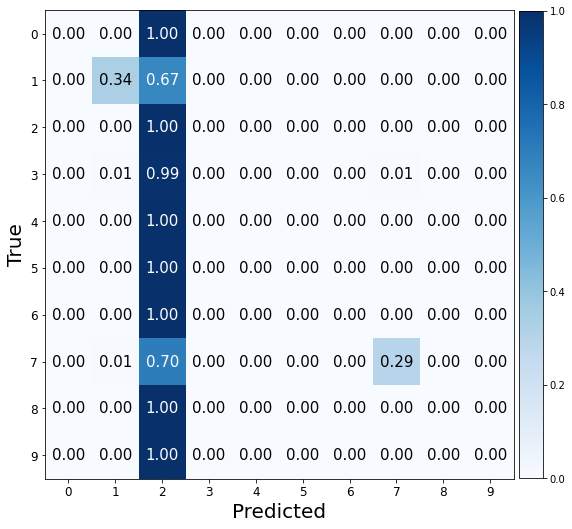

Valid Evaluation loss: 2.301372766494751. f1:0.019193387023028627 acc: 0.10050000250339508 


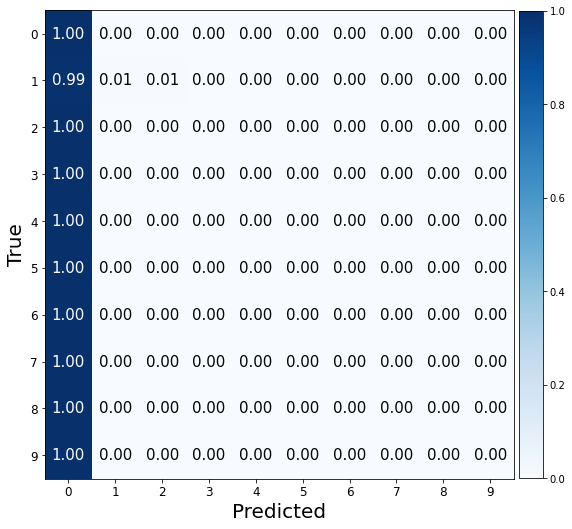

###################

ne: 50, hd:100, wd:0.01, lr: 0.1, bs:512 
Valid Evaluation loss: 3.042179584503174. f1:0.040531625052433524 acc: 0.11249999701976776 


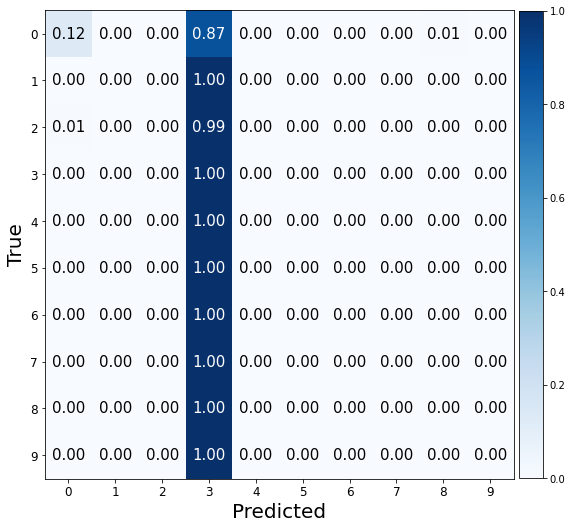

Valid Evaluation loss: 2.3031630516052246. f1:0.01818181818181818 acc: 0.10000000149011612 


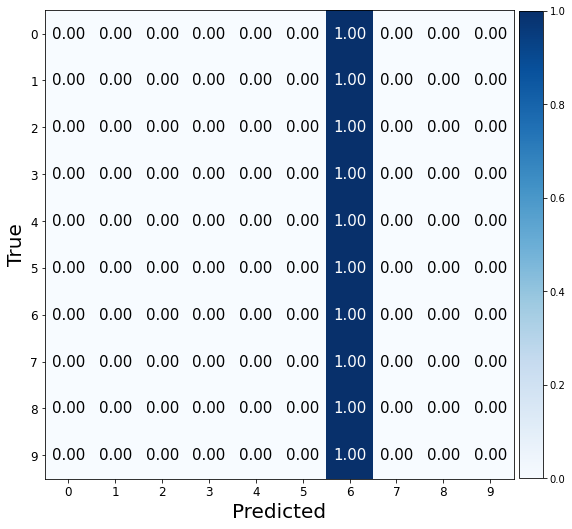

###################

ne: 50, hd:50, wd:0.1, lr: 0.1, bs:512 
Valid Evaluation loss: 2.3236162662506104. f1:0.02822245623220136 acc: 0.10499999672174454 


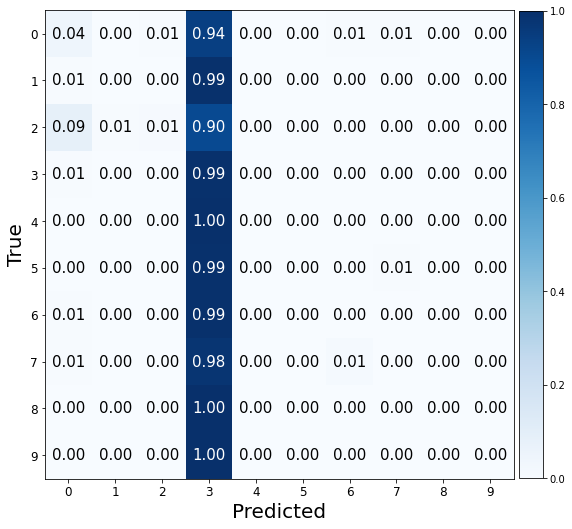

Valid Evaluation loss: 2.3143794536590576. f1:0.054732780889628053 acc: 0.12300000339746475 


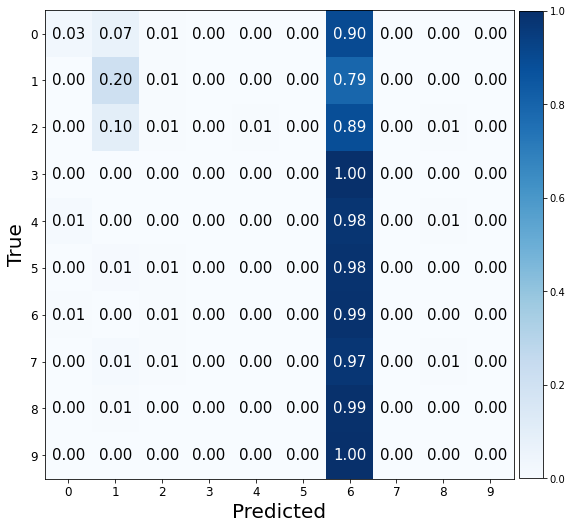

###################

ne: 50, hd:80, wd:0.1, lr: 0.1, bs:512 
Valid Evaluation loss: 2.4787628650665283. f1:0.10143543961011423 acc: 0.15199999511241913 


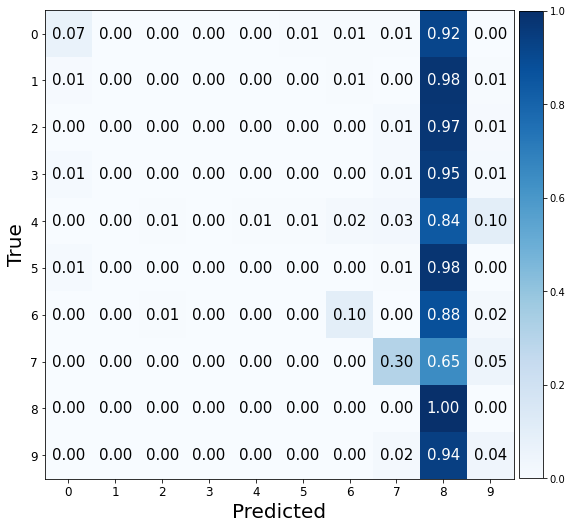

Valid Evaluation loss: 2.3113701343536377. f1:0.03526153955039335 acc: 0.10899999737739563 


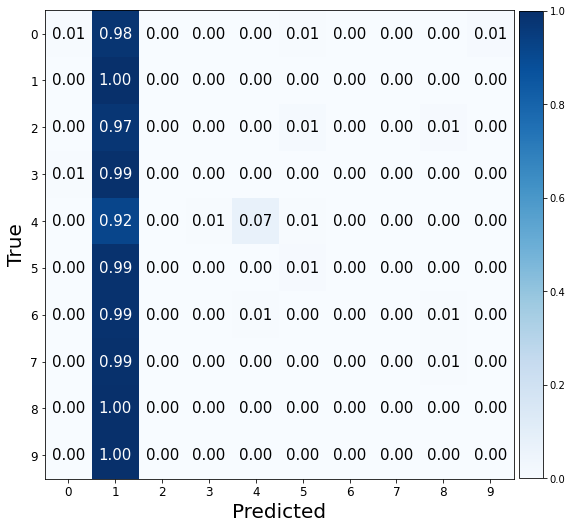

###################

ne: 50, hd:100, wd:0.1, lr: 0.1, bs:512 
Valid Evaluation loss: 2.4340555667877197. f1:0.14203343413162367 acc: 0.1940000057220459 


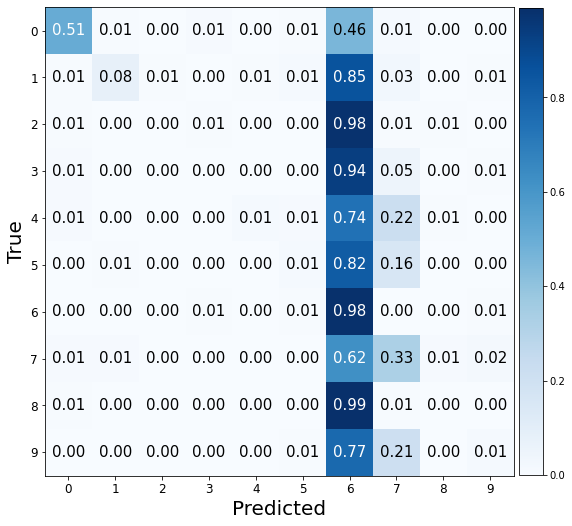

Valid Evaluation loss: 2.434727430343628. f1:0.041664283671718615 acc: 0.11349999904632568 


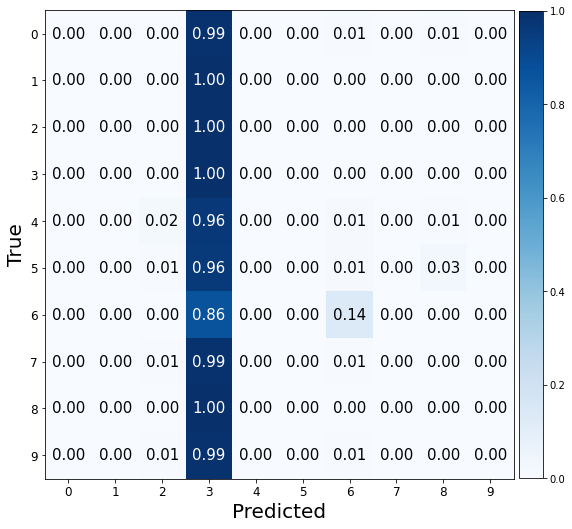

###################

ne: 50, hd:50, wd:0.001, lr: 0.001, bs:1024 
Valid Evaluation loss: 0.722274124622345. f1:0.8394825750026076 acc: 0.8389999866485596 


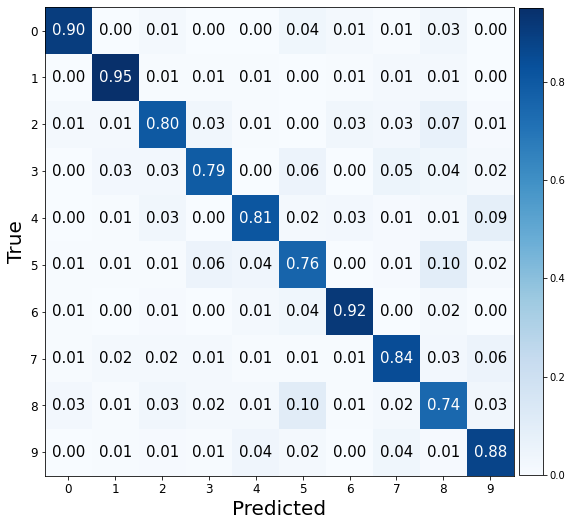

Valid Evaluation loss: 0.617129921913147. f1:0.8192248099061079 acc: 0.8195000290870667 


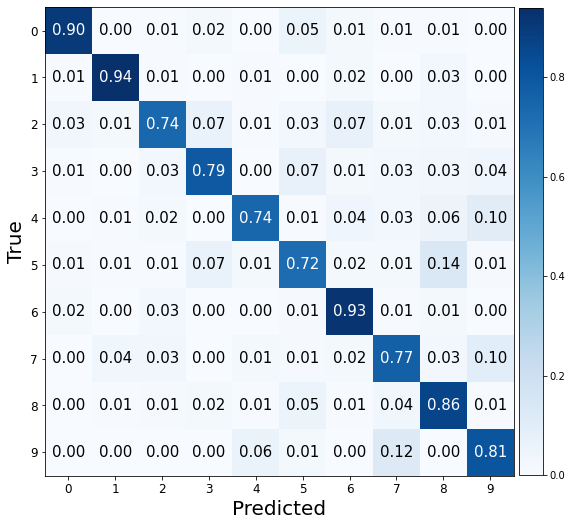

###################

ne: 50, hd:80, wd:0.001, lr: 0.001, bs:1024 
Valid Evaluation loss: 0.784587025642395. f1:0.8633561953146204 acc: 0.8629999756813049 


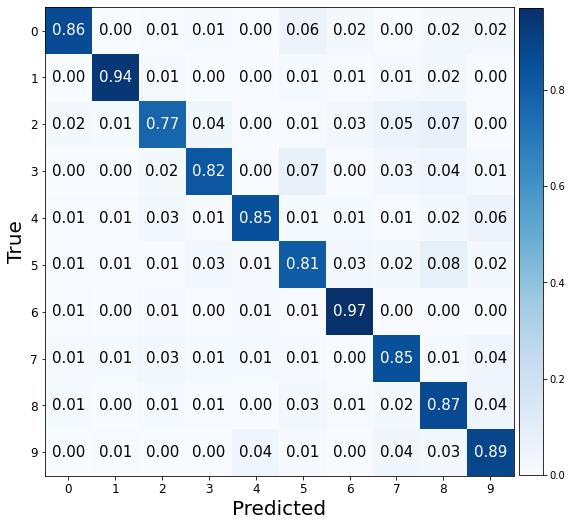

Valid Evaluation loss: 0.4445496201515198. f1:0.8675867529896383 acc: 0.8675000071525574 


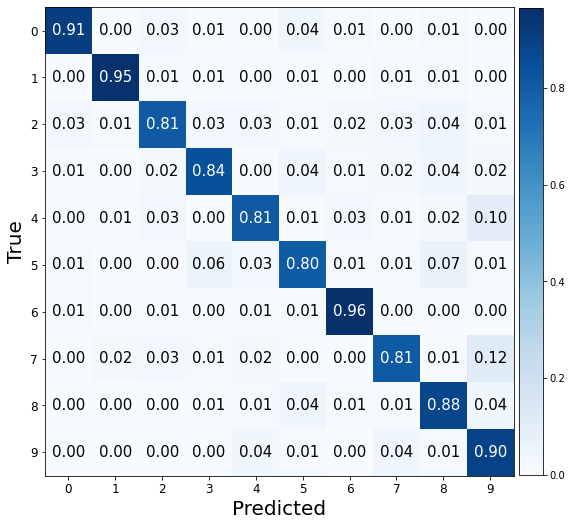

###################

ne: 50, hd:100, wd:0.001, lr: 0.001, bs:1024 
Valid Evaluation loss: 0.8369183540344238. f1:0.8685731499552315 acc: 0.8679999709129333 


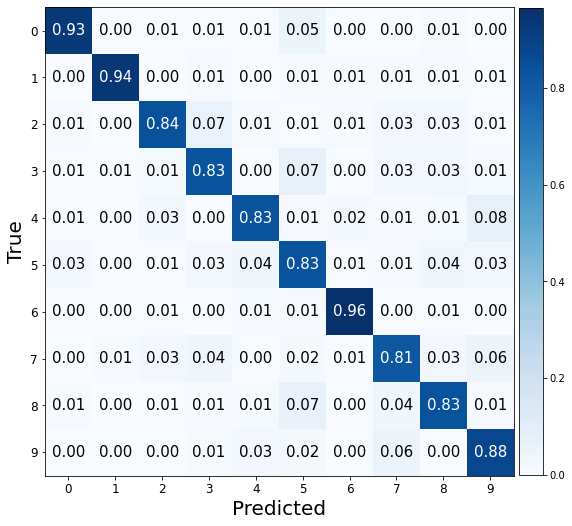

Valid Evaluation loss: 0.37556445598602295. f1:0.8902076781255548 acc: 0.890500009059906 


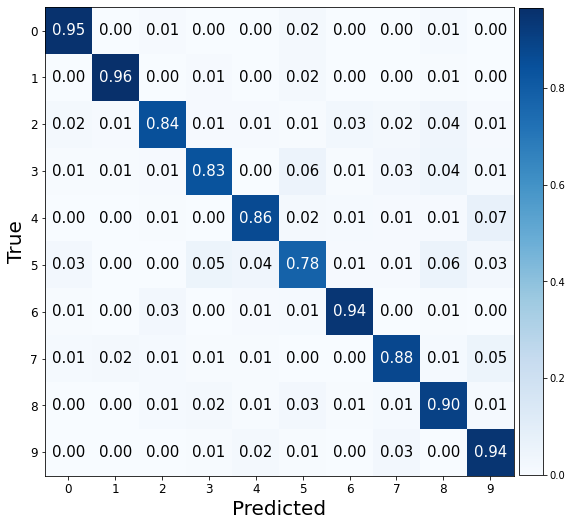

###################

ne: 50, hd:50, wd:0.01, lr: 0.001, bs:1024 
Valid Evaluation loss: 0.775558590888977. f1:0.8220526796965781 acc: 0.8215000033378601 


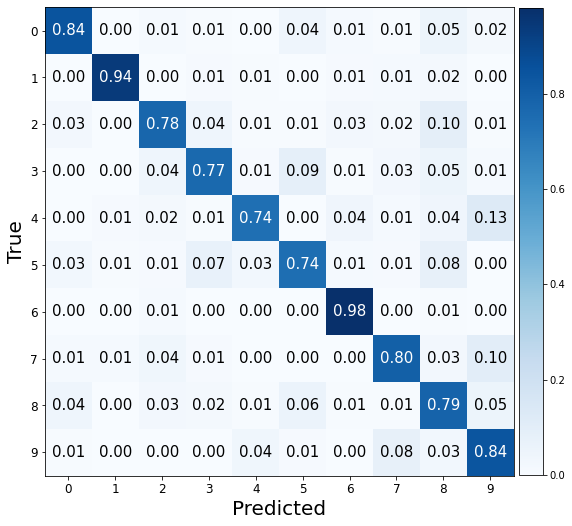

Valid Evaluation loss: 0.5229992866516113. f1:0.8435686762377493 acc: 0.843500018119812 


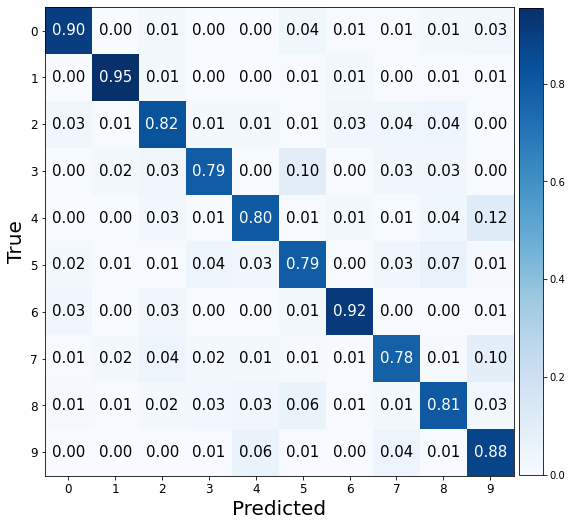

###################

ne: 50, hd:80, wd:0.01, lr: 0.001, bs:1024 
Valid Evaluation loss: 0.9928725361824036. f1:0.8485983350875965 acc: 0.8485000133514404 


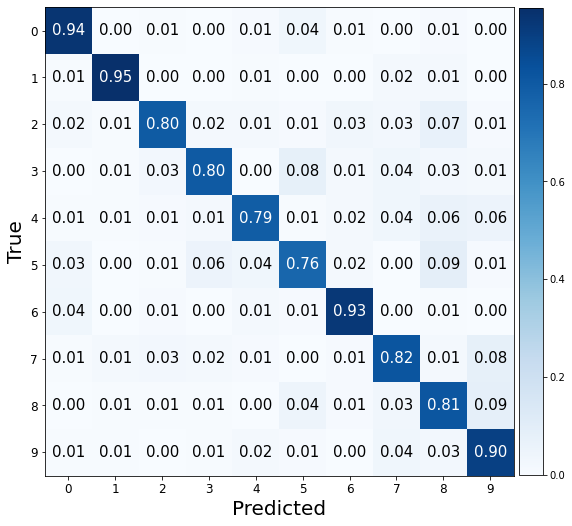

Valid Evaluation loss: 0.40829893946647644. f1:0.888838875464374 acc: 0.8889999985694885 


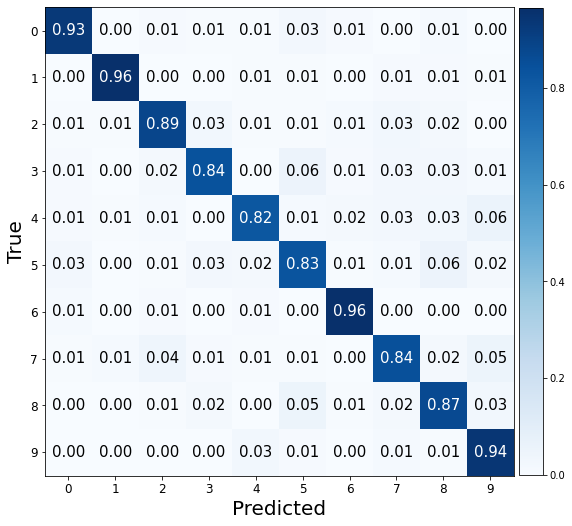

###################

ne: 50, hd:100, wd:0.01, lr: 0.001, bs:1024 
Valid Evaluation loss: 0.916238009929657. f1:0.8260248596819777 acc: 0.8264999985694885 


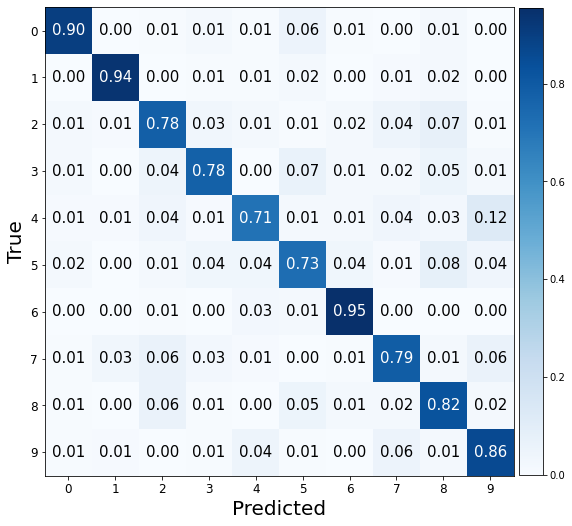

Valid Evaluation loss: 0.3637082576751709. f1:0.9032391229474642 acc: 0.9035000205039978 


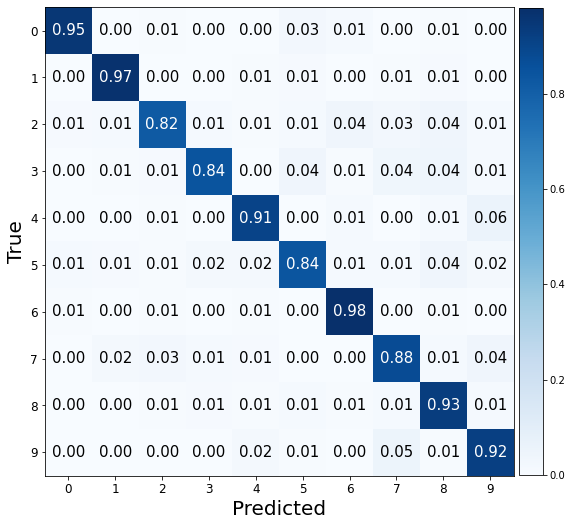

###################

ne: 50, hd:50, wd:0.1, lr: 0.001, bs:1024 
Valid Evaluation loss: 0.7106973528862. f1:0.8193479745319067 acc: 0.8195000290870667 


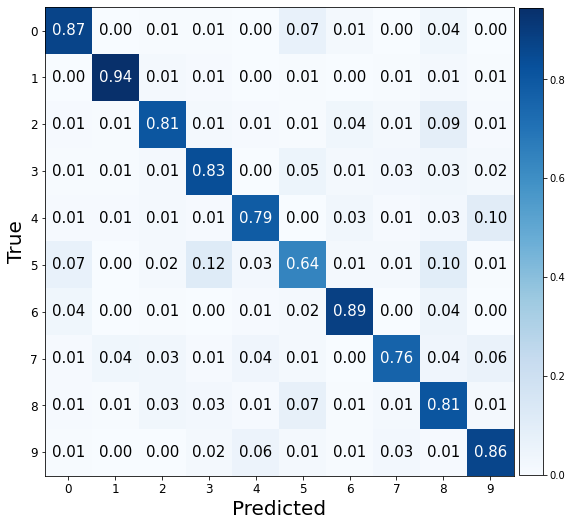

Valid Evaluation loss: 0.4523892104625702. f1:0.8756408859851016 acc: 0.8759999871253967 


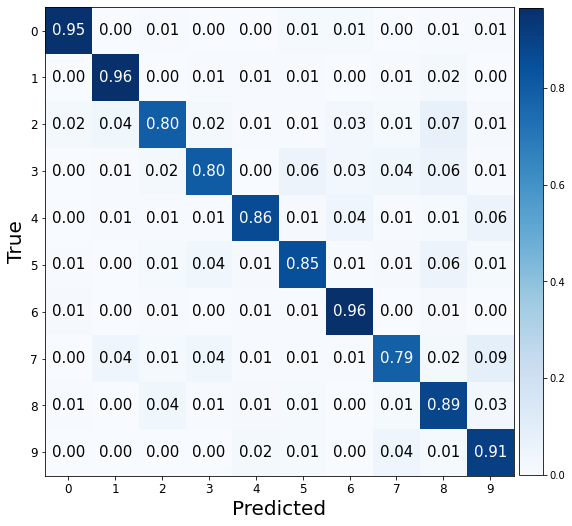

###################

ne: 50, hd:80, wd:0.1, lr: 0.001, bs:1024 
Valid Evaluation loss: 0.7459452152252197. f1:0.8473436974813303 acc: 0.8479999899864197 


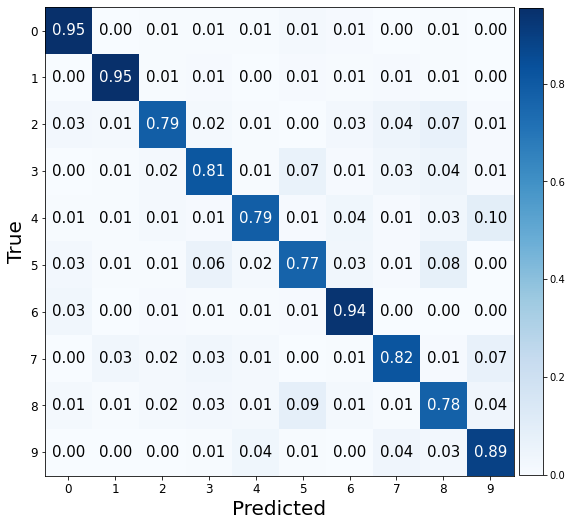

Valid Evaluation loss: 0.3739669919013977. f1:0.890932670938637 acc: 0.890999972820282 


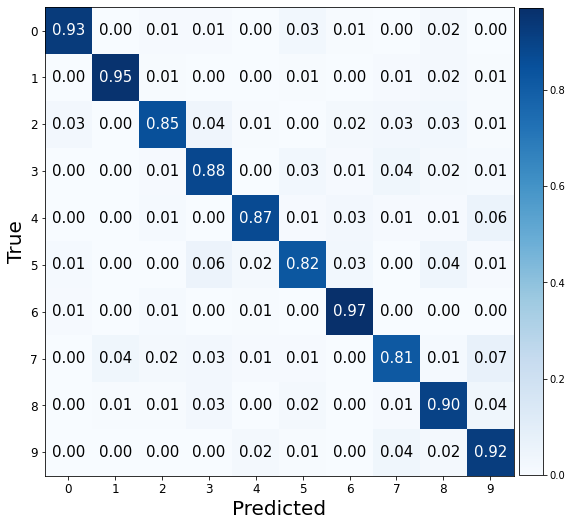

###################

ne: 50, hd:100, wd:0.1, lr: 0.001, bs:1024 
Valid Evaluation loss: 0.7069571018218994. f1:0.8819841059249974 acc: 0.8820000290870667 


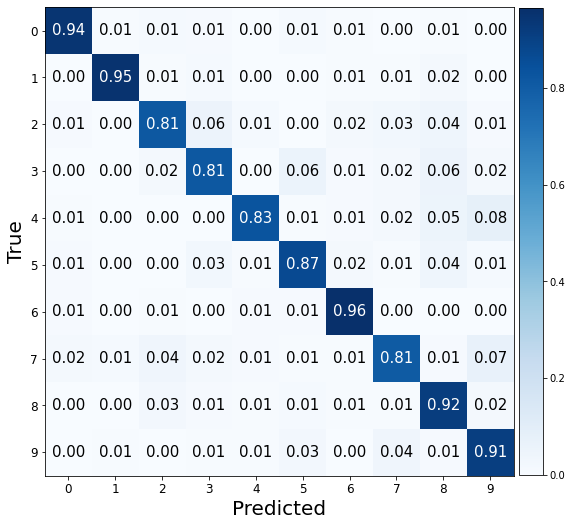

Valid Evaluation loss: 0.36819979548454285. f1:0.8922020927415606 acc: 0.8924999833106995 


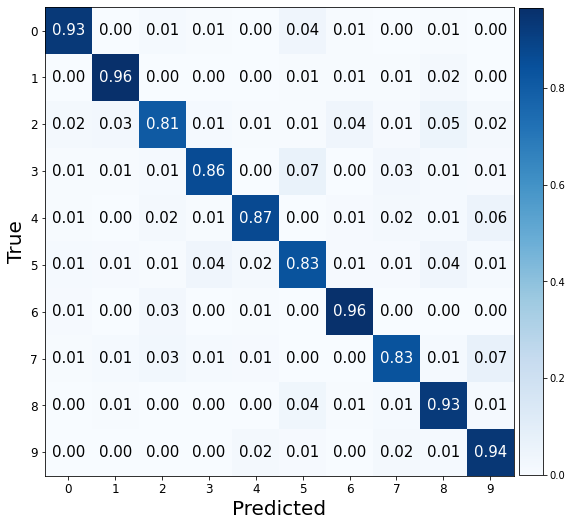

###################

ne: 50, hd:50, wd:0.001, lr: 0.01, bs:1024 
Valid Evaluation loss: 1.7555501461029053. f1:0.3011883327056277 acc: 0.3400000035762787 


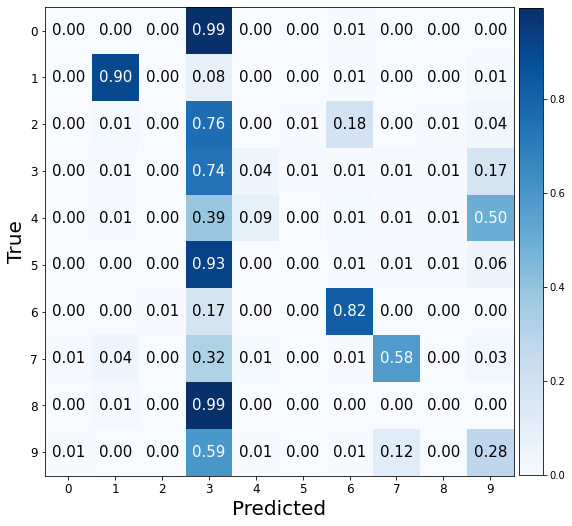

Valid Evaluation loss: 1.1425055265426636. f1:0.5520622263371092 acc: 0.5995000004768372 


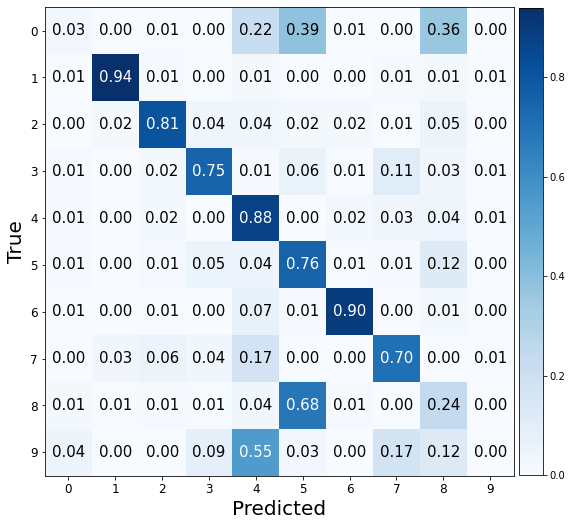

###################

ne: 50, hd:80, wd:0.001, lr: 0.01, bs:1024 
Valid Evaluation loss: 1.388373613357544. f1:0.5699280873243388 acc: 0.5879999995231628 


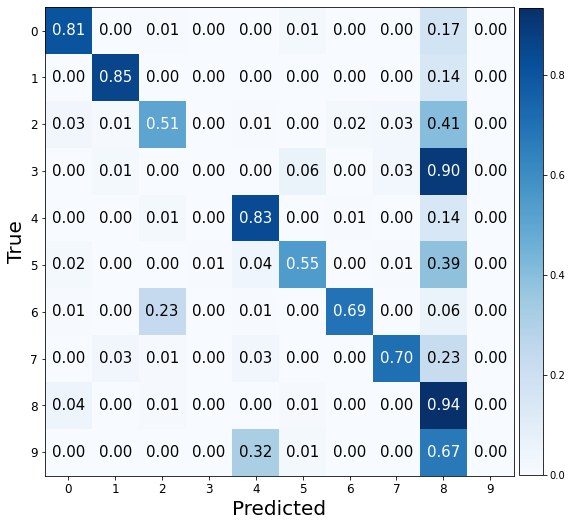

Valid Evaluation loss: 0.6216574907302856. f1:0.8407639508871965 acc: 0.8395000100135803 


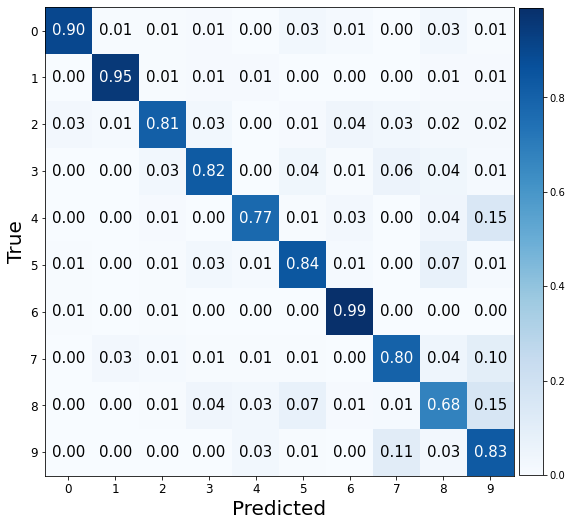

###################

ne: 50, hd:100, wd:0.001, lr: 0.01, bs:1024 
Valid Evaluation loss: 1.3682544231414795. f1:0.6620813310880365 acc: 0.6495000123977661 


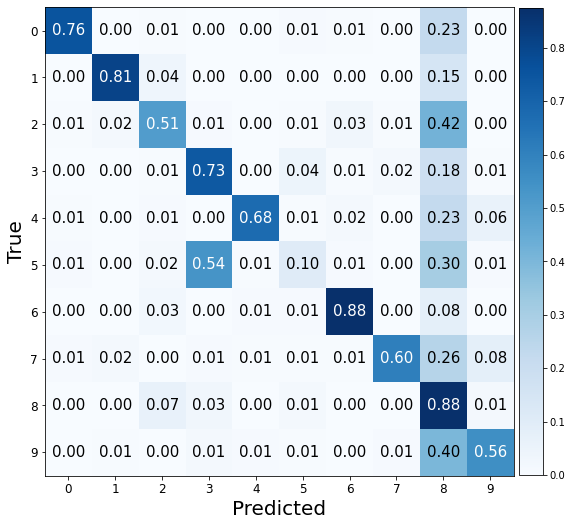

Valid Evaluation loss: 1.3953900337219238. f1:0.5327793592898551 acc: 0.5519999861717224 


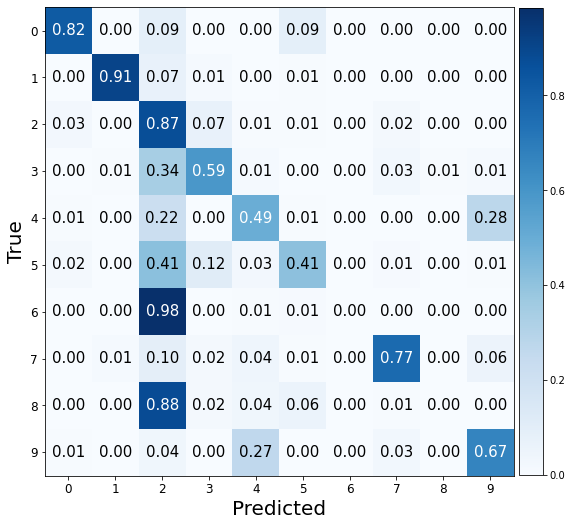

###################

ne: 50, hd:50, wd:0.01, lr: 0.01, bs:1024 
Valid Evaluation loss: 1.6781585216522217. f1:0.4293229639359805 acc: 0.45249998569488525 


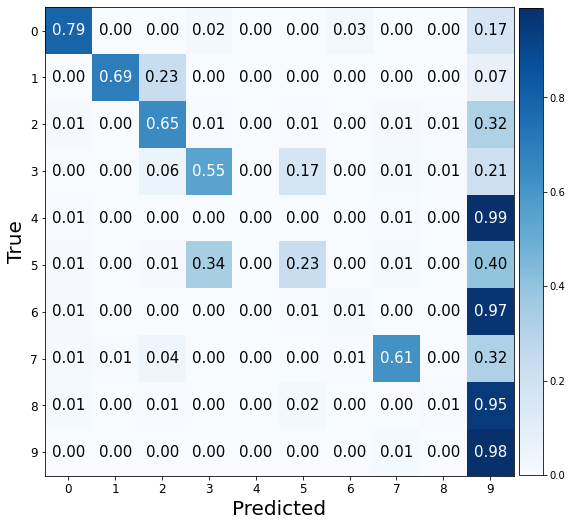

Valid Evaluation loss: 1.0024937391281128. f1:0.7024529789102795 acc: 0.7080000042915344 


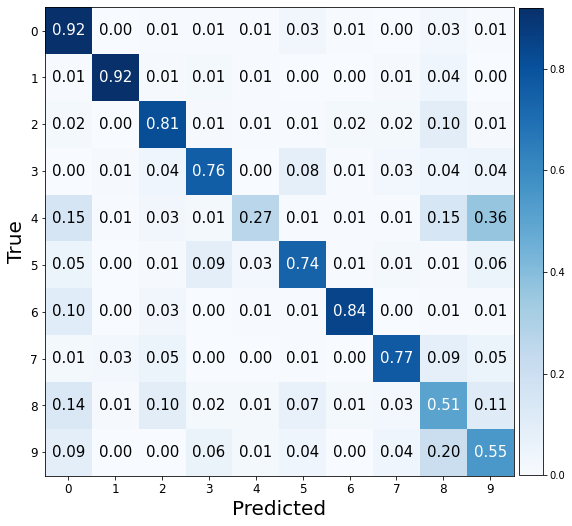

###################

ne: 50, hd:80, wd:0.01, lr: 0.01, bs:1024 
Valid Evaluation loss: 1.609342098236084. f1:0.4725752955991104 acc: 0.48399999737739563 


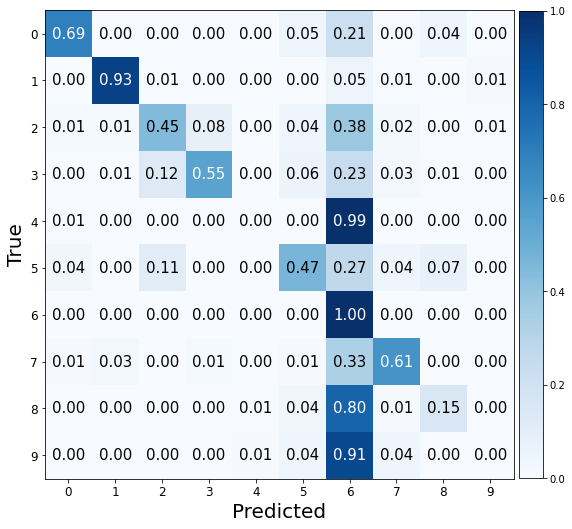

Valid Evaluation loss: 0.9559217691421509. f1:0.7118091190014344 acc: 0.7289999723434448 


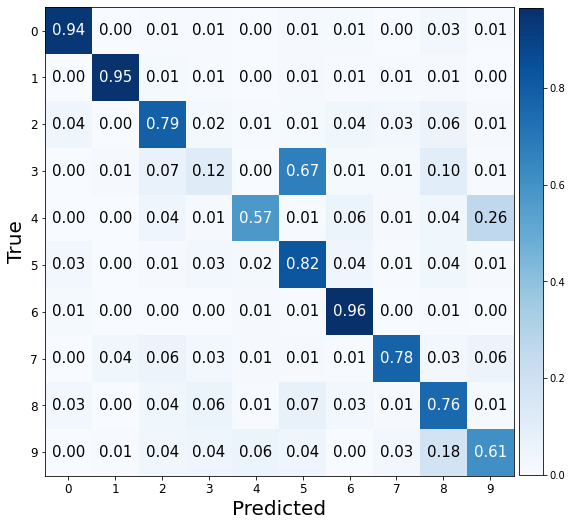

###################

ne: 50, hd:100, wd:0.01, lr: 0.01, bs:1024 
Valid Evaluation loss: 1.4437285661697388. f1:0.5940734490225136 acc: 0.6060000061988831 


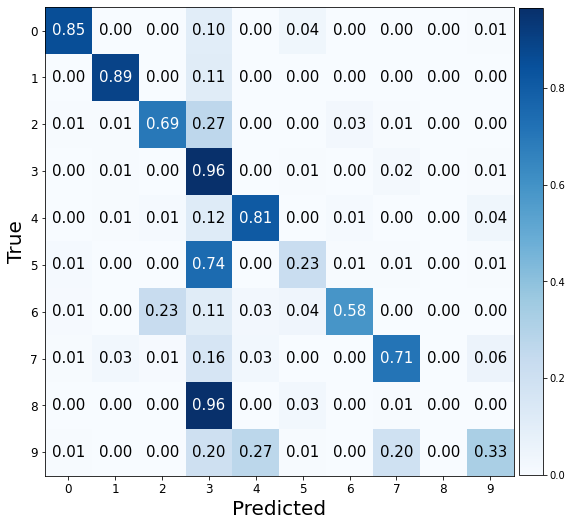

Valid Evaluation loss: 0.6796168684959412. f1:0.8051379133987553 acc: 0.8040000200271606 


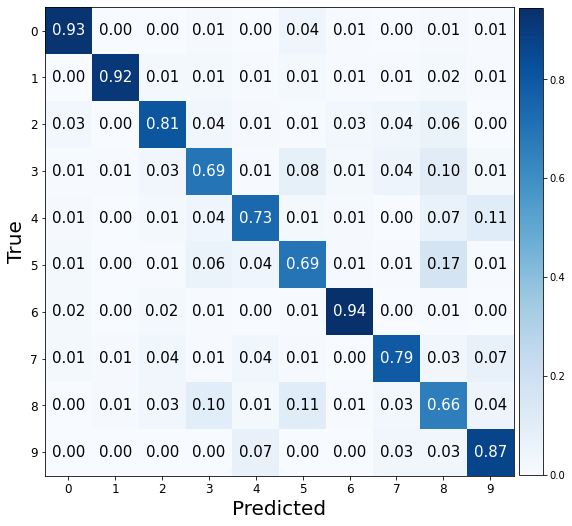

###################

ne: 50, hd:50, wd:0.1, lr: 0.01, bs:1024 
Valid Evaluation loss: 1.6684075593948364. f1:0.3807625931125849 acc: 0.40299999713897705 


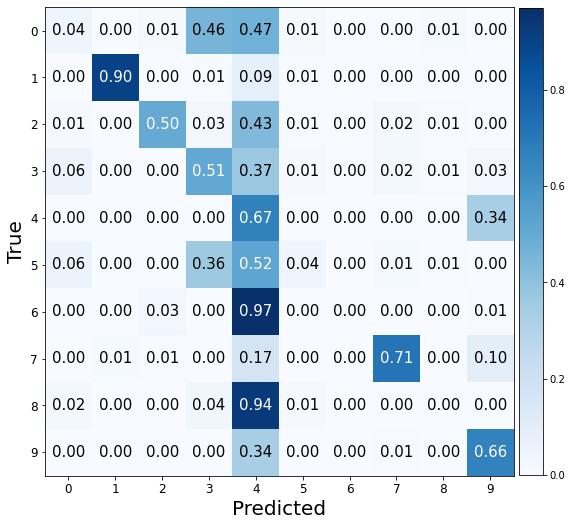

Valid Evaluation loss: 0.7853846549987793. f1:0.6996947380896622 acc: 0.7225000262260437 


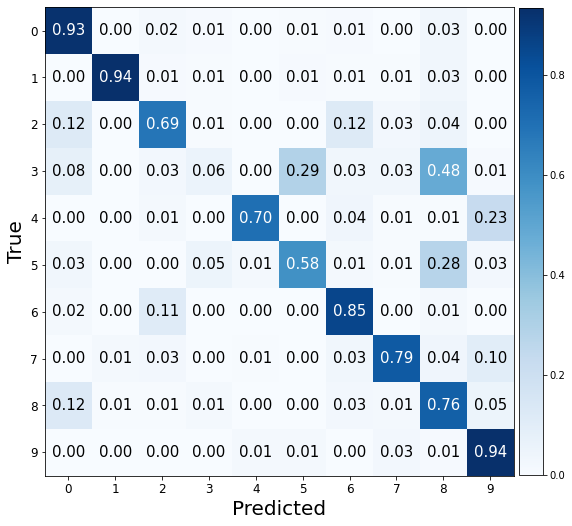

###################

ne: 50, hd:80, wd:0.1, lr: 0.01, bs:1024 
Valid Evaluation loss: 1.5486633777618408. f1:0.38219115050712293 acc: 0.44350001215934753 


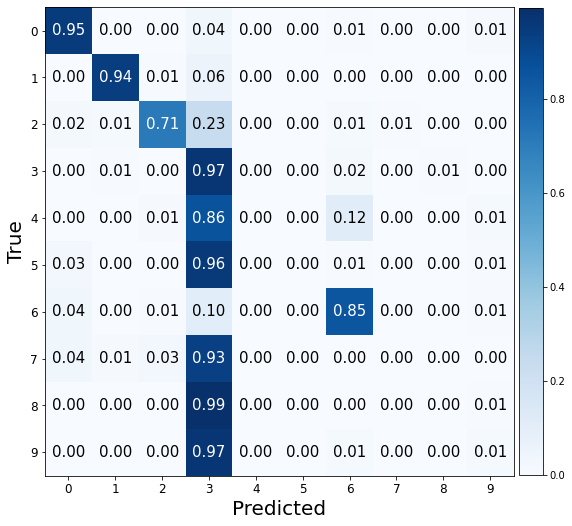

Valid Evaluation loss: 0.8192256093025208. f1:0.8116281394876694 acc: 0.8105000257492065 


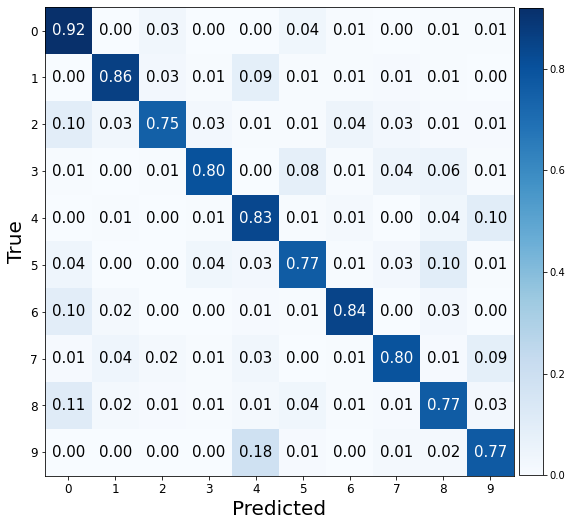

###################

ne: 50, hd:100, wd:0.1, lr: 0.01, bs:1024 
Valid Evaluation loss: 1.586924433708191. f1:0.47125109293120165 acc: 0.4880000054836273 


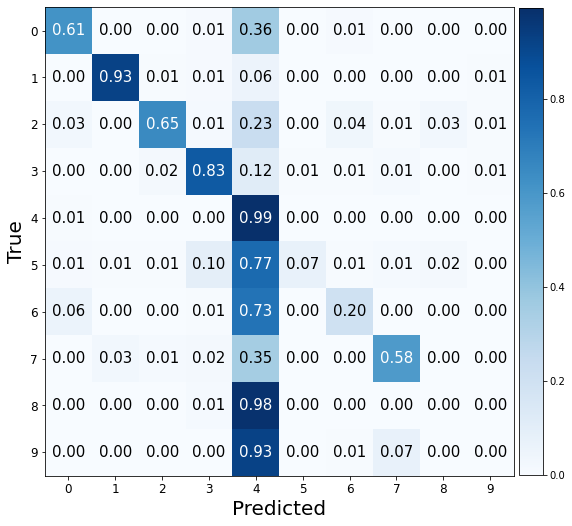

Valid Evaluation loss: 0.553424060344696. f1:0.8447725118512478 acc: 0.843999981880188 


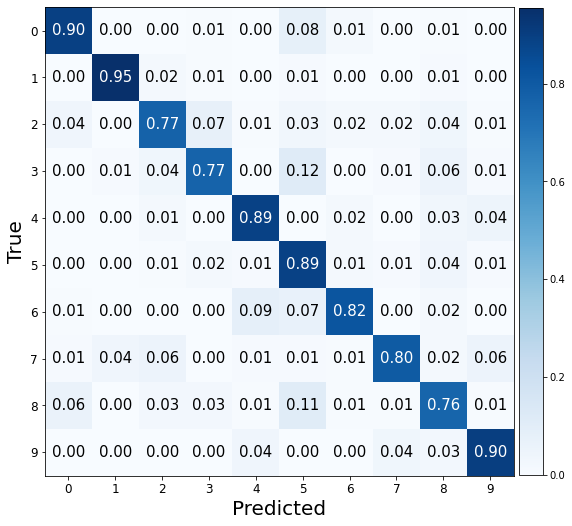

###################

ne: 50, hd:50, wd:0.001, lr: 0.1, bs:1024 
Valid Evaluation loss: 2.5088374614715576. f1:0.14067519337117246 acc: 0.19099999964237213 


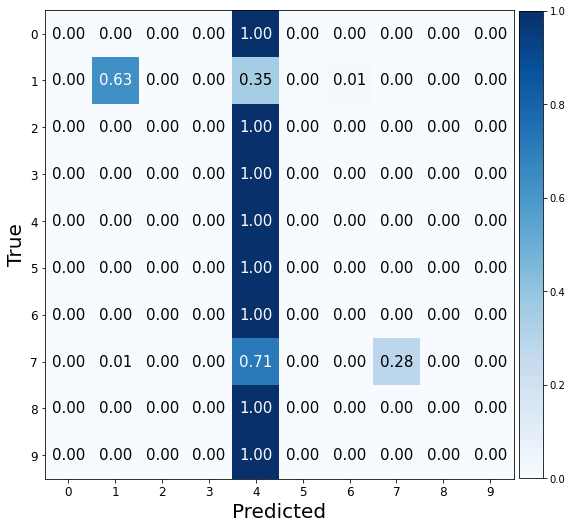

Valid Evaluation loss: 2.302717447280884. f1:0.01818181818181818 acc: 0.10000000149011612 


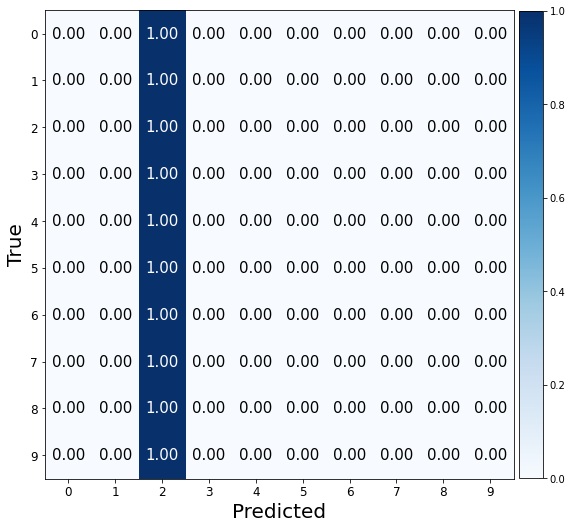

###################

ne: 50, hd:80, wd:0.001, lr: 0.1, bs:1024 
Valid Evaluation loss: 2.59236216545105. f1:0.09878283003586717 acc: 0.1665000021457672 


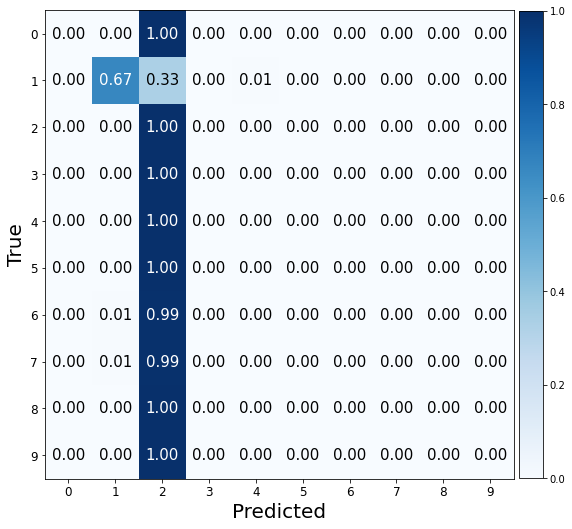

Valid Evaluation loss: 2.3028957843780518. f1:0.01818181818181818 acc: 0.10000000149011612 


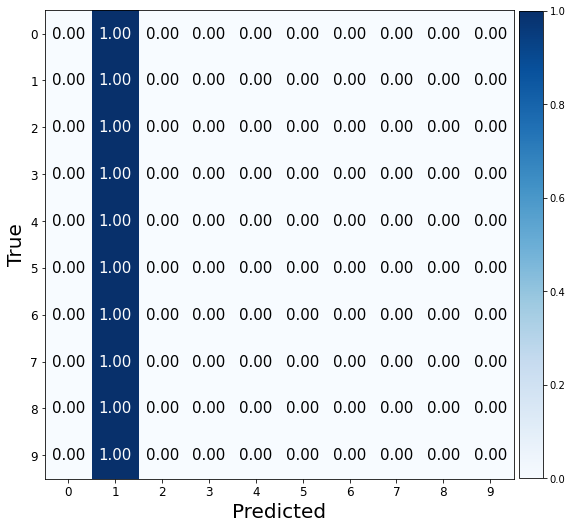

###################

ne: 50, hd:100, wd:0.001, lr: 0.1, bs:1024 
Valid Evaluation loss: 3.9433512687683105. f1:0.18836557074473223 acc: 0.21799999475479126 


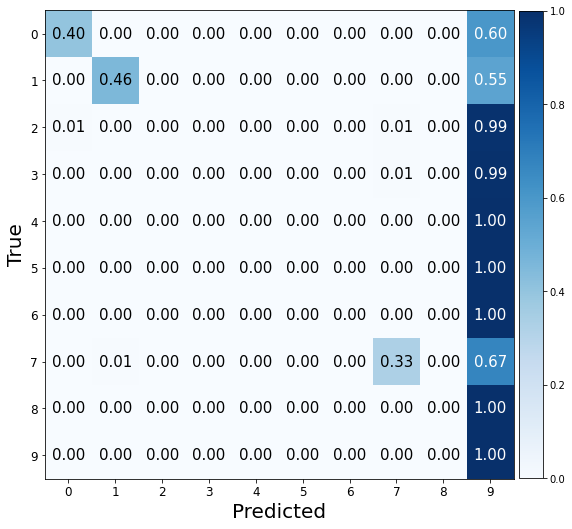

Valid Evaluation loss: 2.3821771144866943. f1:0.018190086402910415 acc: 0.10000000149011612 


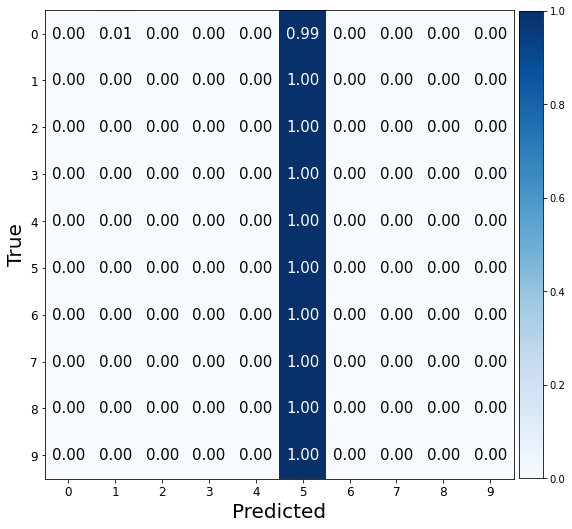

###################

ne: 50, hd:50, wd:0.01, lr: 0.1, bs:1024 
Valid Evaluation loss: 2.5238378047943115. f1:0.08774717022034344 acc: 0.15299999713897705 


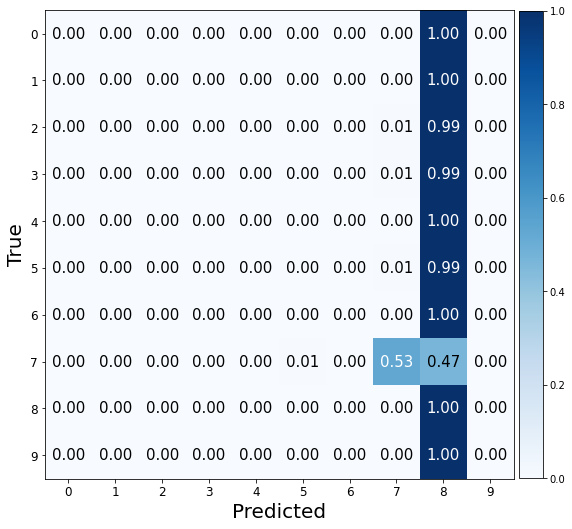

Valid Evaluation loss: 2.3489835262298584. f1:0.01823154056517776 acc: 0.10000000149011612 


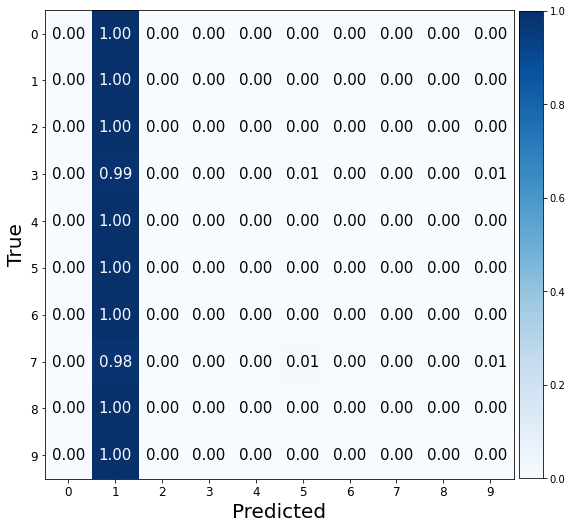

###################

ne: 50, hd:80, wd:0.01, lr: 0.1, bs:1024 
Valid Evaluation loss: 2.3028199672698975. f1:0.01818181818181818 acc: 0.10000000149011612 


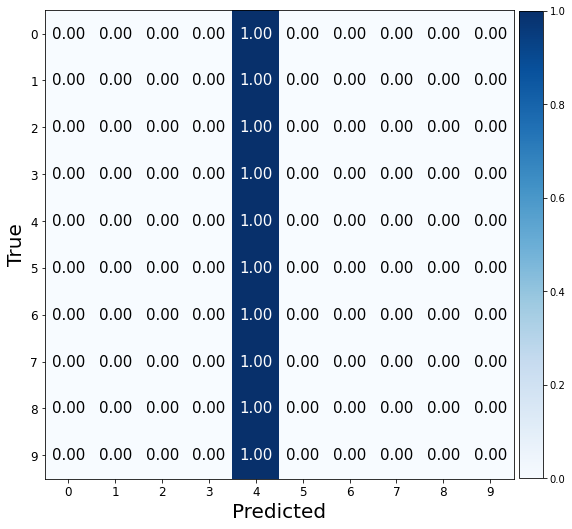

Valid Evaluation loss: 2.30362606048584. f1:0.019196744435481326 acc: 0.10050000250339508 


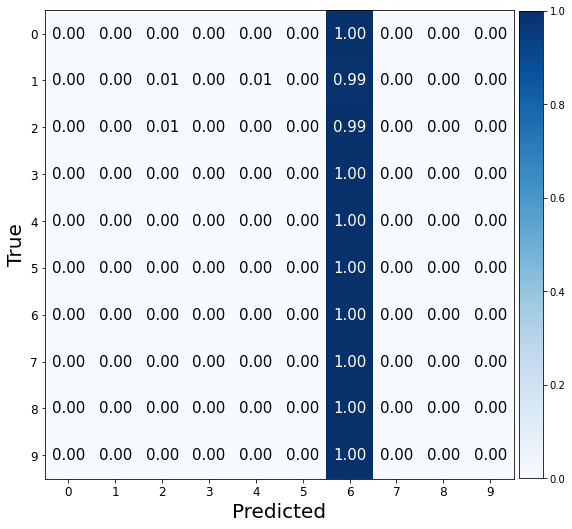

###################

ne: 50, hd:100, wd:0.01, lr: 0.1, bs:1024 
Valid Evaluation loss: 2.899989604949951. f1:0.07199167830832472 acc: 0.13699999451637268 


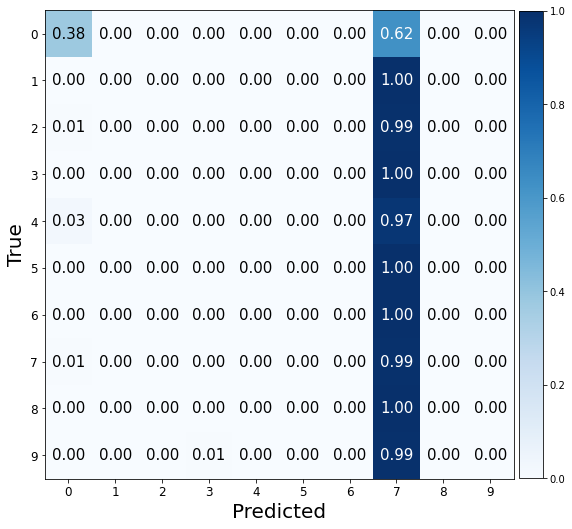

Valid Evaluation loss: 2.3028600215911865. f1:0.01818181818181818 acc: 0.10000000149011612 


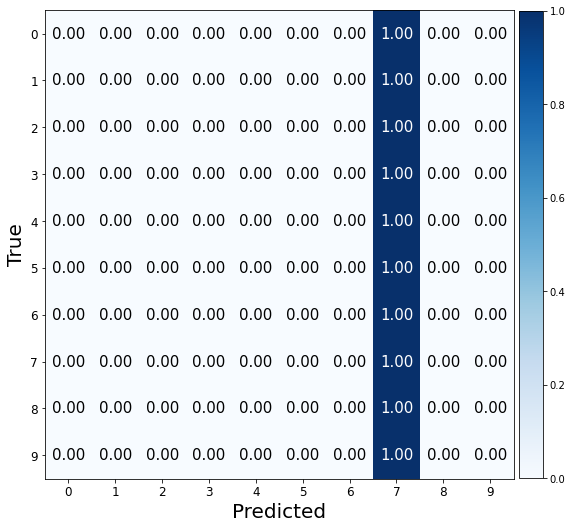

###################

ne: 50, hd:50, wd:0.1, lr: 0.1, bs:1024 
Valid Evaluation loss: 2.2529919147491455. f1:0.07132352440943908 acc: 0.13449999690055847 


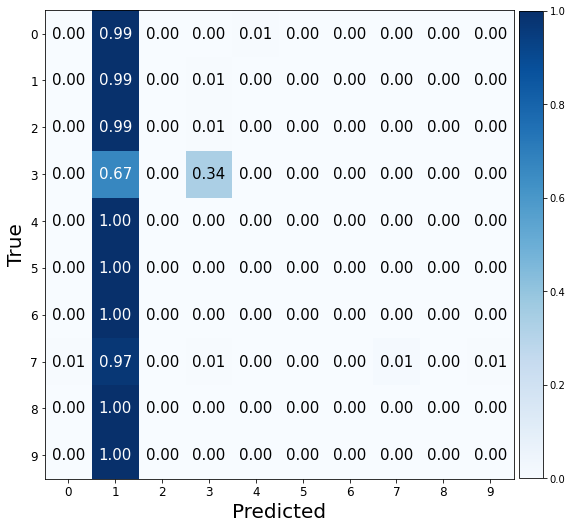

Valid Evaluation loss: 3.7864558696746826. f1:0.043258079221364924 acc: 0.10450000315904617 


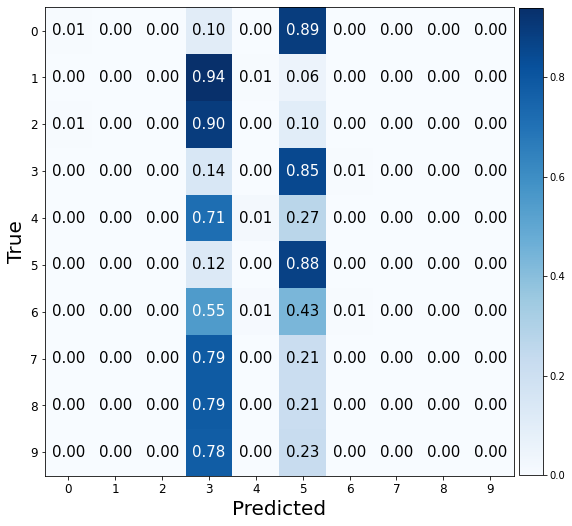

###################

ne: 50, hd:80, wd:0.1, lr: 0.1, bs:1024 
Valid Evaluation loss: 2.1397194862365723. f1:0.1350110465831386 acc: 0.18050000071525574 


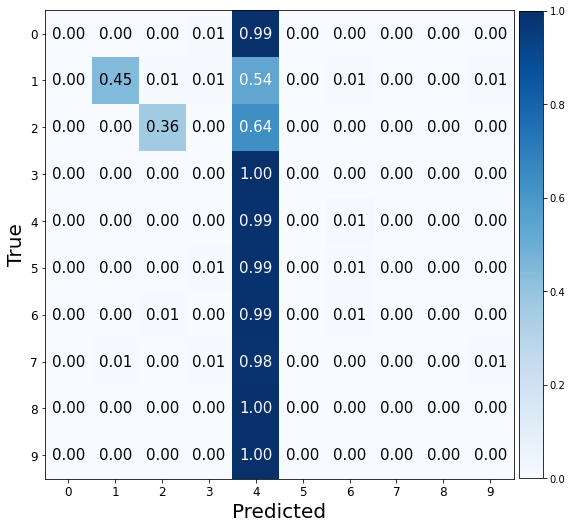

Valid Evaluation loss: 7.003850936889648. f1:0.05416654837642939 acc: 0.15049999952316284 


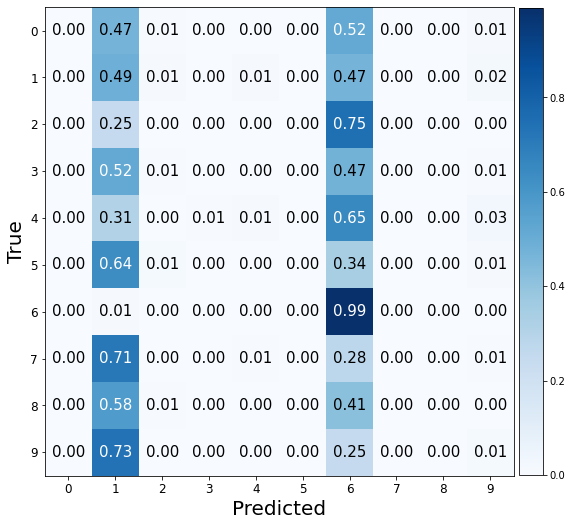

###################

ne: 50, hd:100, wd:0.1, lr: 0.1, bs:1024 
Valid Evaluation loss: 2.17942214012146. f1:0.09054931311947749 acc: 0.14399999380111694 


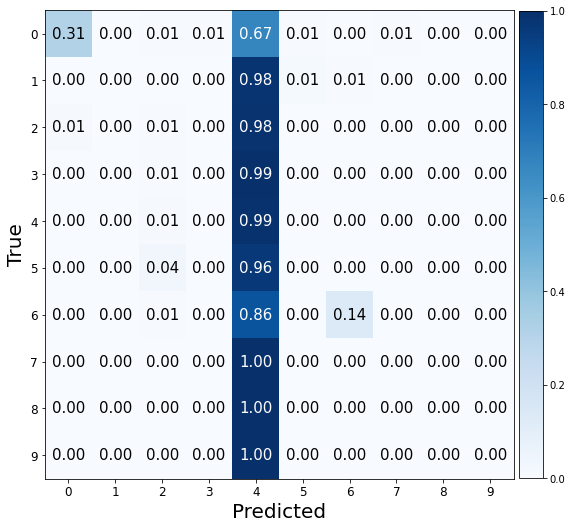

Valid Evaluation loss: 2.305501937866211. f1:0.01818181818181818 acc: 0.10000000149011612 


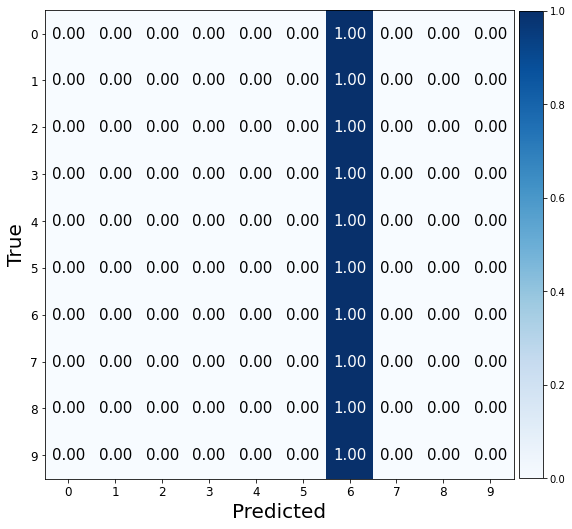

###################

ne: 100, hd:50, wd:0.001, lr: 0.001, bs:256 
Valid Evaluation loss: 0.7512197494506836. f1:0.8432631158898886 acc: 0.843500018119812 


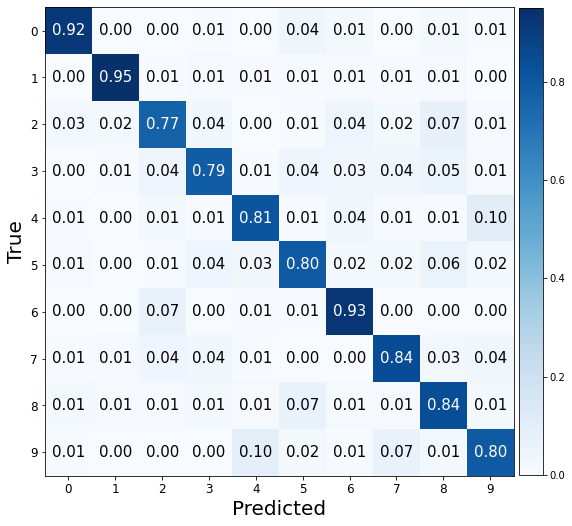

Valid Evaluation loss: 0.39988335967063904. f1:0.8856899046563977 acc: 0.8859999775886536 


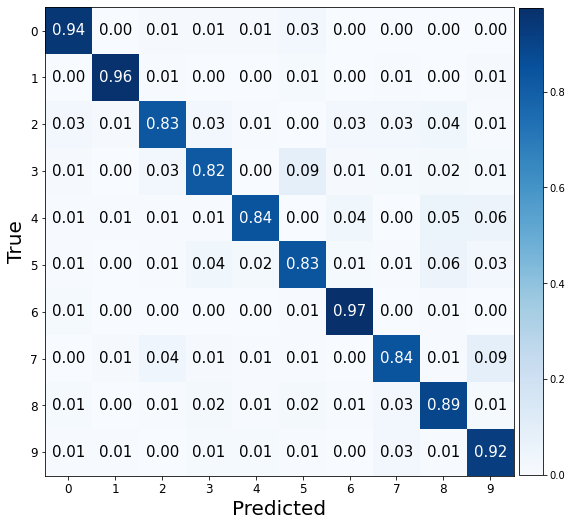

###################

ne: 100, hd:80, wd:0.001, lr: 0.001, bs:256 
Valid Evaluation loss: 0.6378864645957947. f1:0.8730622934162374 acc: 0.8725000023841858 


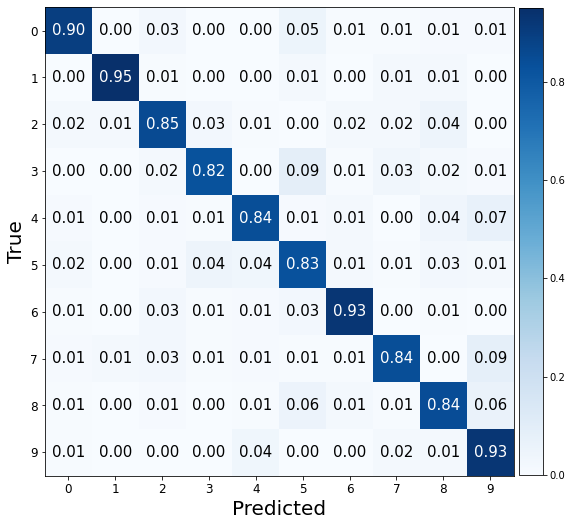

Valid Evaluation loss: 0.3571884036064148. f1:0.8964377176561934 acc: 0.8964999914169312 


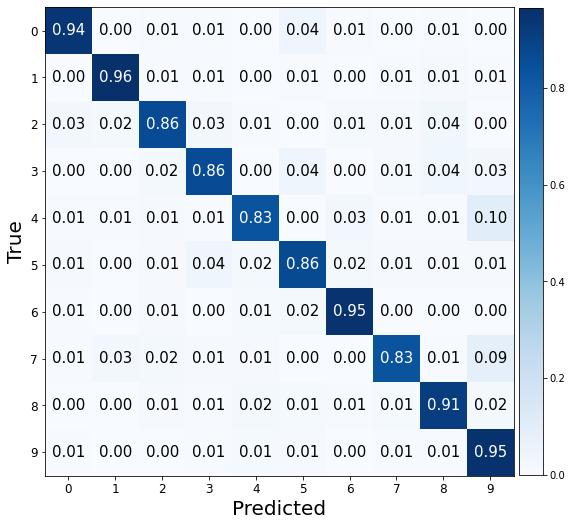

###################

ne: 100, hd:100, wd:0.001, lr: 0.001, bs:256 
Valid Evaluation loss: 0.773699164390564. f1:0.8868740170363681 acc: 0.8870000243186951 


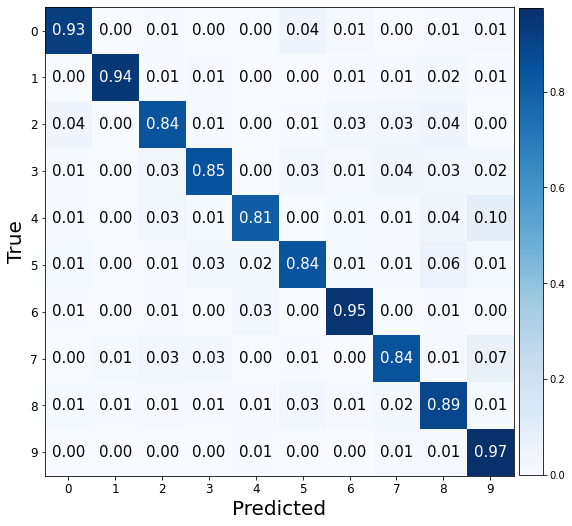

Valid Evaluation loss: 0.3176235258579254. f1:0.9131419735001762 acc: 0.9129999876022339 


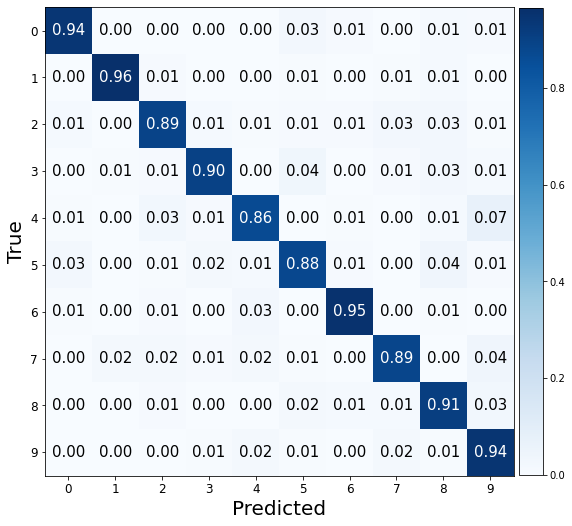

###################

ne: 100, hd:50, wd:0.01, lr: 0.001, bs:256 
Valid Evaluation loss: 0.7592821717262268. f1:0.8579466942398231 acc: 0.8575000166893005 


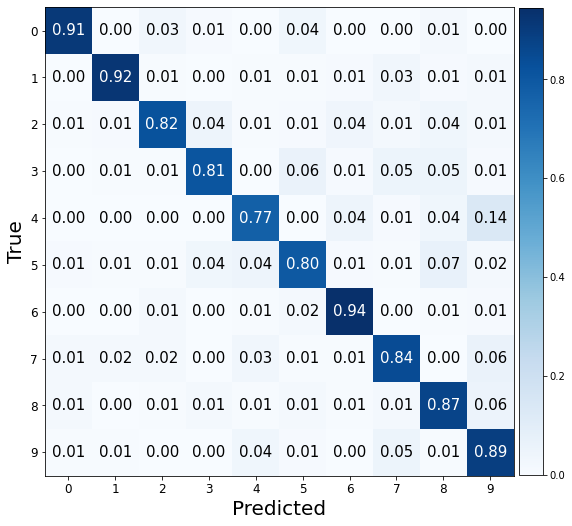

Valid Evaluation loss: 0.41456955671310425. f1:0.8905480199936824 acc: 0.890500009059906 


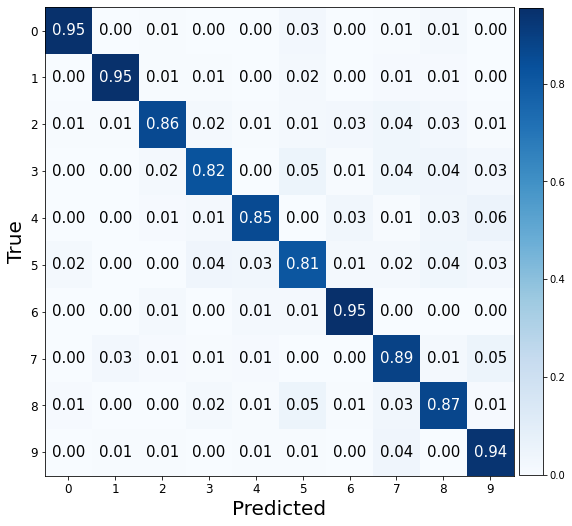

###################

ne: 100, hd:80, wd:0.01, lr: 0.001, bs:256 
Valid Evaluation loss: 0.7089319825172424. f1:0.8737021078945533 acc: 0.8734999895095825 


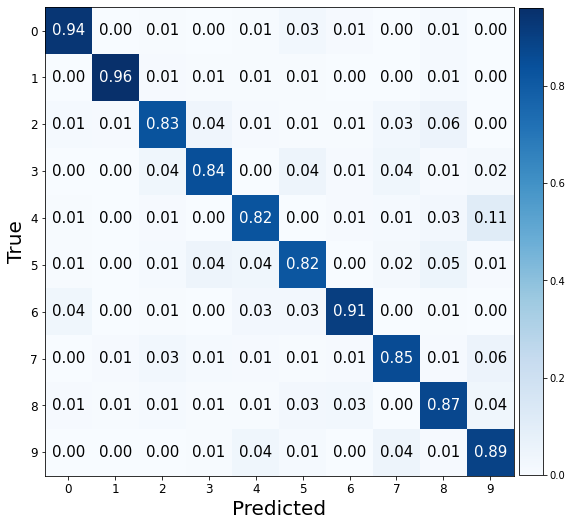

Valid Evaluation loss: 0.3362570106983185. f1:0.9078139629372026 acc: 0.9079999923706055 


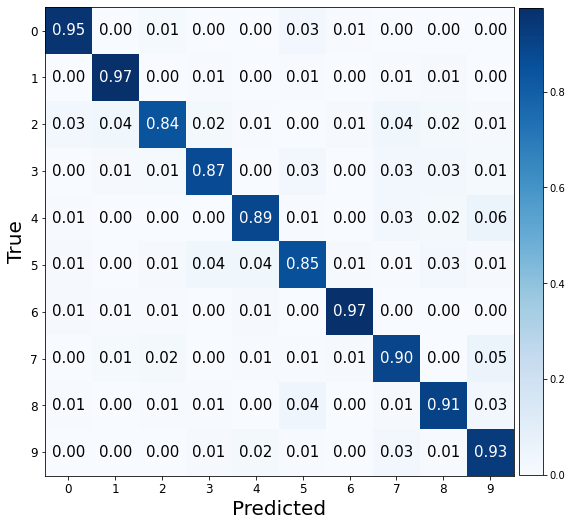

###################

ne: 100, hd:100, wd:0.01, lr: 0.001, bs:256 
Valid Evaluation loss: 0.5721724033355713. f1:0.8994068273839935 acc: 0.8995000123977661 


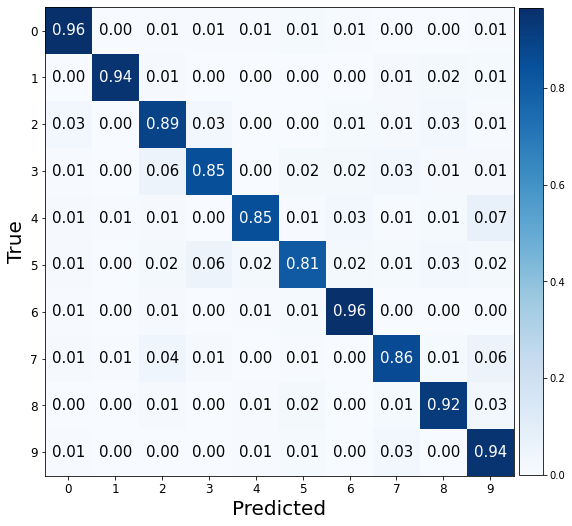

Valid Evaluation loss: 0.3271891176700592. f1:0.9094733827622401 acc: 0.909500002861023 


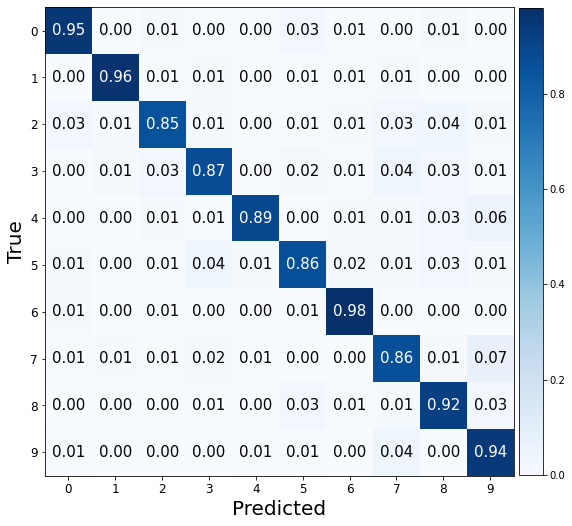

###################

ne: 100, hd:50, wd:0.1, lr: 0.001, bs:256 
Valid Evaluation loss: 0.5958002805709839. f1:0.8655598914371995 acc: 0.8659999966621399 


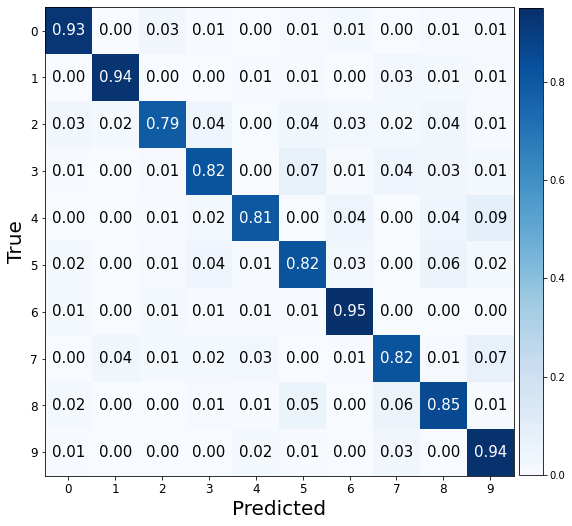

Valid Evaluation loss: 0.340551495552063. f1:0.897069905970878 acc: 0.8974999785423279 


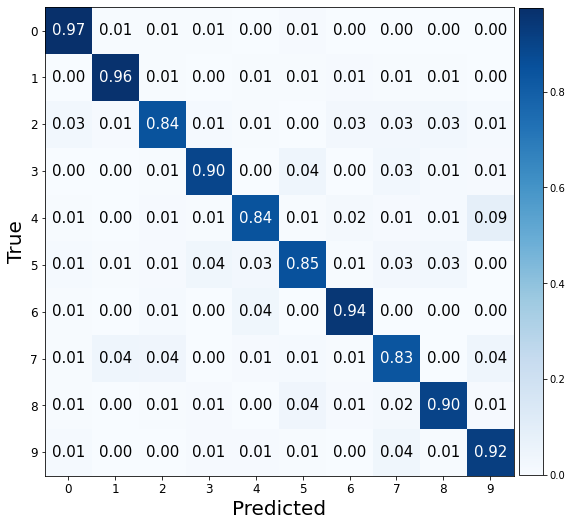

###################

ne: 100, hd:80, wd:0.1, lr: 0.001, bs:256 
Valid Evaluation loss: 0.7228906750679016. f1:0.8711711909725842 acc: 0.8709999918937683 


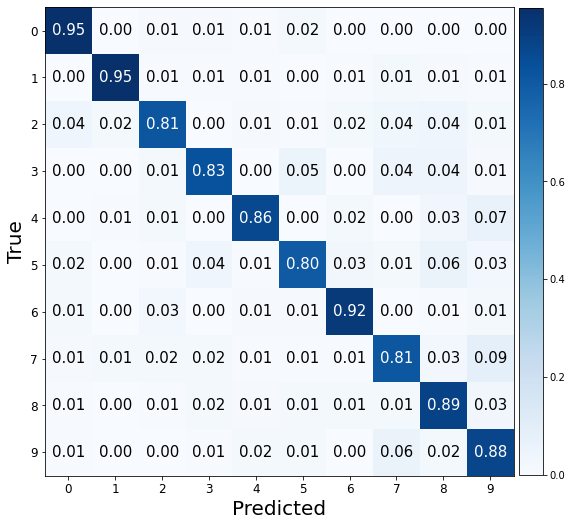

Valid Evaluation loss: 0.34151074290275574. f1:0.8940082087299419 acc: 0.8939999938011169 


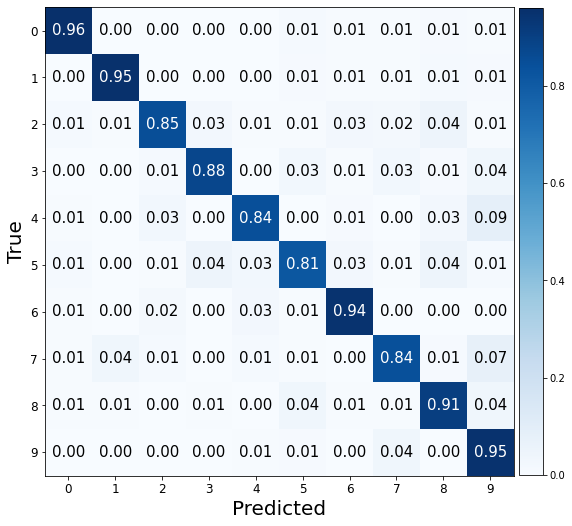

###################

ne: 100, hd:100, wd:0.1, lr: 0.001, bs:256 
Valid Evaluation loss: 0.6508718729019165. f1:0.887775269988963 acc: 0.8880000114440918 


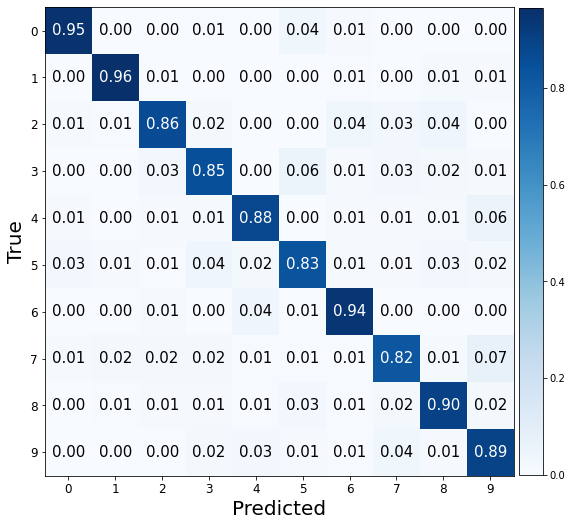

Valid Evaluation loss: 0.30347588658332825. f1:0.9018176196499492 acc: 0.9020000100135803 


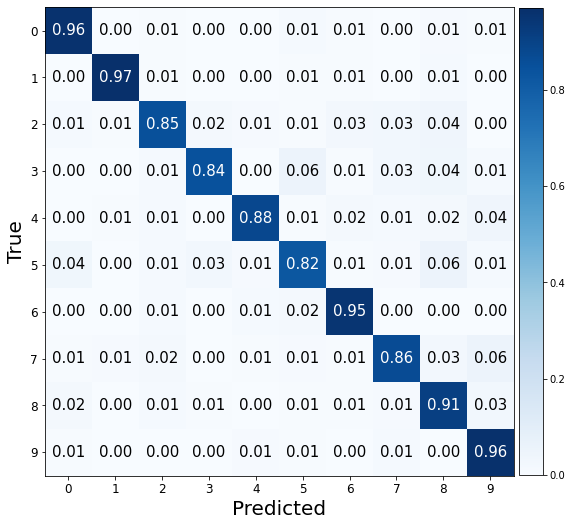

###################

ne: 100, hd:50, wd:0.001, lr: 0.01, bs:256 
Valid Evaluation loss: 1.4326852560043335. f1:0.5208071732142469 acc: 0.5450000166893005 


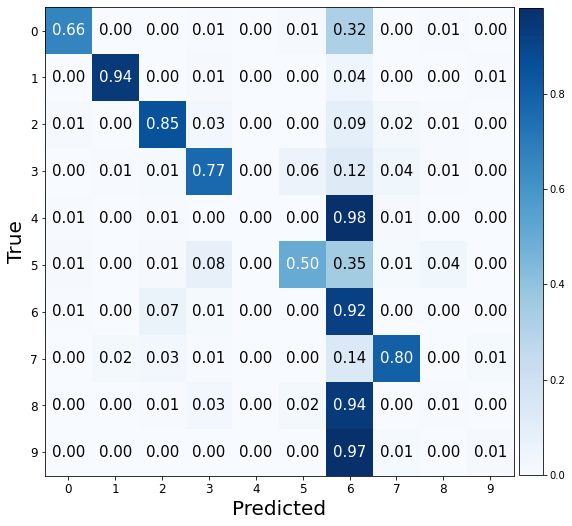

Valid Evaluation loss: 0.6270755529403687. f1:0.8108243879959034 acc: 0.809499979019165 


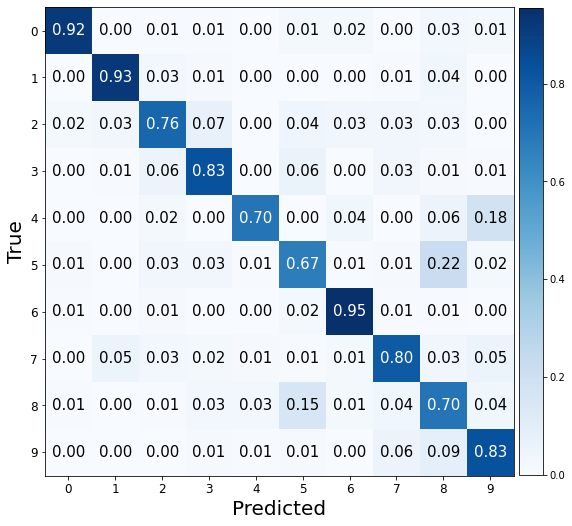

###################

ne: 100, hd:80, wd:0.001, lr: 0.01, bs:256 
Valid Evaluation loss: 1.3029447793960571. f1:0.6309884847313685 acc: 0.6499999761581421 


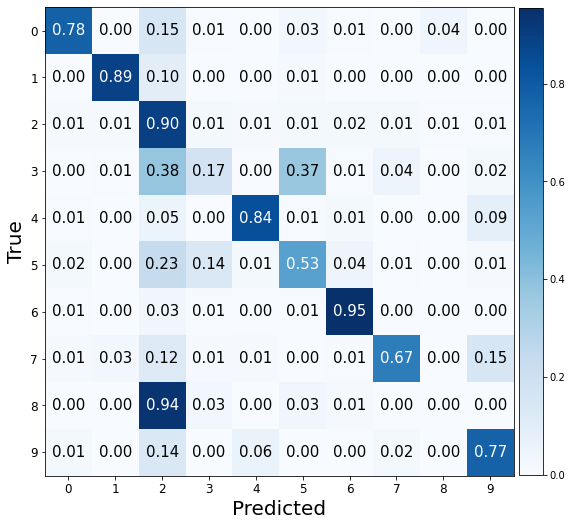

Valid Evaluation loss: 0.6206813454627991. f1:0.846508258673367 acc: 0.8460000157356262 


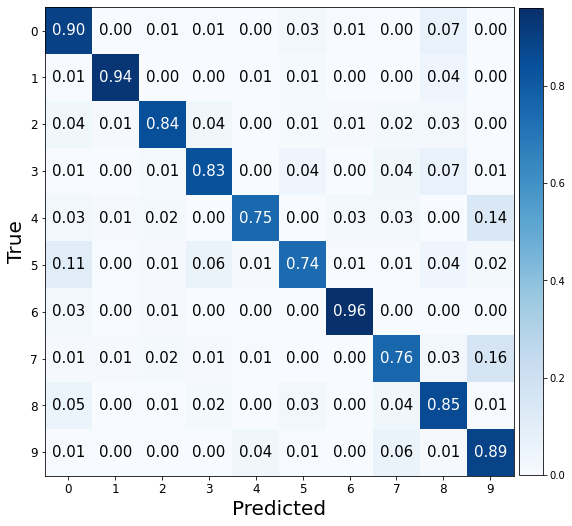

###################

ne: 100, hd:100, wd:0.001, lr: 0.01, bs:256 
Valid Evaluation loss: 1.109613060951233. f1:0.8263397320357818 acc: 0.824999988079071 


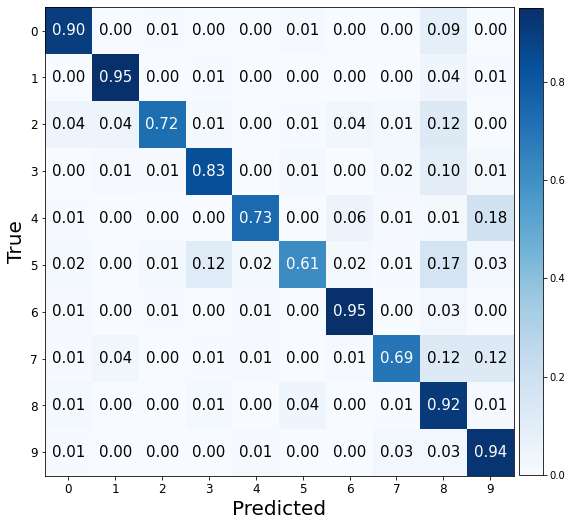

Valid Evaluation loss: 1.5540759563446045. f1:0.3424080278663573 acc: 0.3955000042915344 


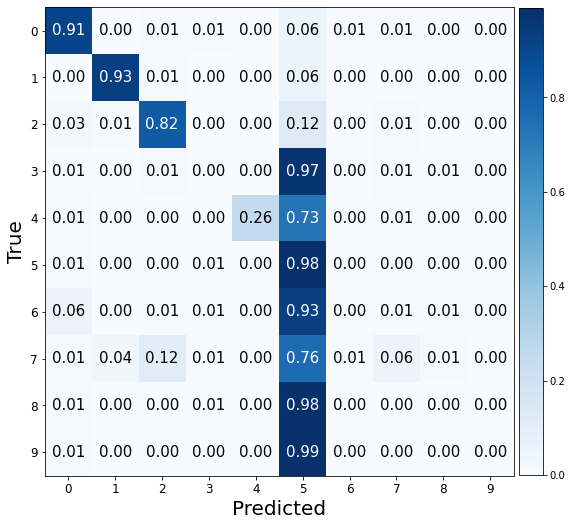

###################

ne: 100, hd:50, wd:0.01, lr: 0.01, bs:256 
Valid Evaluation loss: 1.327128529548645. f1:0.5595032847526754 acc: 0.5799999833106995 


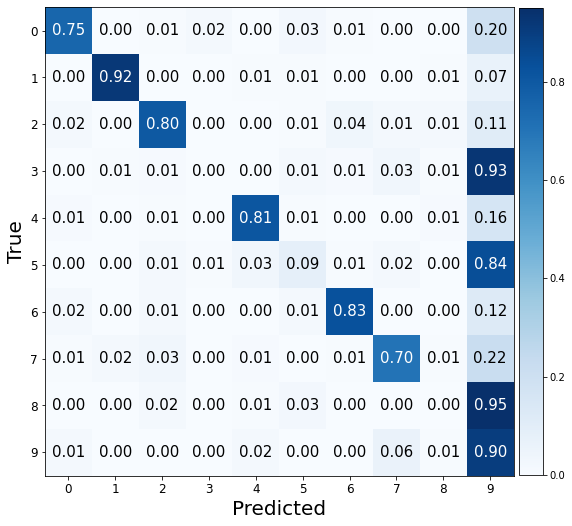

Valid Evaluation loss: 0.7922658324241638. f1:0.7587437158475543 acc: 0.7630000114440918 


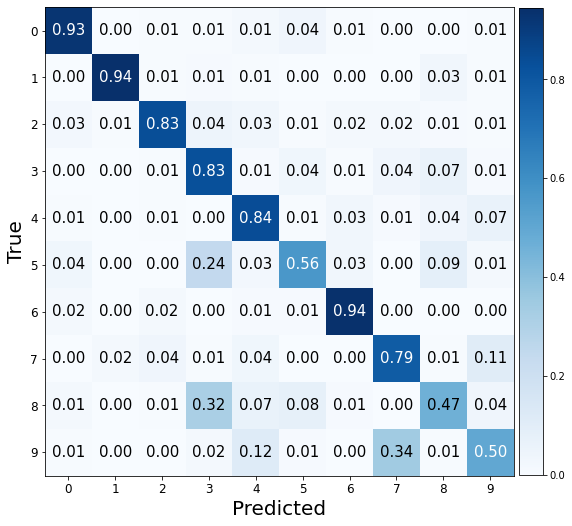

###################

ne: 100, hd:80, wd:0.01, lr: 0.01, bs:256 
Valid Evaluation loss: 1.1185849905014038. f1:0.718203109242528 acc: 0.7325000166893005 


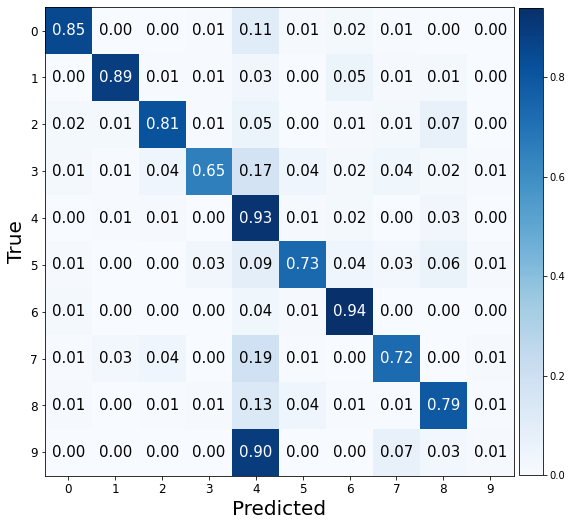

Valid Evaluation loss: 0.8538916707038879. f1:0.6701081191595077 acc: 0.7085000276565552 


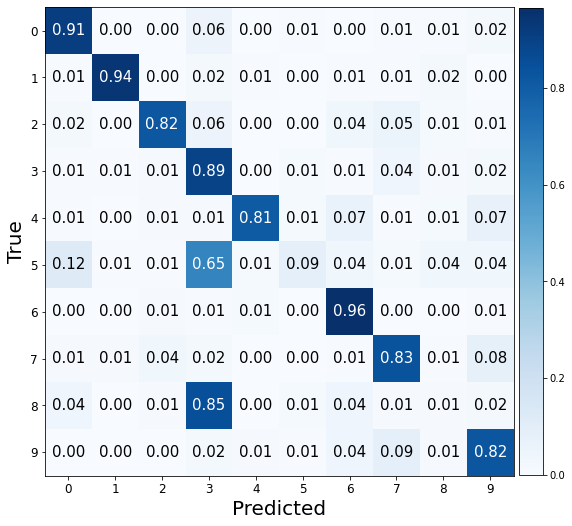

###################

ne: 100, hd:100, wd:0.01, lr: 0.01, bs:256 
Valid Evaluation loss: 1.3144805431365967. f1:0.6750628267489446 acc: 0.6779999732971191 


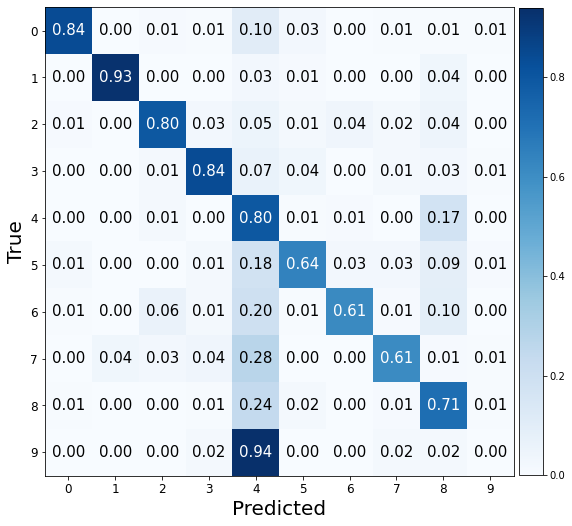

Valid Evaluation loss: 0.6071248650550842. f1:0.8085156607167768 acc: 0.8119999766349792 


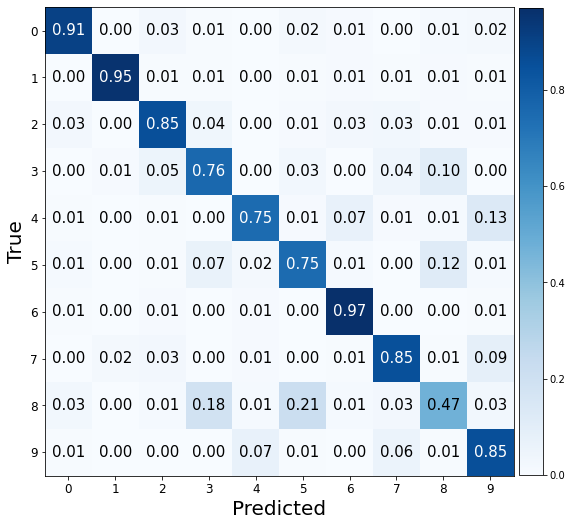

###################

ne: 100, hd:50, wd:0.1, lr: 0.01, bs:256 
Valid Evaluation loss: 1.4720463752746582. f1:0.43792068057792743 acc: 0.48500001430511475 


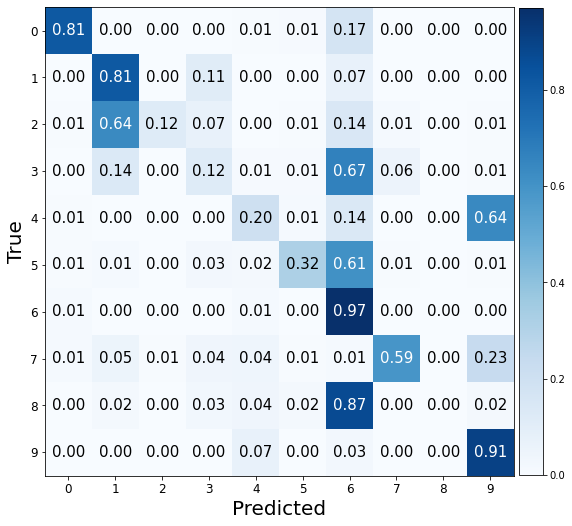

Valid Evaluation loss: 0.34159454703330994. f1:0.8995370558250182 acc: 0.8995000123977661 


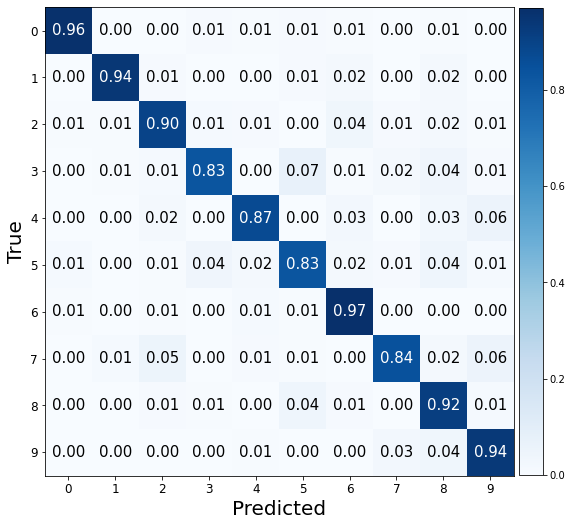

###################

ne: 100, hd:80, wd:0.1, lr: 0.01, bs:256 
Valid Evaluation loss: 0.7619515657424927. f1:0.825215807982459 acc: 0.8190000057220459 


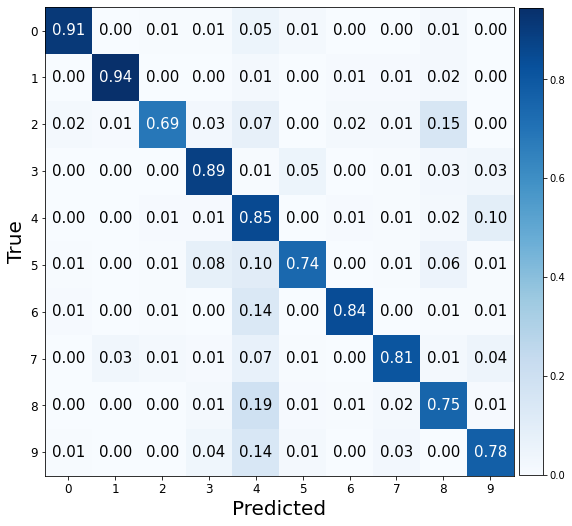

Valid Evaluation loss: 0.32443538308143616. f1:0.8983259673264545 acc: 0.8980000019073486 


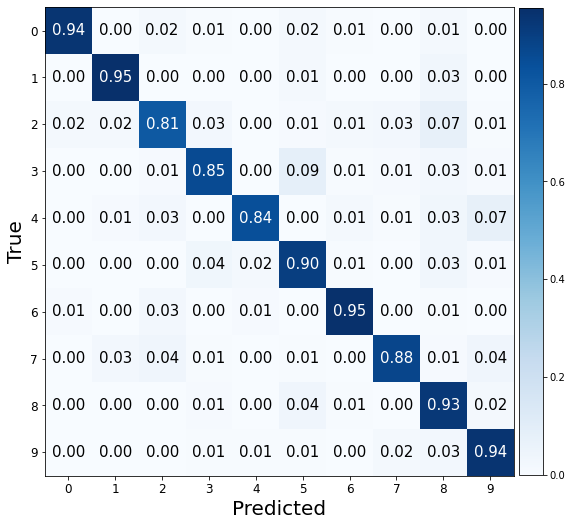

###################

ne: 100, hd:100, wd:0.1, lr: 0.01, bs:256 
Valid Evaluation loss: 0.8844493627548218. f1:0.7084313509181415 acc: 0.7245000004768372 


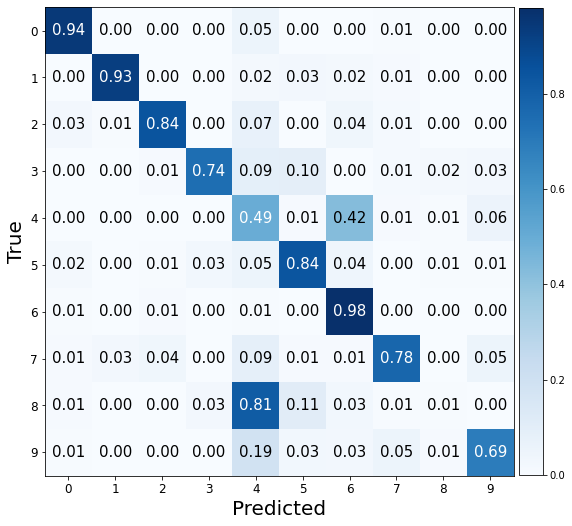

Valid Evaluation loss: 0.5188519358634949. f1:0.8396437305120374 acc: 0.8395000100135803 


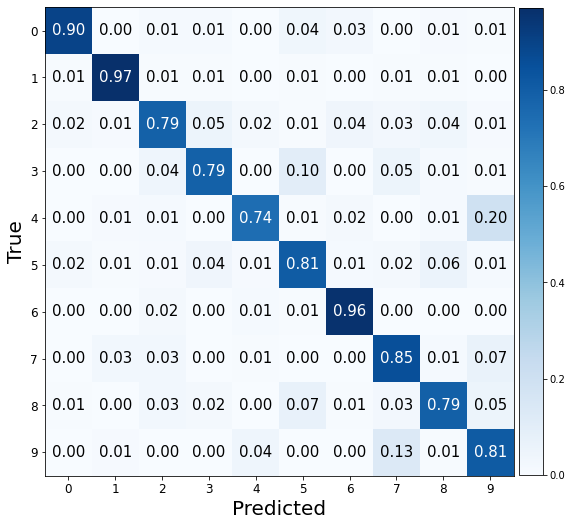

###################

ne: 100, hd:50, wd:0.001, lr: 0.1, bs:256 
Valid Evaluation loss: 2.291030168533325. f1:0.028011651528545983 acc: 0.10499999672174454 


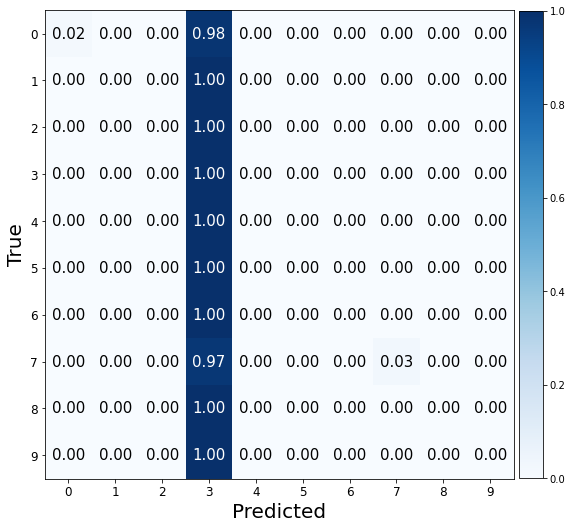

Valid Evaluation loss: 2.3027048110961914. f1:0.01818181818181818 acc: 0.10000000149011612 


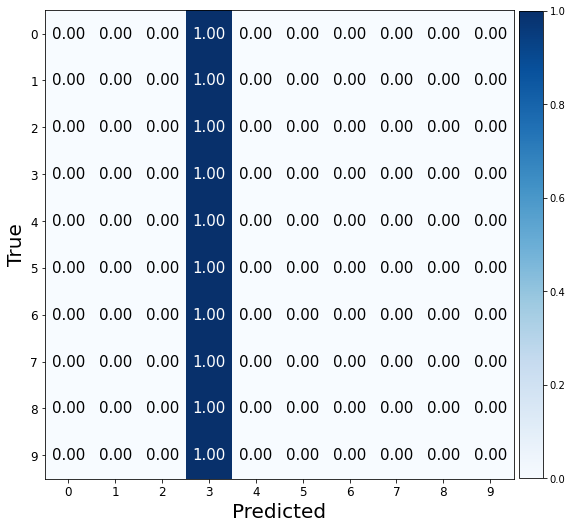

###################

ne: 100, hd:80, wd:0.001, lr: 0.1, bs:256 
Valid Evaluation loss: 3.797839879989624. f1:0.0836665204625781 acc: 0.14749999344348907 


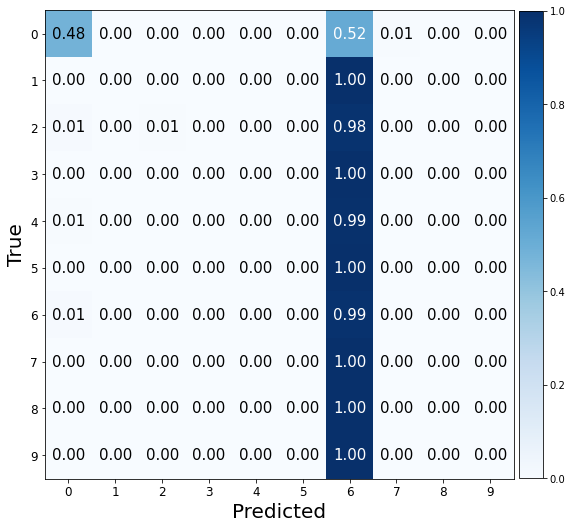

Valid Evaluation loss: 2.3029847145080566. f1:0.01818181818181818 acc: 0.10000000149011612 


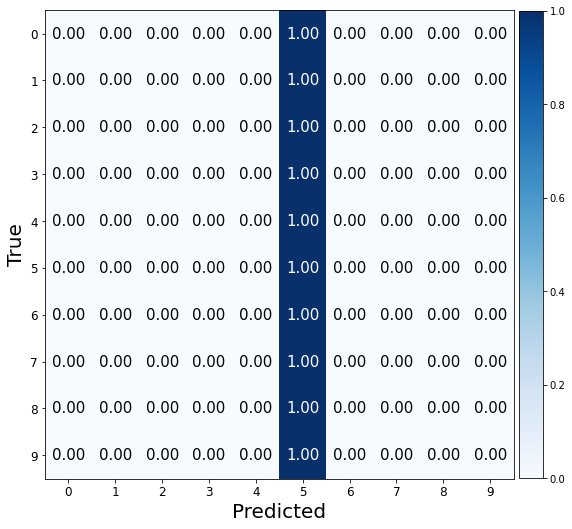

###################

ne: 100, hd:100, wd:0.001, lr: 0.1, bs:256 
Valid Evaluation loss: 2.227245569229126. f1:0.07022252700045759 acc: 0.1315000057220459 


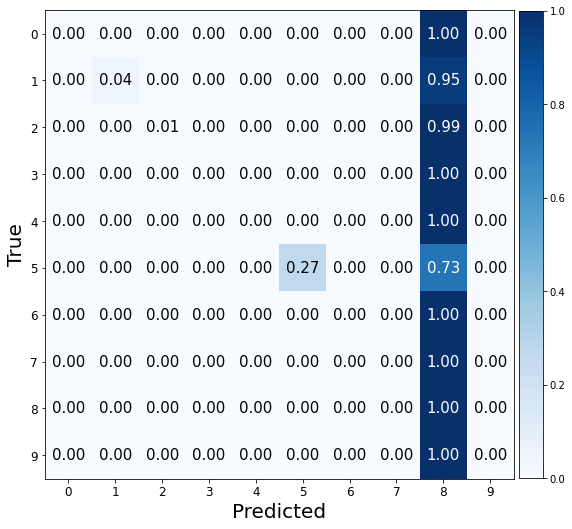

Valid Evaluation loss: 2.302605628967285. f1:0.01818181818181818 acc: 0.10000000149011612 


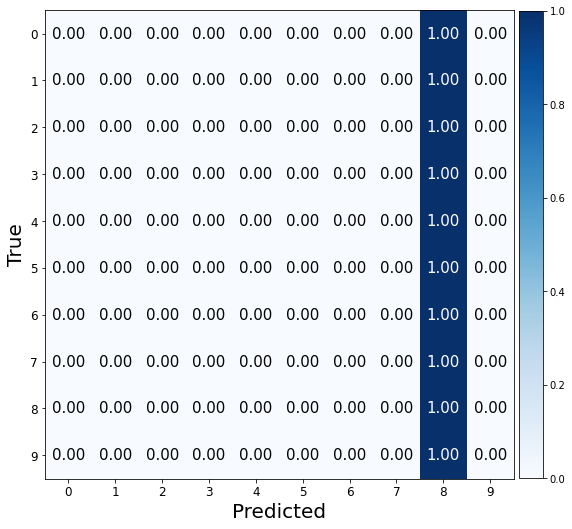

###################

ne: 100, hd:50, wd:0.01, lr: 0.1, bs:256 
Valid Evaluation loss: 2.302593231201172. f1:0.01818181818181818 acc: 0.10000000149011612 


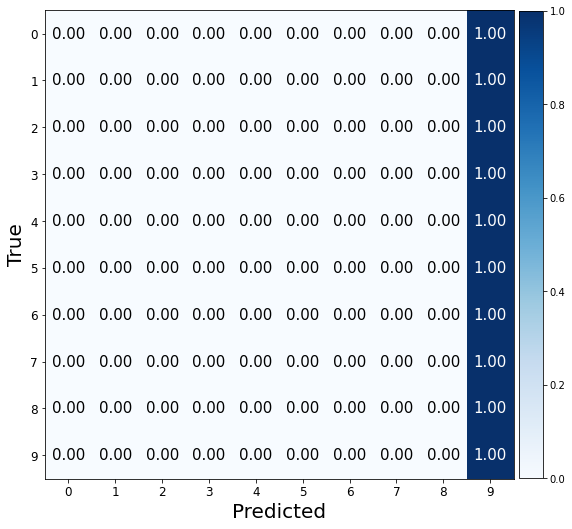

Valid Evaluation loss: 2.3026223182678223. f1:0.01818181818181818 acc: 0.10000000149011612 


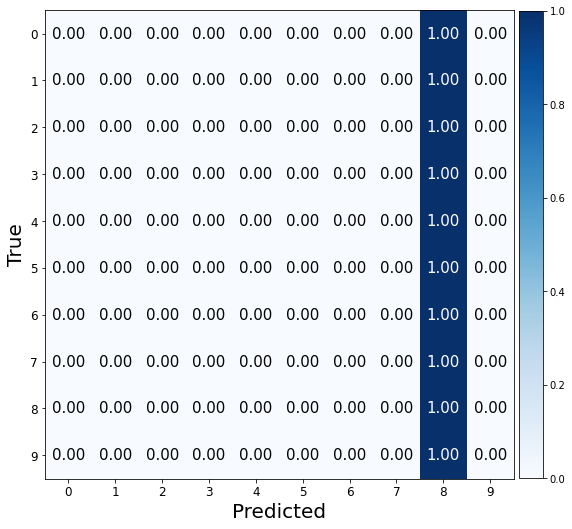

###################

ne: 100, hd:80, wd:0.01, lr: 0.1, bs:256 
Valid Evaluation loss: 2.9551444053649902. f1:0.19848469533369859 acc: 0.24300000071525574 


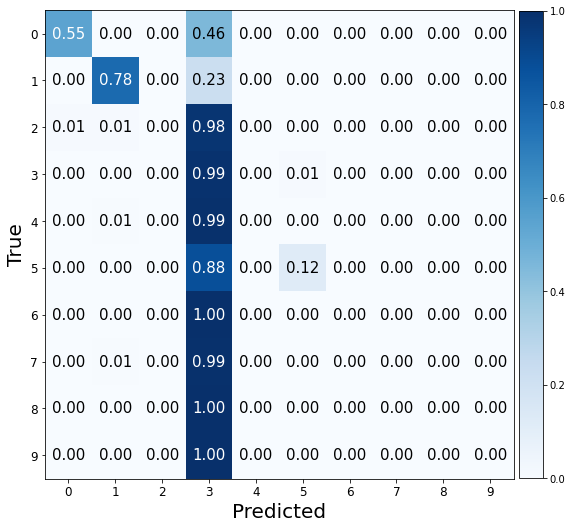

Valid Evaluation loss: 2.3054773807525635. f1:0.018190086402910415 acc: 0.10000000149011612 


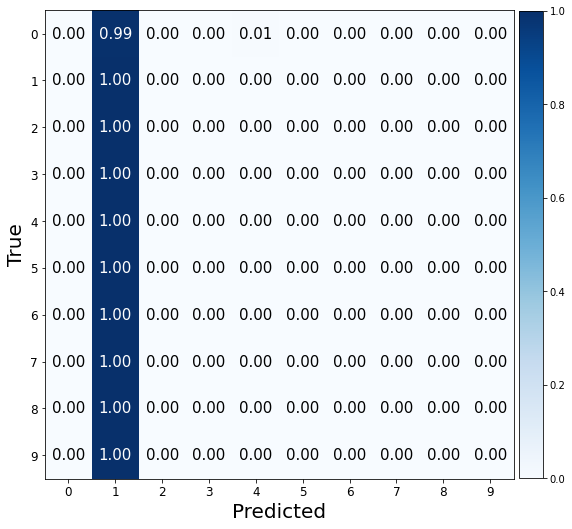

###################

ne: 100, hd:100, wd:0.01, lr: 0.1, bs:256 
Valid Evaluation loss: 4.913230895996094. f1:0.23109162667121907 acc: 0.2644999921321869 


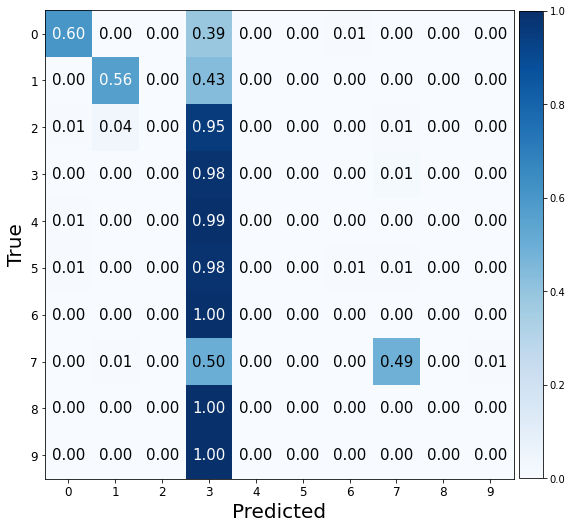

Valid Evaluation loss: 2.3051135540008545. f1:0.01818181818181818 acc: 0.10000000149011612 


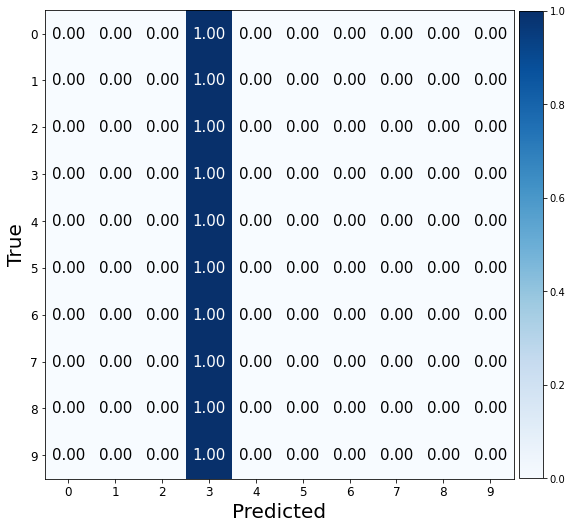

###################

ne: 100, hd:50, wd:0.1, lr: 0.1, bs:256 
Valid Evaluation loss: 2.091959238052368. f1:0.14684518011481046 acc: 0.21050000190734863 


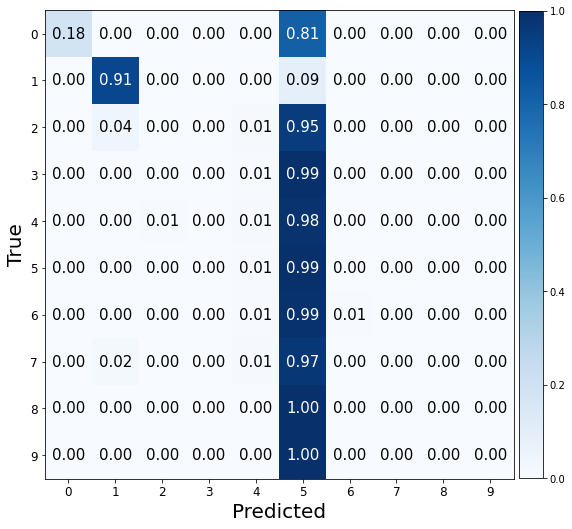

Valid Evaluation loss: 2.366438865661621. f1:0.019627990440941753 acc: 0.09799999743700027 


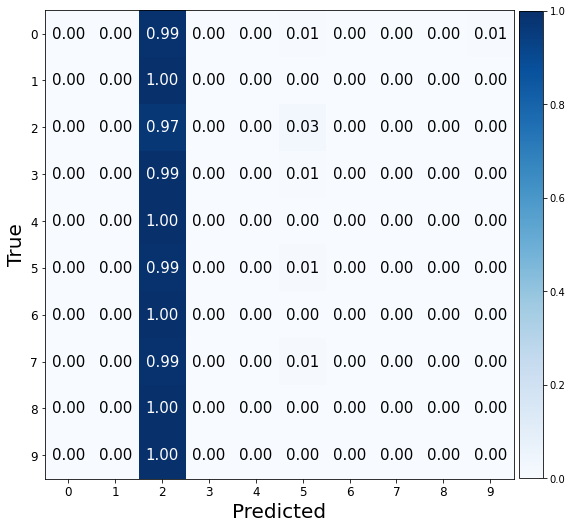

###################

ne: 100, hd:80, wd:0.1, lr: 0.1, bs:256 
Valid Evaluation loss: 2.323441505432129. f1:0.02829638159545416 acc: 0.10499999672174454 


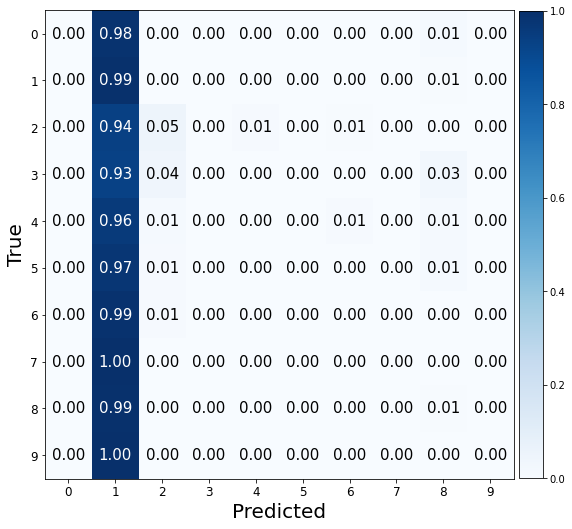

Valid Evaluation loss: 2.4437482357025146. f1:0.12152259786527779 acc: 0.17149999737739563 


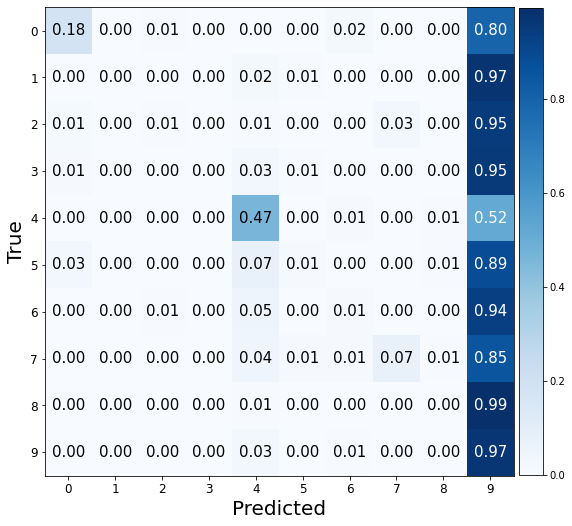

###################

ne: 100, hd:100, wd:0.1, lr: 0.1, bs:256 
Valid Evaluation loss: 2.4109947681427. f1:0.07645122306955035 acc: 0.1404999941587448 


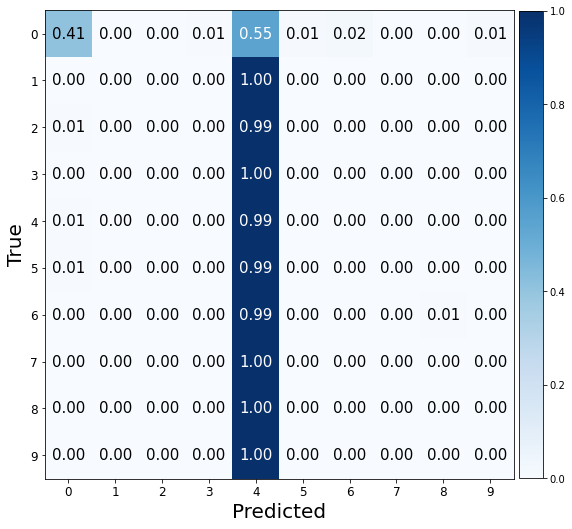

Valid Evaluation loss: 2.4984512329101562. f1:0.09950757569494255 acc: 0.15800000727176666 


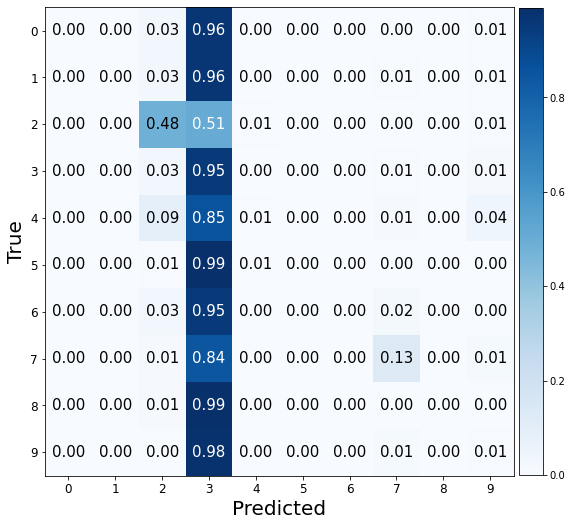

###################

ne: 100, hd:50, wd:0.001, lr: 0.001, bs:512 
Valid Evaluation loss: 0.7652133703231812. f1:0.8515510975674709 acc: 0.8514999747276306 


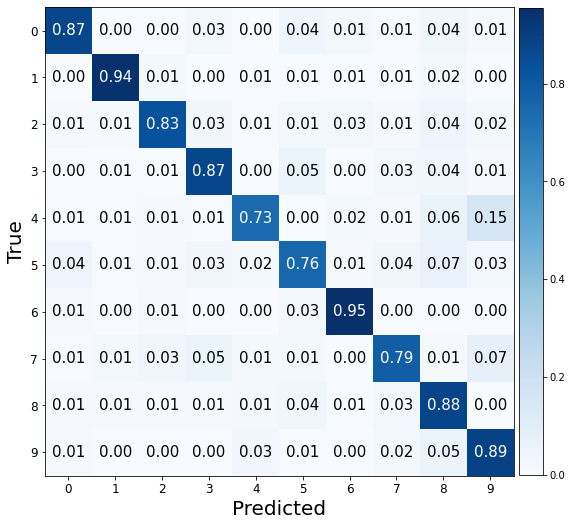

Valid Evaluation loss: 0.3504040241241455. f1:0.9035922623547779 acc: 0.9039999842643738 


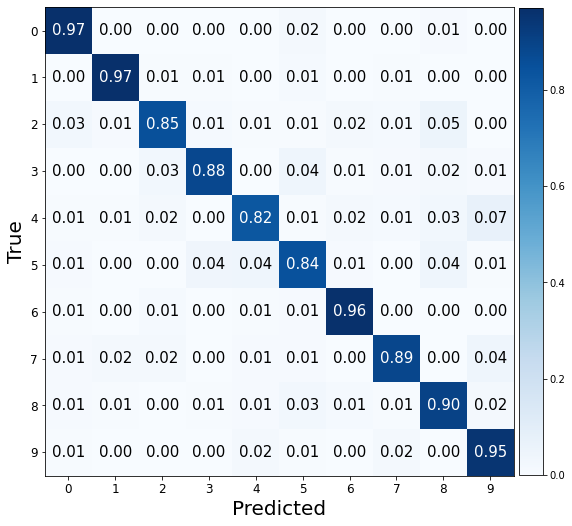

###################

ne: 100, hd:80, wd:0.001, lr: 0.001, bs:512 
Valid Evaluation loss: 0.7214150428771973. f1:0.8769066194685834 acc: 0.8769999742507935 


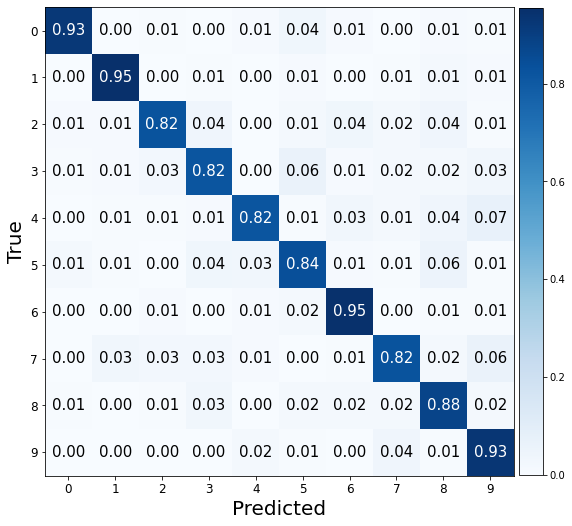

Valid Evaluation loss: 0.3693762421607971. f1:0.8986175393407567 acc: 0.8985000252723694 


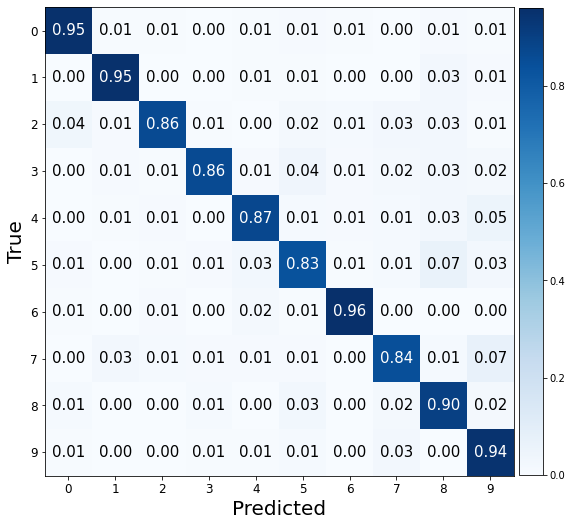

###################

ne: 100, hd:100, wd:0.001, lr: 0.001, bs:512 
Valid Evaluation loss: 0.6901147365570068. f1:0.9026546177735384 acc: 0.9024999737739563 


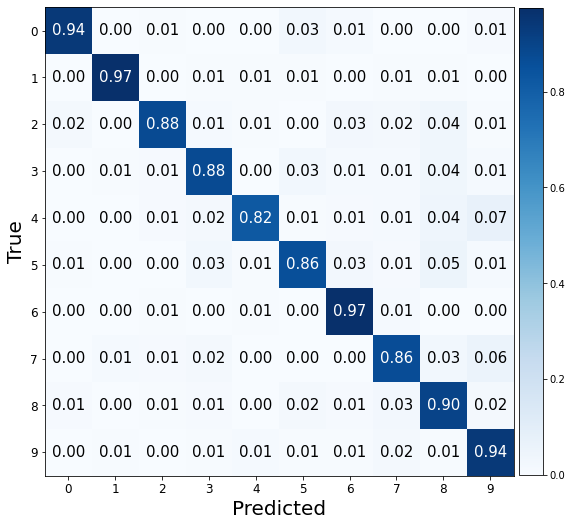

Valid Evaluation loss: 0.3559536337852478. f1:0.9062215346976423 acc: 0.906499981880188 


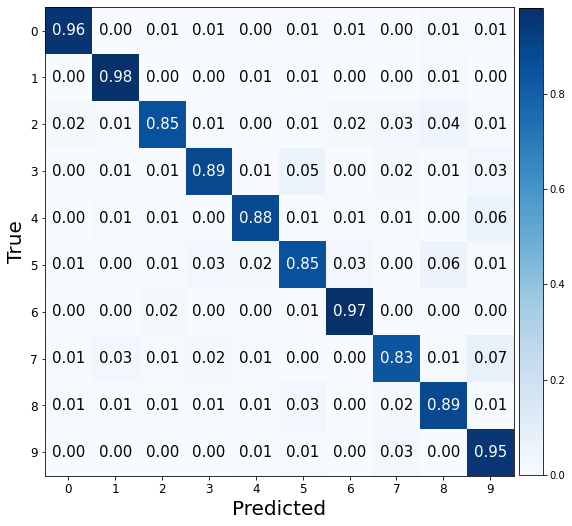

###################

ne: 100, hd:50, wd:0.01, lr: 0.001, bs:512 
Valid Evaluation loss: 0.6665475368499756. f1:0.8362550823410814 acc: 0.8360000252723694 


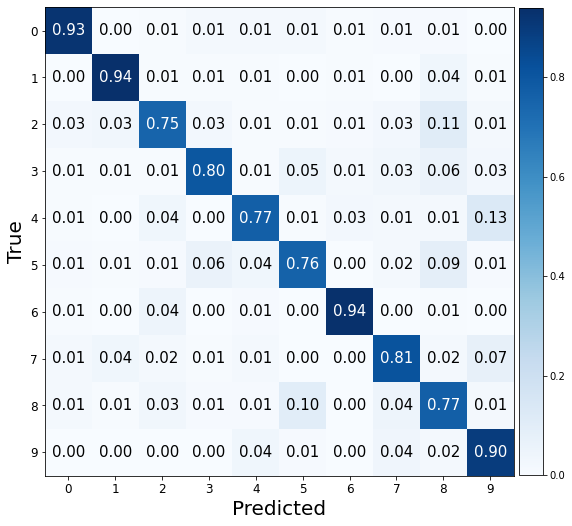

Valid Evaluation loss: 0.40000295639038086. f1:0.8960049298786139 acc: 0.8960000276565552 


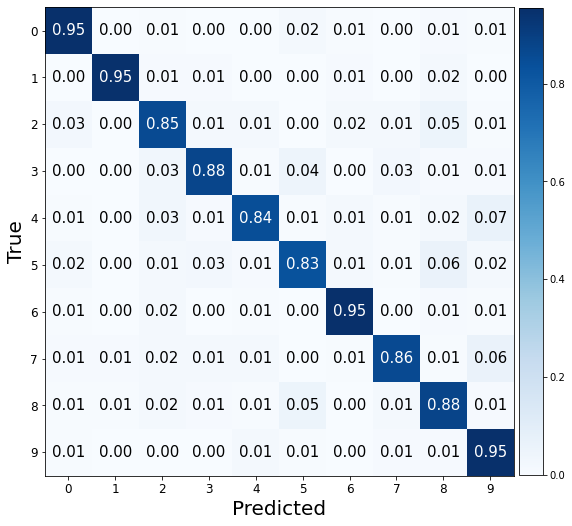

###################

ne: 100, hd:80, wd:0.01, lr: 0.001, bs:512 
Valid Evaluation loss: 0.7774072885513306. f1:0.8668833649270276 acc: 0.8669999837875366 


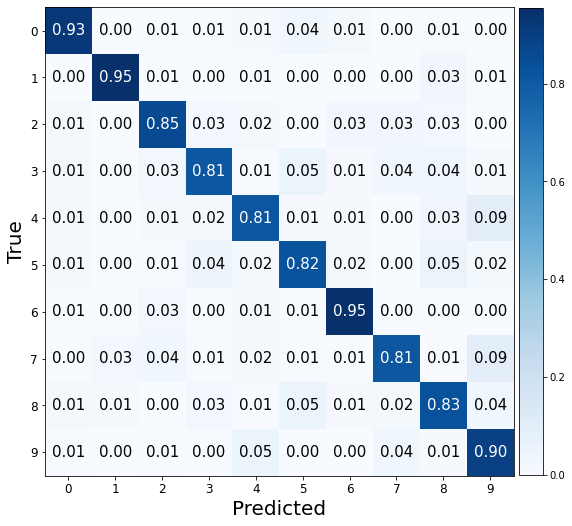

Valid Evaluation loss: 0.370429128408432. f1:0.9049559267837607 acc: 0.9049999713897705 


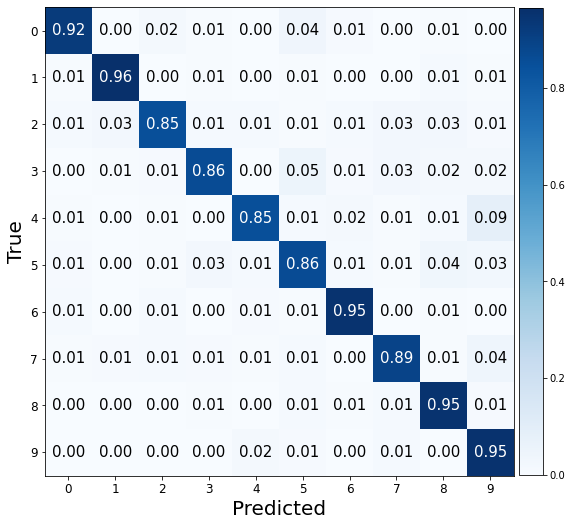

###################

ne: 100, hd:100, wd:0.01, lr: 0.001, bs:512 
Valid Evaluation loss: 0.5788066983222961. f1:0.8891180193272572 acc: 0.8895000219345093 


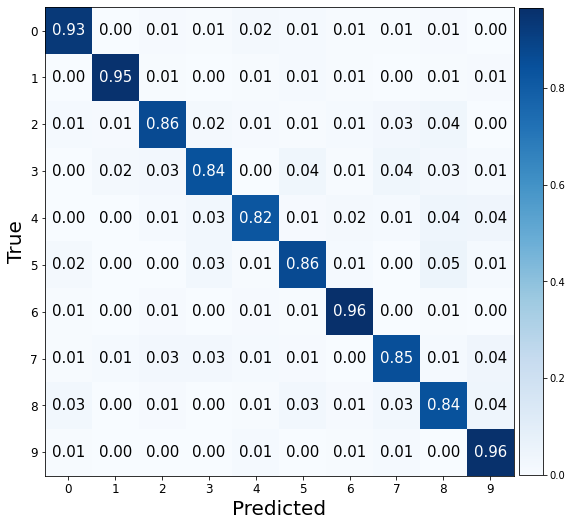

Valid Evaluation loss: 0.29997047781944275. f1:0.9170633872977977 acc: 0.9169999957084656 


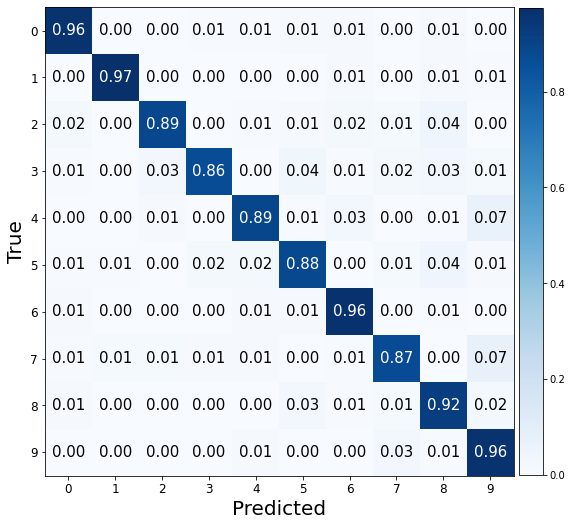

###################

ne: 100, hd:50, wd:0.1, lr: 0.001, bs:512 
Valid Evaluation loss: 0.613541305065155. f1:0.8625326172787551 acc: 0.862500011920929 


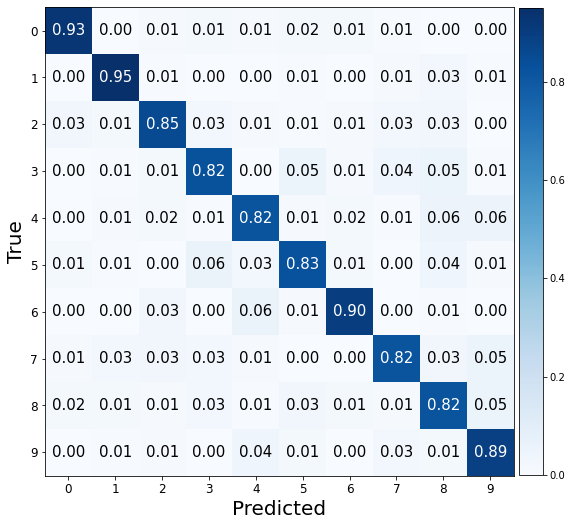

Valid Evaluation loss: 0.41115063428878784. f1:0.8744221153086332 acc: 0.8744999766349792 


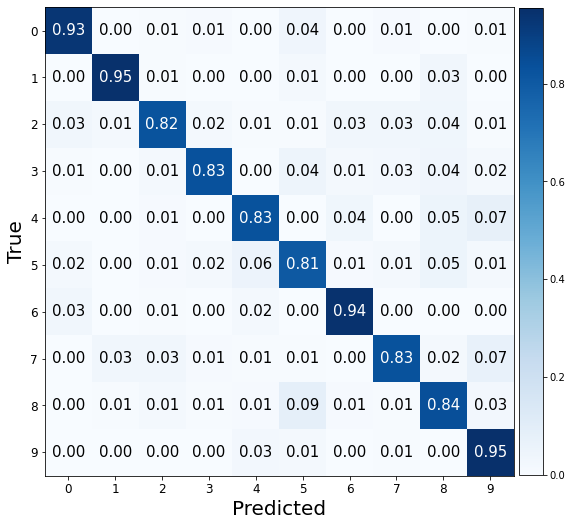

###################

ne: 100, hd:80, wd:0.1, lr: 0.001, bs:512 
Valid Evaluation loss: 0.55560702085495. f1:0.8927623298305335 acc: 0.8930000066757202 


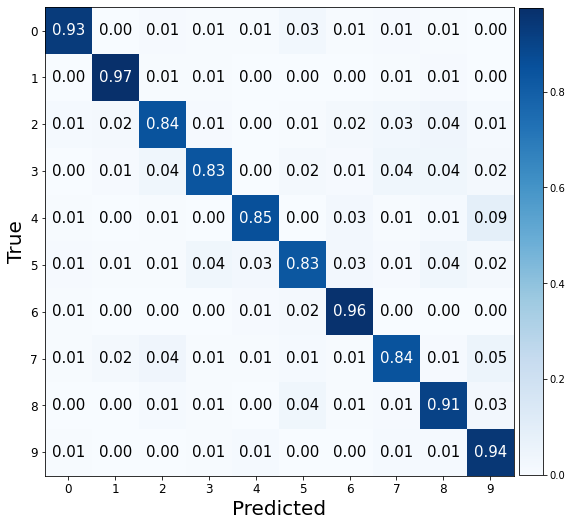

Valid Evaluation loss: 0.30093085765838623. f1:0.9074423448832267 acc: 0.9075000286102295 


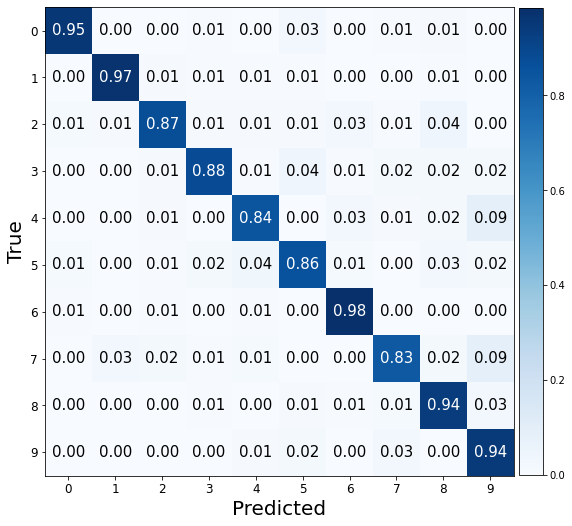

###################

ne: 100, hd:100, wd:0.1, lr: 0.001, bs:512 
Valid Evaluation loss: 0.61468505859375. f1:0.8839566736293115 acc: 0.8840000033378601 


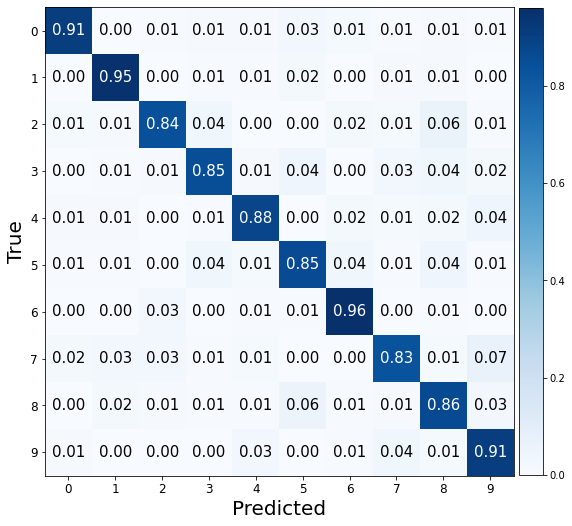

Valid Evaluation loss: 0.2931526005268097. f1:0.9139070915679838 acc: 0.9139999747276306 


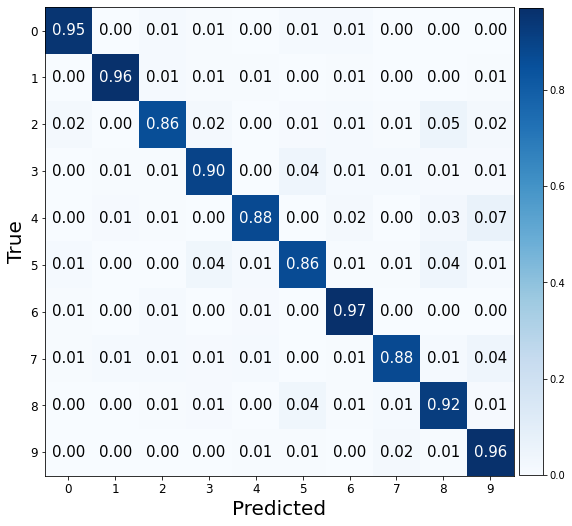

###################

ne: 100, hd:50, wd:0.001, lr: 0.01, bs:512 
Valid Evaluation loss: 1.2442044019699097. f1:0.6944846275596837 acc: 0.699999988079071 


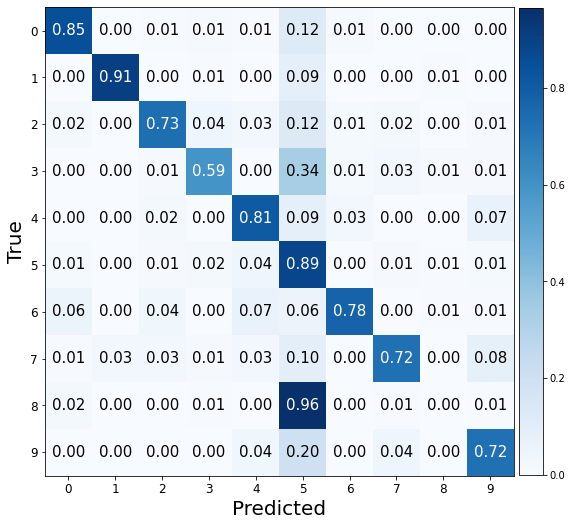

Valid Evaluation loss: 0.5939922332763672. f1:0.8517236627537607 acc: 0.8525000214576721 


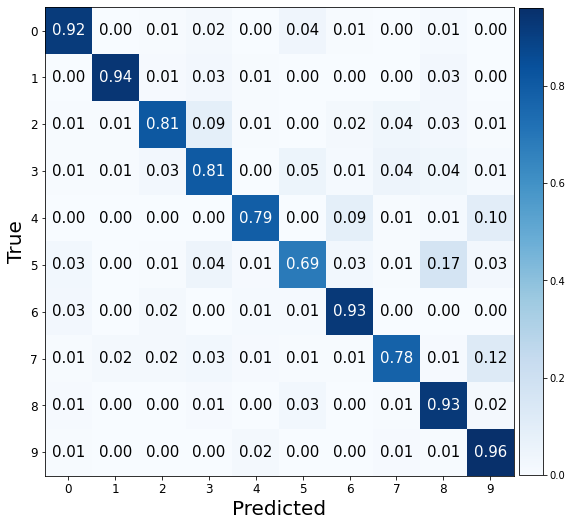

###################

ne: 100, hd:80, wd:0.001, lr: 0.01, bs:512 
Valid Evaluation loss: 1.22969388961792. f1:0.5921320063639209 acc: 0.6134999990463257 


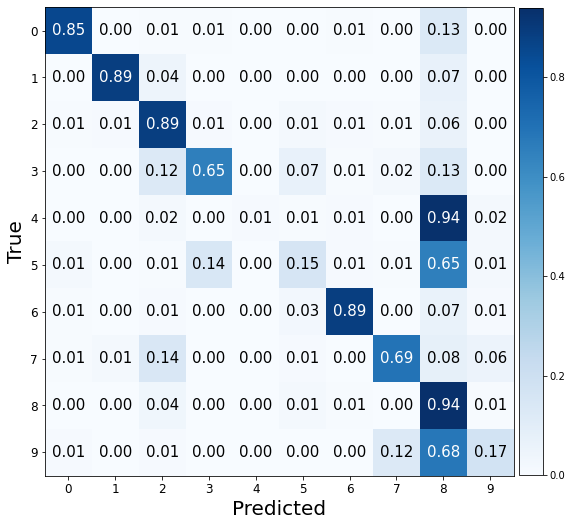

Valid Evaluation loss: 1.5203742980957031. f1:0.38741399919802405 acc: 0.4505000114440918 


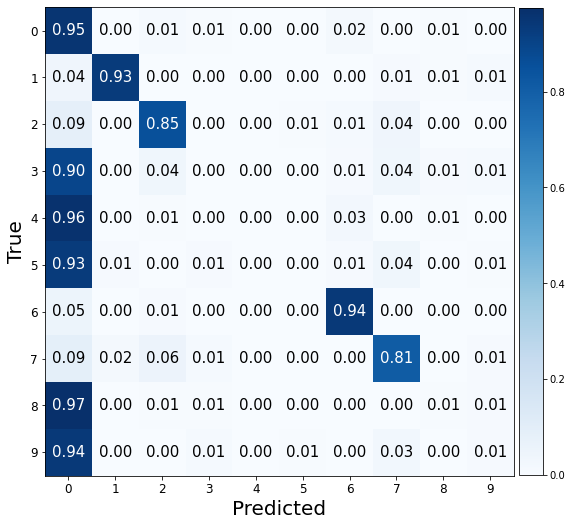

###################

ne: 100, hd:100, wd:0.001, lr: 0.01, bs:512 
Valid Evaluation loss: 1.3116306066513062. f1:0.7095220991707437 acc: 0.6915000081062317 


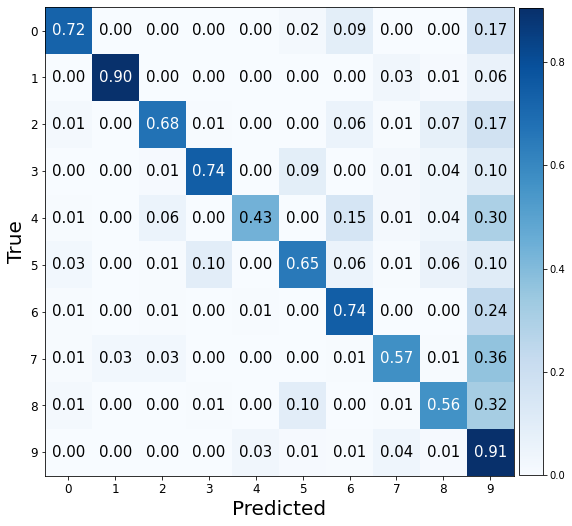

Valid Evaluation loss: 1.070932388305664. f1:0.5996000435611912 acc: 0.6370000243186951 


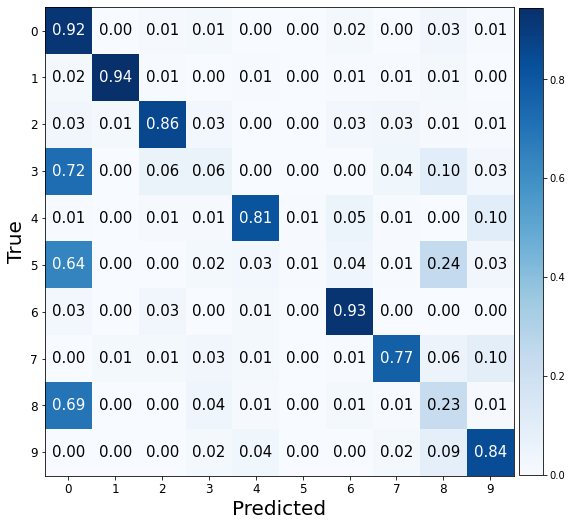

###################

ne: 100, hd:50, wd:0.01, lr: 0.01, bs:512 
Valid Evaluation loss: 1.7503416538238525. f1:0.35999223023085525 acc: 0.39500001072883606 


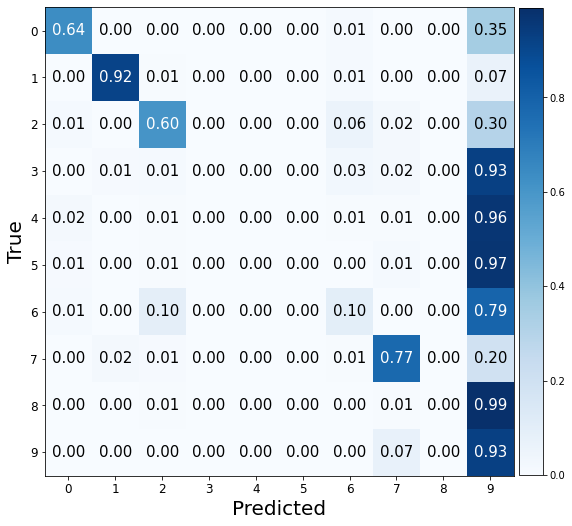

Valid Evaluation loss: 1.390695333480835. f1:0.39079785455174587 acc: 0.45750001072883606 


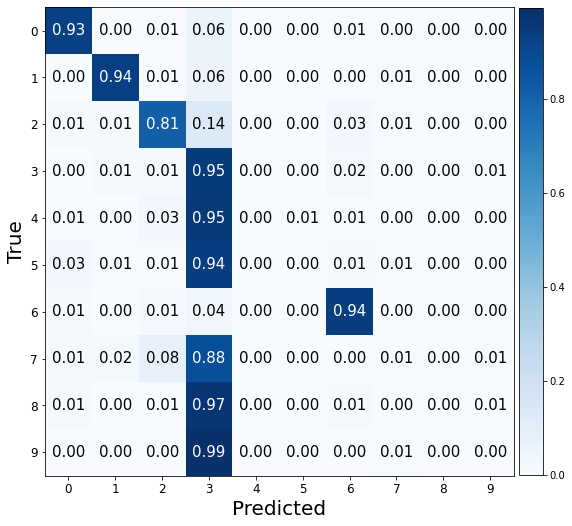

###################

ne: 100, hd:80, wd:0.01, lr: 0.01, bs:512 
Valid Evaluation loss: 1.1031800508499146. f1:0.7231777321521167 acc: 0.703499972820282 


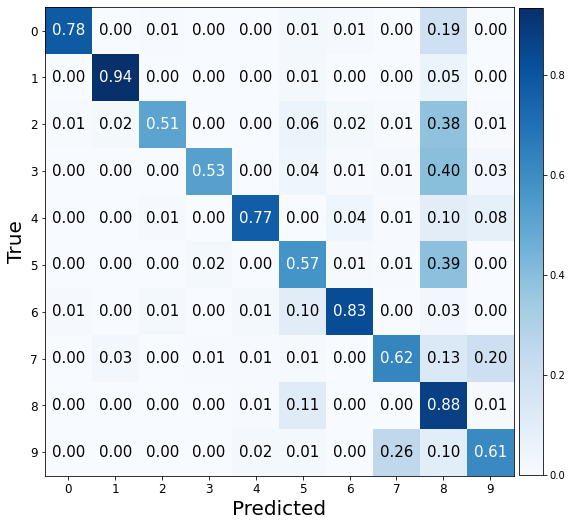

Valid Evaluation loss: 0.5830349326133728. f1:0.8448491741187413 acc: 0.8450000286102295 


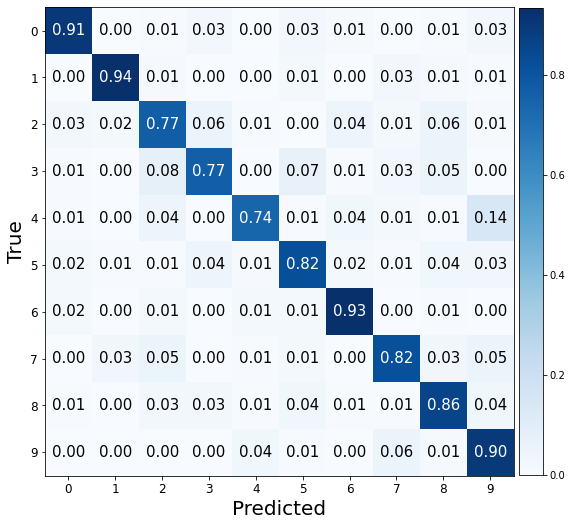

###################

ne: 100, hd:100, wd:0.01, lr: 0.01, bs:512 
Valid Evaluation loss: 1.3051096200942993. f1:0.582205755186602 acc: 0.5820000171661377 


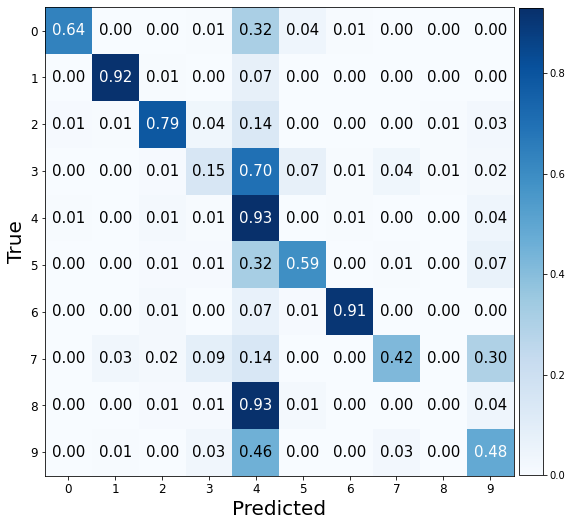

Valid Evaluation loss: 0.6016444563865662. f1:0.8536524137730586 acc: 0.8525000214576721 


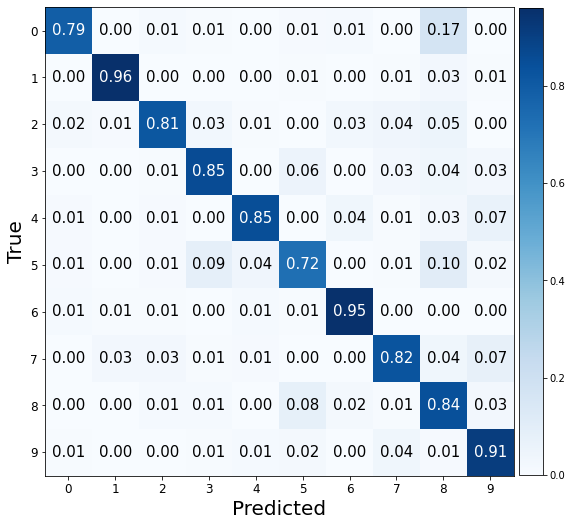

###################

ne: 100, hd:50, wd:0.1, lr: 0.01, bs:512 
Valid Evaluation loss: 1.0076406002044678. f1:0.716431276965576 acc: 0.7059999704360962 


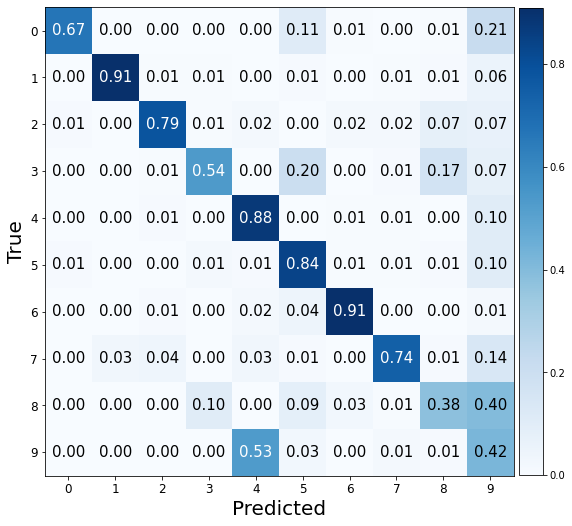

Valid Evaluation loss: 0.3228820860385895. f1:0.8978723718645842 acc: 0.8980000019073486 


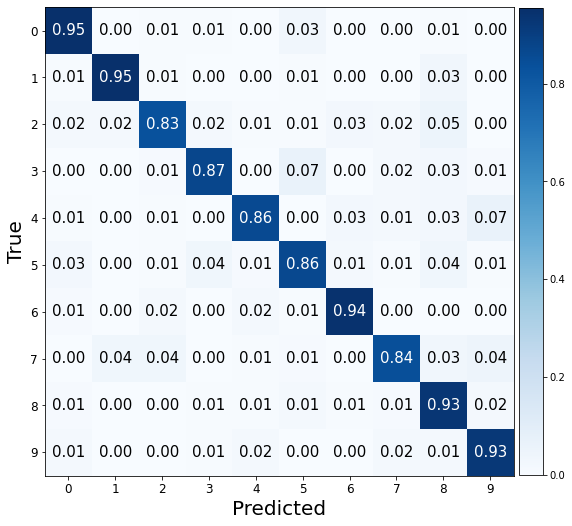

###################

ne: 100, hd:80, wd:0.1, lr: 0.01, bs:512 
Valid Evaluation loss: 1.276821255683899. f1:0.5591421676334257 acc: 0.5920000076293945 


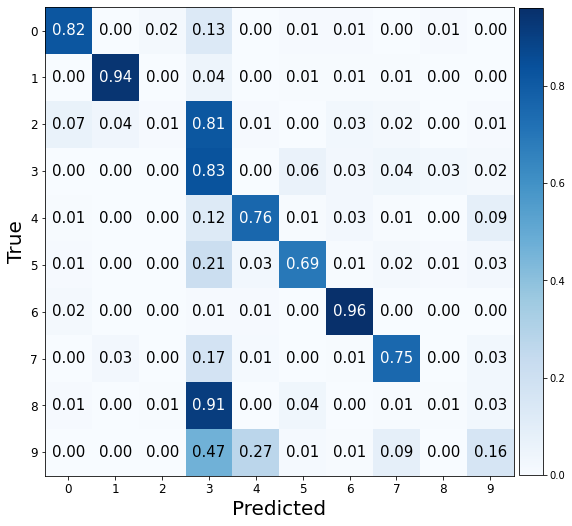

Valid Evaluation loss: 0.3798326253890991. f1:0.8959520732503347 acc: 0.8964999914169312 


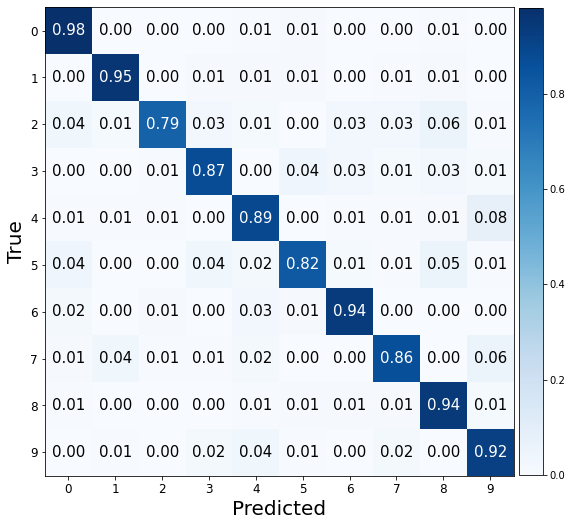

###################

ne: 100, hd:100, wd:0.1, lr: 0.01, bs:512 
Valid Evaluation loss: 1.1670304536819458. f1:0.6147998720648978 acc: 0.6445000171661377 


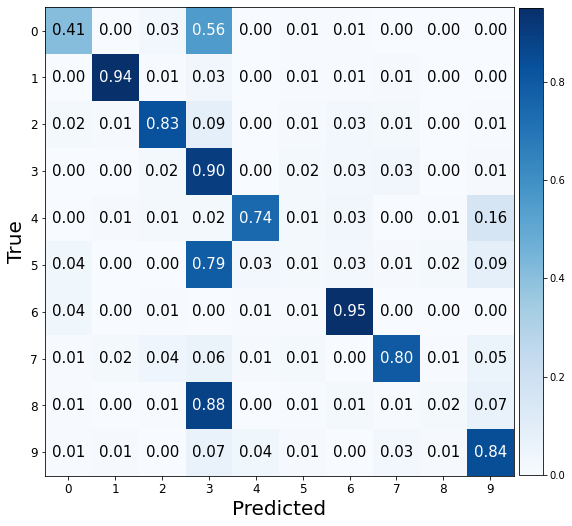

Valid Evaluation loss: 0.3834947347640991. f1:0.8792050252471737 acc: 0.8799999952316284 


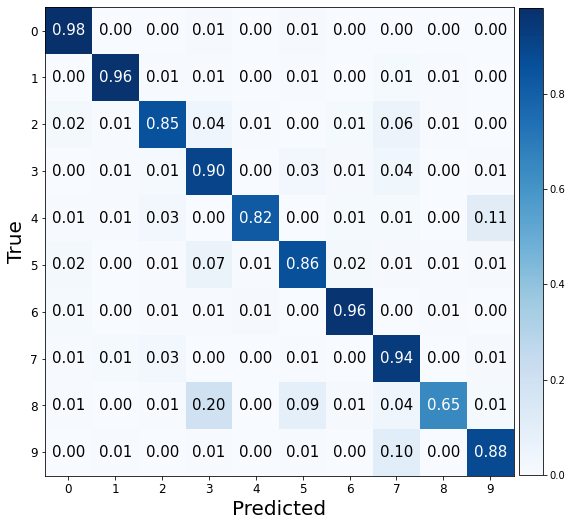

###################

ne: 100, hd:50, wd:0.001, lr: 0.1, bs:512 
Valid Evaluation loss: 2.212648391723633. f1:0.07174700627782848 acc: 0.13600000739097595 


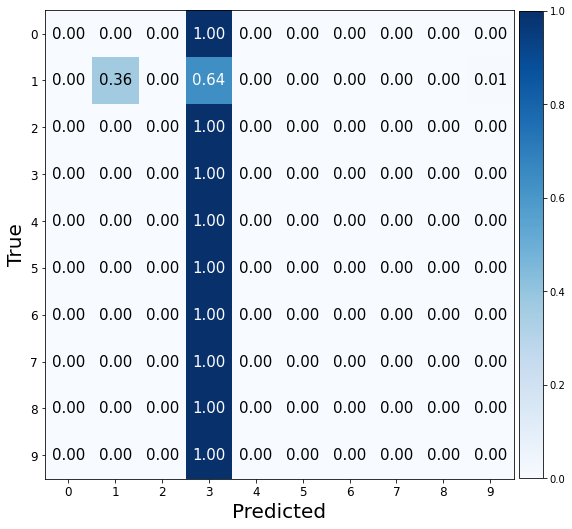

Valid Evaluation loss: 5.437361240386963. f1:0.11096357407060187 acc: 0.18400000035762787 


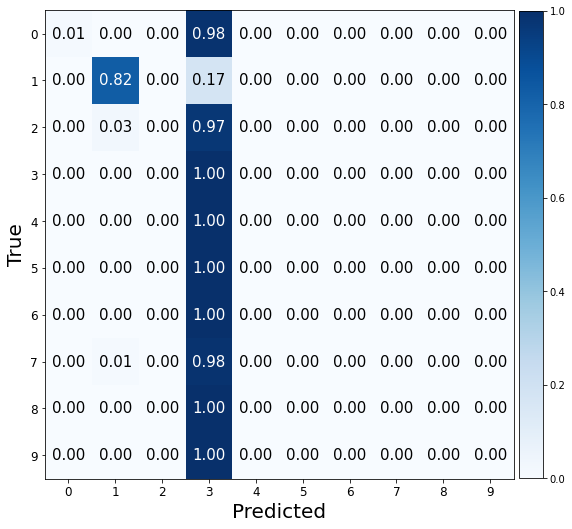

###################

ne: 100, hd:80, wd:0.001, lr: 0.1, bs:512 
Valid Evaluation loss: 3.232074737548828. f1:0.1257563778024909 acc: 0.18649999797344208 


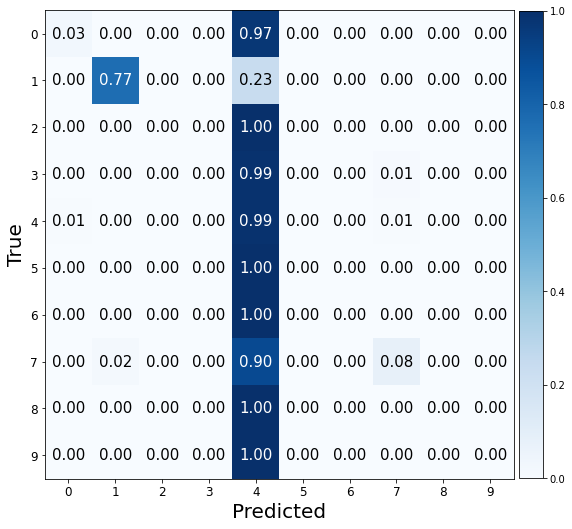

Valid Evaluation loss: 2.3026113510131836. f1:0.01818181818181818 acc: 0.10000000149011612 


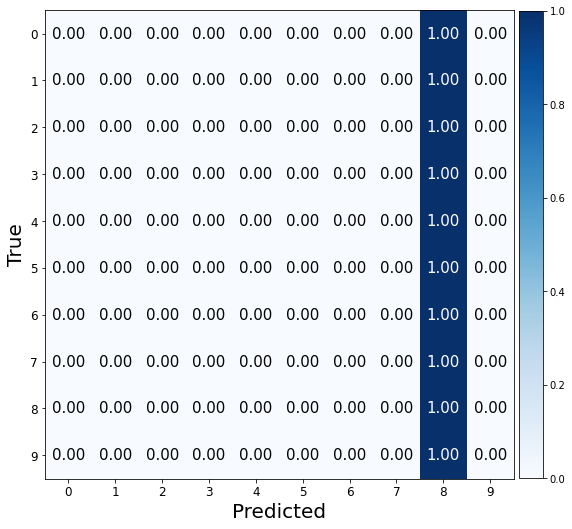

###################

ne: 100, hd:100, wd:0.001, lr: 0.1, bs:512 
Valid Evaluation loss: 3.9520254135131836. f1:0.17558575886986305 acc: 0.21199999749660492 


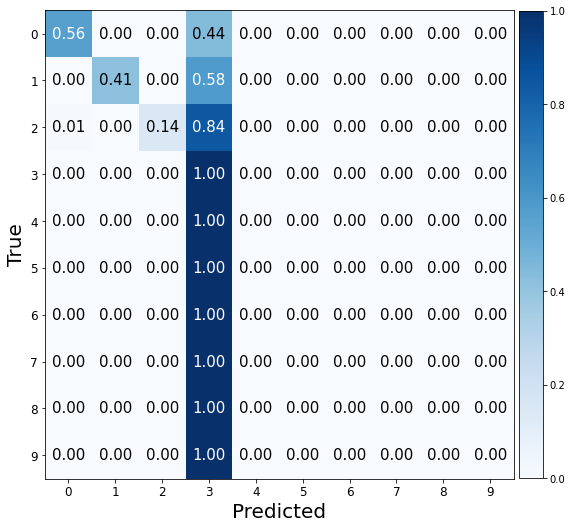

Valid Evaluation loss: 2.3025875091552734. f1:0.01818181818181818 acc: 0.10000000149011612 


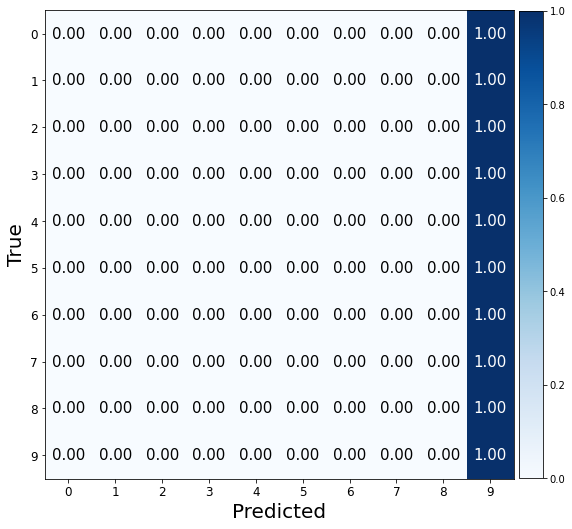

###################

ne: 100, hd:50, wd:0.01, lr: 0.1, bs:512 
Valid Evaluation loss: 2.373716354370117. f1:0.019193387023028627 acc: 0.10050000250339508 


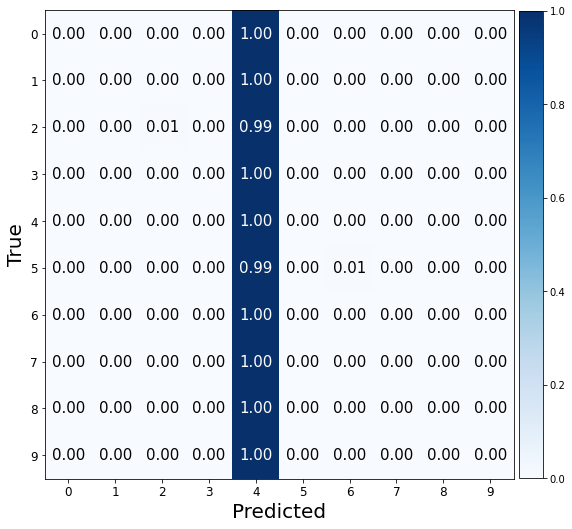

Valid Evaluation loss: 2.306075096130371. f1:0.01922656544079965 acc: 0.10050000250339508 


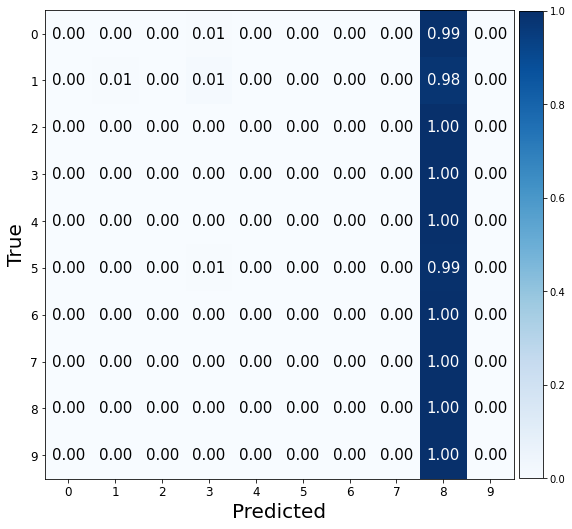

###################

ne: 100, hd:80, wd:0.01, lr: 0.1, bs:512 
Valid Evaluation loss: 2.3014562129974365. f1:0.019185111278532306 acc: 0.10050000250339508 


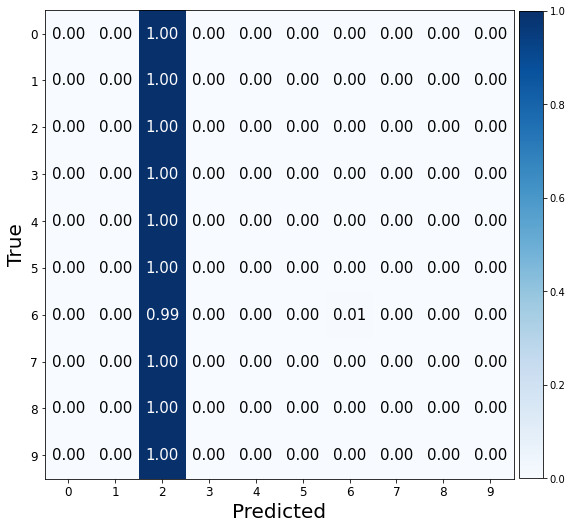

Valid Evaluation loss: 2.302612781524658. f1:0.01818181818181818 acc: 0.10000000149011612 


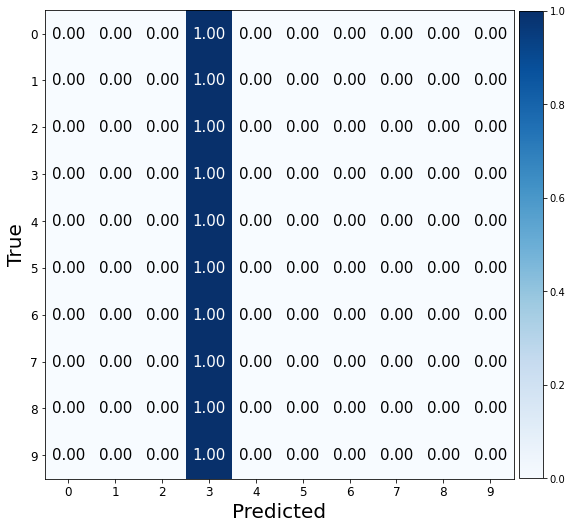

###################

ne: 100, hd:100, wd:0.01, lr: 0.1, bs:512 
Valid Evaluation loss: 2.915515661239624. f1:0.16763384661496383 acc: 0.2214999943971634 


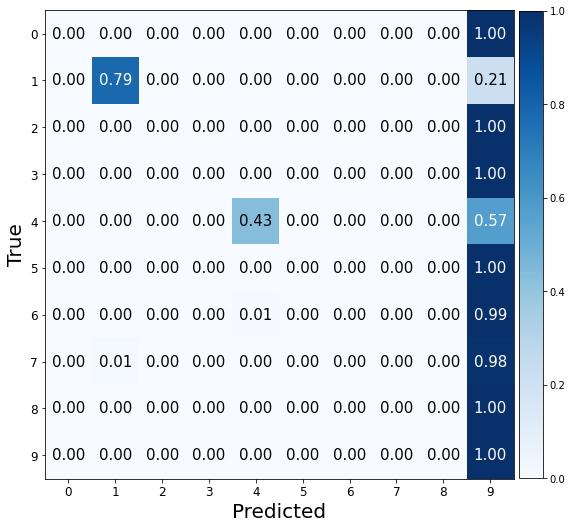

Valid Evaluation loss: 6.240747451782227. f1:0.026540417703948792 acc: 0.10450000315904617 


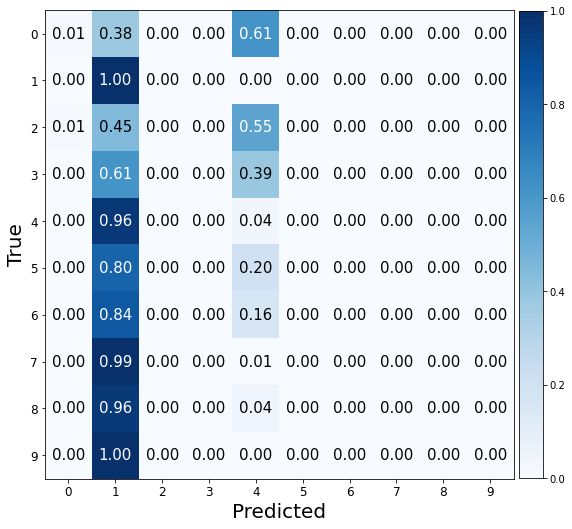

###################

ne: 100, hd:50, wd:0.1, lr: 0.1, bs:512 
Valid Evaluation loss: 2.171933889389038. f1:0.1552024954969522 acc: 0.21400000154972076 


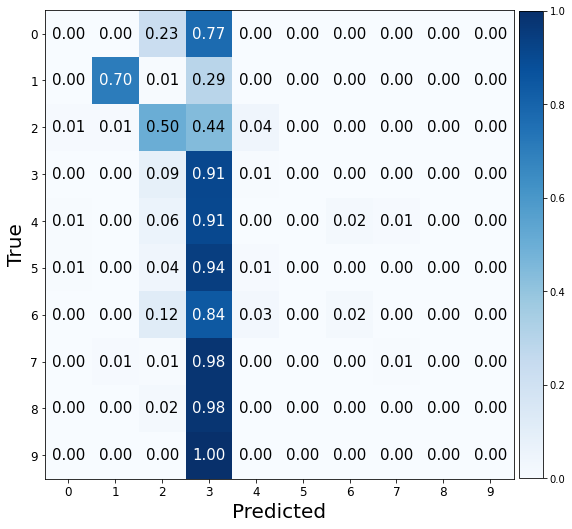

Valid Evaluation loss: 4.003754615783691. f1:0.08412214751324851 acc: 0.15800000727176666 


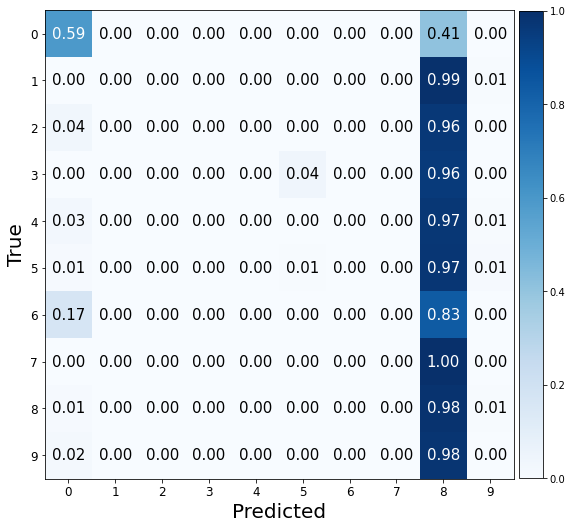

###################

ne: 100, hd:80, wd:0.1, lr: 0.1, bs:512 
Valid Evaluation loss: 431.06915283203125. f1:0.09822969316506641 acc: 0.21199999749660492 


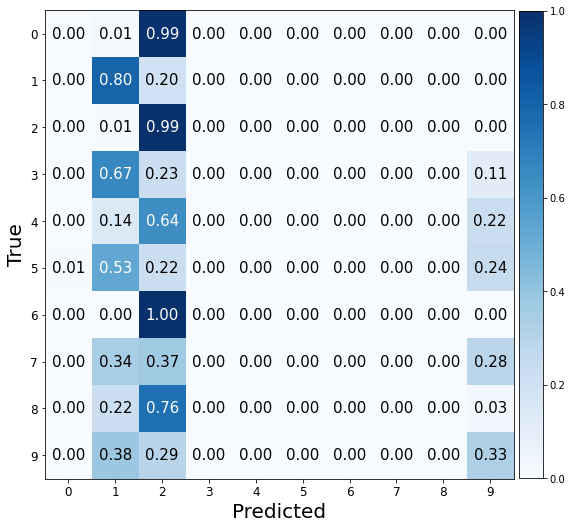

Valid Evaluation loss: 2.37607479095459. f1:0.018165221360109535 acc: 0.09950000047683716 


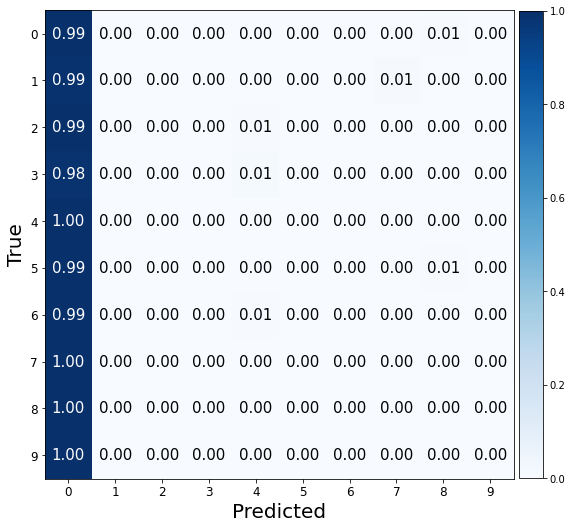

###################

ne: 100, hd:100, wd:0.1, lr: 0.1, bs:512 
Valid Evaluation loss: 2.1612601280212402. f1:0.17230102974466474 acc: 0.22050000727176666 


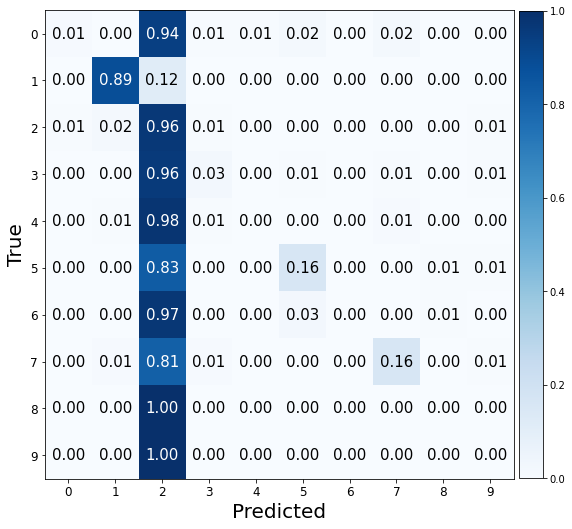

Valid Evaluation loss: 2.365760326385498. f1:0.021793344203352986 acc: 0.09950000047683716 


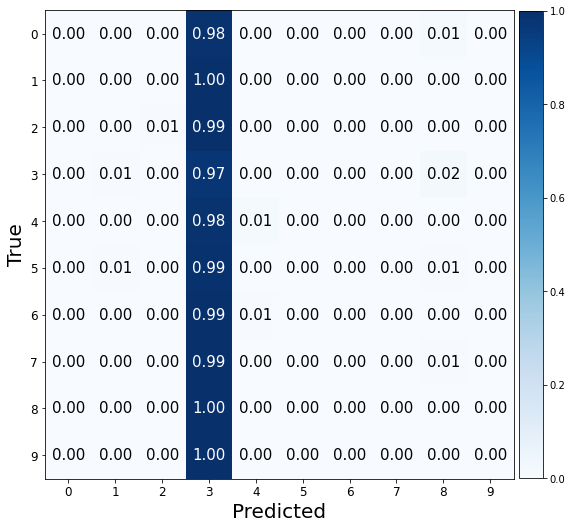

###################

ne: 100, hd:50, wd:0.001, lr: 0.001, bs:1024 
Valid Evaluation loss: 0.8067001104354858. f1:0.8802570136928416 acc: 0.8805000185966492 


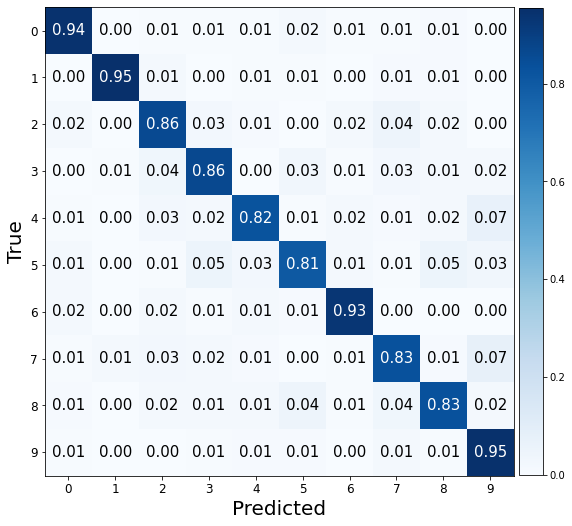

Valid Evaluation loss: 0.3726773262023926. f1:0.9029417546580856 acc: 0.902999997138977 


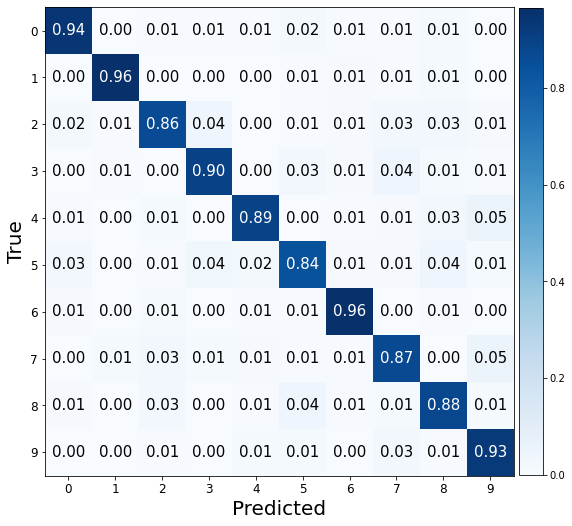

###################

ne: 100, hd:80, wd:0.001, lr: 0.001, bs:1024 
Valid Evaluation loss: 0.728243887424469. f1:0.871851513455465 acc: 0.871999979019165 


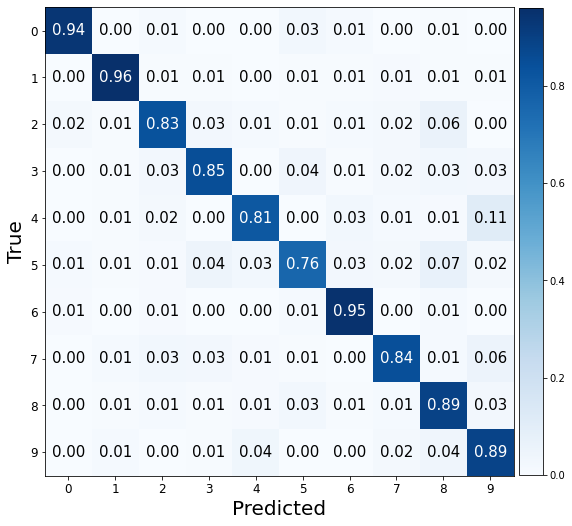

Valid Evaluation loss: 0.3509276509284973. f1:0.9100001510410891 acc: 0.9104999899864197 


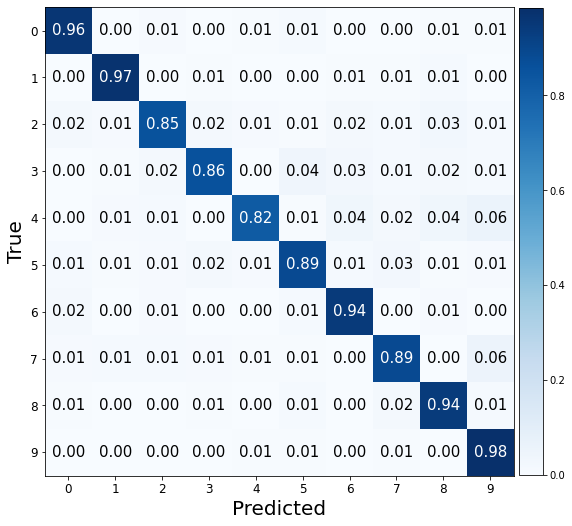

###################

ne: 100, hd:100, wd:0.001, lr: 0.001, bs:1024 
Valid Evaluation loss: 0.855235755443573. f1:0.8831028552386929 acc: 0.8830000162124634 


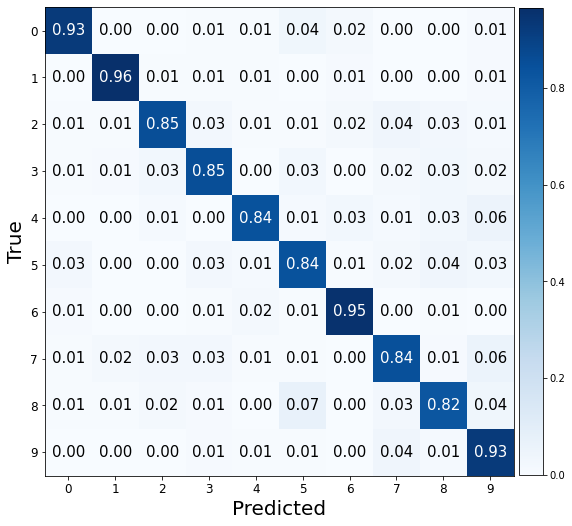

Valid Evaluation loss: 0.3345399796962738. f1:0.9052587538669055 acc: 0.9054999947547913 


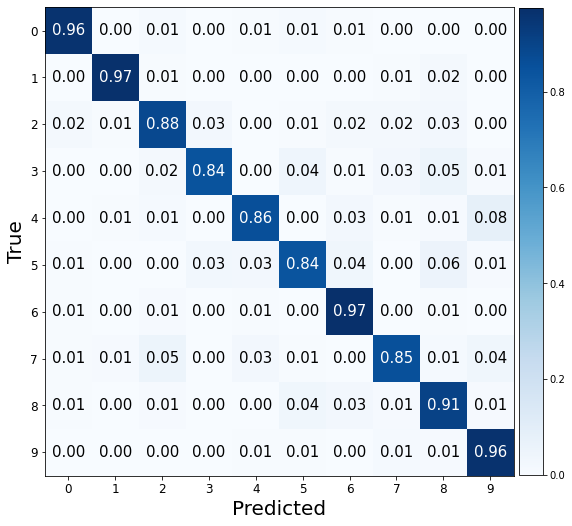

###################

ne: 100, hd:50, wd:0.01, lr: 0.001, bs:1024 
Valid Evaluation loss: 0.6986750364303589. f1:0.8362478958498671 acc: 0.8370000123977661 


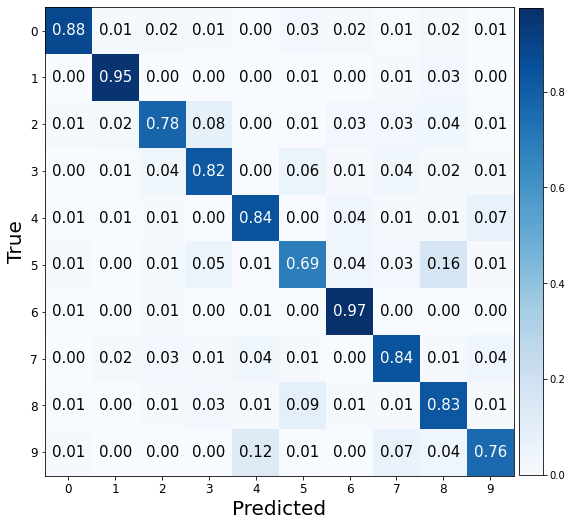

Valid Evaluation loss: 0.37413734197616577. f1:0.8881501179539246 acc: 0.8884999752044678 


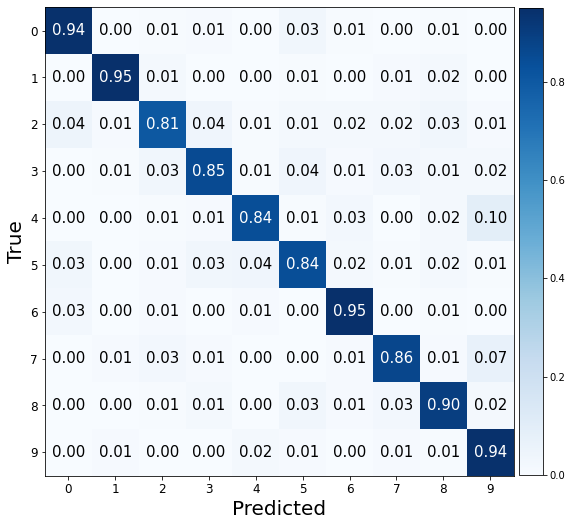

###################

ne: 100, hd:80, wd:0.01, lr: 0.001, bs:1024 
Valid Evaluation loss: 0.6592569947242737. f1:0.8587986072077133 acc: 0.859000027179718 


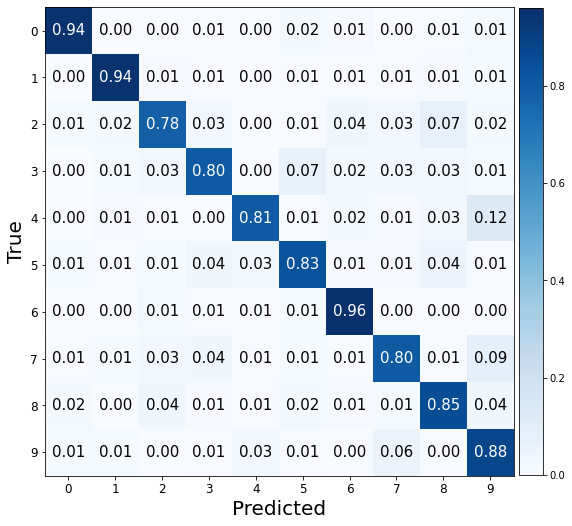

Valid Evaluation loss: 0.39823323488235474. f1:0.9052095500652317 acc: 0.9054999947547913 


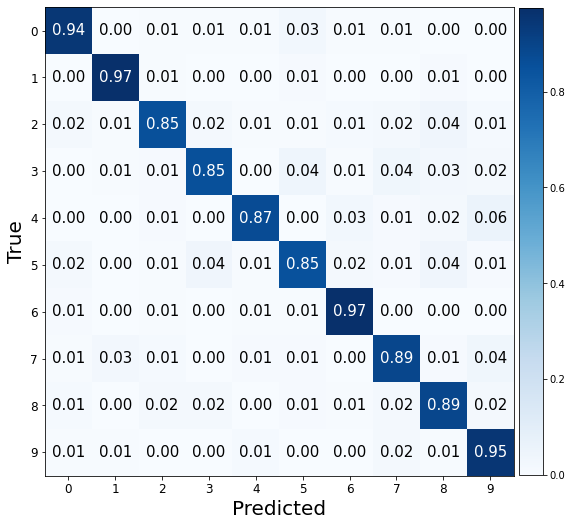

###################

ne: 100, hd:100, wd:0.01, lr: 0.001, bs:1024 
Valid Evaluation loss: 0.6043306589126587. f1:0.8841441350682905 acc: 0.8845000267028809 


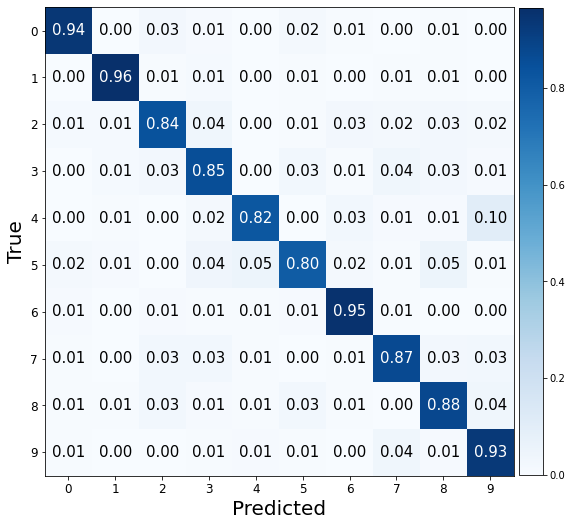

Valid Evaluation loss: 0.31126293540000916. f1:0.9152683971872667 acc: 0.9154999852180481 


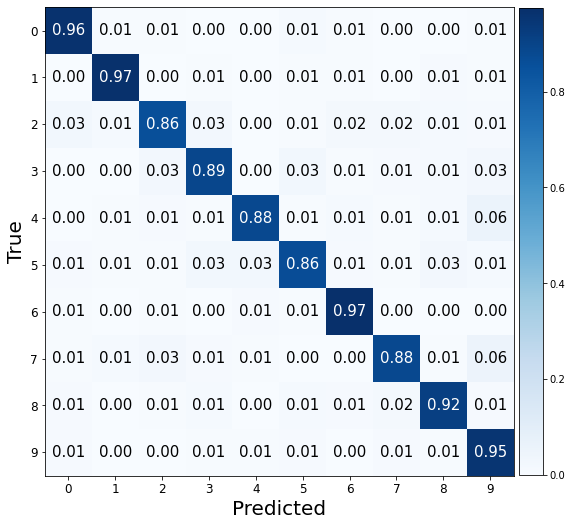

###################

ne: 100, hd:50, wd:0.1, lr: 0.001, bs:1024 
Valid Evaluation loss: 0.6393035054206848. f1:0.8703291617022814 acc: 0.8705000281333923 


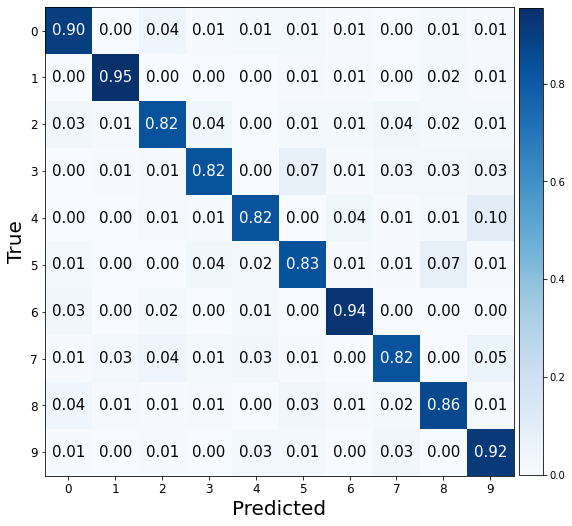

Valid Evaluation loss: 0.32806986570358276. f1:0.9033340182948579 acc: 0.9035000205039978 


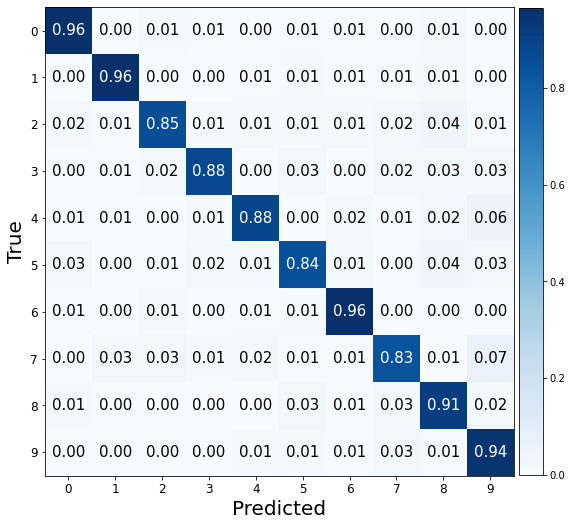

###################

ne: 100, hd:80, wd:0.1, lr: 0.001, bs:1024 
Valid Evaluation loss: 0.5910138487815857. f1:0.8796842298185521 acc: 0.8799999952316284 


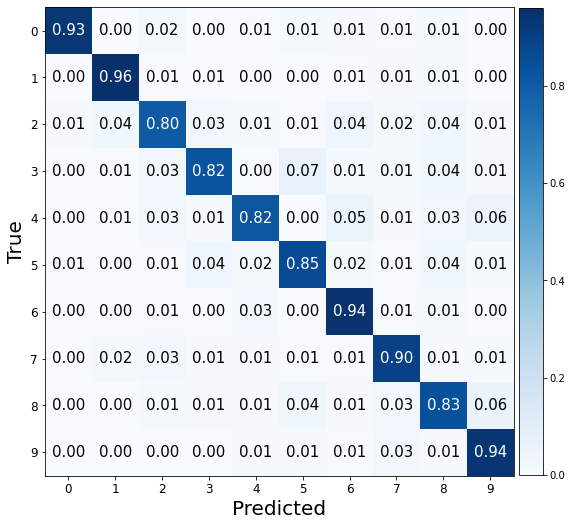

Valid Evaluation loss: 0.2784380614757538. f1:0.9144986925448488 acc: 0.9144999980926514 


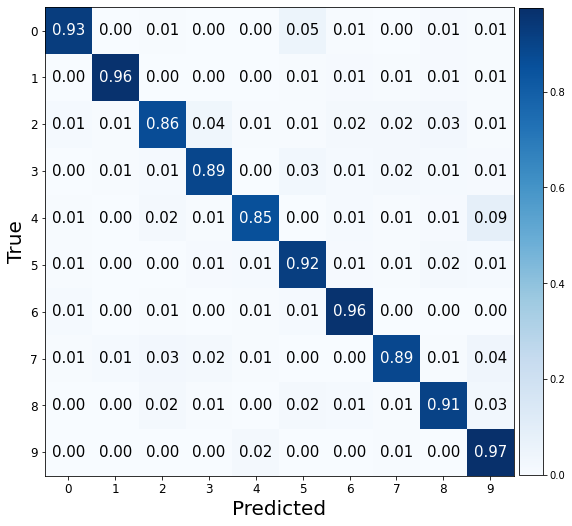

###################

ne: 100, hd:100, wd:0.1, lr: 0.001, bs:1024 
Valid Evaluation loss: 0.5253200531005859. f1:0.8842098452008079 acc: 0.8845000267028809 


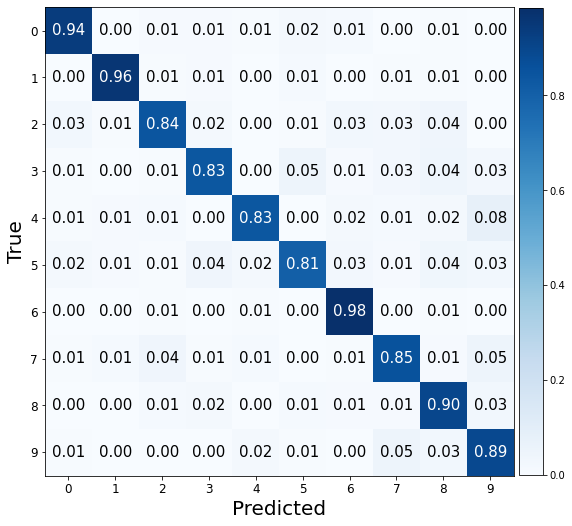

Valid Evaluation loss: 0.29818740487098694. f1:0.9027207169947615 acc: 0.902999997138977 


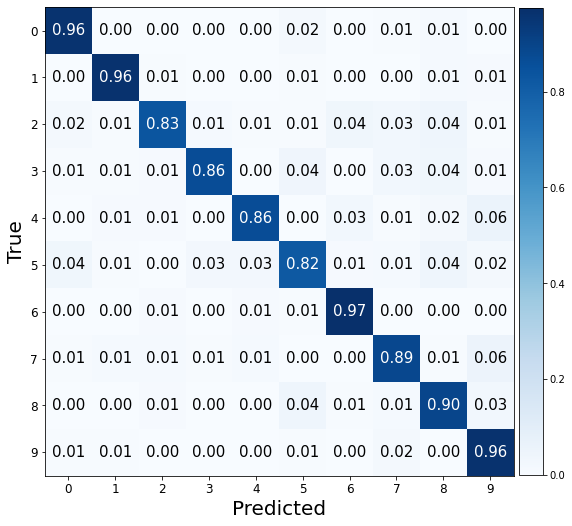

###################

ne: 100, hd:50, wd:0.001, lr: 0.01, bs:1024 
Valid Evaluation loss: 1.2037150859832764. f1:0.7069291557148272 acc: 0.7049999833106995 


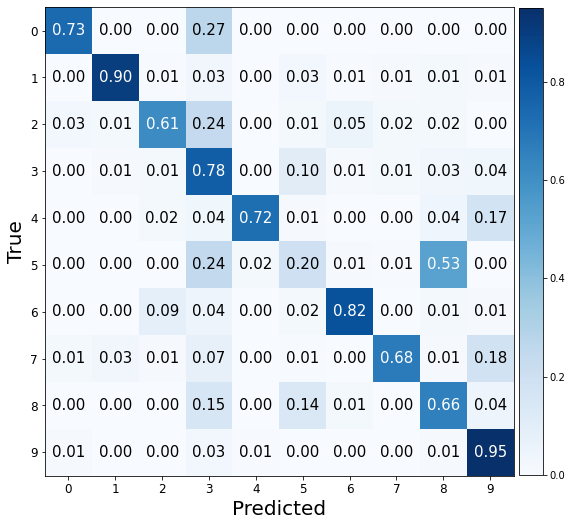

Valid Evaluation loss: 0.607420802116394. f1:0.8315479327046121 acc: 0.8309999704360962 


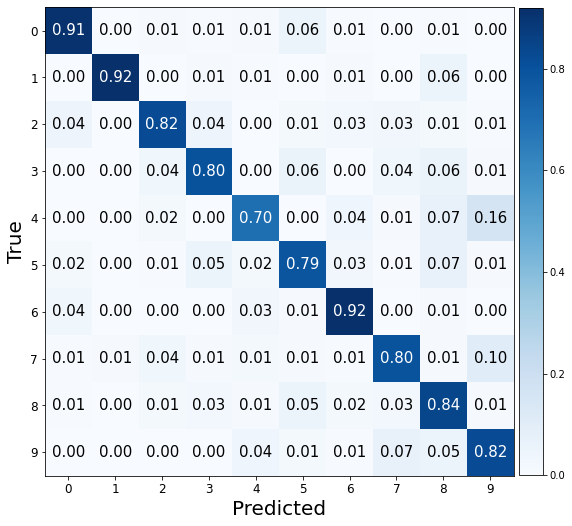

###################

ne: 100, hd:80, wd:0.001, lr: 0.01, bs:1024 
Valid Evaluation loss: 1.231629490852356. f1:0.6973016962425531 acc: 0.7049999833106995 


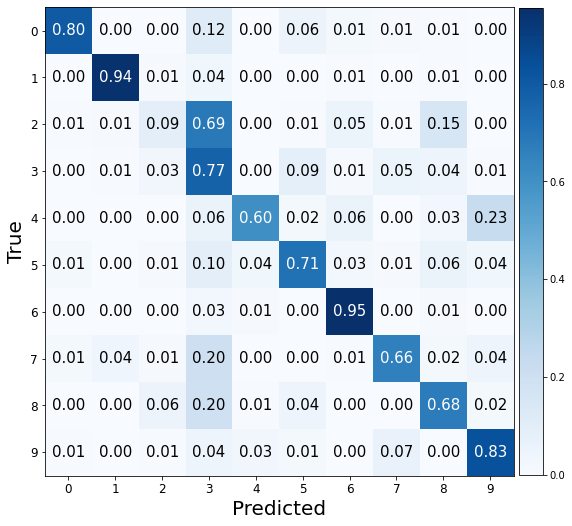

Valid Evaluation loss: 0.5772713422775269. f1:0.8716745051162491 acc: 0.8709999918937683 


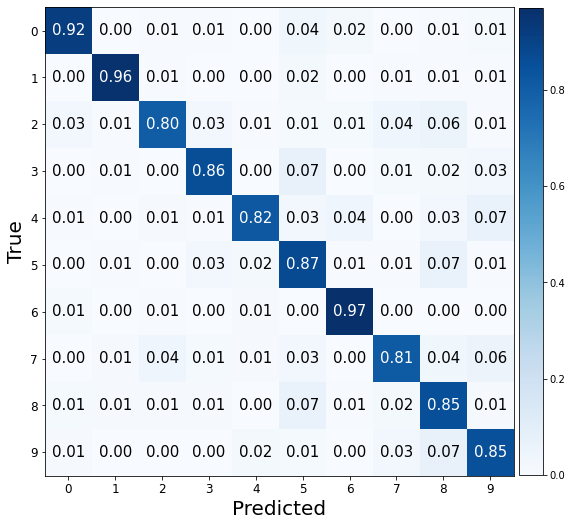

###################

ne: 100, hd:100, wd:0.001, lr: 0.01, bs:1024 
Valid Evaluation loss: 1.2486271858215332. f1:0.6393518682027207 acc: 0.659500002861023 


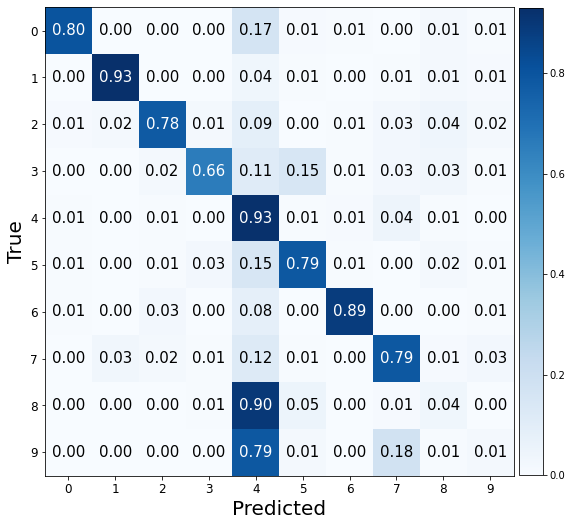

Valid Evaluation loss: 0.6991878151893616. f1:0.8028193156472743 acc: 0.8034999966621399 


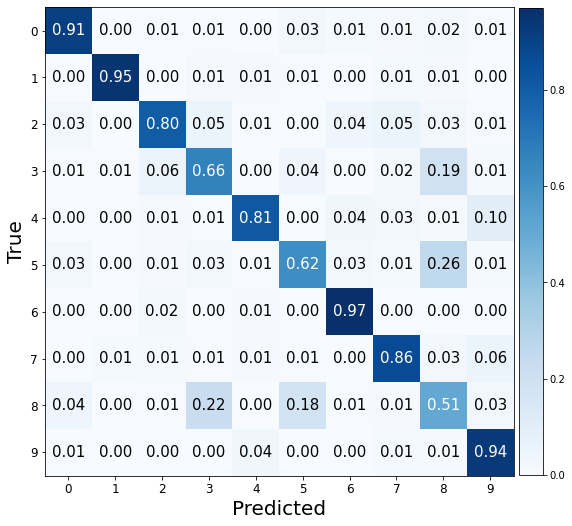

###################

ne: 100, hd:50, wd:0.01, lr: 0.01, bs:1024 
Valid Evaluation loss: 1.9288341999053955. f1:0.29828490603346275 acc: 0.328000009059906 


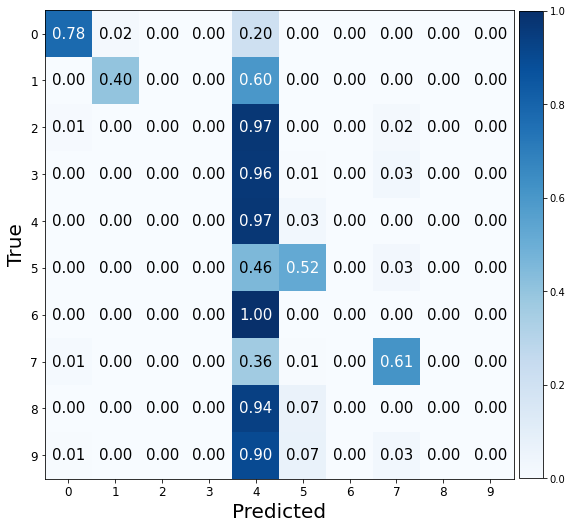

Valid Evaluation loss: 0.8804377317428589. f1:0.7404168108615131 acc: 0.7379999756813049 


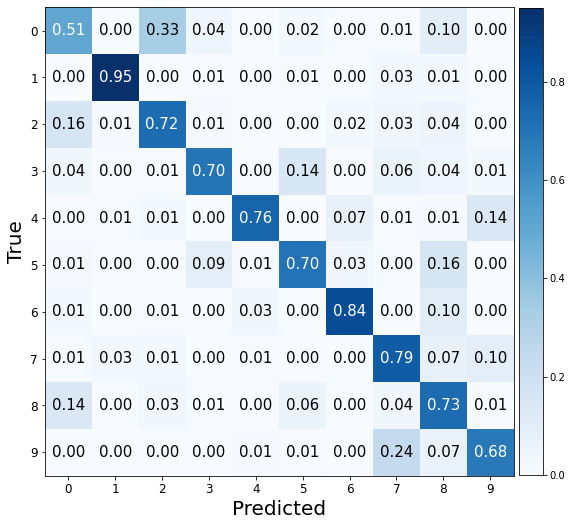

###################

ne: 100, hd:80, wd:0.01, lr: 0.01, bs:1024 
Valid Evaluation loss: 1.1094845533370972. f1:0.751277507987915 acc: 0.7404999732971191 


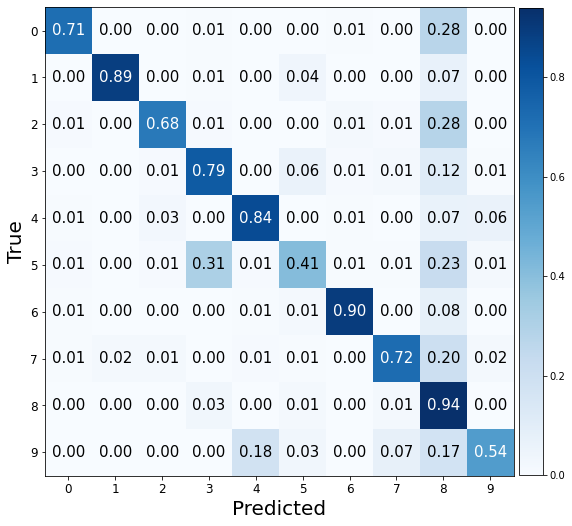

Valid Evaluation loss: 0.7441246509552002. f1:0.7976187863237353 acc: 0.7985000014305115 


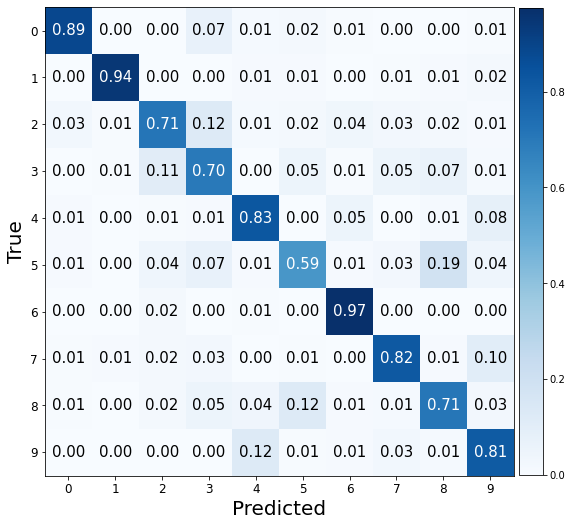

###################

ne: 100, hd:100, wd:0.01, lr: 0.01, bs:1024 
Valid Evaluation loss: 1.2032616138458252. f1:0.6491091928005954 acc: 0.6654999852180481 


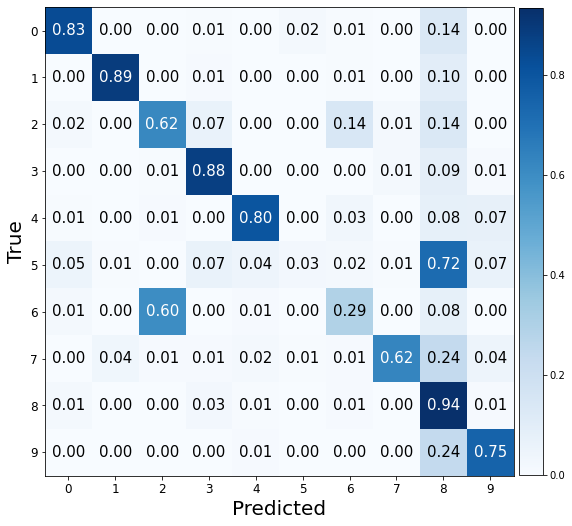

Valid Evaluation loss: 1.2694002389907837. f1:0.5026682720341962 acc: 0.5494999885559082 


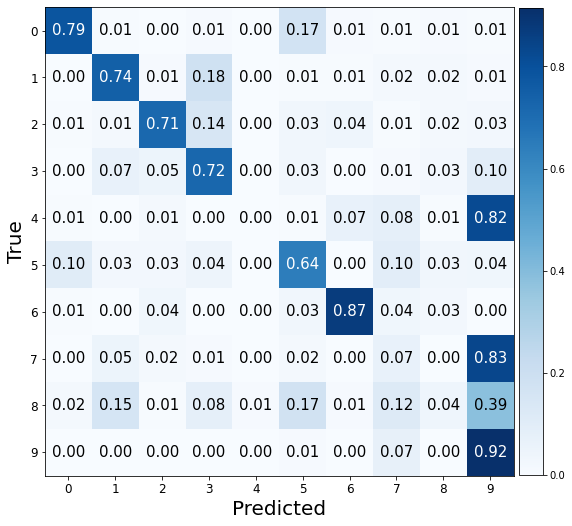

###################

ne: 100, hd:50, wd:0.1, lr: 0.01, bs:1024 
Valid Evaluation loss: 1.617904782295227. f1:0.3694635246159825 acc: 0.42149999737739563 


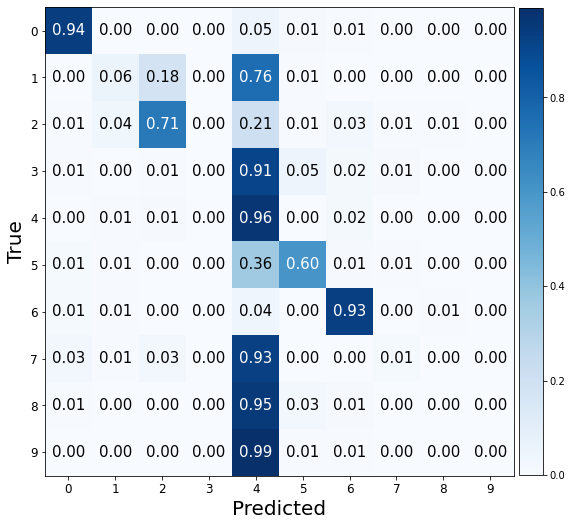

Valid Evaluation loss: 0.7194439172744751. f1:0.7350656505800031 acc: 0.7459999918937683 


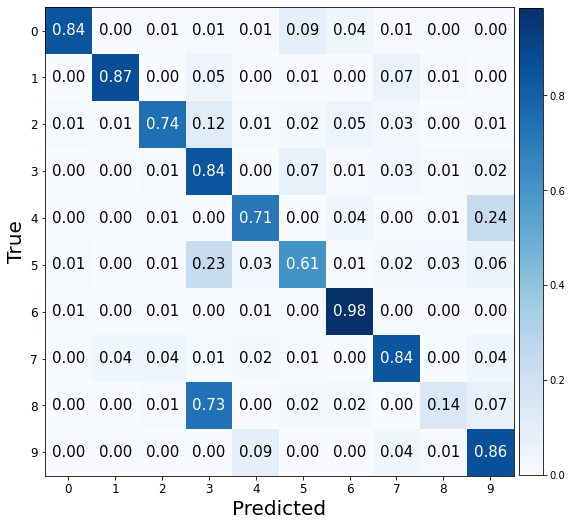

###################

ne: 100, hd:80, wd:0.1, lr: 0.01, bs:1024 
Valid Evaluation loss: 1.3457317352294922. f1:0.5370587152904422 acc: 0.5644999742507935 


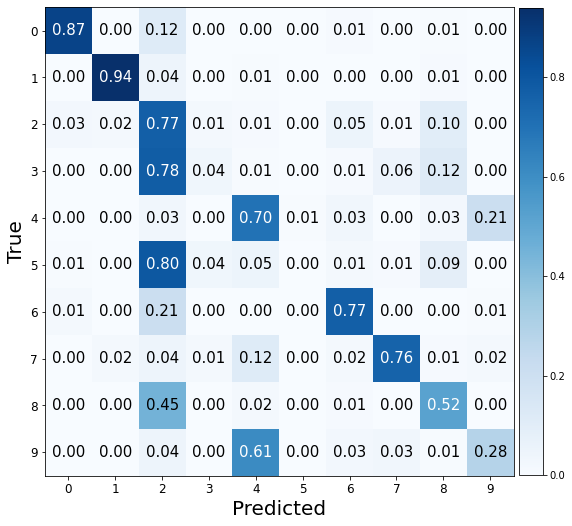

Valid Evaluation loss: 0.3927946388721466. f1:0.8808930474536636 acc: 0.8809999823570251 


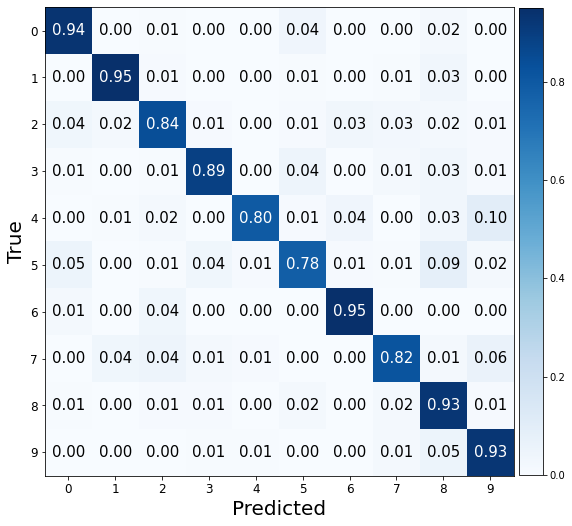

###################

ne: 100, hd:100, wd:0.1, lr: 0.01, bs:1024 
Valid Evaluation loss: 1.070712924003601. f1:0.7503123599585331 acc: 0.7404999732971191 


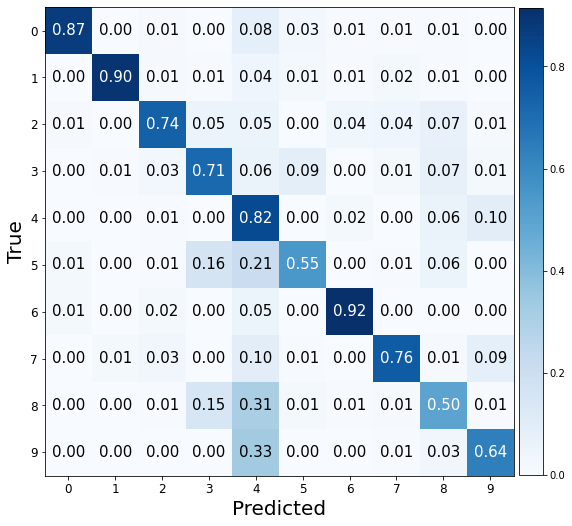

Valid Evaluation loss: 0.3144978880882263. f1:0.8998570172139291 acc: 0.8999999761581421 


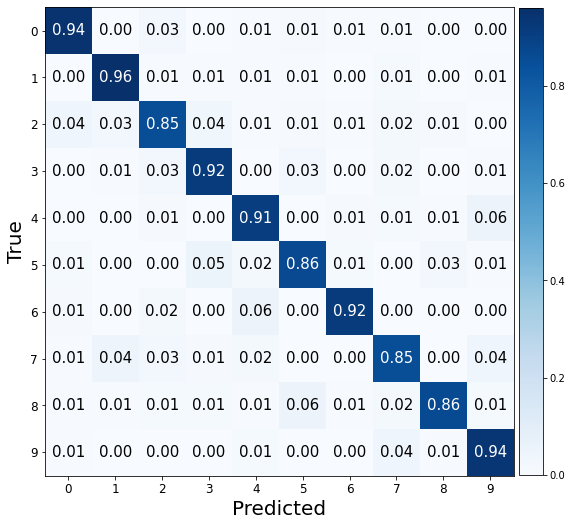

###################

ne: 100, hd:50, wd:0.001, lr: 0.1, bs:1024 
Valid Evaluation loss: 2.5989201068878174. f1:0.1161099096334812 acc: 0.17550000548362732 


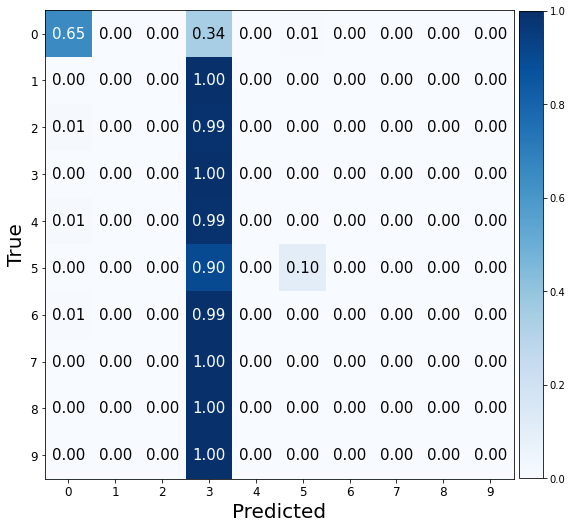

Valid Evaluation loss: 2.3026013374328613. f1:0.01818181818181818 acc: 0.10000000149011612 


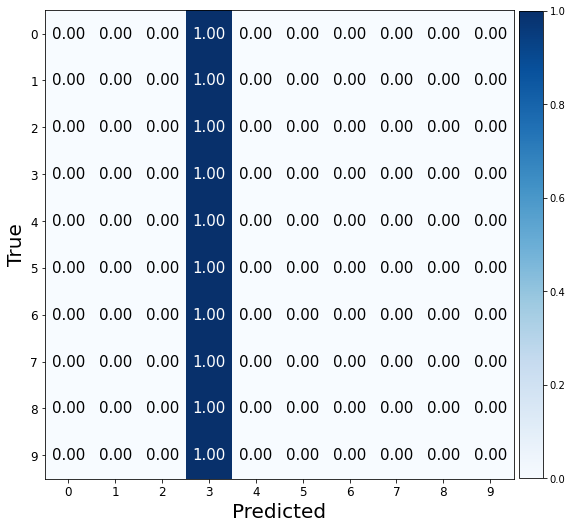

###################

ne: 100, hd:80, wd:0.001, lr: 0.1, bs:1024 
Valid Evaluation loss: 2.322421073913574. f1:0.044093130649357104 acc: 0.11550000309944153 


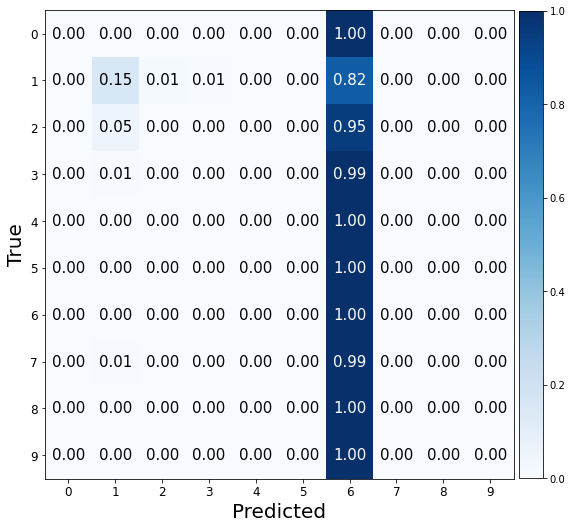

Valid Evaluation loss: 2.3026363849639893. f1:0.01818181818181818 acc: 0.10000000149011612 


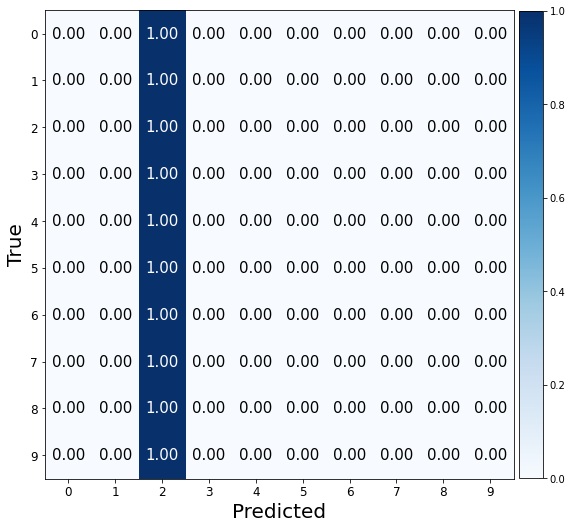

###################

ne: 100, hd:100, wd:0.001, lr: 0.1, bs:1024 
Valid Evaluation loss: 4.175177574157715. f1:0.2466821786028066 acc: 0.2865000069141388 


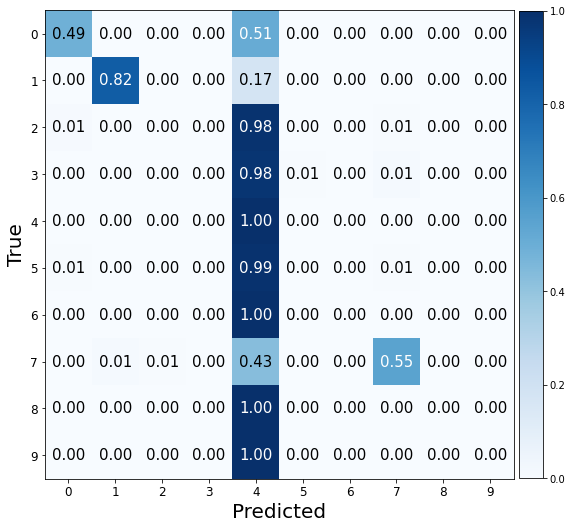

Valid Evaluation loss: 2.302755832672119. f1:0.01818181818181818 acc: 0.10000000149011612 


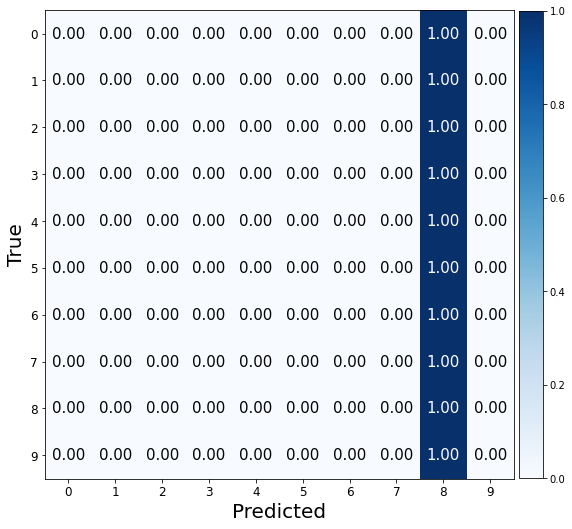

###################

ne: 100, hd:50, wd:0.01, lr: 0.1, bs:1024 
Valid Evaluation loss: 3.378481149673462. f1:0.09254120361790781 acc: 0.1589999943971634 


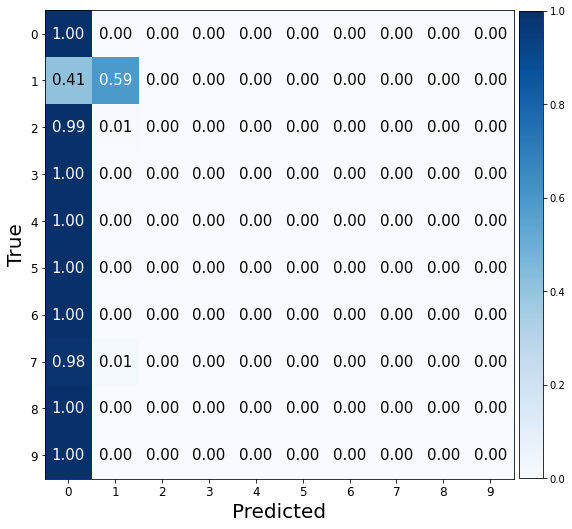

Valid Evaluation loss: 2.3026468753814697. f1:0.01818181818181818 acc: 0.10000000149011612 


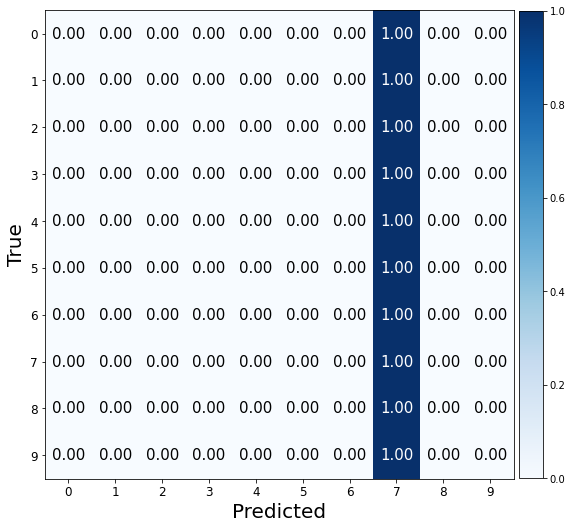

###################

ne: 100, hd:80, wd:0.01, lr: 0.1, bs:1024 
Valid Evaluation loss: 2.426100730895996. f1:0.11494993446508599 acc: 0.18299999833106995 


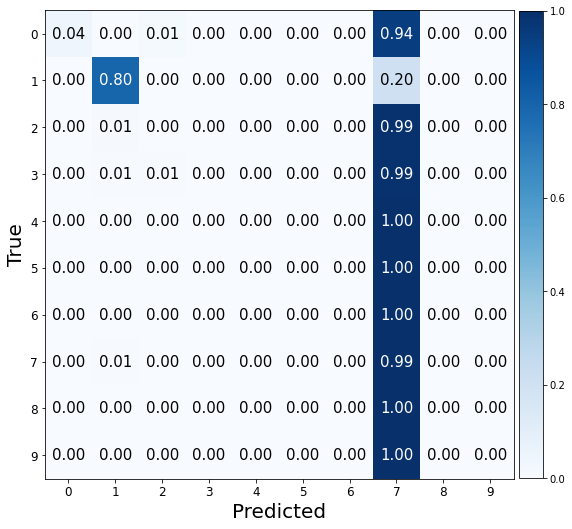

Valid Evaluation loss: 2.3052470684051514. f1:0.046801930834877936 acc: 0.11649999767541885 


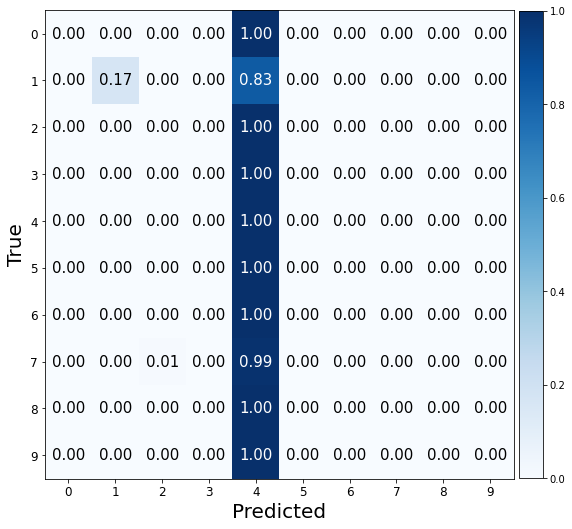

###################

ne: 100, hd:100, wd:0.01, lr: 0.1, bs:1024 
Valid Evaluation loss: 2.3760743141174316. f1:0.11269245513697213 acc: 0.18850000202655792 


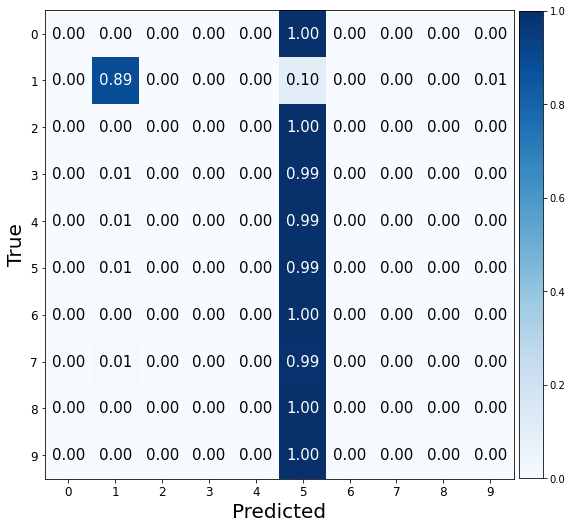

Valid Evaluation loss: 2.3088746070861816. f1:0.020185509024901568 acc: 0.10100000351667404 


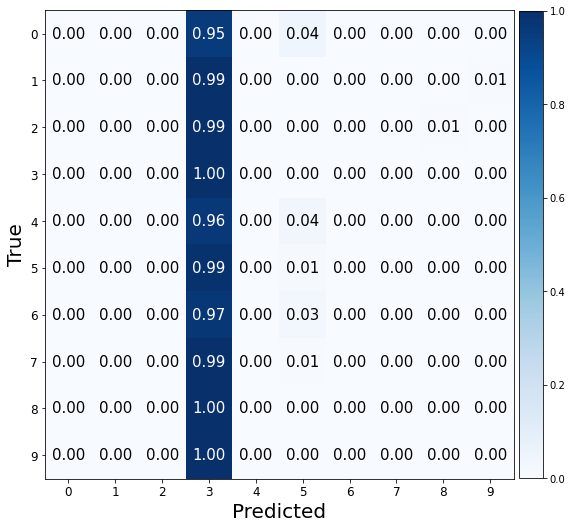

###################

ne: 100, hd:50, wd:0.1, lr: 0.1, bs:1024 
Valid Evaluation loss: 8.959025382995605. f1:0.06122206319497962 acc: 0.16899999976158142 


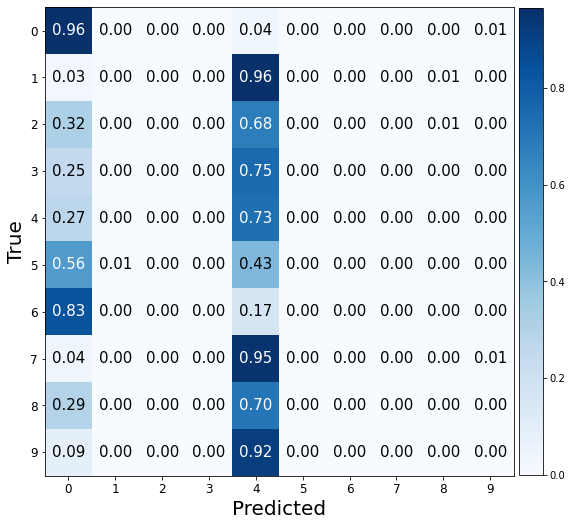

Valid Evaluation loss: 2.625068187713623. f1:0.07454636435985072 acc: 0.12999999523162842 


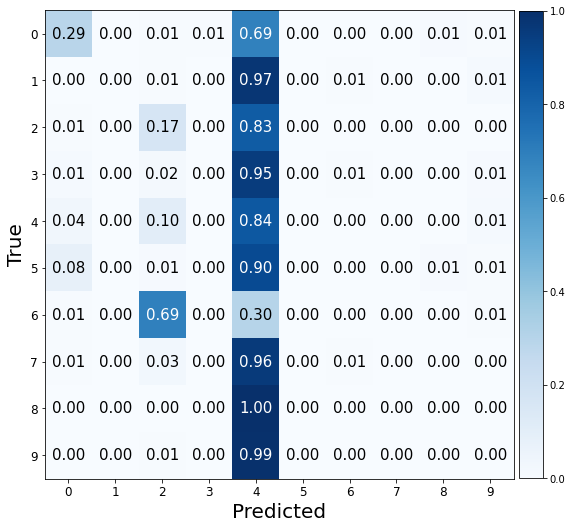

###################

ne: 100, hd:80, wd:0.1, lr: 0.1, bs:1024 
Valid Evaluation loss: 2.3199069499969482. f1:0.21739172489954775 acc: 0.25200000405311584 


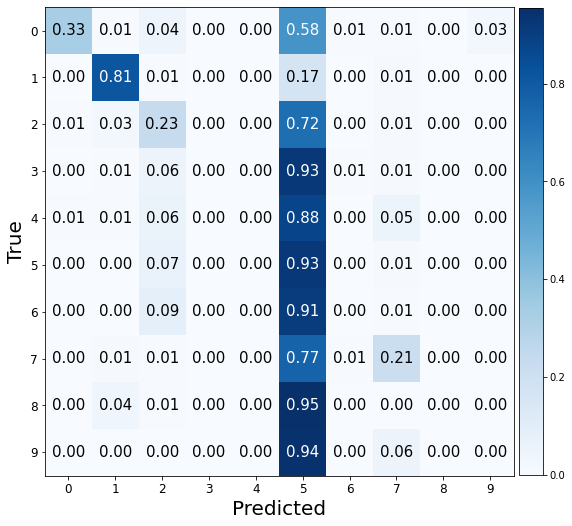

Valid Evaluation loss: 2.3667709827423096. f1:0.025169760285972852 acc: 0.10350000113248825 


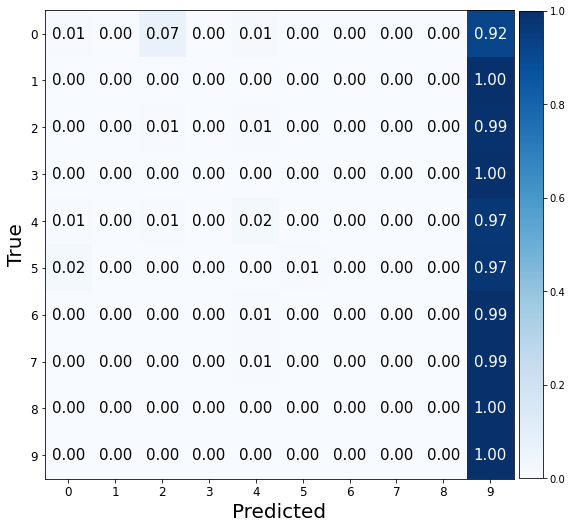

###################

ne: 100, hd:100, wd:0.1, lr: 0.1, bs:1024 
Valid Evaluation loss: 2.0855495929718018. f1:0.17071368862330347 acc: 0.21850000321865082 


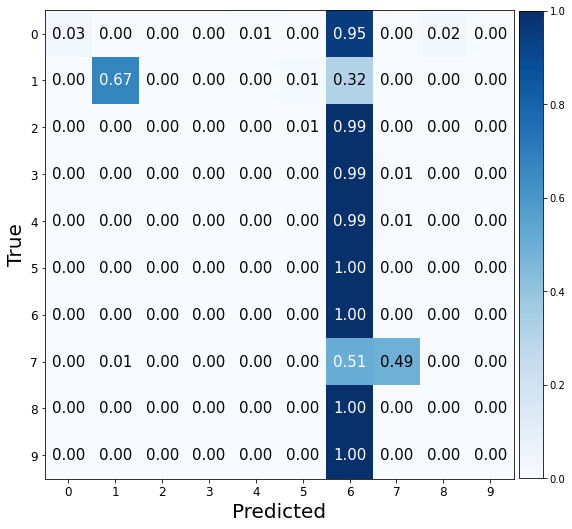

Valid Evaluation loss: 80.8335189819336. f1:0.04315333931012426 acc: 0.12200000137090683 


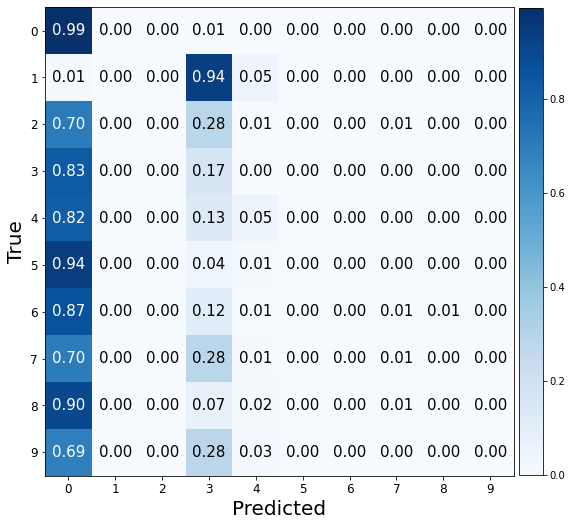

###################

ne: 150, hd:50, wd:0.001, lr: 0.001, bs:256 
Valid Evaluation loss: 0.6366974711418152. f1:0.8649566094010982 acc: 0.8650000095367432 


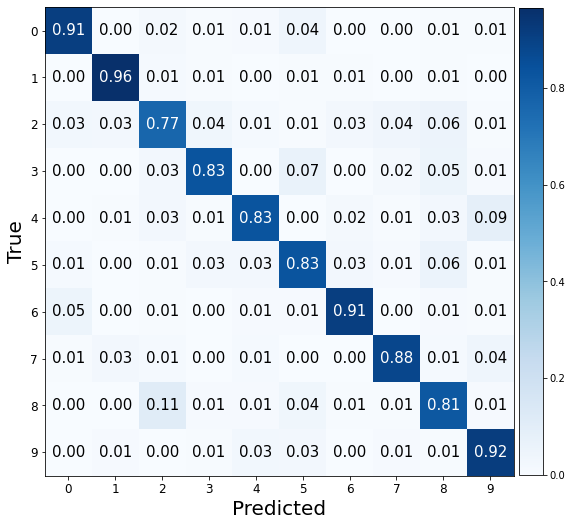

Valid Evaluation loss: 0.41582462191581726. f1:0.9022776945654343 acc: 0.9024999737739563 


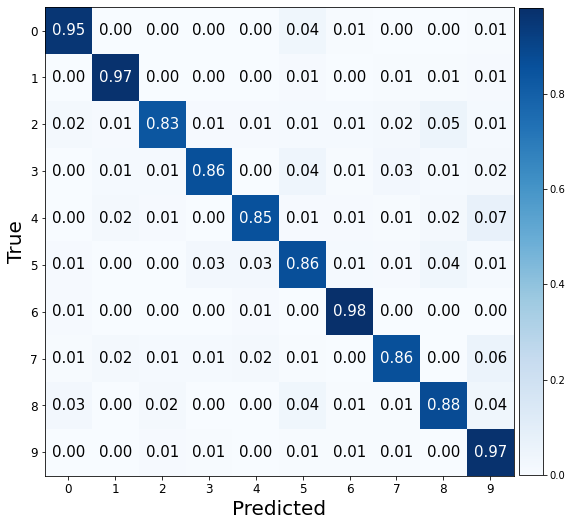

###################

ne: 150, hd:80, wd:0.001, lr: 0.001, bs:256 
Valid Evaluation loss: 0.7760615944862366. f1:0.888513007279677 acc: 0.8884999752044678 


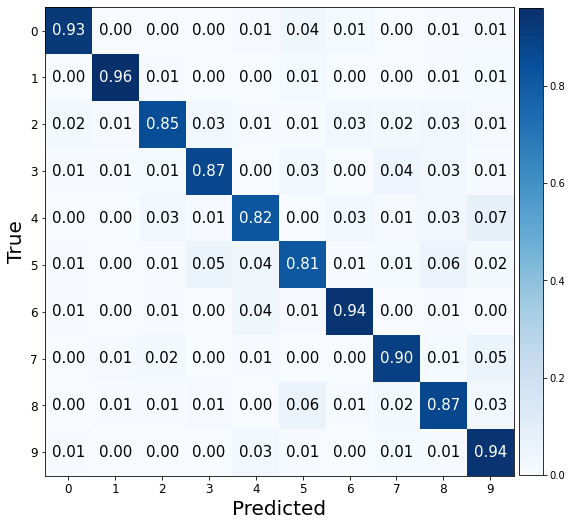

Valid Evaluation loss: 0.39521321654319763. f1:0.9094304081892389 acc: 0.909500002861023 


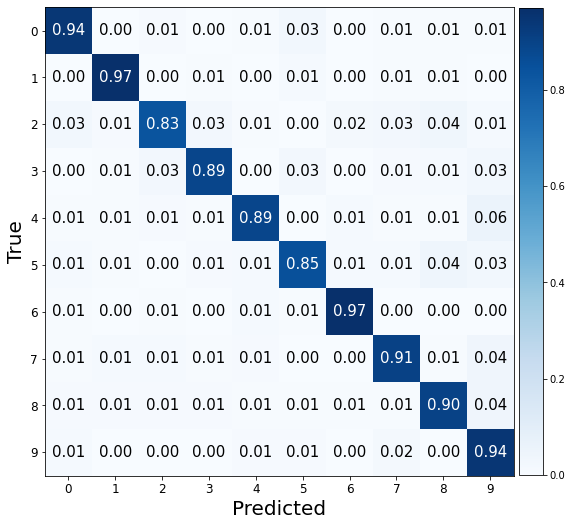

###################

ne: 150, hd:100, wd:0.001, lr: 0.001, bs:256 
Valid Evaluation loss: 0.6660789251327515. f1:0.8699055832981271 acc: 0.8700000047683716 


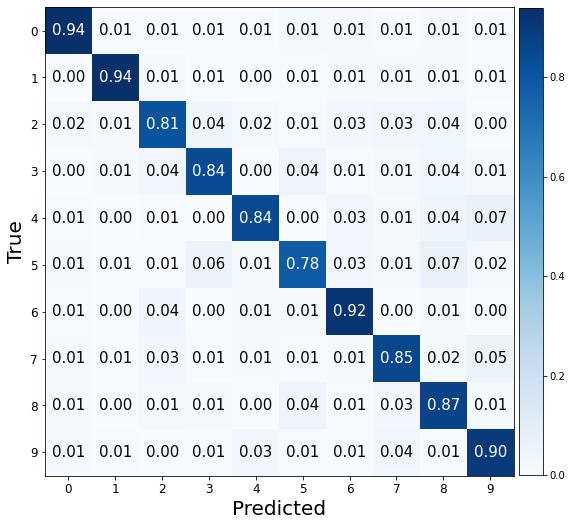

Valid Evaluation loss: 0.33749663829803467. f1:0.9135644487059411 acc: 0.9139999747276306 


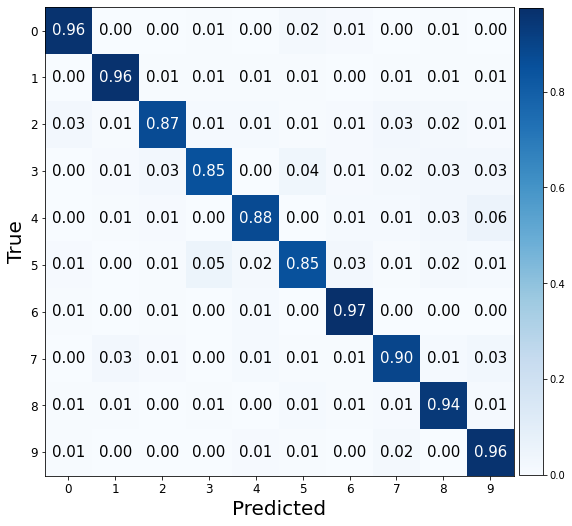

###################

ne: 150, hd:50, wd:0.01, lr: 0.001, bs:256 
Valid Evaluation loss: 0.6904803514480591. f1:0.8890448869329053 acc: 0.8889999985694885 


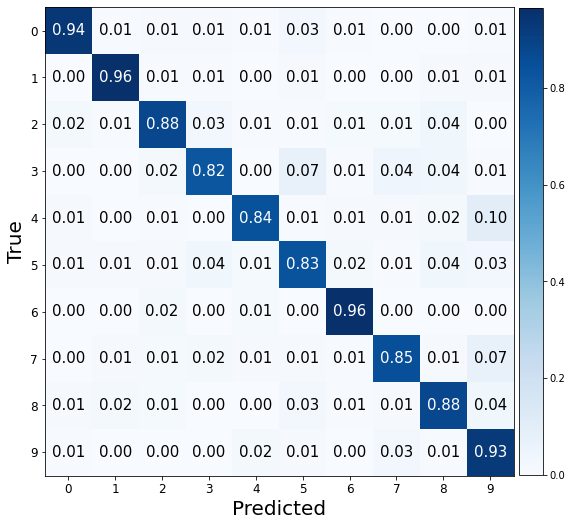

Valid Evaluation loss: 0.3942517340183258. f1:0.9015708814535712 acc: 0.9020000100135803 


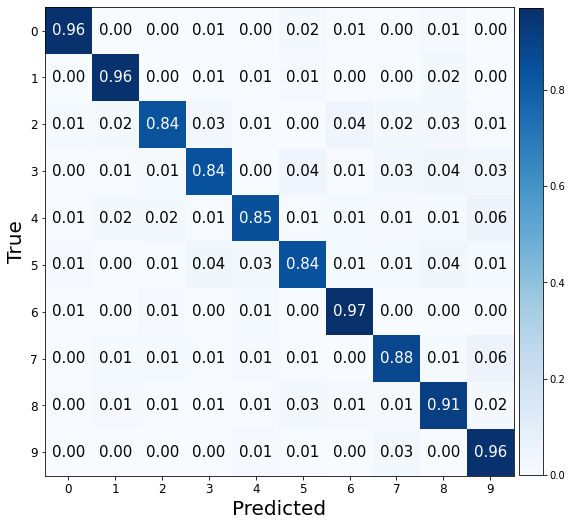

###################

ne: 150, hd:80, wd:0.01, lr: 0.001, bs:256 
Valid Evaluation loss: 0.615139365196228. f1:0.8952084493211941 acc: 0.8955000042915344 


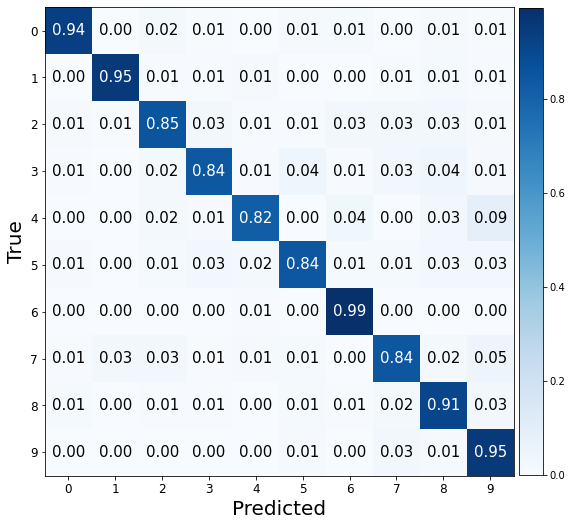

Valid Evaluation loss: 0.31038787961006165. f1:0.9190931518420424 acc: 0.9194999933242798 


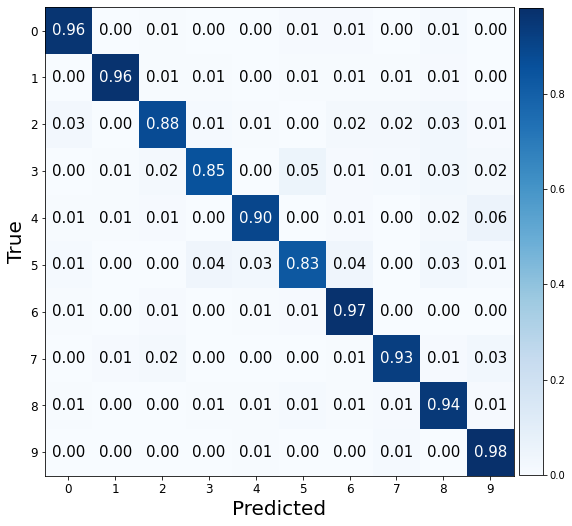

###################

ne: 150, hd:100, wd:0.01, lr: 0.001, bs:256 
Valid Evaluation loss: 0.6067938804626465. f1:0.8844045113651902 acc: 0.8845000267028809 


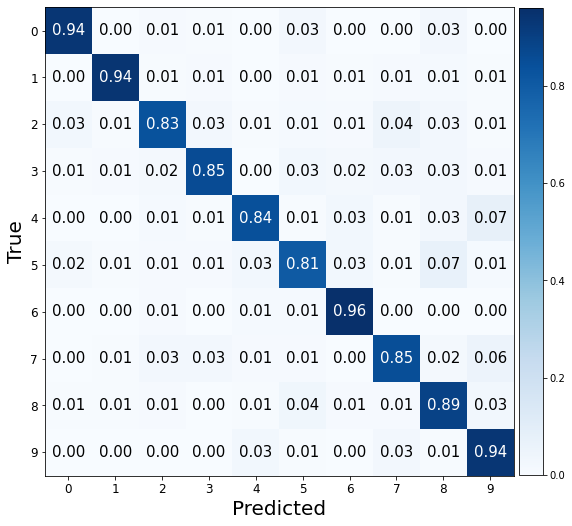

Valid Evaluation loss: 0.3107324242591858. f1:0.9194250113193145 acc: 0.9194999933242798 


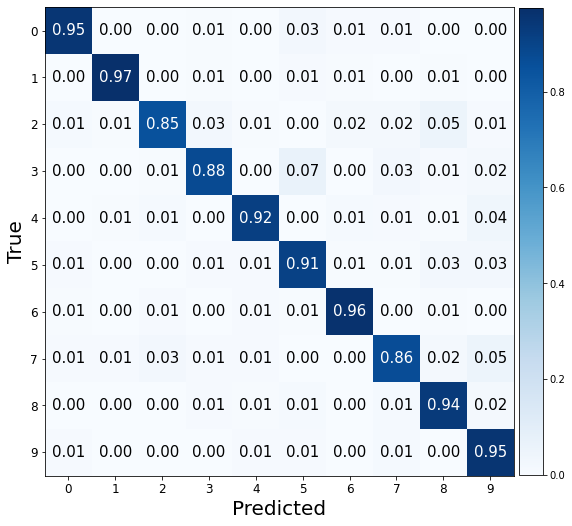

###################

ne: 150, hd:50, wd:0.1, lr: 0.001, bs:256 
Valid Evaluation loss: 0.5962263941764832. f1:0.8661888651904672 acc: 0.8659999966621399 


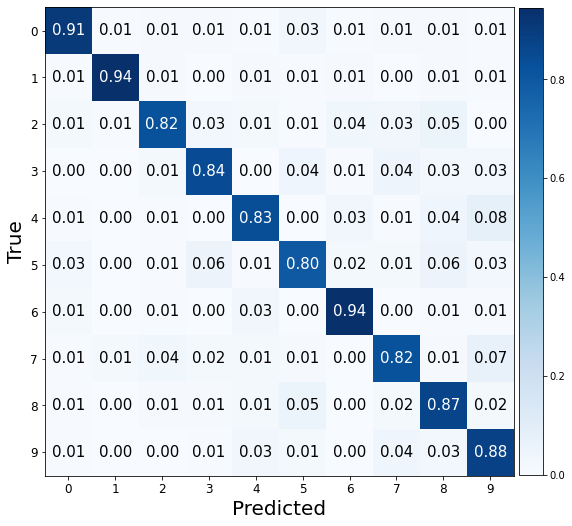

Valid Evaluation loss: 0.3125368058681488. f1:0.9017518485369382 acc: 0.9020000100135803 


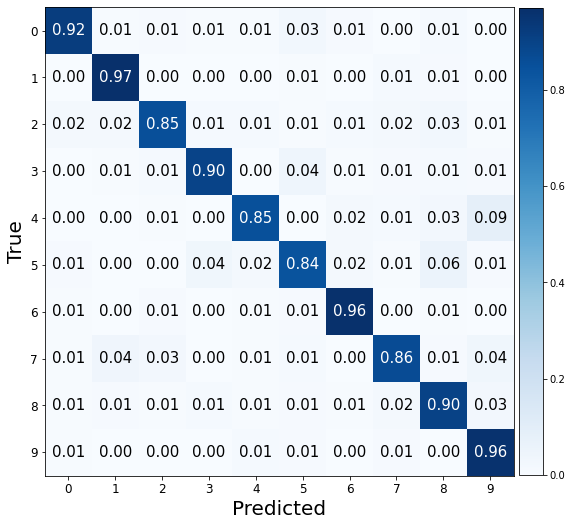

###################

ne: 150, hd:80, wd:0.1, lr: 0.001, bs:256 
Valid Evaluation loss: 0.4710240364074707. f1:0.8942617854724981 acc: 0.8945000171661377 


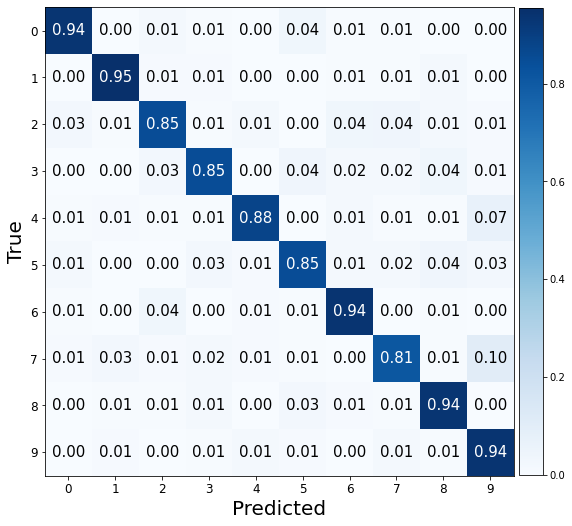

Valid Evaluation loss: 0.3006841540336609. f1:0.9116989192942058 acc: 0.9120000004768372 


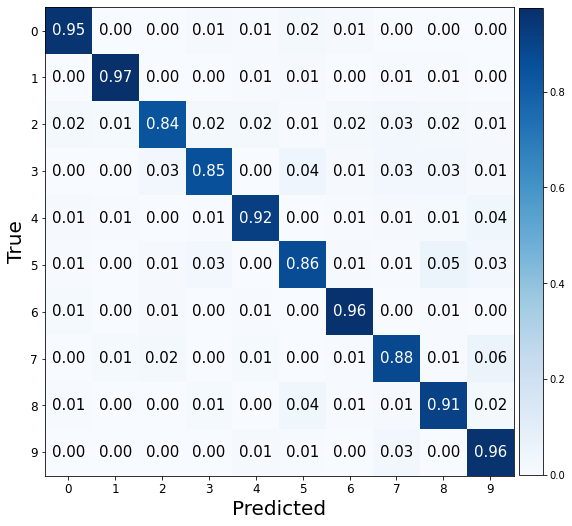

###################

ne: 150, hd:100, wd:0.1, lr: 0.001, bs:256 
Valid Evaluation loss: 0.5203350186347961. f1:0.8938904594446908 acc: 0.8939999938011169 


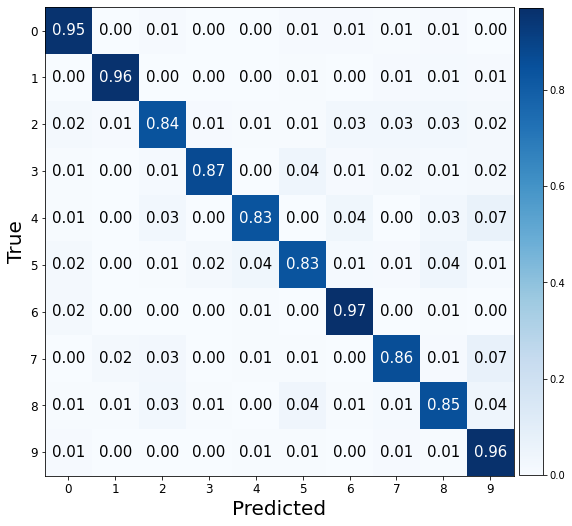

Valid Evaluation loss: 0.25593140721321106. f1:0.9210795550948075 acc: 0.921500027179718 


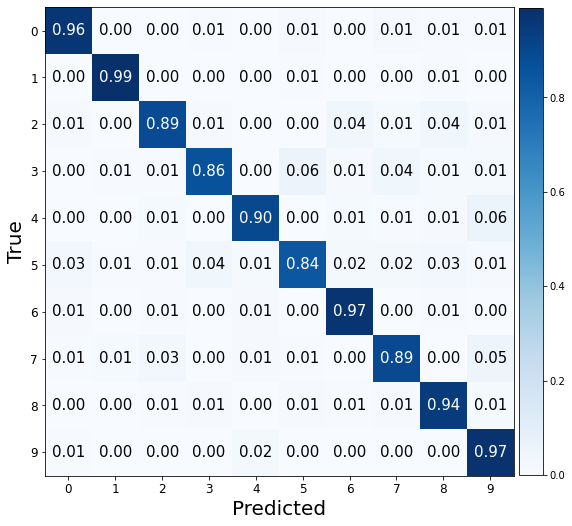

###################

ne: 150, hd:50, wd:0.001, lr: 0.01, bs:256 
Valid Evaluation loss: 1.0733879804611206. f1:0.7605205818664649 acc: 0.7584999799728394 


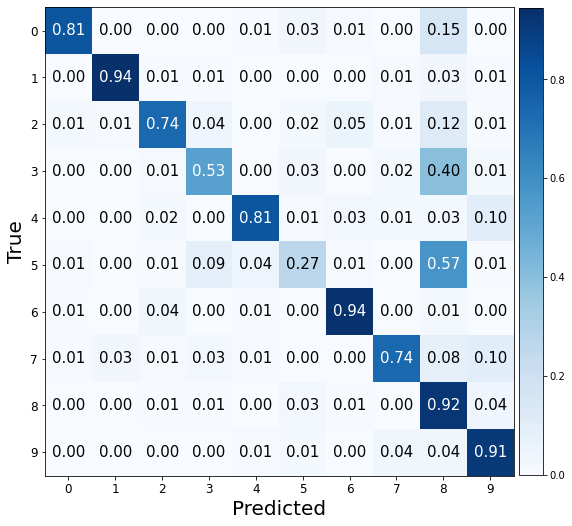

Valid Evaluation loss: 0.68883216381073. f1:0.7976897042833083 acc: 0.7994999885559082 


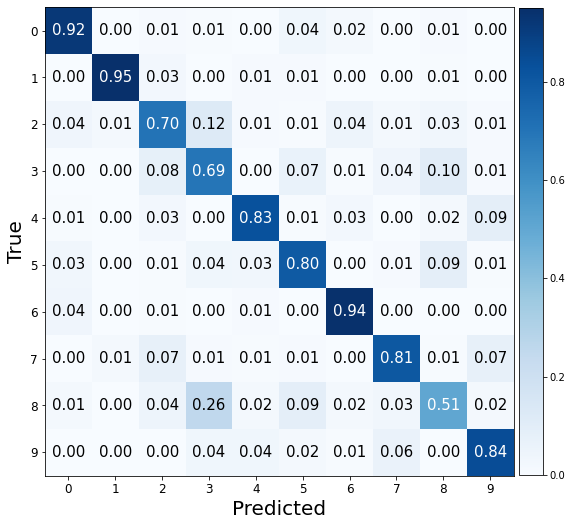

###################

ne: 150, hd:80, wd:0.001, lr: 0.01, bs:256 
Valid Evaluation loss: 1.1071841716766357. f1:0.6930358612711471 acc: 0.6915000081062317 


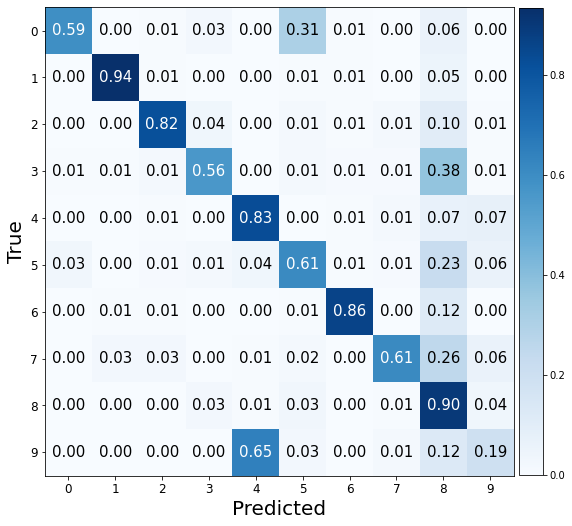

Valid Evaluation loss: 0.5430824160575867. f1:0.877287588596255 acc: 0.8774999976158142 


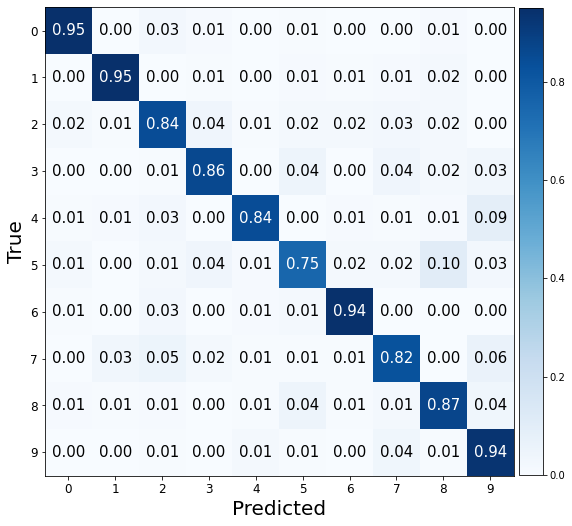

###################

ne: 150, hd:100, wd:0.001, lr: 0.01, bs:256 
Valid Evaluation loss: 0.9471938610076904. f1:0.8056917739587159 acc: 0.8009999990463257 


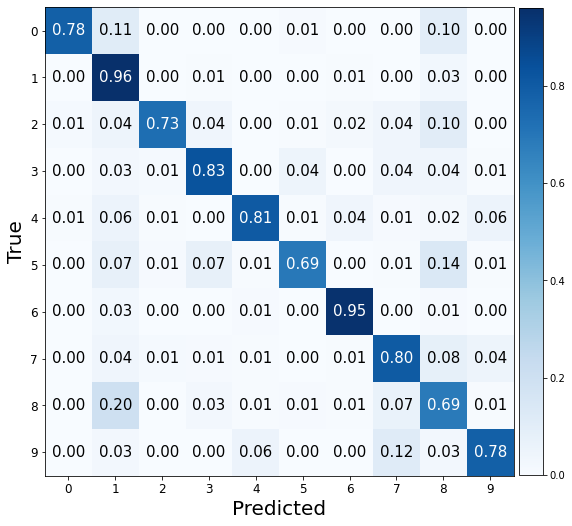

Valid Evaluation loss: 0.9256634712219238. f1:0.6487765693792992 acc: 0.671500027179718 


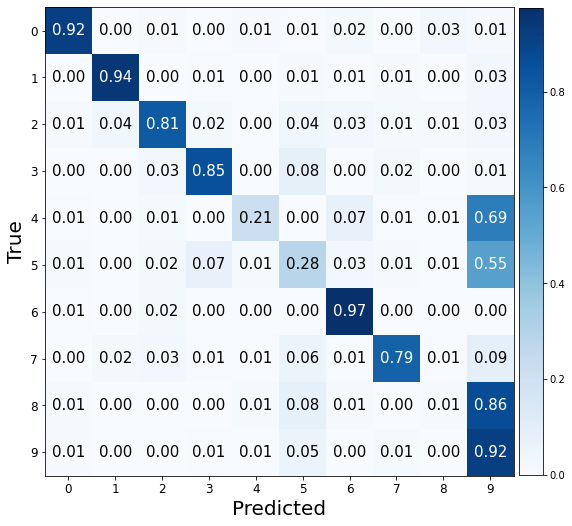

###################

ne: 150, hd:50, wd:0.01, lr: 0.01, bs:256 
Valid Evaluation loss: 1.2608133554458618. f1:0.6031483861240265 acc: 0.6225000023841858 


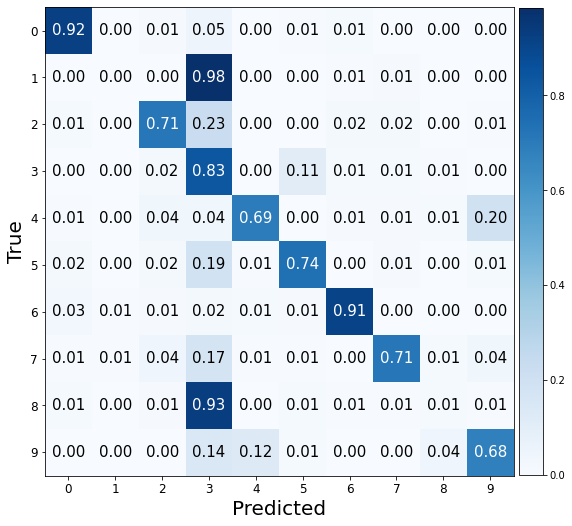

Valid Evaluation loss: 0.5876520276069641. f1:0.8546832814826851 acc: 0.8550000190734863 


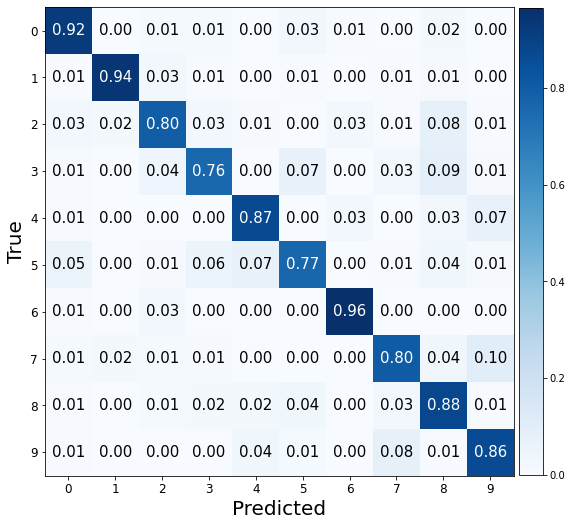

###################

ne: 150, hd:80, wd:0.01, lr: 0.01, bs:256 
Valid Evaluation loss: 1.0136632919311523. f1:0.7379533190399818 acc: 0.7419999837875366 


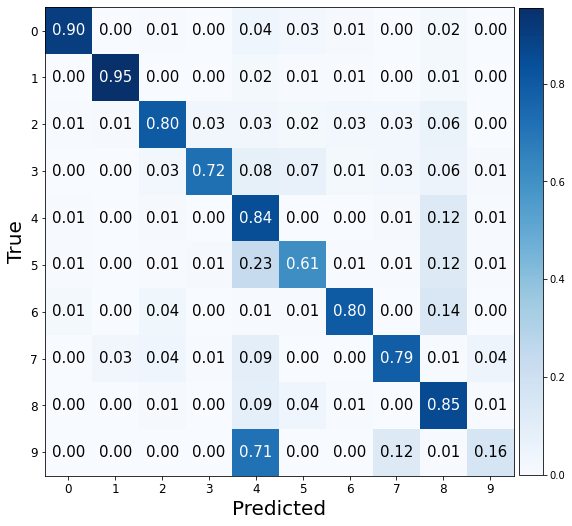

Valid Evaluation loss: 0.5168119072914124. f1:0.8494653411836197 acc: 0.8495000004768372 


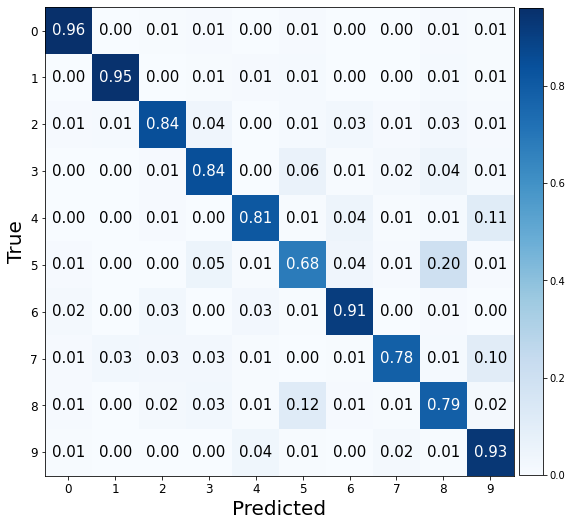

###################

ne: 150, hd:100, wd:0.01, lr: 0.01, bs:256 
Valid Evaluation loss: 1.1170341968536377. f1:0.5625763454873708 acc: 0.6079999804496765 


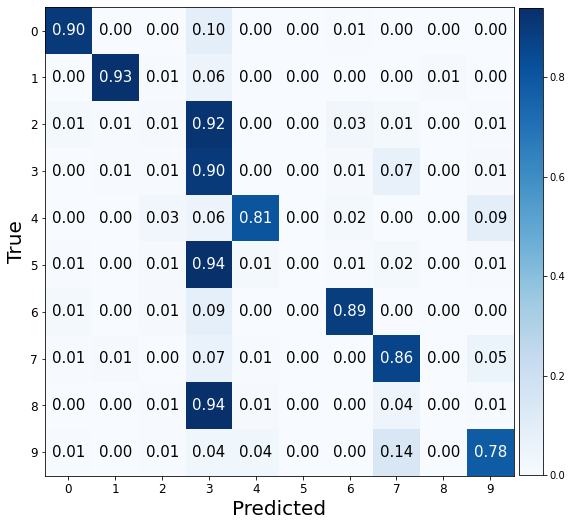

Valid Evaluation loss: 0.7820961475372314. f1:0.775632536794651 acc: 0.7749999761581421 


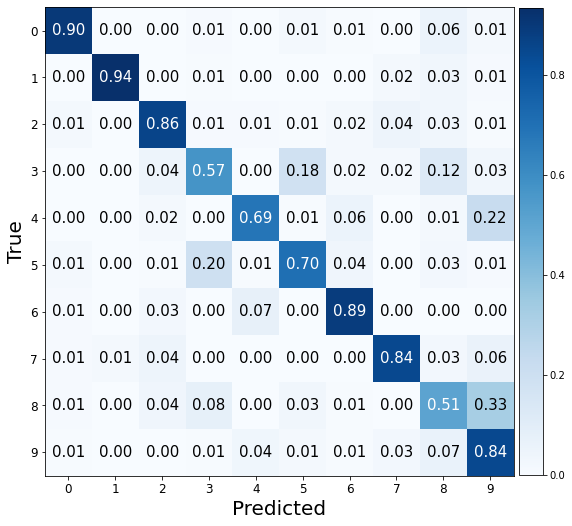

###################

ne: 150, hd:50, wd:0.1, lr: 0.01, bs:256 
Valid Evaluation loss: 1.3114299774169922. f1:0.5417583516522864 acc: 0.578000009059906 


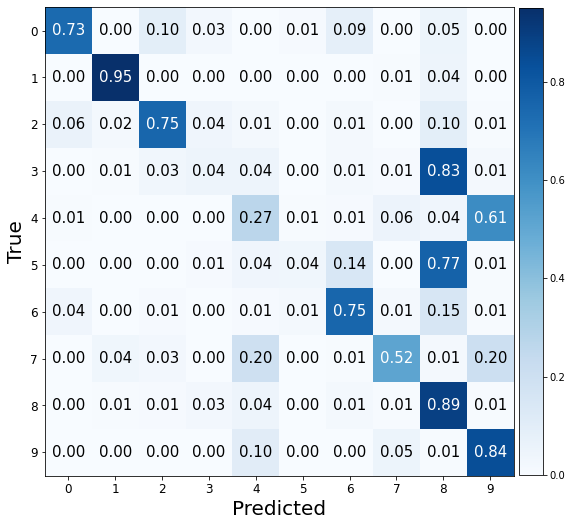

Valid Evaluation loss: 0.43659865856170654. f1:0.8687395789661458 acc: 0.8694999814033508 


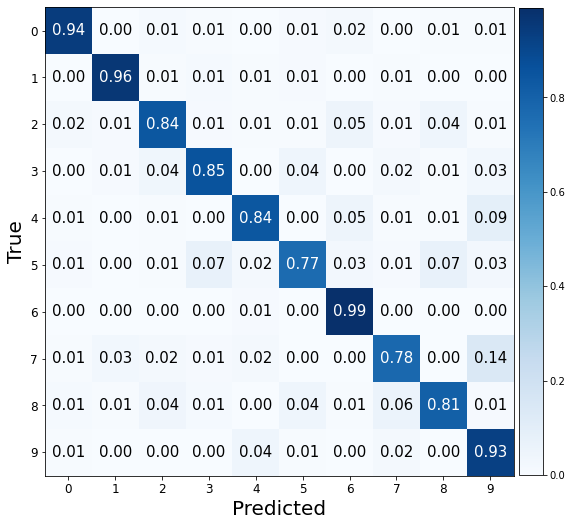

###################

ne: 150, hd:80, wd:0.1, lr: 0.01, bs:256 
Valid Evaluation loss: 0.7971725463867188. f1:0.8256937414216194 acc: 0.8259999752044678 


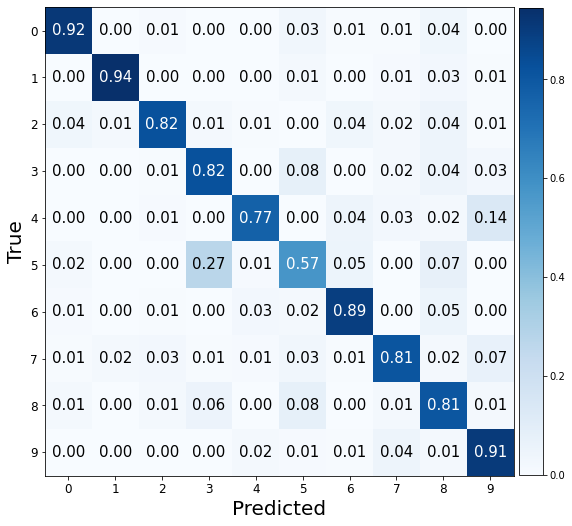

Valid Evaluation loss: 0.35434579849243164. f1:0.8974001394821206 acc: 0.8974999785423279 


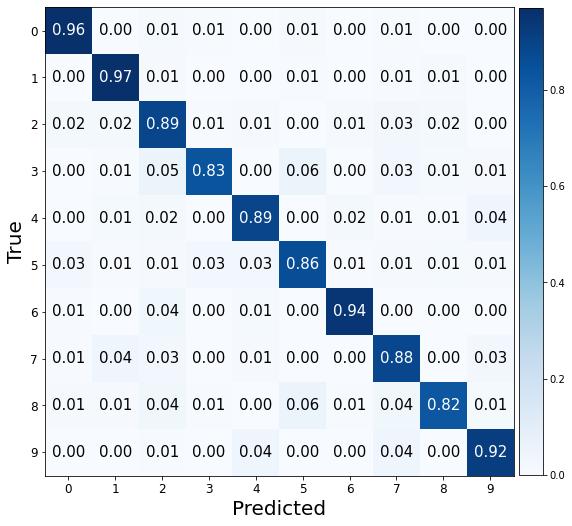

###################

ne: 150, hd:100, wd:0.1, lr: 0.01, bs:256 
Valid Evaluation loss: 0.8212730884552002. f1:0.8138093426692391 acc: 0.8109999895095825 


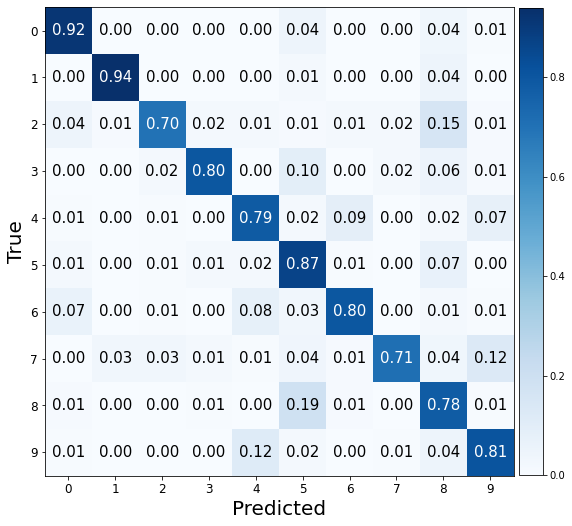

Valid Evaluation loss: 0.41409432888031006. f1:0.8757001501806295 acc: 0.8755000233650208 


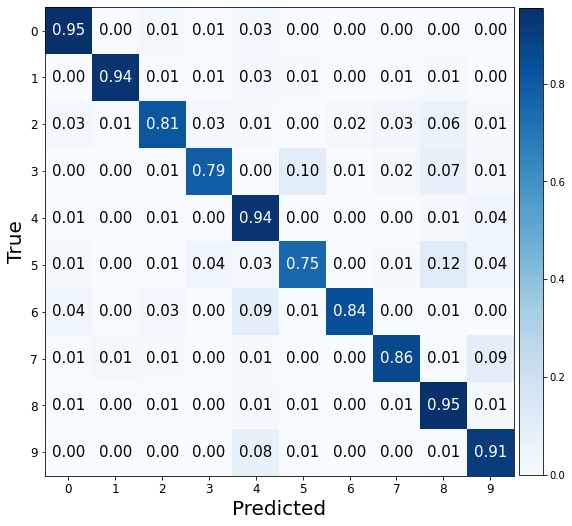

###################

ne: 150, hd:50, wd:0.001, lr: 0.1, bs:256 
Valid Evaluation loss: 2.288102626800537. f1:0.14413879153143197 acc: 0.19599999487400055 


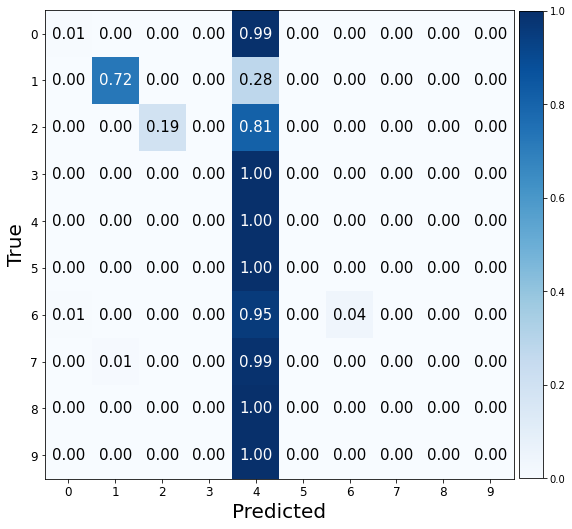

Valid Evaluation loss: 2.3025848865509033. f1:0.01818181818181818 acc: 0.10000000149011612 


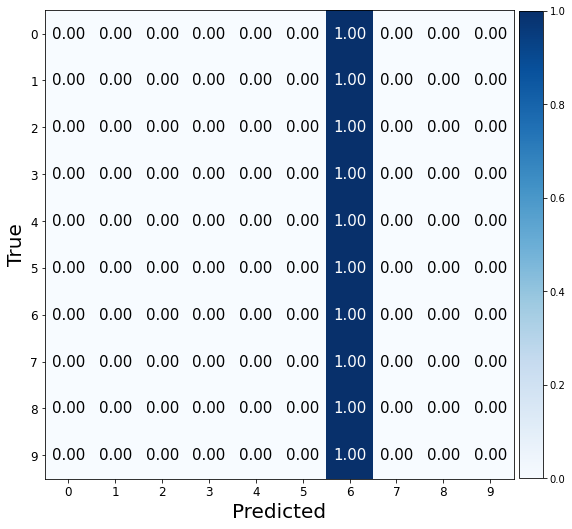

###################

ne: 150, hd:80, wd:0.001, lr: 0.1, bs:256 
Valid Evaluation loss: 2.3125176429748535. f1:0.14717693081518507 acc: 0.20149999856948853 


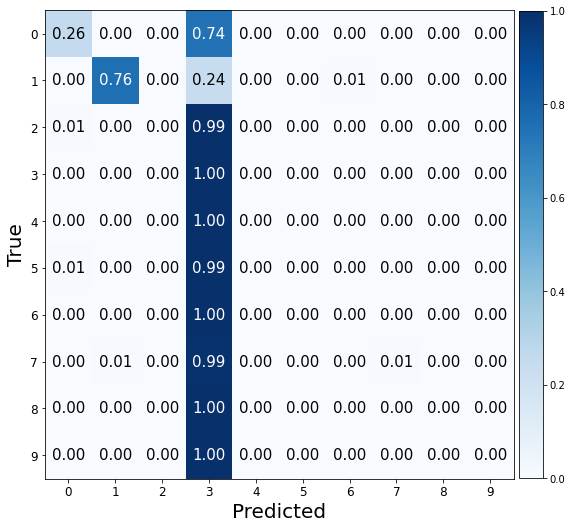

Valid Evaluation loss: 2.3025870323181152. f1:0.01818181818181818 acc: 0.10000000149011612 


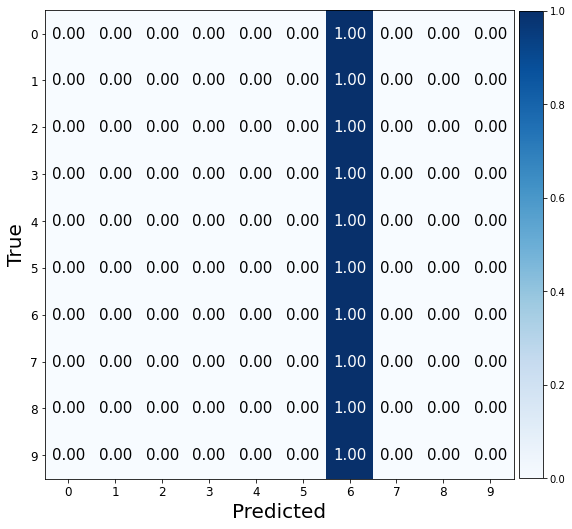

###################

ne: 150, hd:100, wd:0.001, lr: 0.1, bs:256 
Valid Evaluation loss: 4.746004104614258. f1:0.18625185259479773 acc: 0.23999999463558197 


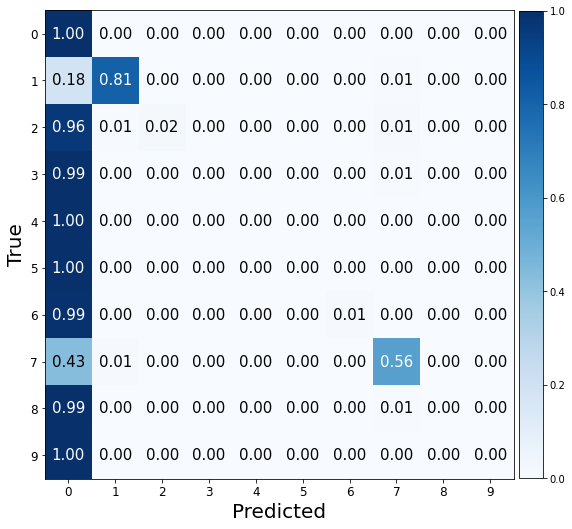

Valid Evaluation loss: 2.3031296730041504. f1:0.01818181818181818 acc: 0.10000000149011612 


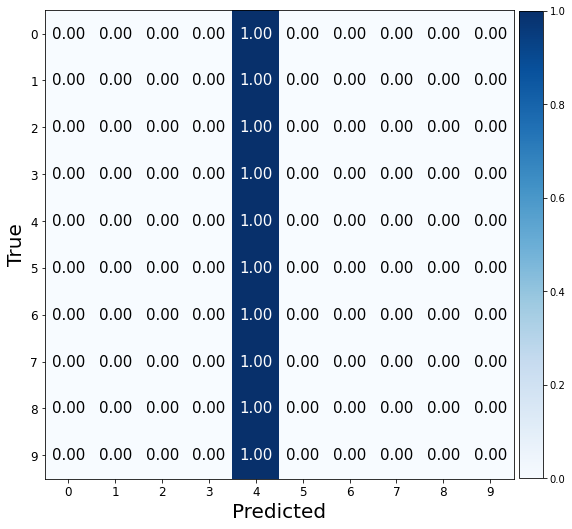

###################

ne: 150, hd:50, wd:0.01, lr: 0.1, bs:256 
Valid Evaluation loss: 3.100266695022583. f1:0.1578848188681269 acc: 0.20649999380111694 


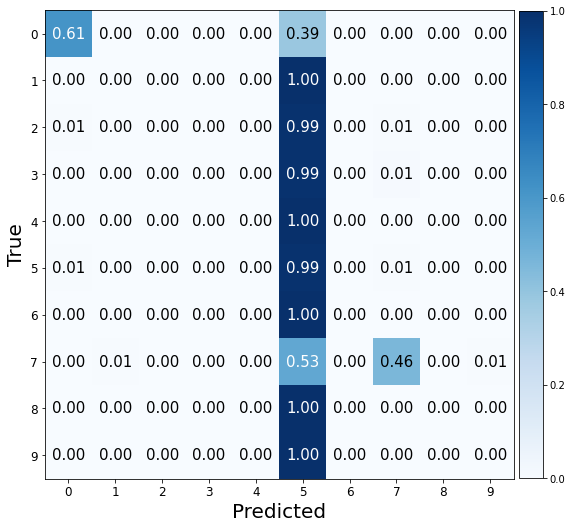

Valid Evaluation loss: 2.3028900623321533. f1:0.01818181818181818 acc: 0.10000000149011612 


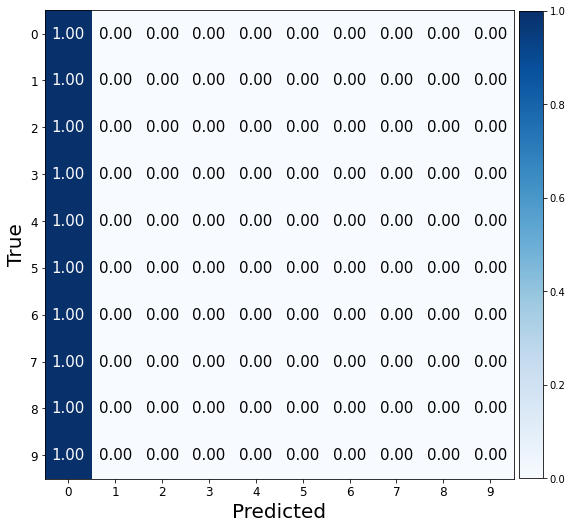

###################

ne: 150, hd:80, wd:0.01, lr: 0.1, bs:256 
Valid Evaluation loss: 2.2140190601348877. f1:0.11004644652287332 acc: 0.18400000035762787 


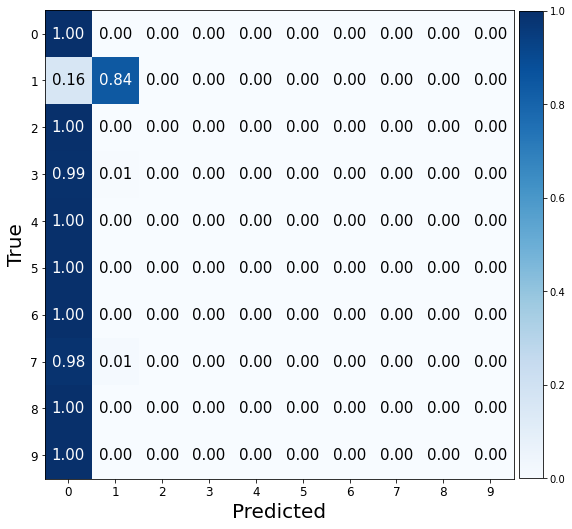

Valid Evaluation loss: 2.301696300506592. f1:0.01818181818181818 acc: 0.10000000149011612 


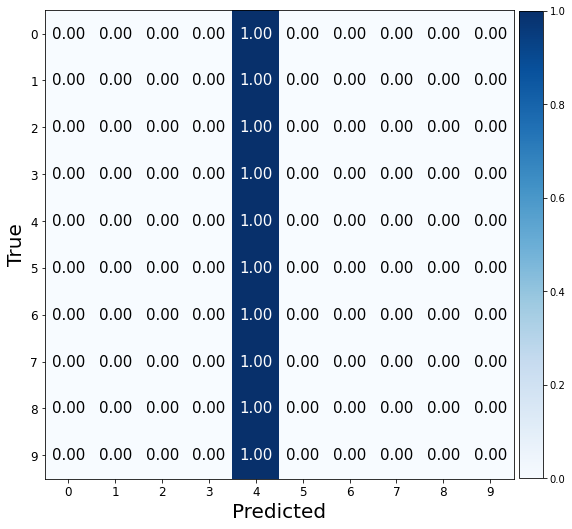

###################

ne: 150, hd:100, wd:0.01, lr: 0.1, bs:256 
Valid Evaluation loss: 2.5867903232574463. f1:0.16962819434658258 acc: 0.226500004529953 


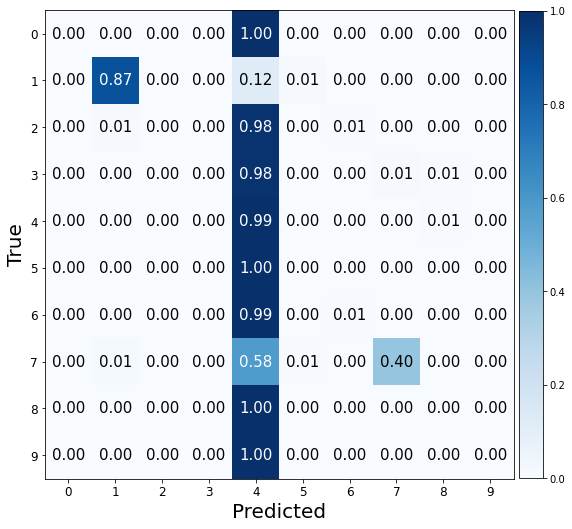

Valid Evaluation loss: 2.3316709995269775. f1:0.018198362147406735 acc: 0.10000000149011612 


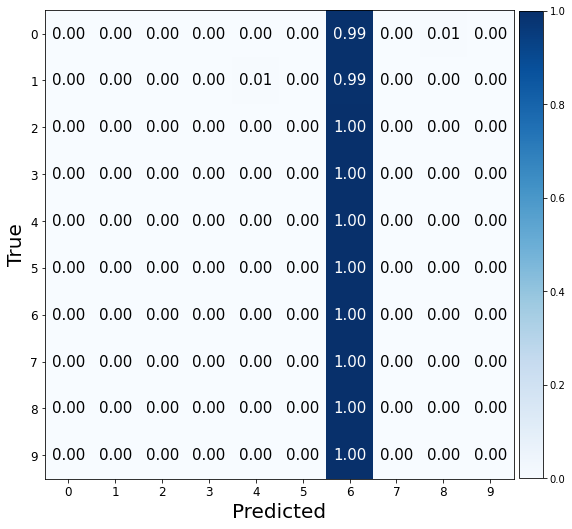

###################

ne: 150, hd:50, wd:0.1, lr: 0.1, bs:256 
Valid Evaluation loss: 2.3127031326293945. f1:0.018190086402910415 acc: 0.10000000149011612 


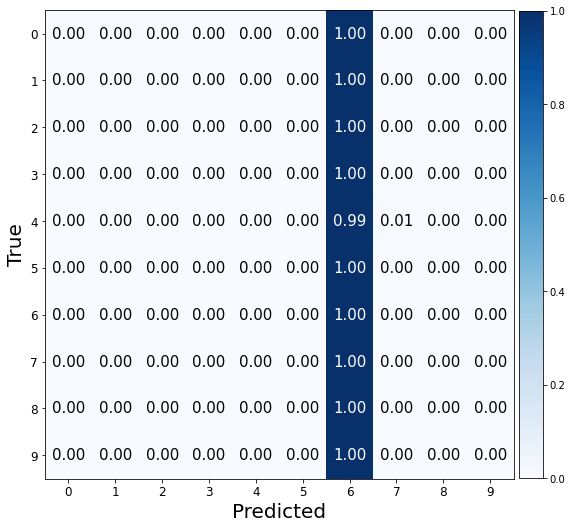

Valid Evaluation loss: 1.9807677268981934. f1:0.1973568156398995 acc: 0.27399998903274536 


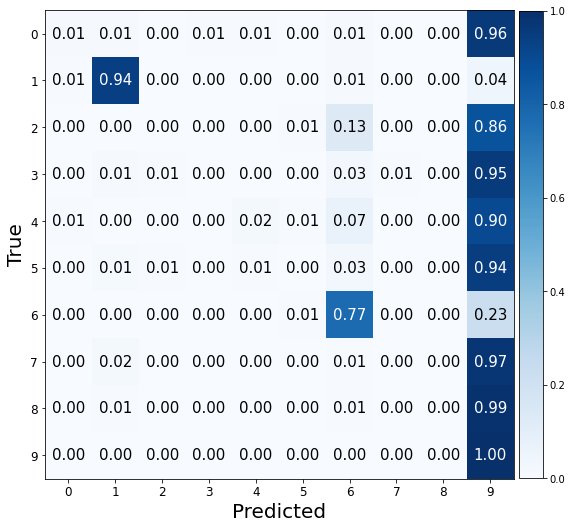

###################

ne: 150, hd:80, wd:0.1, lr: 0.1, bs:256 
Valid Evaluation loss: 2.294036388397217. f1:0.04308822198559772 acc: 0.11299999803304672 


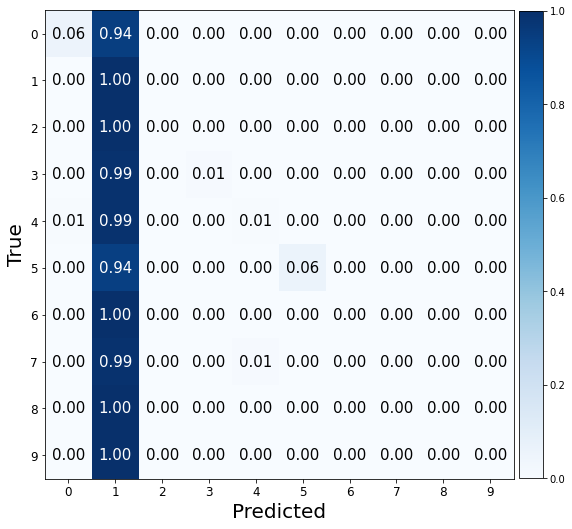

Valid Evaluation loss: 2.319164752960205. f1:0.01821493624772313 acc: 0.10000000149011612 


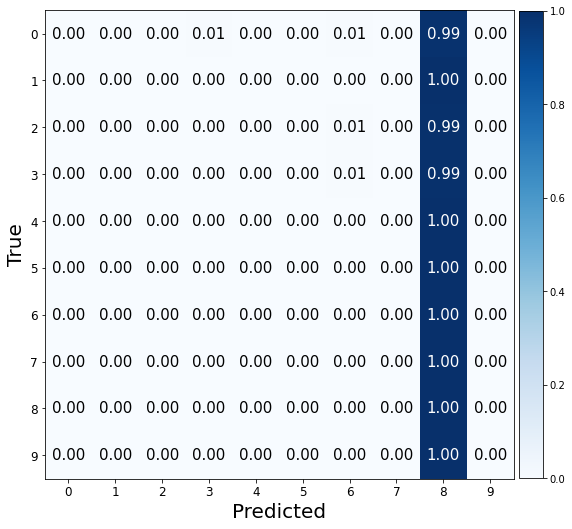

###################

ne: 150, hd:100, wd:0.1, lr: 0.1, bs:256 
Valid Evaluation loss: 2.2620463371276855. f1:0.1529001390477643 acc: 0.21799999475479126 


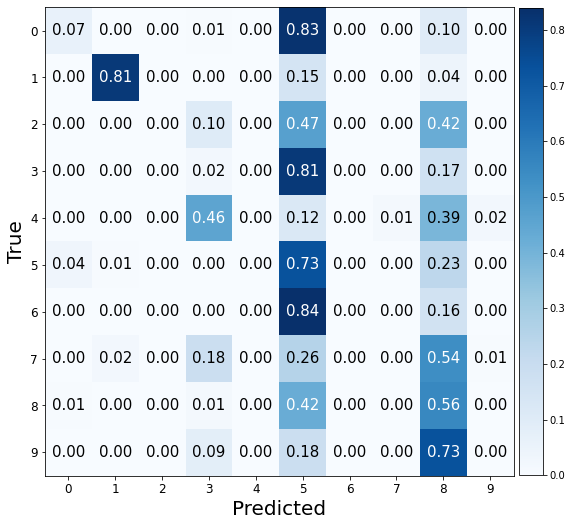

Valid Evaluation loss: 2.306516647338867. f1:0.022173924524398217 acc: 0.10199999809265137 


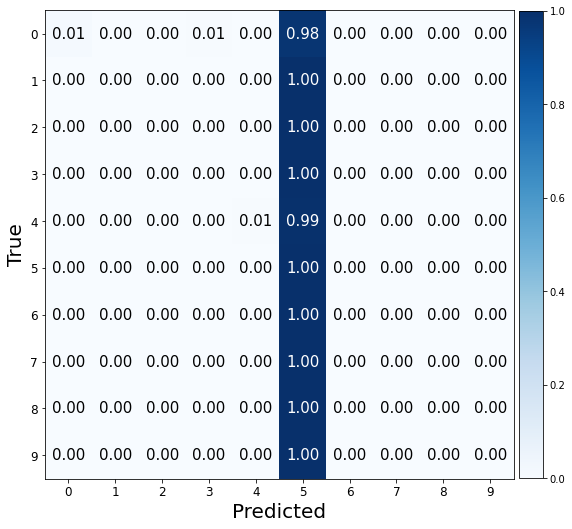

###################

ne: 150, hd:50, wd:0.001, lr: 0.001, bs:512 
Valid Evaluation loss: 0.7131999135017395. f1:0.8636638378214432 acc: 0.8640000224113464 


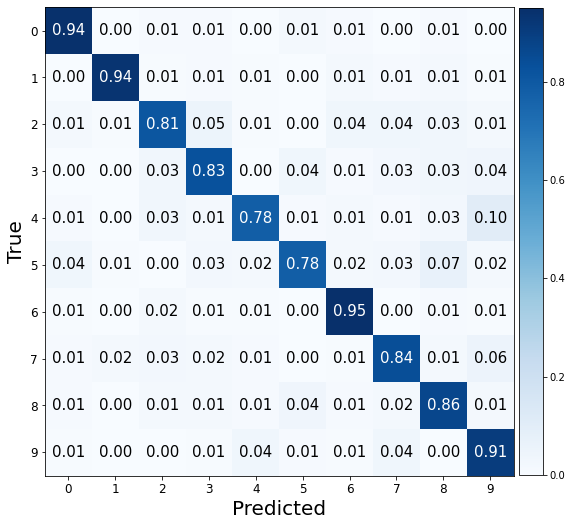

Valid Evaluation loss: 0.39611944556236267. f1:0.8996797795936071 acc: 0.8999999761581421 


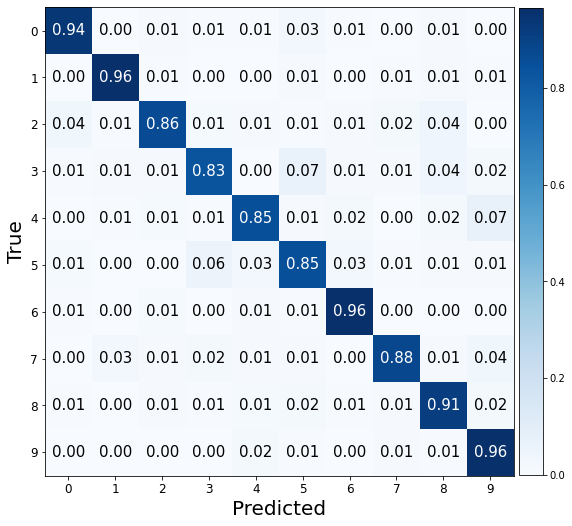

###################

ne: 150, hd:80, wd:0.001, lr: 0.001, bs:512 
Valid Evaluation loss: 0.5618934035301208. f1:0.8872651432827364 acc: 0.887499988079071 


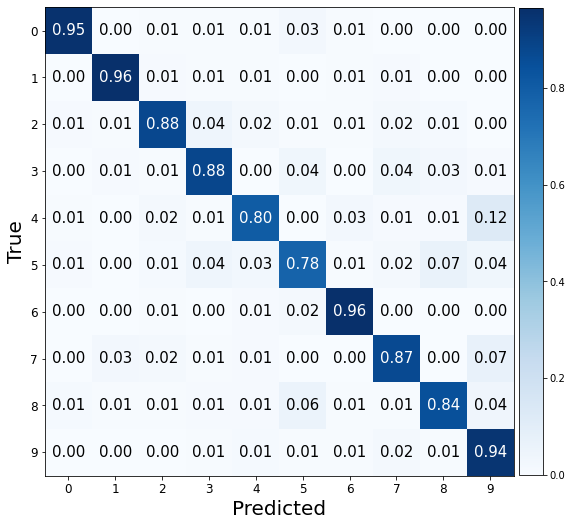

Valid Evaluation loss: 0.3495407700538635. f1:0.9022819657182588 acc: 0.9020000100135803 


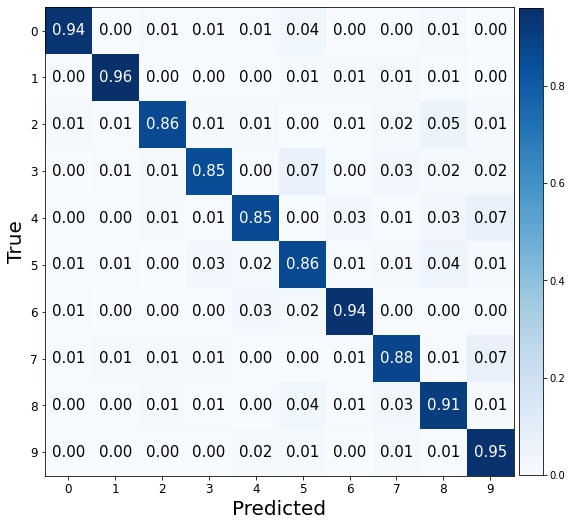

###################

ne: 150, hd:100, wd:0.001, lr: 0.001, bs:512 
Valid Evaluation loss: 0.6221779584884644. f1:0.8936266601545014 acc: 0.8939999938011169 


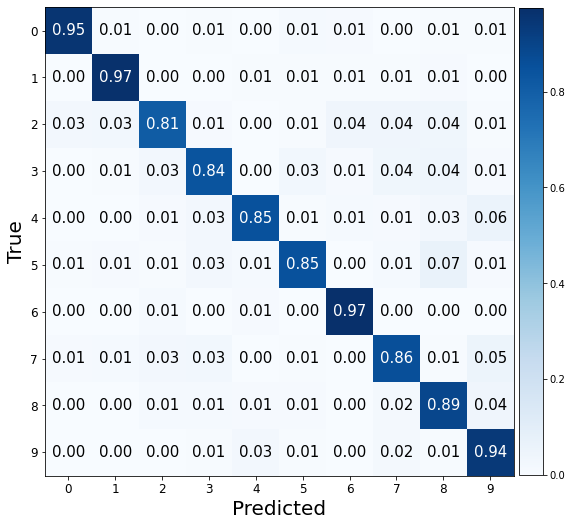

Valid Evaluation loss: 0.3208865225315094. f1:0.9175896881183583 acc: 0.9175000190734863 


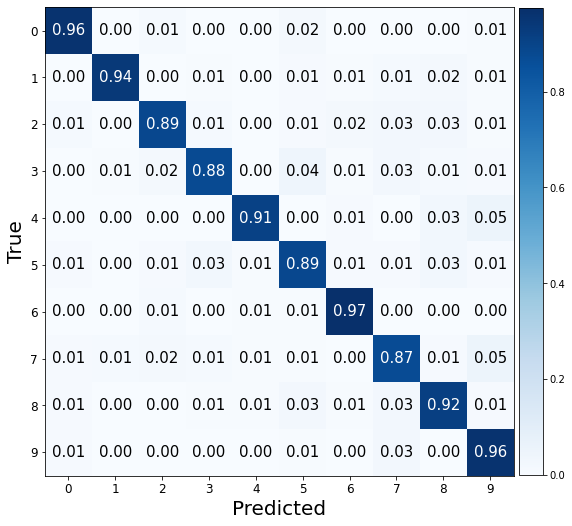

###################

ne: 150, hd:50, wd:0.01, lr: 0.001, bs:512 
Valid Evaluation loss: 0.6866596937179565. f1:0.8541068688619529 acc: 0.8535000085830688 


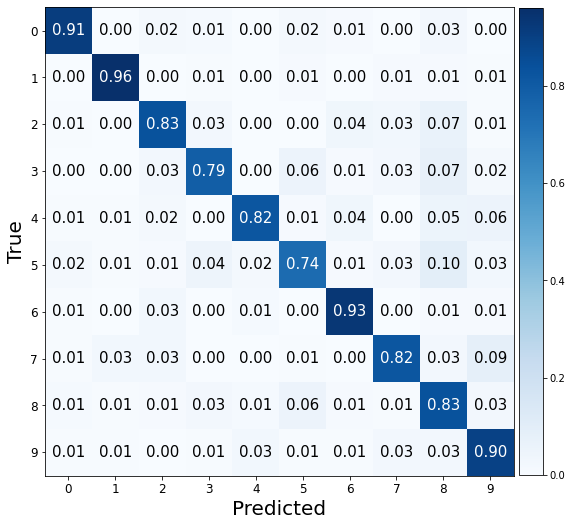

Valid Evaluation loss: 0.3793801963329315. f1:0.9001103557216386 acc: 0.9004999995231628 


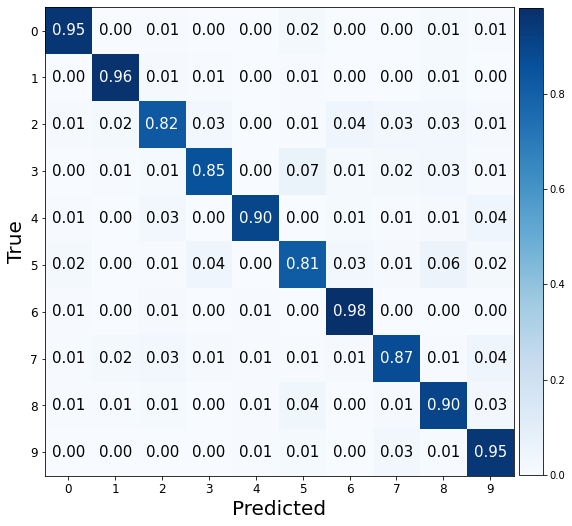

###################

ne: 150, hd:80, wd:0.01, lr: 0.001, bs:512 
Valid Evaluation loss: 0.6794735789299011. f1:0.8877198476819815 acc: 0.8880000114440918 


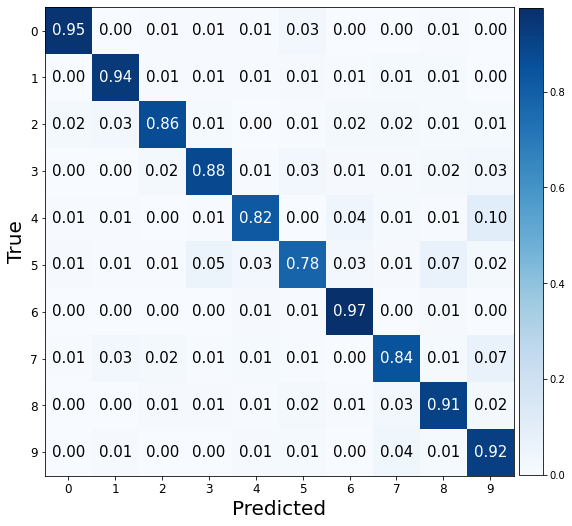

Valid Evaluation loss: 0.3133852779865265. f1:0.9162949356847652 acc: 0.9164999723434448 


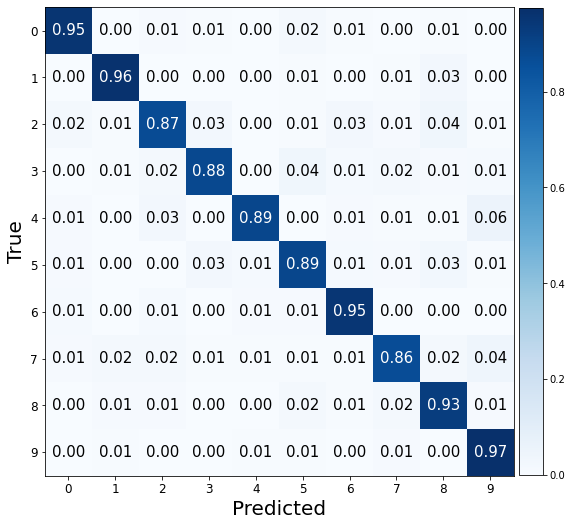

###################

ne: 150, hd:100, wd:0.01, lr: 0.001, bs:512 
Valid Evaluation loss: 0.753600001335144. f1:0.8990321521508513 acc: 0.8989999890327454 


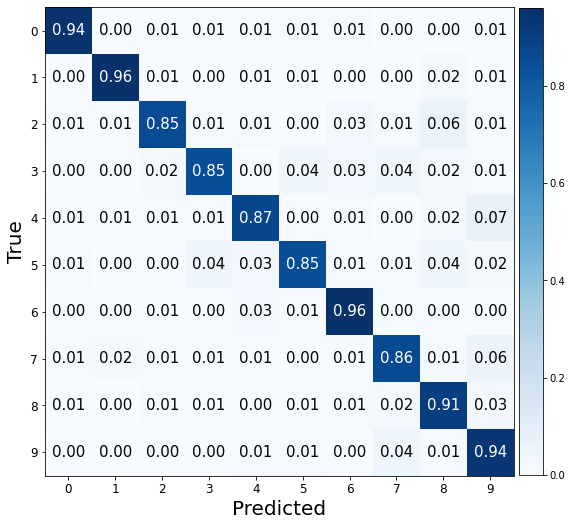

Valid Evaluation loss: 0.3455815017223358. f1:0.9090179045344439 acc: 0.9089999794960022 


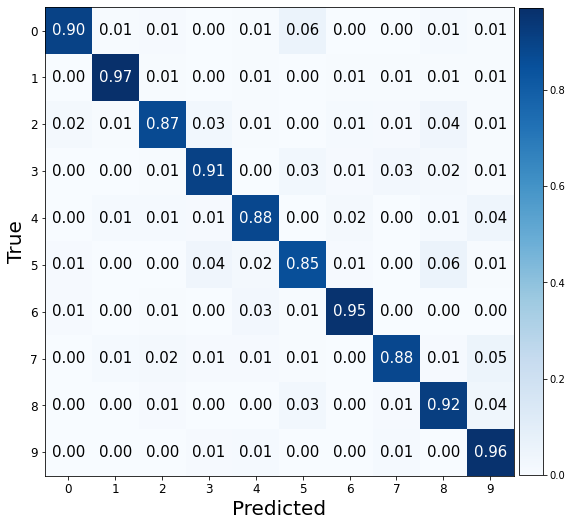

###################

ne: 150, hd:50, wd:0.1, lr: 0.001, bs:512 
Valid Evaluation loss: 0.5633248686790466. f1:0.8717415389712582 acc: 0.871999979019165 


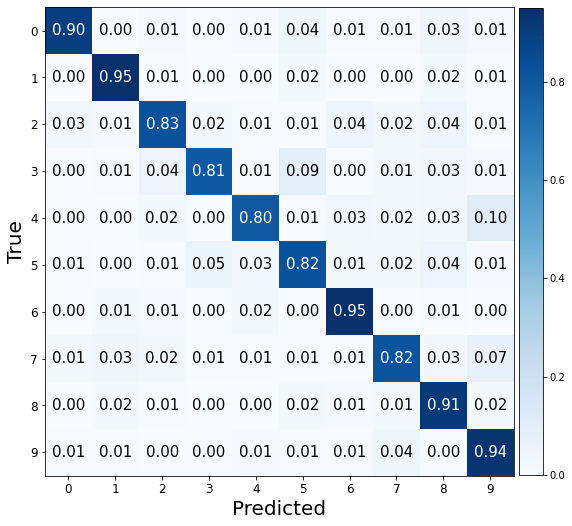

Valid Evaluation loss: 0.2998756766319275. f1:0.9064463154381448 acc: 0.906499981880188 


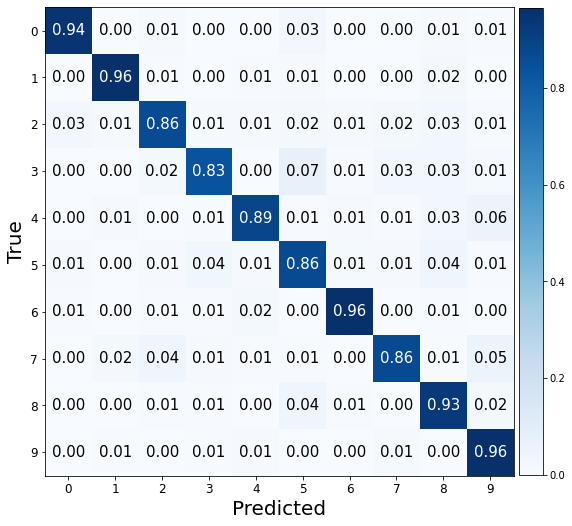

###################

ne: 150, hd:80, wd:0.1, lr: 0.001, bs:512 
Valid Evaluation loss: 0.5881862640380859. f1:0.8910403327337123 acc: 0.890999972820282 


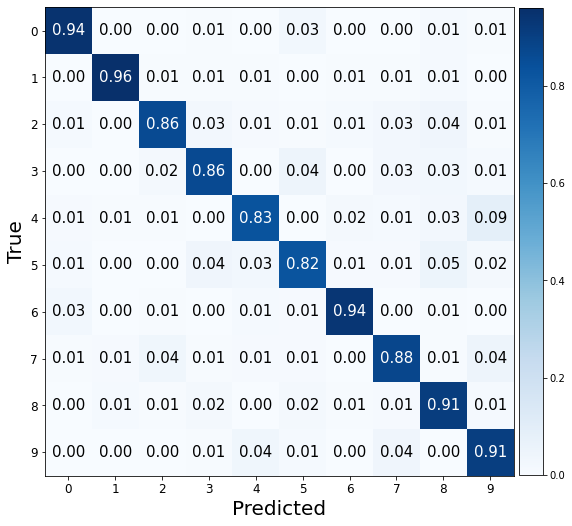

Valid Evaluation loss: 0.2581064701080322. f1:0.9193925594249185 acc: 0.9194999933242798 


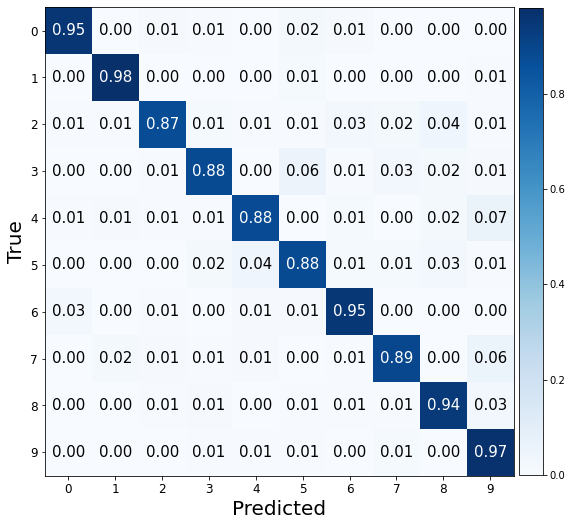

###################

ne: 150, hd:100, wd:0.1, lr: 0.001, bs:512 
Valid Evaluation loss: 0.5338194370269775. f1:0.8961723928239371 acc: 0.8964999914169312 


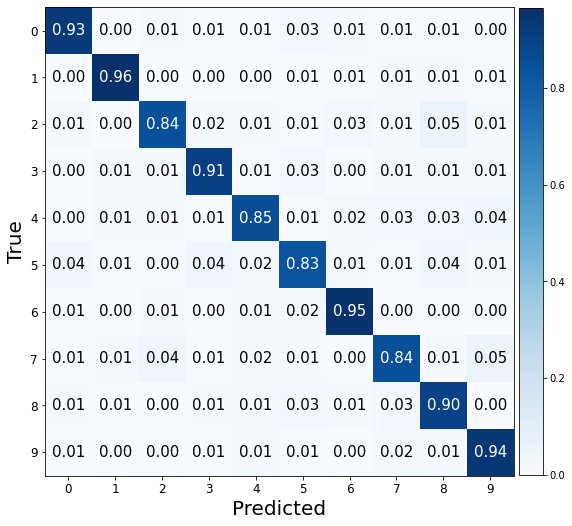

Valid Evaluation loss: 0.2390546351671219. f1:0.9251821524392152 acc: 0.9254999756813049 


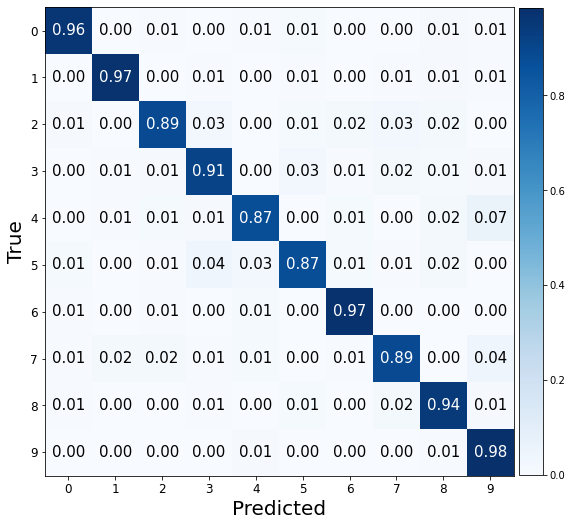

###################

ne: 150, hd:50, wd:0.001, lr: 0.01, bs:512 
Valid Evaluation loss: 1.6026273965835571. f1:0.4825091187819671 acc: 0.5214999914169312 


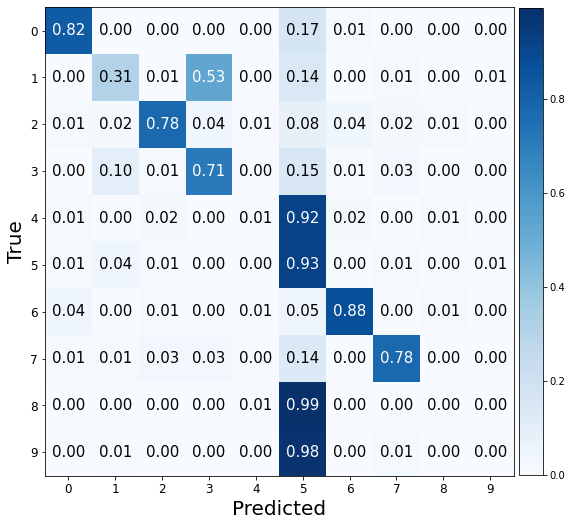

Valid Evaluation loss: 0.6200537085533142. f1:0.8387213514276726 acc: 0.8385000228881836 


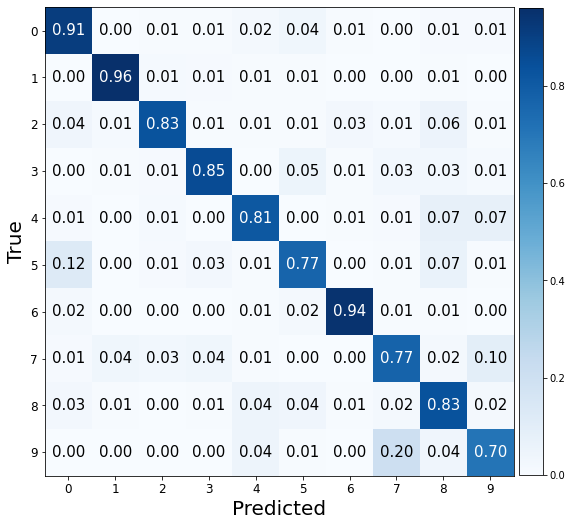

###################

ne: 150, hd:80, wd:0.001, lr: 0.01, bs:512 
Valid Evaluation loss: 1.1946589946746826. f1:0.66763229052622 acc: 0.6735000014305115 


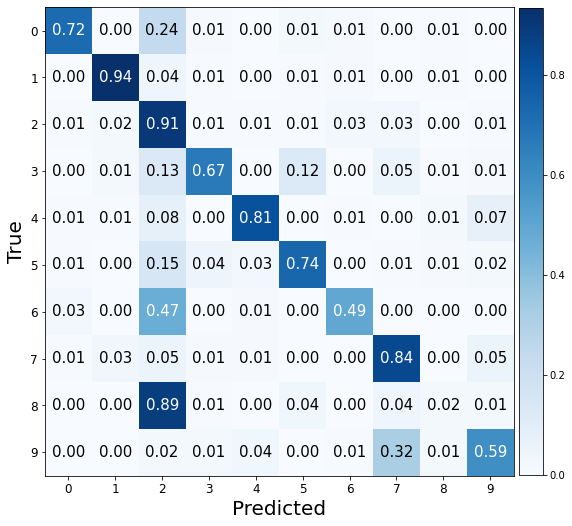

Valid Evaluation loss: 0.5555964112281799. f1:0.8661453399206369 acc: 0.8659999966621399 


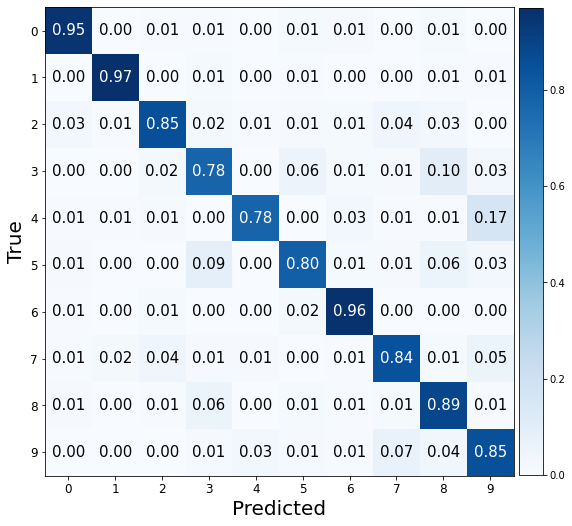

###################

ne: 150, hd:100, wd:0.001, lr: 0.01, bs:512 
Valid Evaluation loss: 1.3842328786849976. f1:0.6188687875586838 acc: 0.6399999856948853 


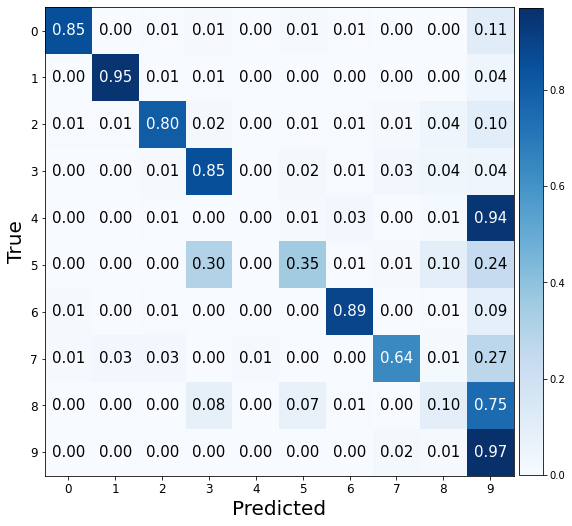

Valid Evaluation loss: 1.1842708587646484. f1:0.5464146485223308 acc: 0.5899999737739563 


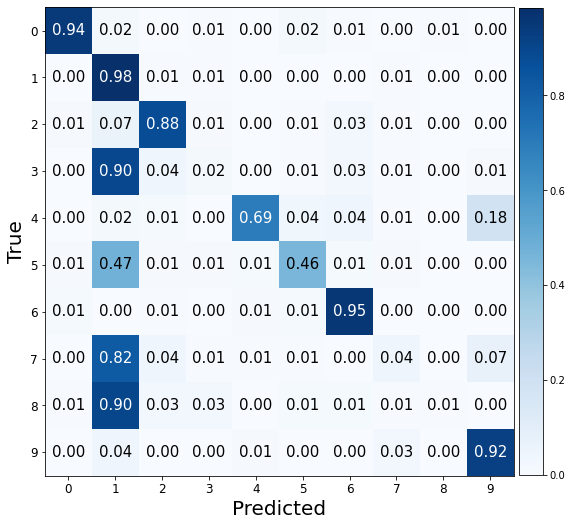

###################

ne: 150, hd:50, wd:0.01, lr: 0.01, bs:512 
Valid Evaluation loss: 1.1420878171920776. f1:0.632540982082195 acc: 0.6480000019073486 


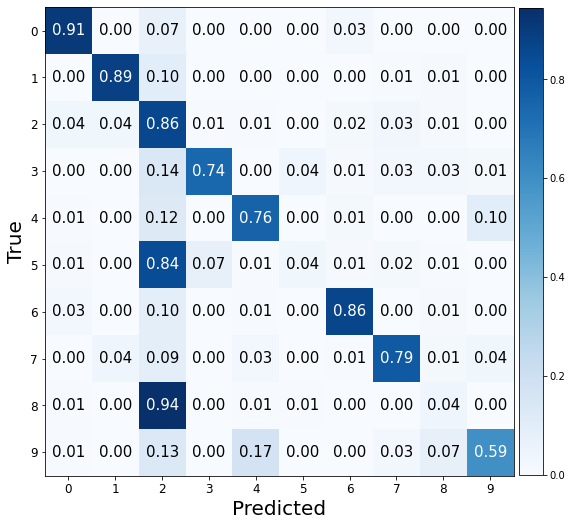

Valid Evaluation loss: 0.8863797783851624. f1:0.6390011489194999 acc: 0.6759999990463257 


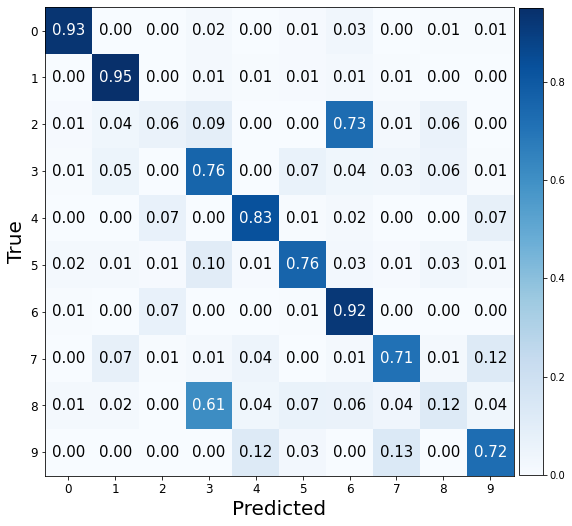

###################

ne: 150, hd:80, wd:0.01, lr: 0.01, bs:512 
Valid Evaluation loss: 1.1754350662231445. f1:0.6775859729381086 acc: 0.6859999895095825 


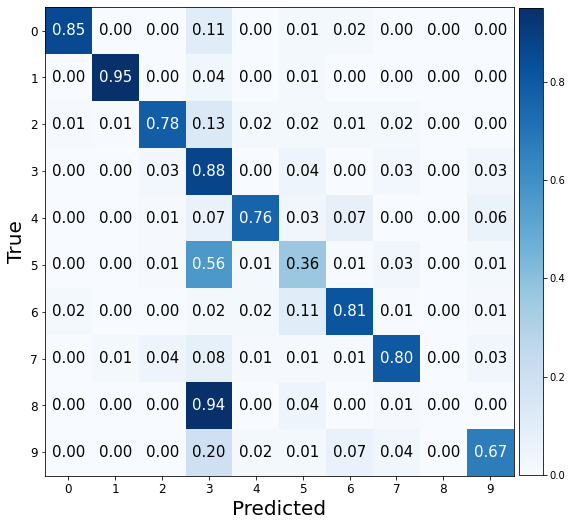

Valid Evaluation loss: 0.5116599798202515. f1:0.8696873788307578 acc: 0.8700000047683716 


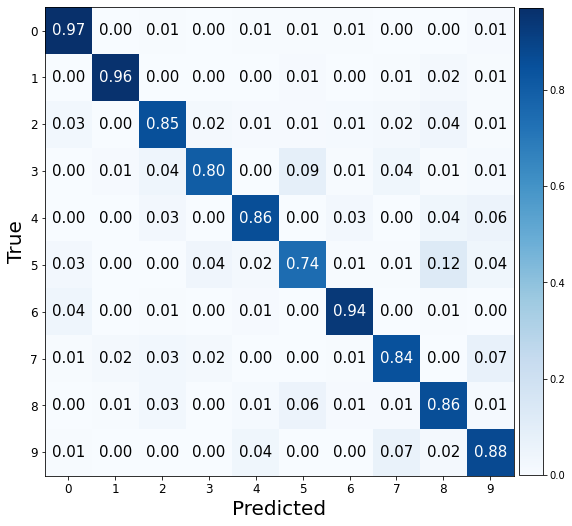

###################

ne: 150, hd:100, wd:0.01, lr: 0.01, bs:512 
Valid Evaluation loss: 1.087592363357544. f1:0.7355714659051257 acc: 0.7279999852180481 


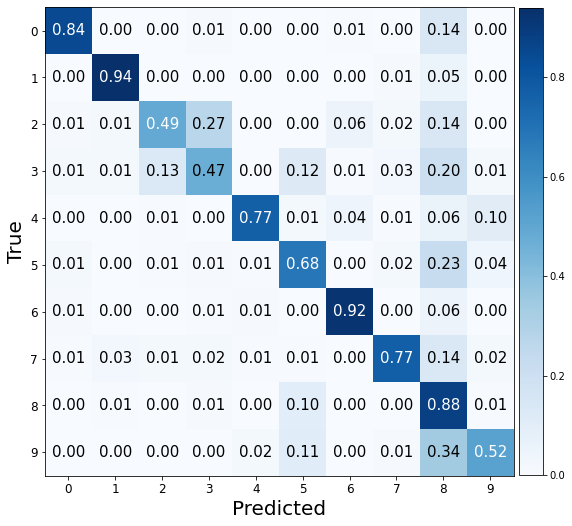

Valid Evaluation loss: 0.6923125386238098. f1:0.8337359149242598 acc: 0.8335000276565552 


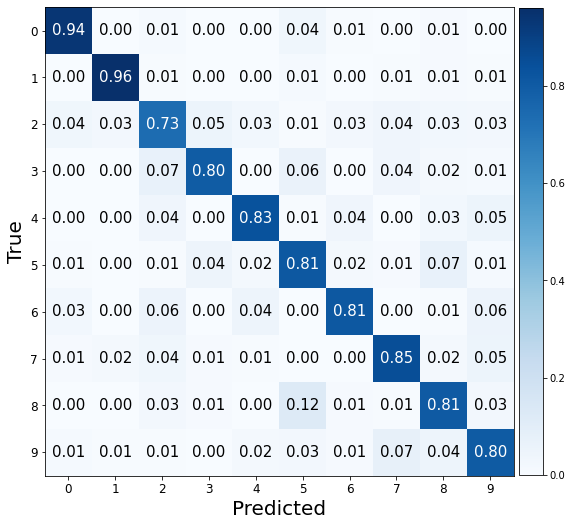

###################

ne: 150, hd:50, wd:0.1, lr: 0.01, bs:512 
Valid Evaluation loss: 0.9321594834327698. f1:0.7173772337163205 acc: 0.7229999899864197 


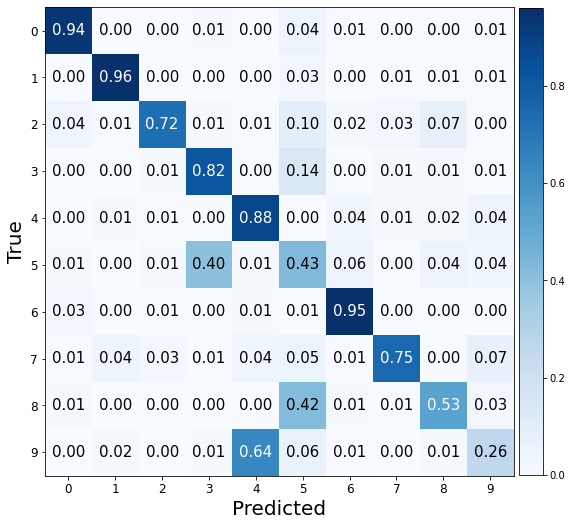

Valid Evaluation loss: 0.3369055390357971. f1:0.8954156093603439 acc: 0.8960000276565552 


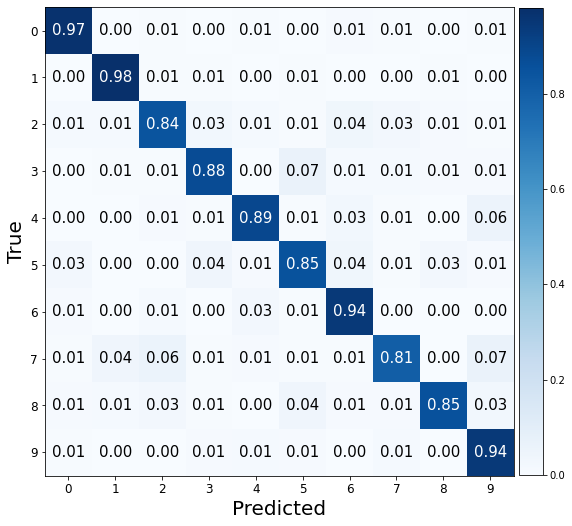

###################

ne: 150, hd:80, wd:0.1, lr: 0.01, bs:512 
Valid Evaluation loss: 1.061570167541504. f1:0.7137015022031428 acc: 0.7214999794960022 


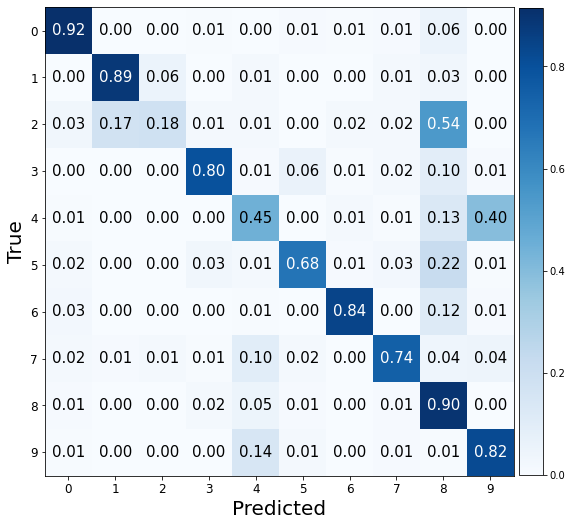

Valid Evaluation loss: 0.2578023374080658. f1:0.9229489494226722 acc: 0.9229999780654907 


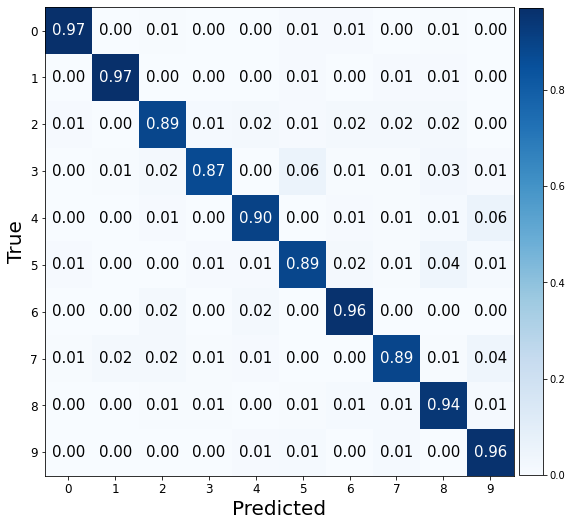

###################

ne: 150, hd:100, wd:0.1, lr: 0.01, bs:512 
Valid Evaluation loss: 0.7930366396903992. f1:0.7891943153335976 acc: 0.7925000190734863 


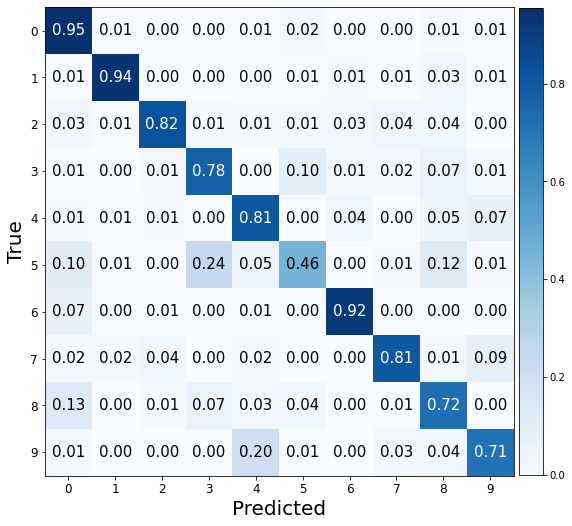

Valid Evaluation loss: 0.2753024697303772. f1:0.9143387185649257 acc: 0.9139999747276306 


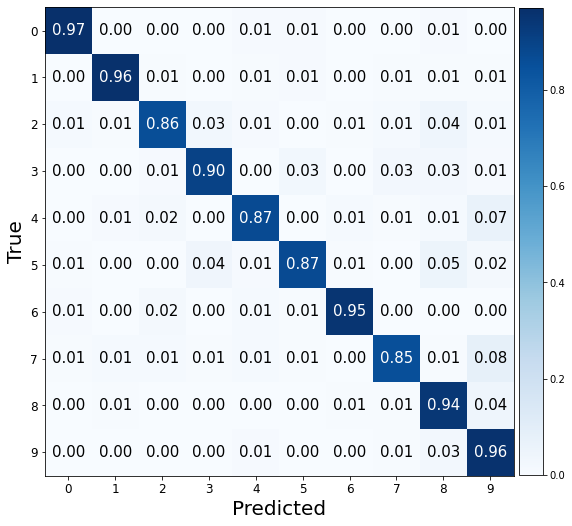

###################

ne: 150, hd:50, wd:0.001, lr: 0.1, bs:512 
Valid Evaluation loss: 2.8591649532318115. f1:0.03909680158591976 acc: 0.11100000143051147 


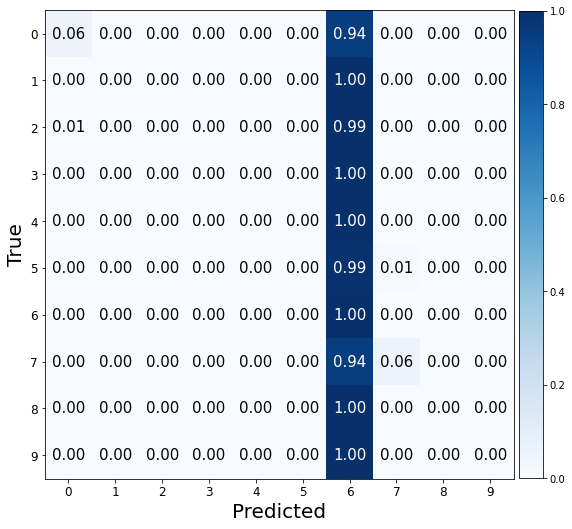

Valid Evaluation loss: 2.3025853633880615. f1:0.01818181818181818 acc: 0.10000000149011612 


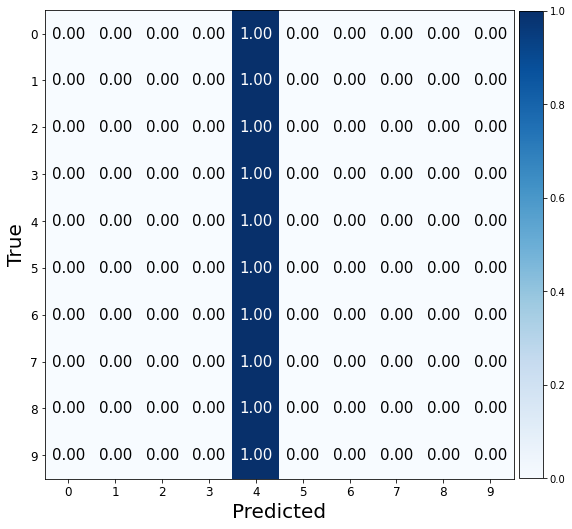

###################

ne: 150, hd:80, wd:0.001, lr: 0.1, bs:512 
Valid Evaluation loss: 3.0735456943511963. f1:0.22124465971463084 acc: 0.2529999911785126 


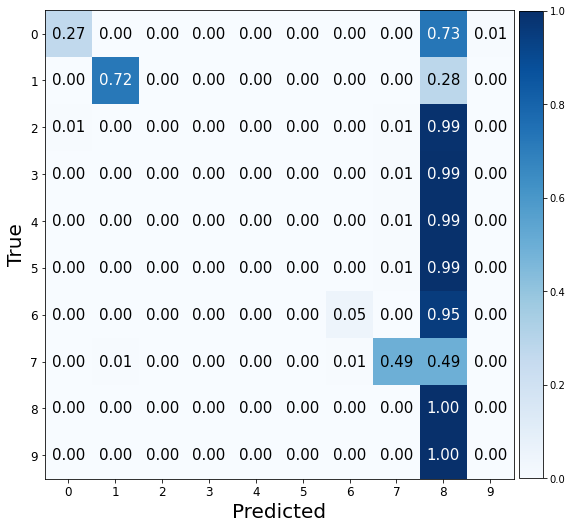

Valid Evaluation loss: 2.302896022796631. f1:0.01818181818181818 acc: 0.10000000149011612 


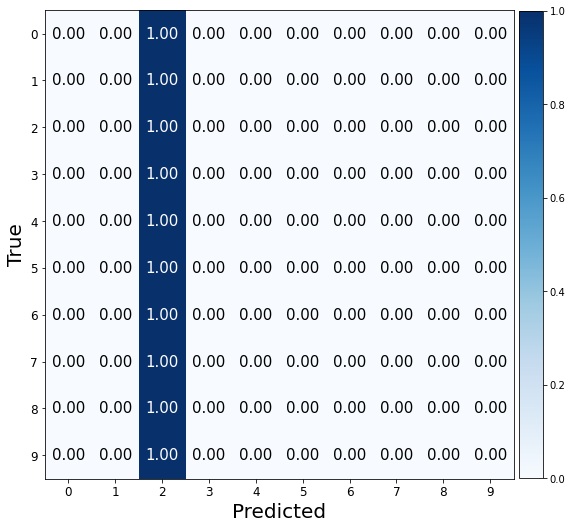

###################

ne: 150, hd:100, wd:0.001, lr: 0.1, bs:512 
Valid Evaluation loss: 3.0686521530151367. f1:0.14603749772949767 acc: 0.18400000035762787 


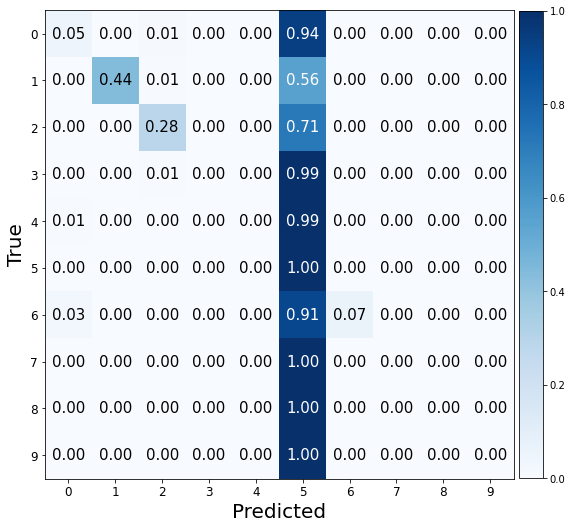

Valid Evaluation loss: 2.3027138710021973. f1:0.01818181818181818 acc: 0.10000000149011612 


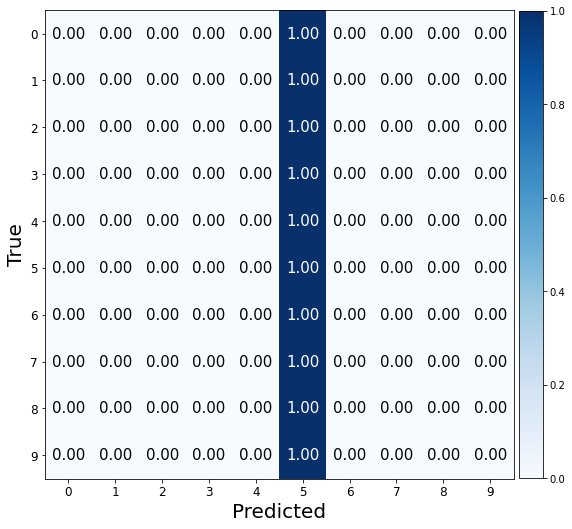

###################

ne: 150, hd:50, wd:0.01, lr: 0.1, bs:512 
Valid Evaluation loss: 2.4728856086730957. f1:0.0944138254828841 acc: 0.16050000488758087 


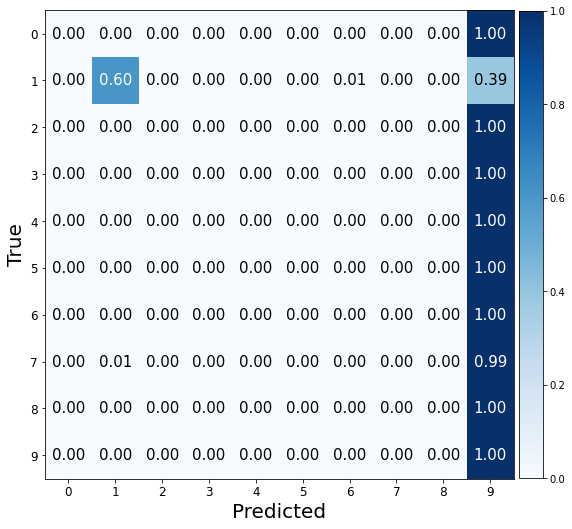

Valid Evaluation loss: 2.3030221462249756. f1:0.01818181818181818 acc: 0.10000000149011612 


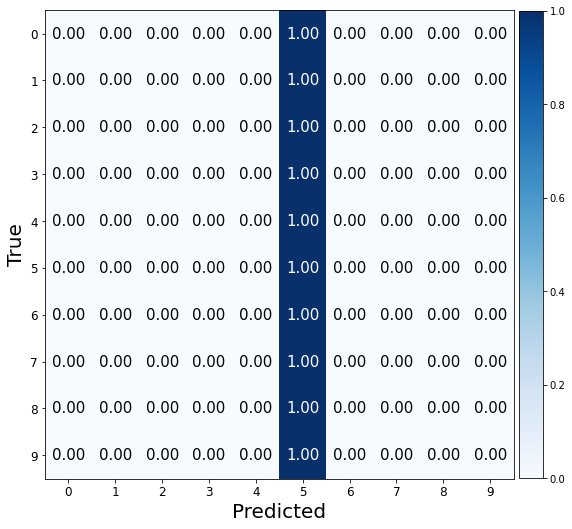

###################

ne: 150, hd:80, wd:0.01, lr: 0.1, bs:512 
Valid Evaluation loss: 2.372877359390259. f1:0.09328155429371623 acc: 0.16050000488758087 


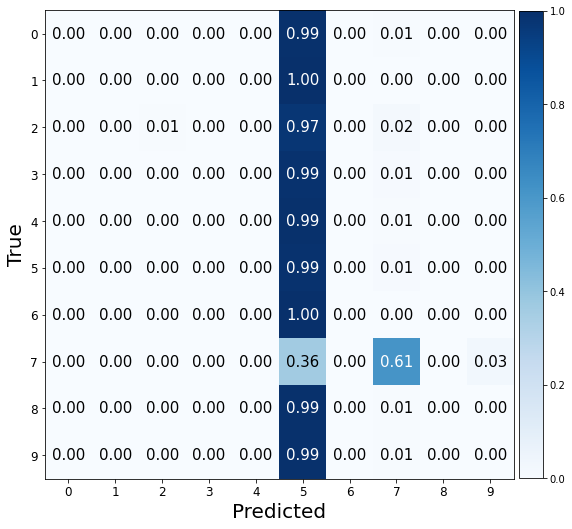

Valid Evaluation loss: 2.3026602268218994. f1:0.01818181818181818 acc: 0.10000000149011612 


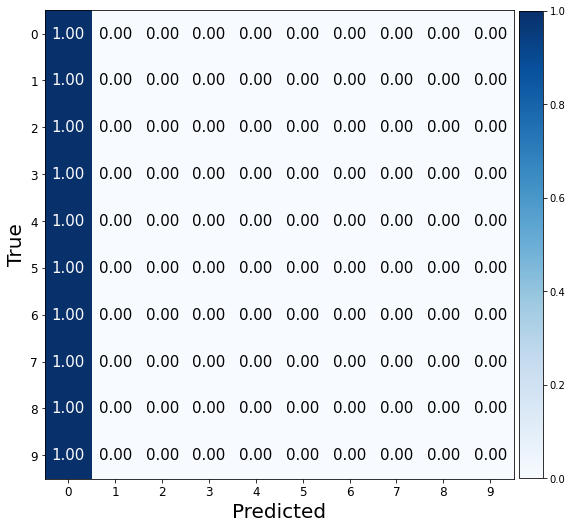

###################

ne: 150, hd:100, wd:0.01, lr: 0.1, bs:512 
Valid Evaluation loss: 2.3029773235321045. f1:0.1658512797669094 acc: 0.22450000047683716 


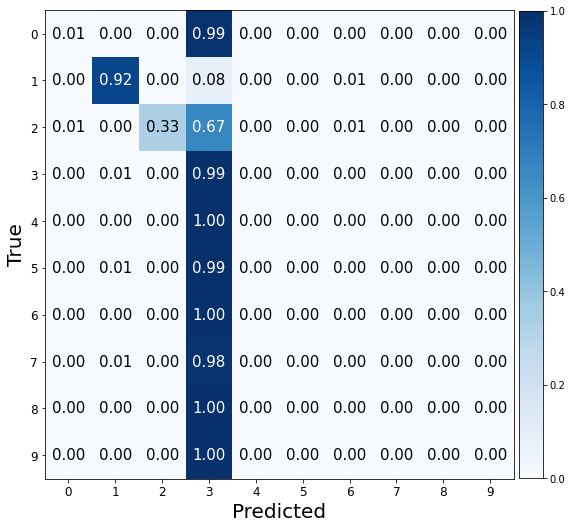

Valid Evaluation loss: 2.313647508621216. f1:0.021901690036884254 acc: 0.10100000351667404 


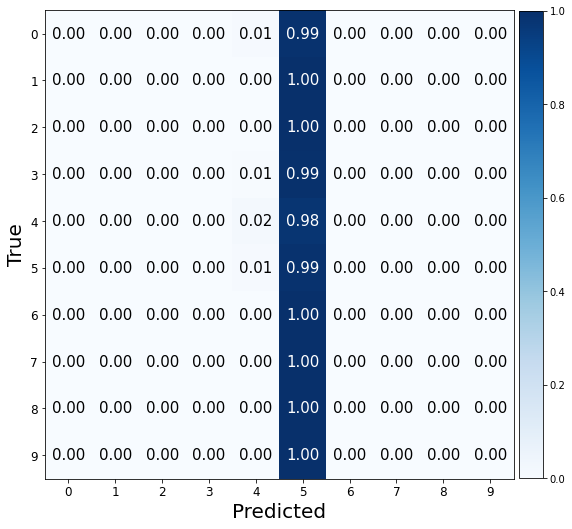

###################

ne: 150, hd:50, wd:0.1, lr: 0.1, bs:512 
Valid Evaluation loss: 2.315502643585205. f1:0.018065693430656938 acc: 0.0989999994635582 


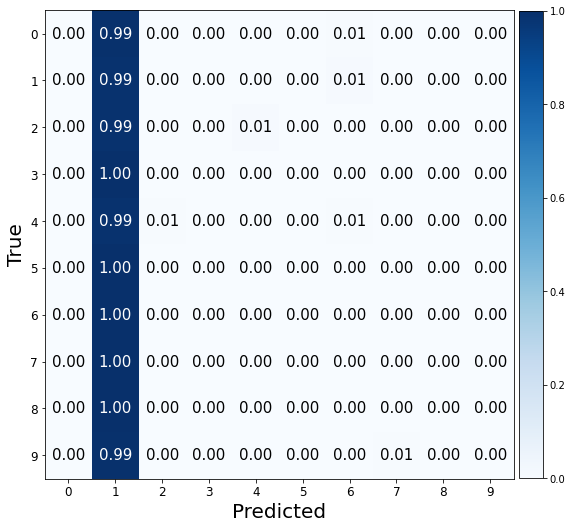

Valid Evaluation loss: 2.258101224899292. f1:0.016881918819188192 acc: 0.09149999916553497 


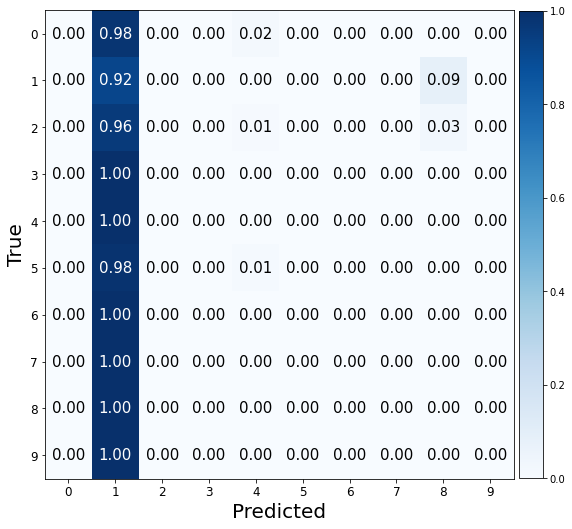

###################

ne: 150, hd:80, wd:0.1, lr: 0.1, bs:512 
Valid Evaluation loss: 2.3722925186157227. f1:0.18611821562732306 acc: 0.2395000010728836 


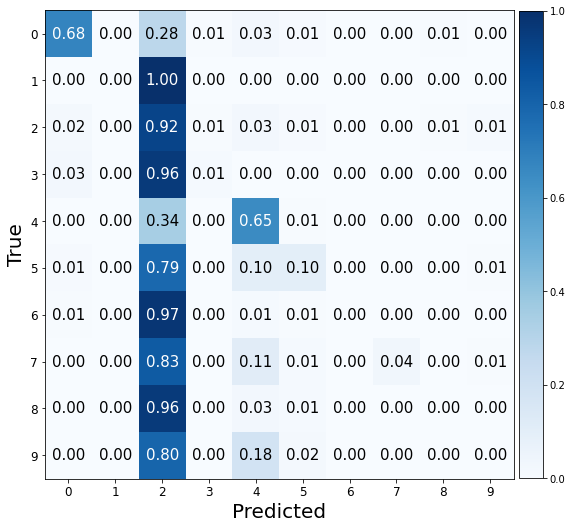

Valid Evaluation loss: 2.306631565093994. f1:0.019155383157982247 acc: 0.10000000149011612 


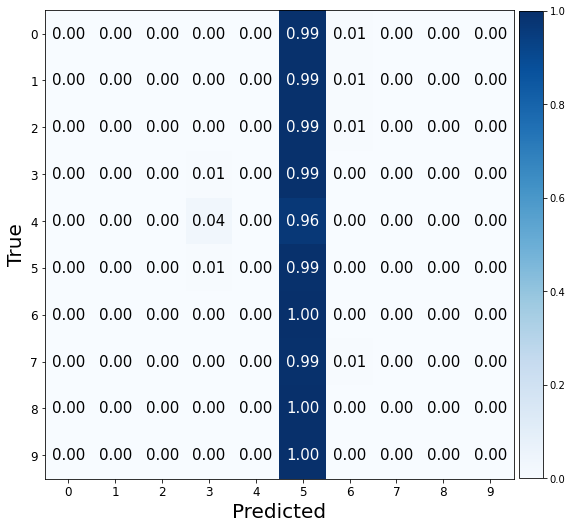

###################

ne: 150, hd:100, wd:0.1, lr: 0.1, bs:512 
Valid Evaluation loss: 2.171733856201172. f1:0.1393467764329614 acc: 0.2029999941587448 


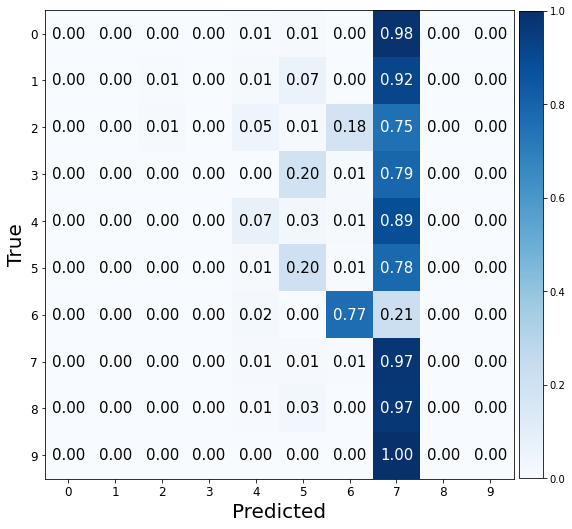

Valid Evaluation loss: 2.812814950942993. f1:0.07753924818004261 acc: 0.16750000417232513 


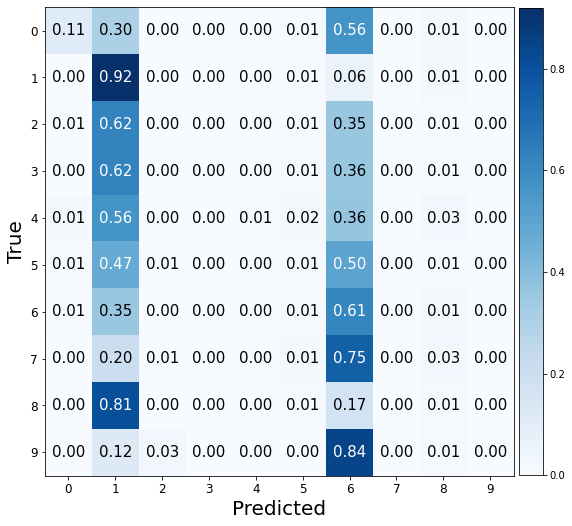

###################

ne: 150, hd:50, wd:0.001, lr: 0.001, bs:1024 
Valid Evaluation loss: 0.6648253798484802. f1:0.8811369269696593 acc: 0.8809999823570251 


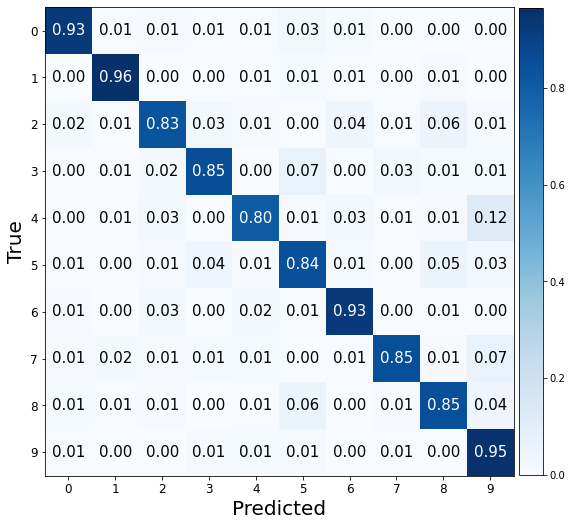

Valid Evaluation loss: 0.4418737590312958. f1:0.8924456770010167 acc: 0.8924999833106995 


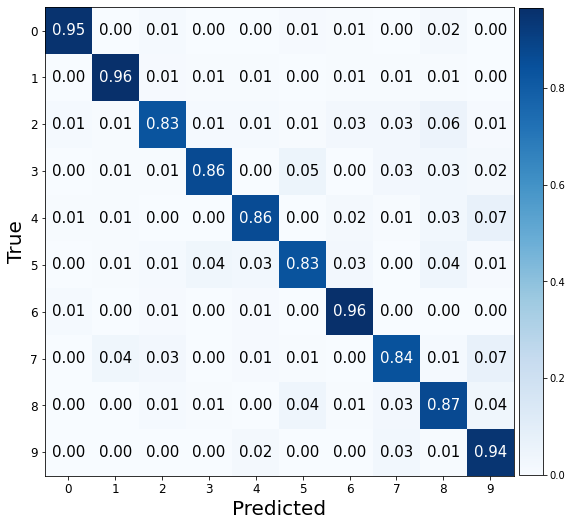

###################

ne: 150, hd:80, wd:0.001, lr: 0.001, bs:1024 
Valid Evaluation loss: 0.6213454604148865. f1:0.8966288703682069 acc: 0.8970000147819519 


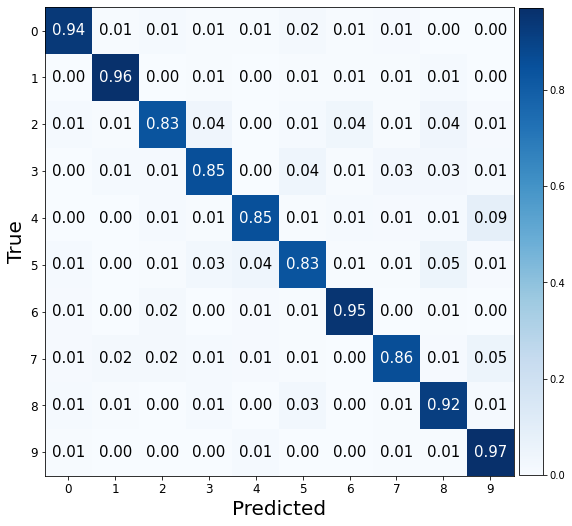

Valid Evaluation loss: 0.39706286787986755. f1:0.9122857073256702 acc: 0.9125000238418579 


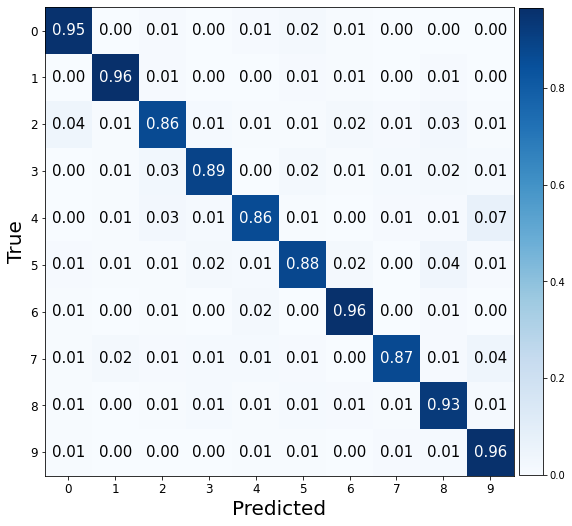

###################

ne: 150, hd:100, wd:0.001, lr: 0.001, bs:1024 
Valid Evaluation loss: 0.6559450626373291. f1:0.8971847183508233 acc: 0.8970000147819519 


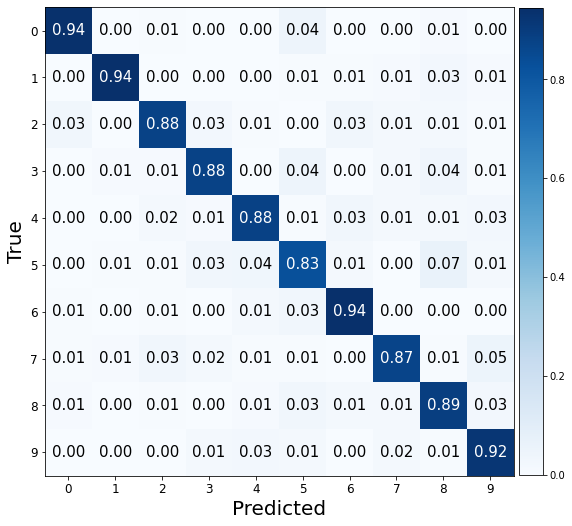

Valid Evaluation loss: 0.34037184715270996. f1:0.9062517053993503 acc: 0.906499981880188 


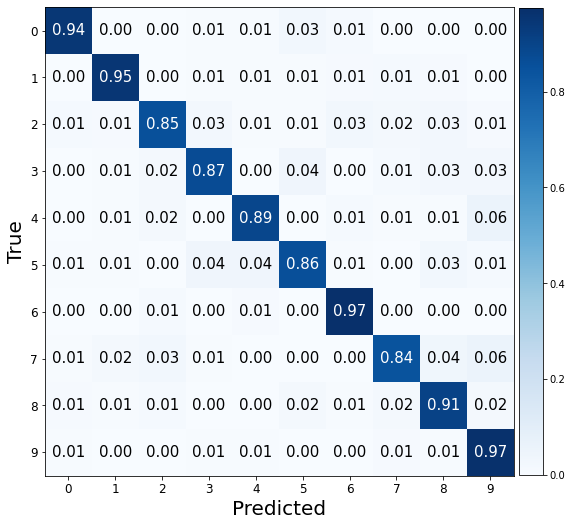

###################

ne: 150, hd:50, wd:0.01, lr: 0.001, bs:1024 
Valid Evaluation loss: 0.7639944553375244. f1:0.8539855750579953 acc: 0.8539999723434448 


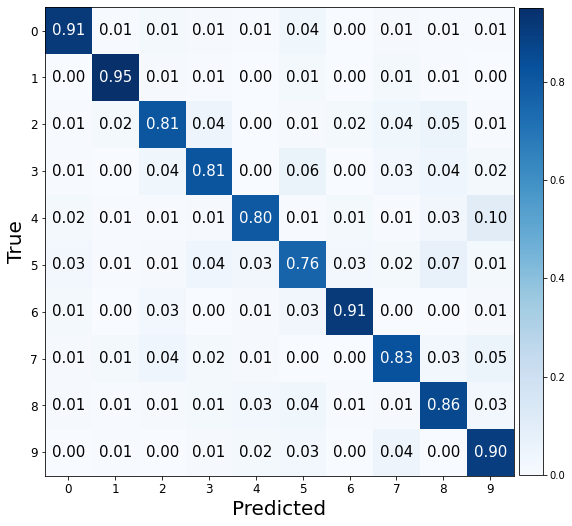

Valid Evaluation loss: 0.32413792610168457. f1:0.907010033955164 acc: 0.9075000286102295 


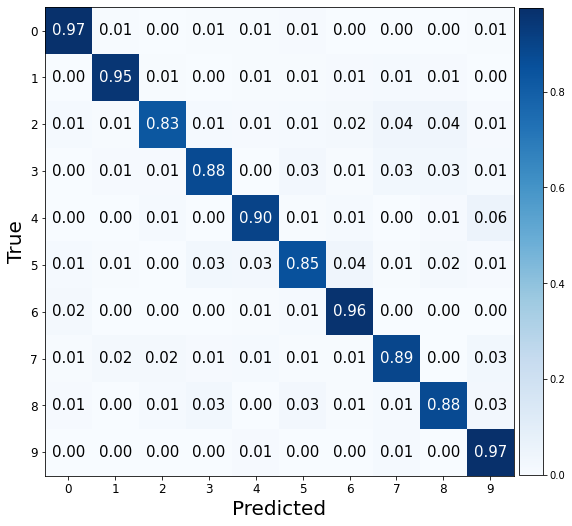

###################

ne: 150, hd:80, wd:0.01, lr: 0.001, bs:1024 
Valid Evaluation loss: 0.6664028763771057. f1:0.8813508127333464 acc: 0.8815000057220459 


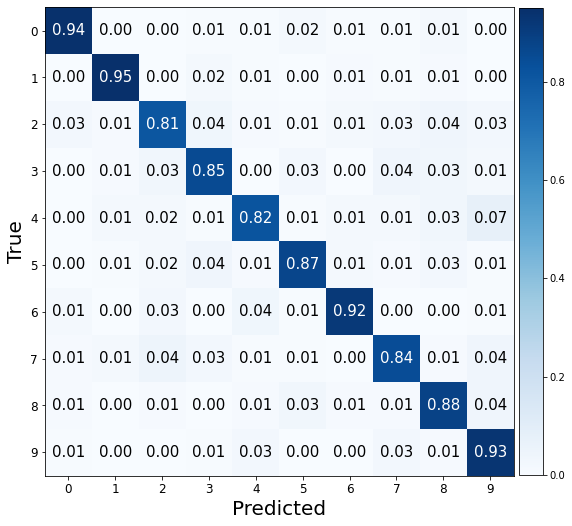

Valid Evaluation loss: 0.31152844429016113. f1:0.9084372376306031 acc: 0.9085000157356262 


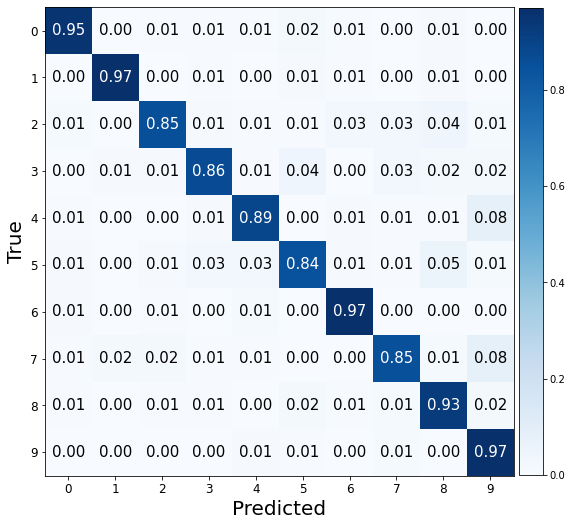

###################

ne: 150, hd:100, wd:0.01, lr: 0.001, bs:1024 
Valid Evaluation loss: 0.6256884336471558. f1:0.8914740519461969 acc: 0.8914999961853027 


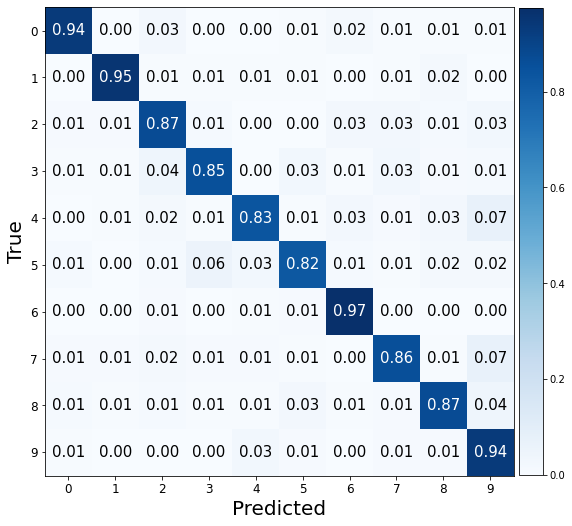

Valid Evaluation loss: 0.3556663393974304. f1:0.9114076948281058 acc: 0.9114999771118164 


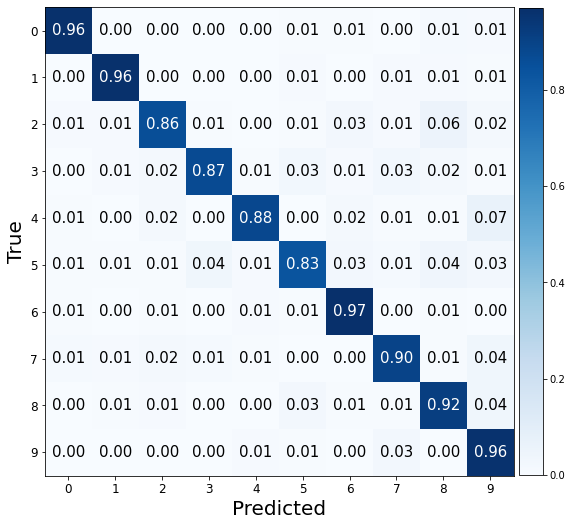

###################

ne: 150, hd:50, wd:0.1, lr: 0.001, bs:1024 
Valid Evaluation loss: 0.5927605032920837. f1:0.8548212424913254 acc: 0.8544999957084656 


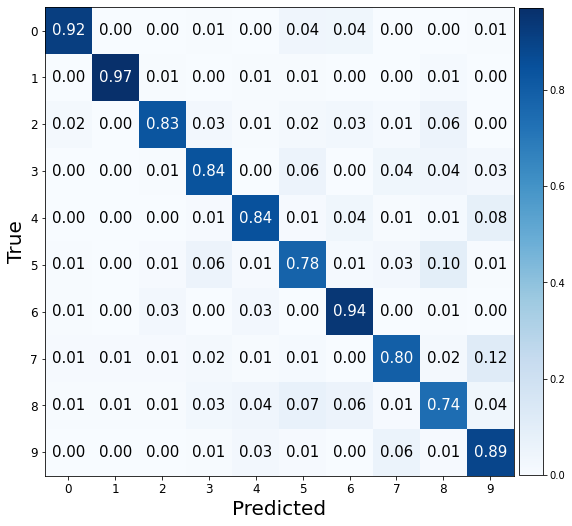

Valid Evaluation loss: 0.3254198431968689. f1:0.9048692227674792 acc: 0.9049999713897705 


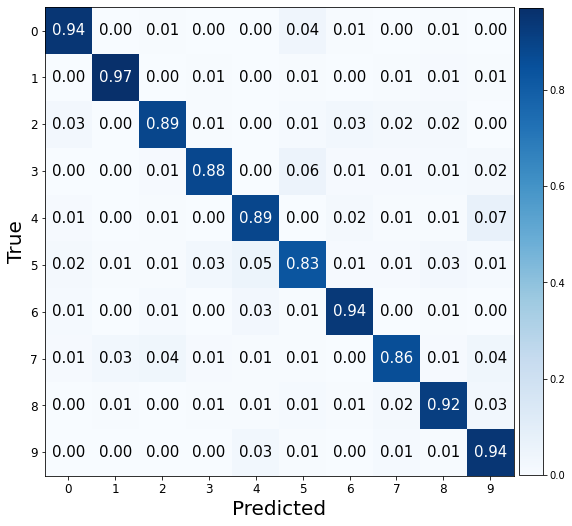

###################

ne: 150, hd:80, wd:0.1, lr: 0.001, bs:1024 
Valid Evaluation loss: 0.5625479817390442. f1:0.8791049654973287 acc: 0.8794999718666077 


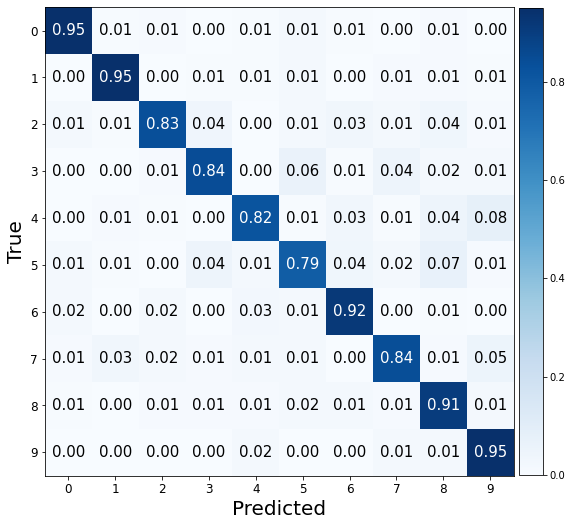

Valid Evaluation loss: 0.27779170870780945. f1:0.9151654641899942 acc: 0.9154999852180481 


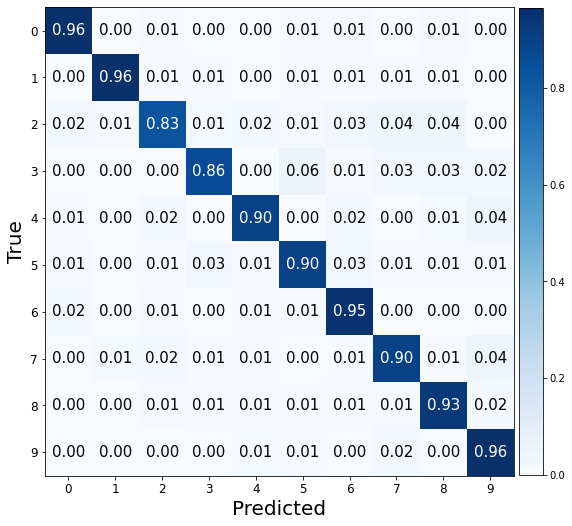

###################

ne: 150, hd:100, wd:0.1, lr: 0.001, bs:1024 
Valid Evaluation loss: 0.5140308737754822. f1:0.8947833065398058 acc: 0.8949999809265137 


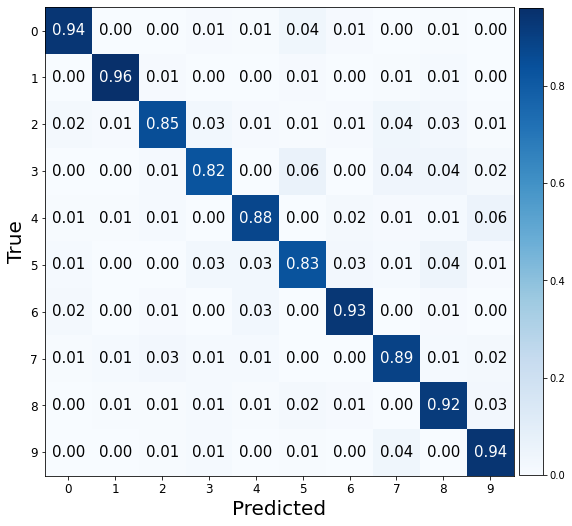

Valid Evaluation loss: 0.22387710213661194. f1:0.9289077370825547 acc: 0.9290000200271606 


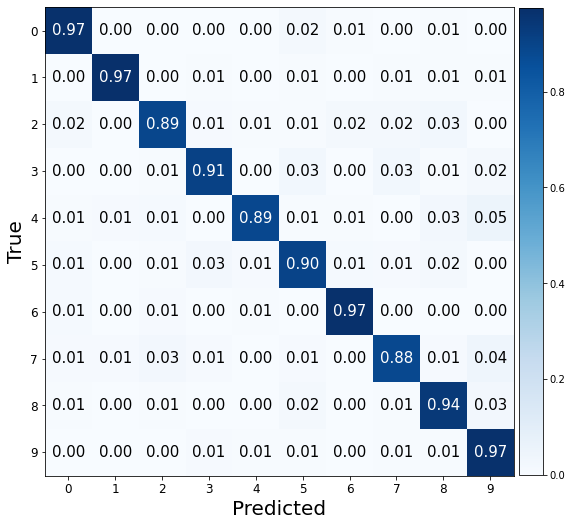

###################

ne: 150, hd:50, wd:0.001, lr: 0.01, bs:1024 
Valid Evaluation loss: 1.2520180940628052. f1:0.6998488409121207 acc: 0.7049999833106995 


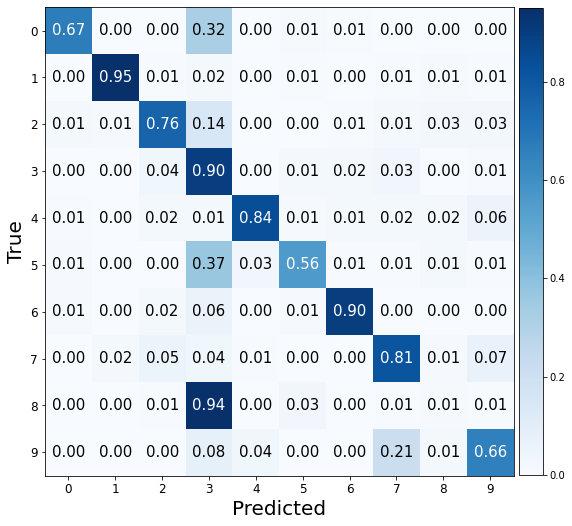

Valid Evaluation loss: 0.556178867816925. f1:0.8771946697262187 acc: 0.8769999742507935 


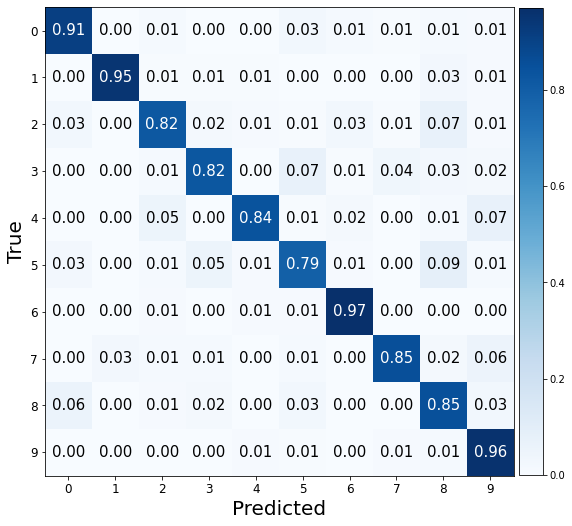

###################

ne: 150, hd:80, wd:0.001, lr: 0.01, bs:1024 
Valid Evaluation loss: 1.1012604236602783. f1:0.7491705925865852 acc: 0.7609999775886536 


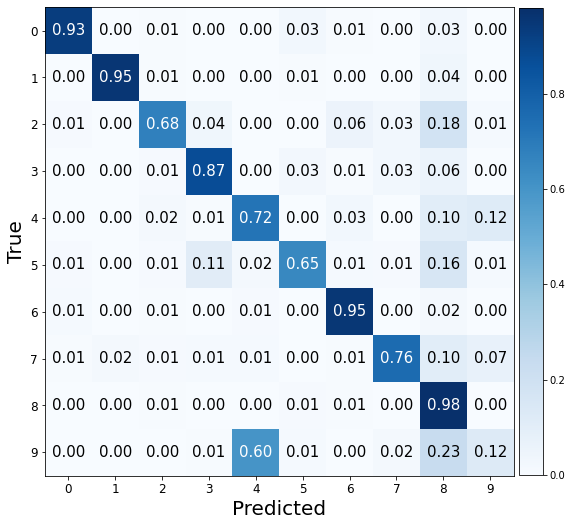

Valid Evaluation loss: 0.5130360126495361. f1:0.8588140483483964 acc: 0.859000027179718 


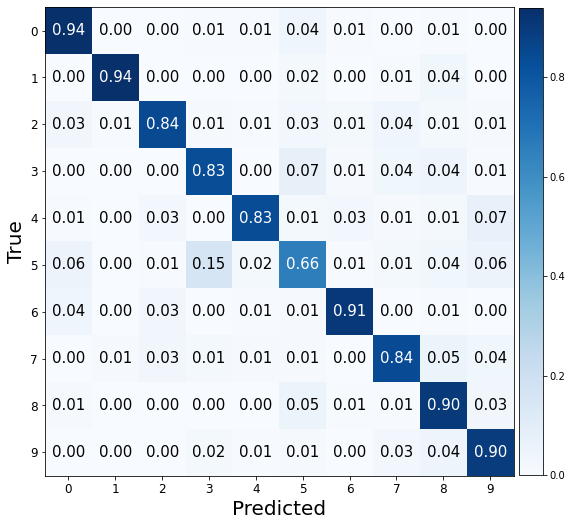

###################

ne: 150, hd:100, wd:0.001, lr: 0.01, bs:1024 
Valid Evaluation loss: 0.7803469896316528. f1:0.8468649292561994 acc: 0.8429999947547913 


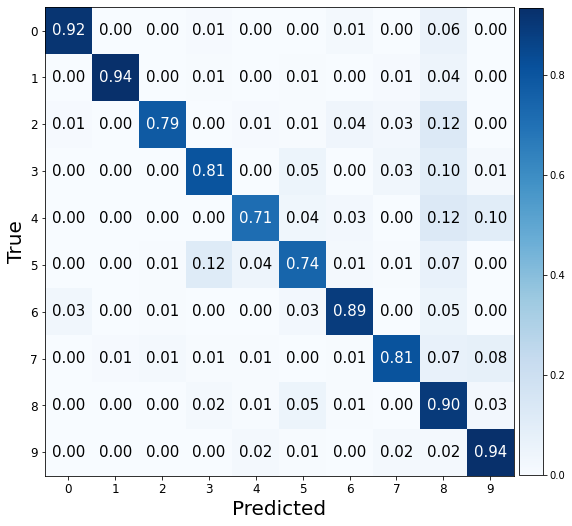

Valid Evaluation loss: 0.6032556891441345. f1:0.8719133749811412 acc: 0.871999979019165 


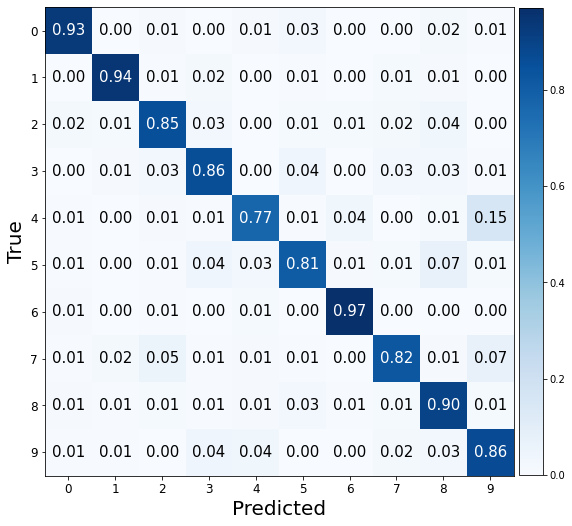

###################

ne: 150, hd:50, wd:0.01, lr: 0.01, bs:1024 
Valid Evaluation loss: 1.5245546102523804. f1:0.47204599404399233 acc: 0.5009999871253967 


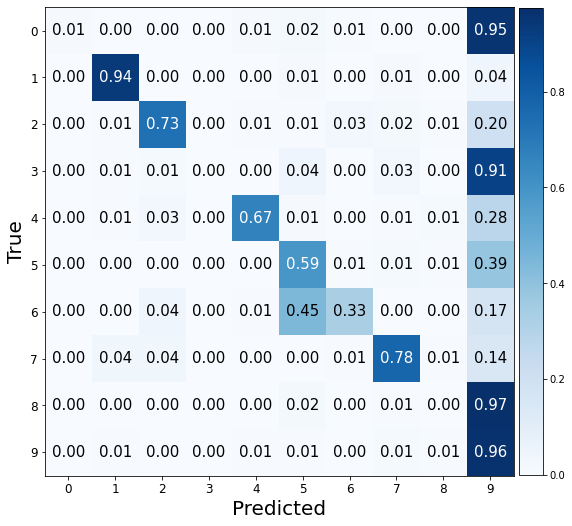

Valid Evaluation loss: 0.4664236903190613. f1:0.8940389780725952 acc: 0.8939999938011169 


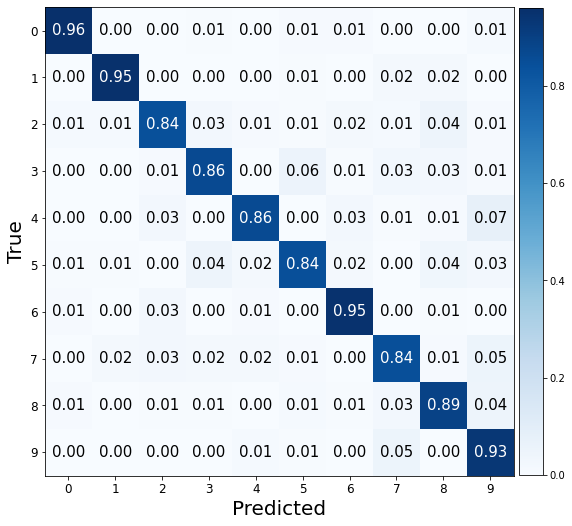

###################

ne: 150, hd:80, wd:0.01, lr: 0.01, bs:1024 
Valid Evaluation loss: 0.7493129372596741. f1:0.8157250613155259 acc: 0.8100000023841858 


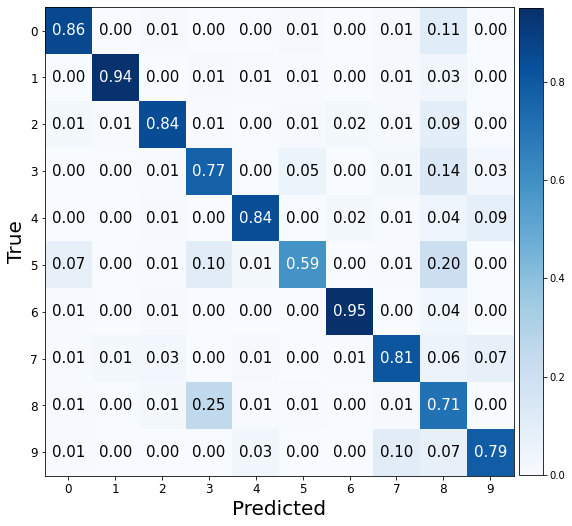

Valid Evaluation loss: 0.5797246098518372. f1:0.8774999476527123 acc: 0.8774999976158142 


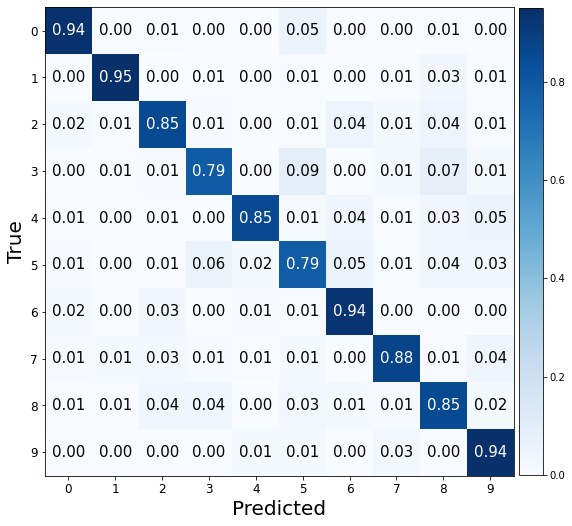

###################

ne: 150, hd:100, wd:0.01, lr: 0.01, bs:1024 
Valid Evaluation loss: 0.7632651925086975. f1:0.8342564334692545 acc: 0.8335000276565552 


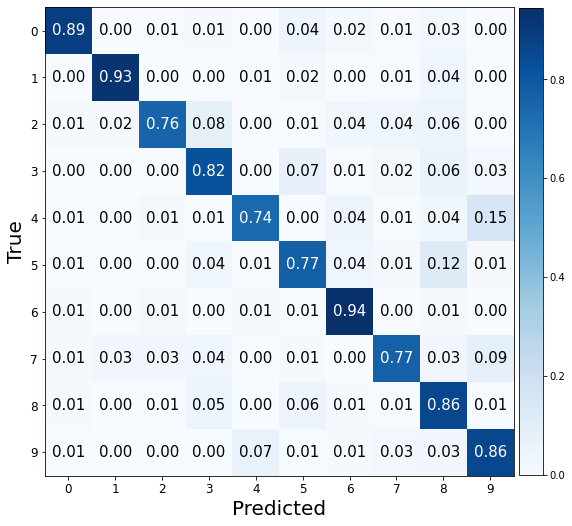

Valid Evaluation loss: 1.0569829940795898. f1:0.5593720546607451 acc: 0.5985000133514404 


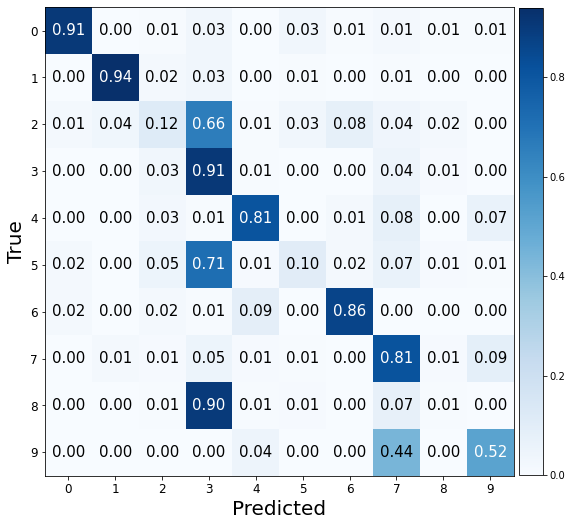

###################

ne: 150, hd:50, wd:0.1, lr: 0.01, bs:1024 
Valid Evaluation loss: 0.9863765835762024. f1:0.6703684156216232 acc: 0.6924999952316284 


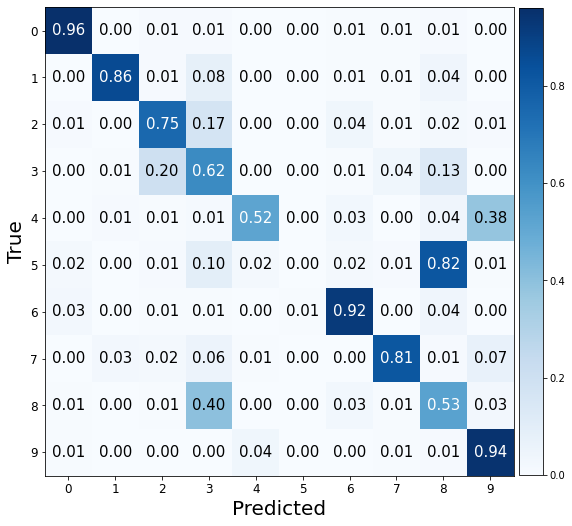

Valid Evaluation loss: 0.2724486291408539. f1:0.9176733300555331 acc: 0.9179999828338623 


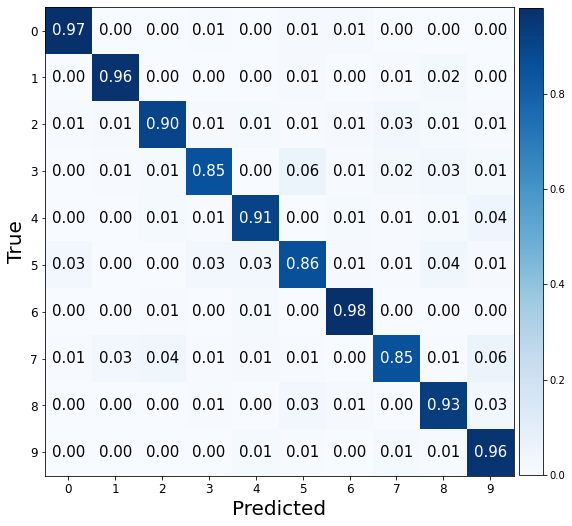

###################

ne: 150, hd:80, wd:0.1, lr: 0.01, bs:1024 
Valid Evaluation loss: 0.6817464828491211. f1:0.8628860789068253 acc: 0.8615000247955322 


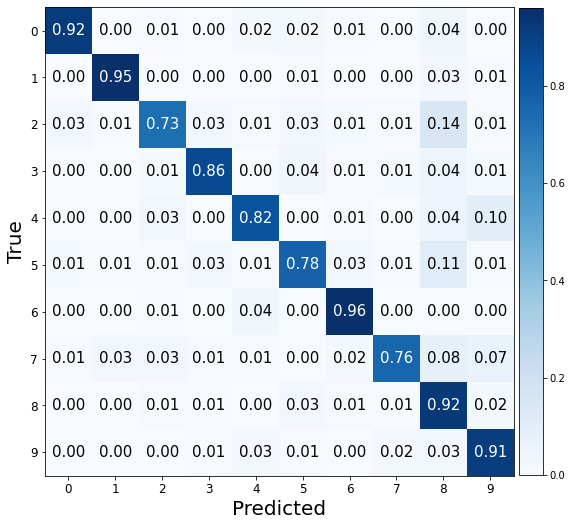

Valid Evaluation loss: 0.30828702449798584. f1:0.8969582603937573 acc: 0.8970000147819519 


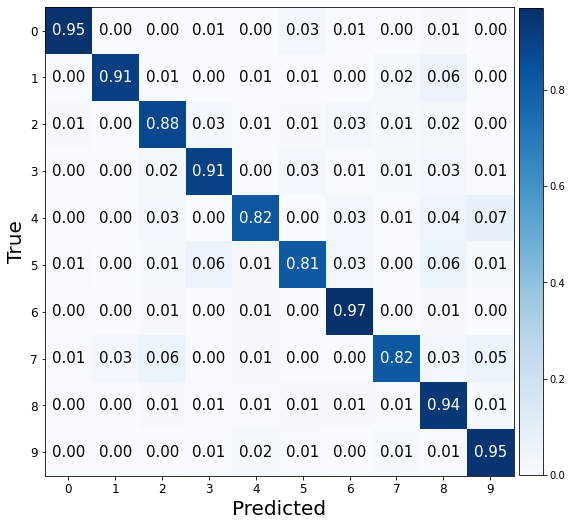

###################

ne: 150, hd:100, wd:0.1, lr: 0.01, bs:1024 
Valid Evaluation loss: 0.6458955407142639. f1:0.8268639872313275 acc: 0.8255000114440918 


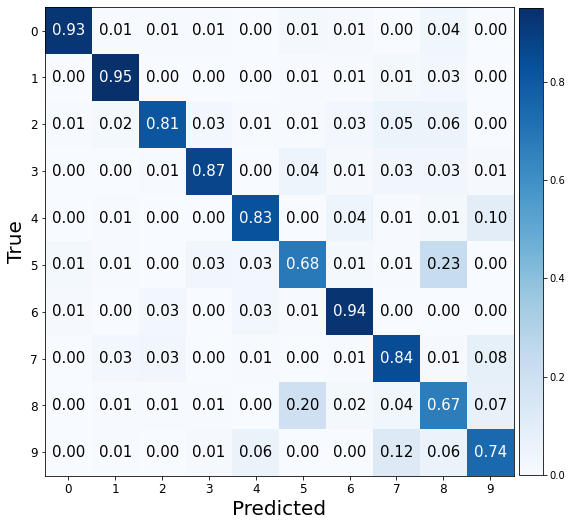

Valid Evaluation loss: 0.3306700587272644. f1:0.8995601646155877 acc: 0.8995000123977661 


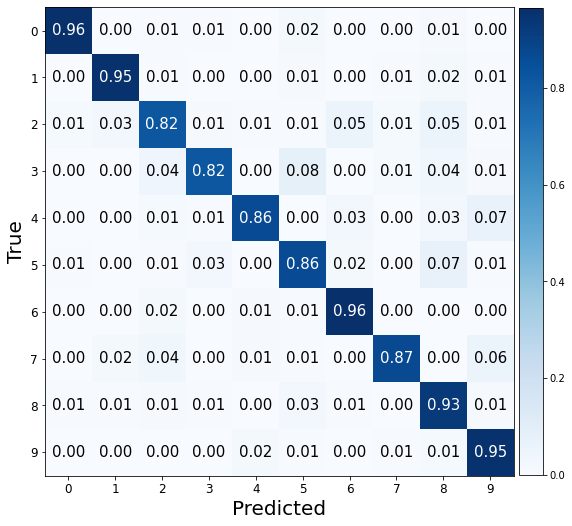

###################

ne: 150, hd:50, wd:0.001, lr: 0.1, bs:1024 
Valid Evaluation loss: 2.3025851249694824. f1:0.01818181818181818 acc: 0.10000000149011612 


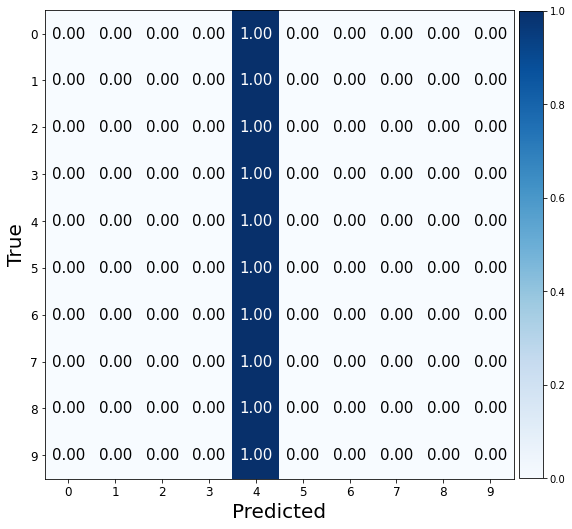

Valid Evaluation loss: 2.1588308811187744. f1:0.09010649791634512 acc: 0.1550000011920929 


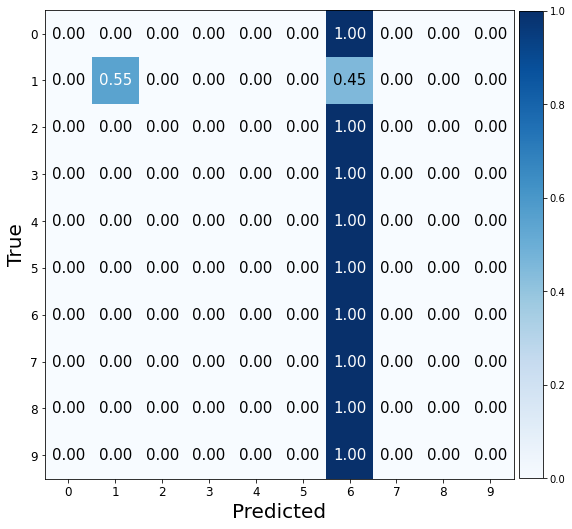

###################

ne: 150, hd:80, wd:0.001, lr: 0.1, bs:1024 
Valid Evaluation loss: 3.4327476024627686. f1:0.18056943556032737 acc: 0.2280000001192093 


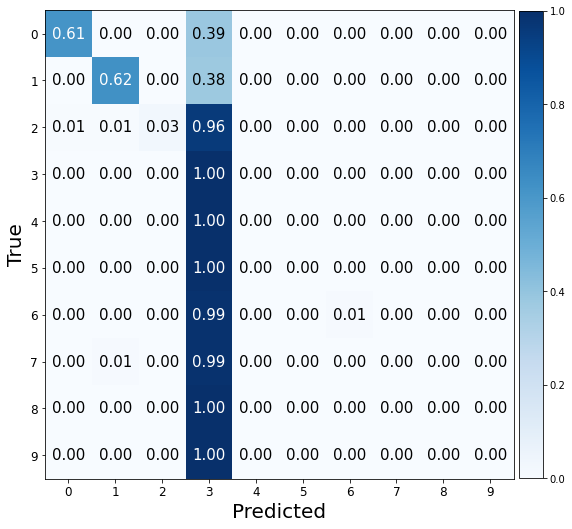

Valid Evaluation loss: 2.3026161193847656. f1:0.01818181818181818 acc: 0.10000000149011612 


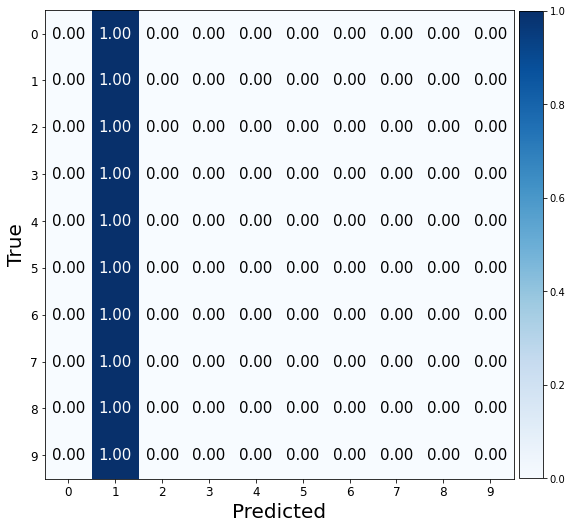

###################

ne: 150, hd:100, wd:0.001, lr: 0.1, bs:1024 
Valid Evaluation loss: 4.176587104797363. f1:0.1768689978145248 acc: 0.22050000727176666 


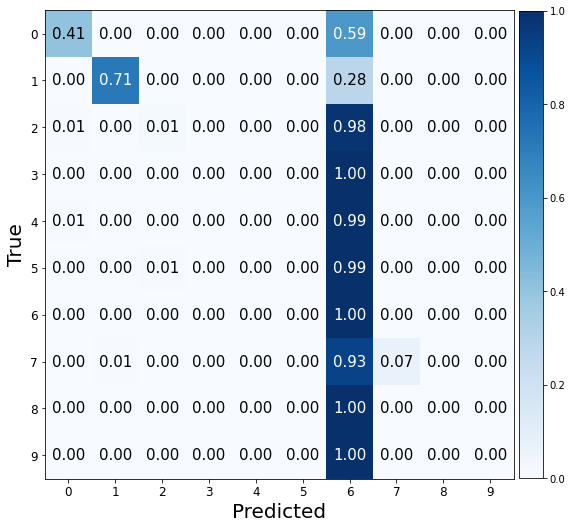

Valid Evaluation loss: 2.302610158920288. f1:0.01818181818181818 acc: 0.10000000149011612 


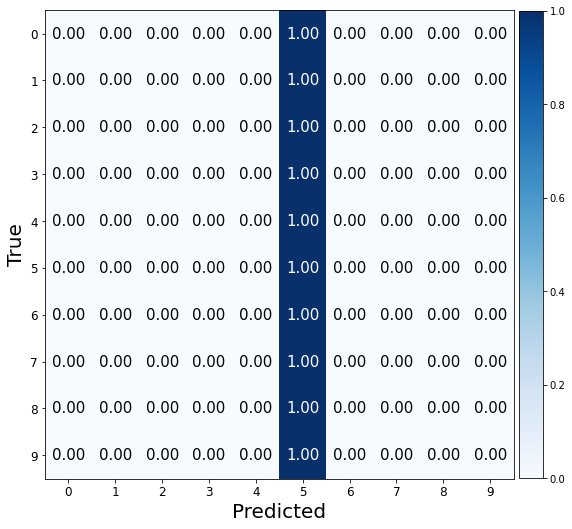

###################

ne: 150, hd:50, wd:0.01, lr: 0.1, bs:1024 
Valid Evaluation loss: 2.1760823726654053. f1:0.10566932230095896 acc: 0.17599999904632568 


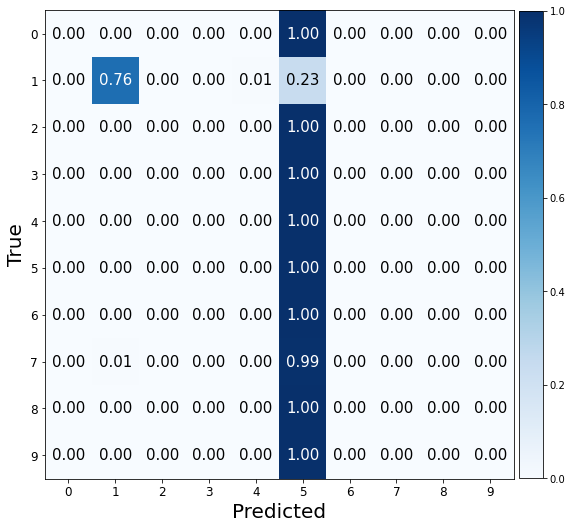

Valid Evaluation loss: 2.30281400680542. f1:0.01818181818181818 acc: 0.10000000149011612 


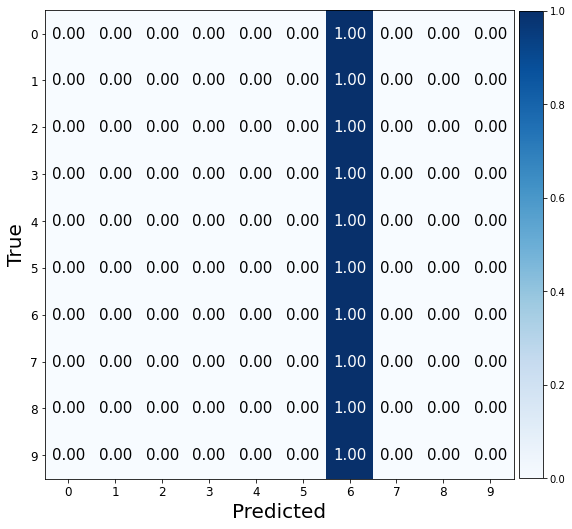

###################

ne: 150, hd:80, wd:0.01, lr: 0.1, bs:1024 
Valid Evaluation loss: 2.449404001235962. f1:0.13316768061212803 acc: 0.18250000476837158 


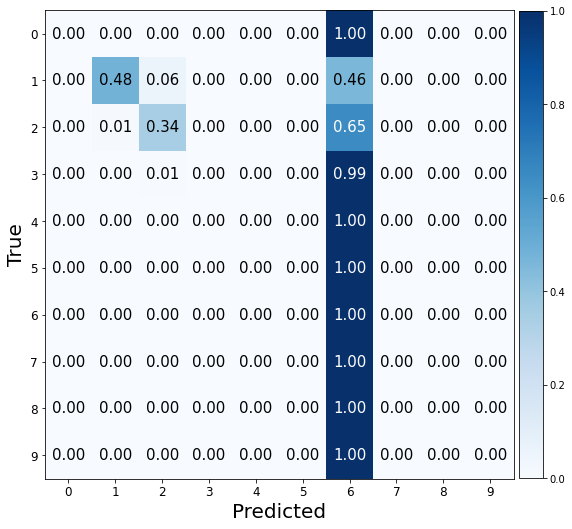

Valid Evaluation loss: 2.3039698600769043. f1:0.01818181818181818 acc: 0.10000000149011612 


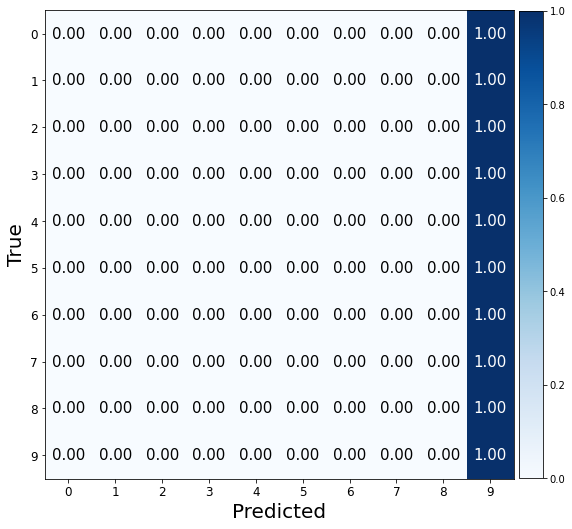

###################

ne: 150, hd:100, wd:0.01, lr: 0.1, bs:1024 
Valid Evaluation loss: 2.247572660446167. f1:0.10902715230992781 acc: 0.18199999630451202 


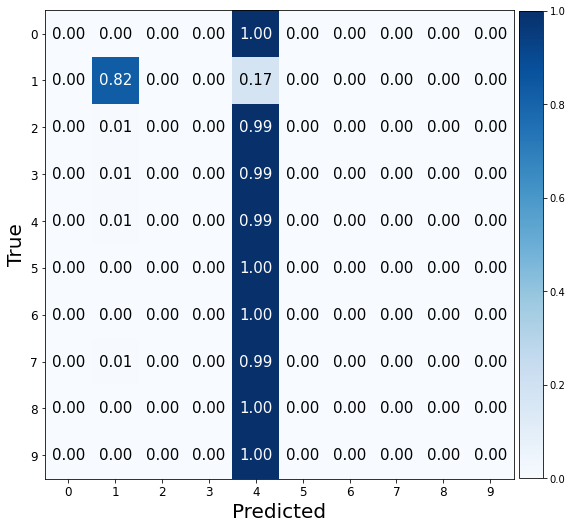

Valid Evaluation loss: 2.3043053150177. f1:0.01818181818181818 acc: 0.10000000149011612 


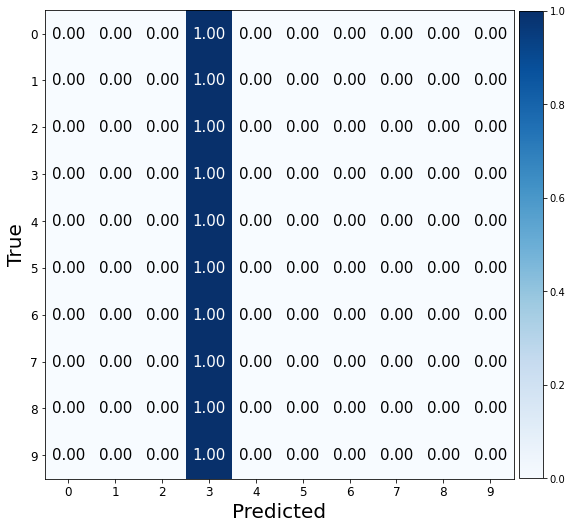

###################

ne: 150, hd:50, wd:0.1, lr: 0.1, bs:1024 
Valid Evaluation loss: 2.310380458831787. f1:0.020203432643947764 acc: 0.10100000351667404 


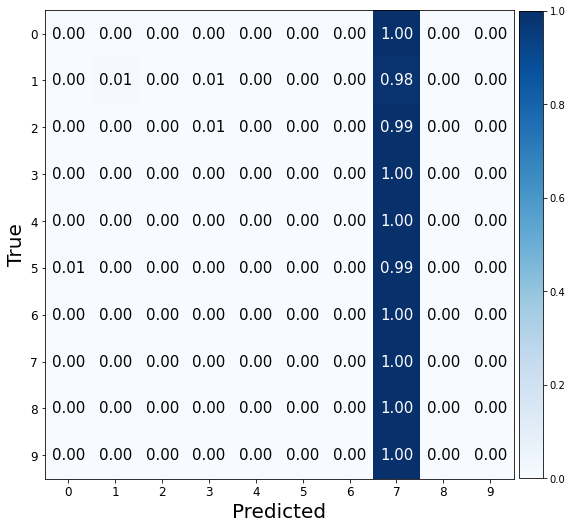

Valid Evaluation loss: 2.8838915824890137. f1:0.06878552700208936 acc: 0.1679999977350235 


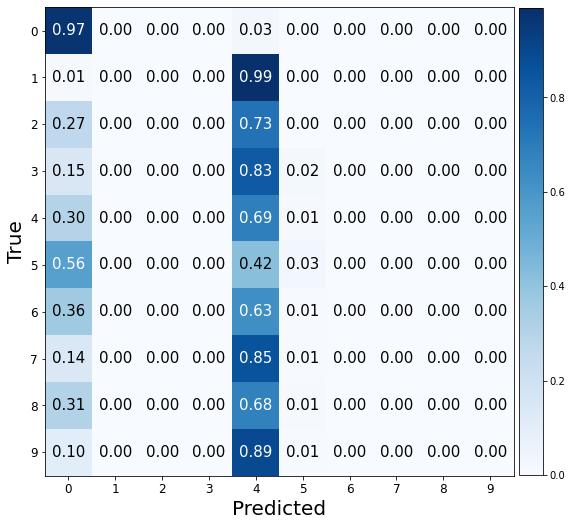

###################

ne: 150, hd:80, wd:0.1, lr: 0.1, bs:1024 
Valid Evaluation loss: 2.2600955963134766. f1:0.12580456392884617 acc: 0.1940000057220459 


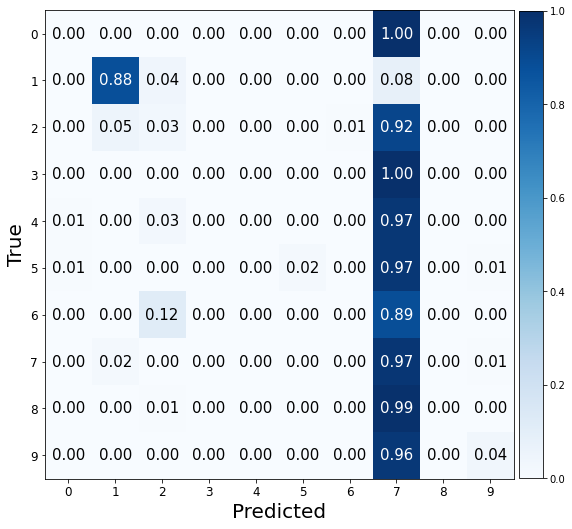

Valid Evaluation loss: 2.307141065597534. f1:0.01818181818181818 acc: 0.10000000149011612 


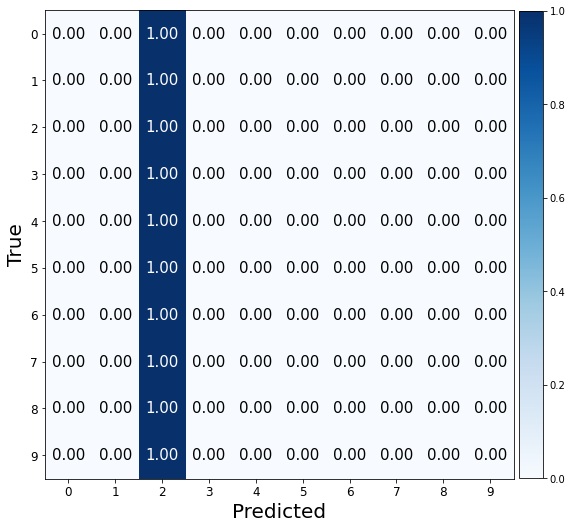

###################

ne: 150, hd:100, wd:0.1, lr: 0.1, bs:1024 
Valid Evaluation loss: 2.4771175384521484. f1:0.025495852279209245 acc: 0.10400000214576721 


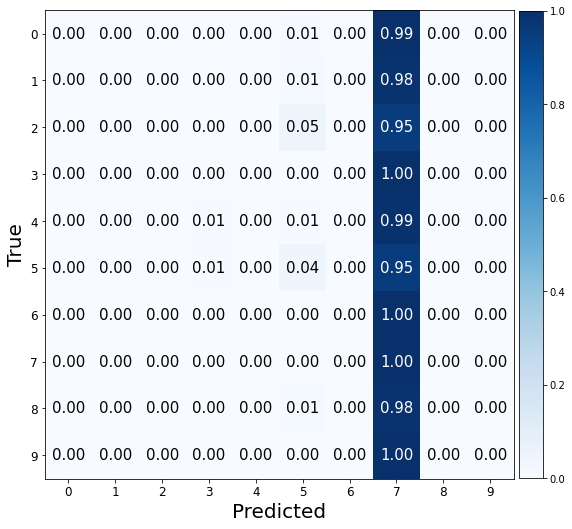

Valid Evaluation loss: 2.3056693077087402. f1:0.01818181818181818 acc: 0.10000000149011612 


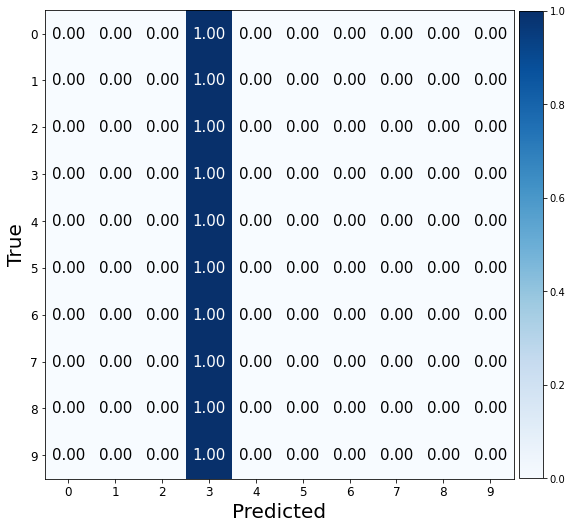

###################



In [ ]:
bs_list = [256,512,1024]
lr_list = [0.001,0.01,0.1]
wd_list = [0.001,0.01,0.1]
hd_list = [50,80,100]
ne_list = [50,100,150]

pbar = tqdm(total=len(bs_list)*len(lr_list)*len(wd_list)*len(hd_list)*len(ne_list))

for ne in ne_list:
  for bs in bs_list:
    train_ds = TensorDataset(X_train, Y_train)
    train_dl = DataLoader(train_ds, batch_size=bs, shuffle=True)

    for lr in lr_list:
      for wd in wd_list:
        for hd in hd_list:
          input_dim = 28*28
          out_dim = 10
          hidden = hd

          model1 = torch.nn.Sequential(
            torch.nn.Linear(input_dim, hidden),
            torch.nn.ReLU(),
            torch.nn.Linear(hidden, out_dim)
          )

          model2 = torch.nn.Sequential(
            torch.nn.Linear(input_dim, hidden),
            torch.nn.ReLU(),
            torch.nn.Linear(hidden, hidden),
            torch.nn.ReLU(),
            torch.nn.Linear(hidden, out_dim)
          )

          optimizer1 = torch.optim.Adam(model1.parameters(), lr=lr, weight_decay=wd)
          optimizer2 = torch.optim.Adam(model2.parameters(), lr=lr, weight_decay=wd)
          criterion = torch.nn.CrossEntropyLoss()

          print('ne: {}, hd:{}, wd:{}, lr: {}, bs:{} '.format(ne,hd,wd,lr,bs))
          train_valid(model1,ne,optimizer1,criterion)
          train_valid(model2,ne,optimizer2,criterion)
          print('###################\n')

          pbar.update()
pbar.close()

De lo anterior se puede observar que el segundo modelo (con tres ANN lineales en vez de solamente dos) es en la mayoría de casos mucho más acertado que el primer modelo. En general, se puede concluir que el mejor modelo posible es aquel que tenga un mayor number of epochs (ne), batch size (bs), mayor número de hidden layers (hd, alrededor de 100), con weight decays de 0.01-0.001 y con learning rates de 0.1. 